## Import Necessary Libraries

In [1]:
import matplotlib.pyplot as plt 
from datetime import datetime
import pandas as pd
import numpy as np
import pygad
import numpy
import glob
import wntr
import os

In [2]:
plt.rcParams['figure.figsize'] = (12,8)

In [3]:
import warnings
warnings.filterwarnings('ignore')

## Read Inp File

In [4]:
class Config:
    num_generations =100 #Number of generations.
    num_parents_mating = 1 # Number of solutions to be selected as parents in the mating pool.
    sol_per_pop = 20 # Number of solutions in the population.
    num_genes = 1 #len(function_inputs) --> this can be an array
    init_range_low = 0
    init_range_high = 1
    parent_selection_type = "sss" # Type of parent selection.
    keep_parents = -1 # Number of parents to keep in the next population. -1 means keep all parents and 0 means keep nothing.
    crossover_type = "single_point" # Type of the crossover operator. 
    mutation_type = "random" # Type of the mutation operator.
    mutation_num_genes=1 # Type of the mutation operator.
    last_fitness = 0
    
    INP_FILE_PATH = r"../data/Real_Synthetic_Net.inp" 
    TEMP_DIR = "temp_for_each_node_optimization_results/"
    PLOTS_DIR = "temp_plots/fitness"
    FUNCTION_INPUTS = None
    DESIRED_OUTPUT = None

In [5]:
class WaterLeakModel(Config):
    
    def __init__(self, node:str):
        ''' 
            node: node/junction ID in the network
        '''
        
        # Check if node is junction_name 
        wn = wntr.network.WaterNetworkModel(self.INP_FILE_PATH)
        assert wn.junction_name_list.count(node) == 1, "Node not found in the network"
        self.node_index = wn.junction_name_list.index(node)
        
        self.node = node
        
    
    def simulate(self, wn, plot_graph=True):
        """
        If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        # Plot pressure after add leak to node
            
        sim = wntr.sim.WNTRSimulator(wn)
        results = sim.run_sim()
        pressure = results.node['pressure']
        pressure_at_N6 = pressure.loc[:,wn.junction_name_list[self.node_index]]
        if plot_graph:
            wntr.graphics.plot_network(wn, node_attribute=pressure.any(), node_size=150, title='Pressure at 0 hours')
        
        return results
    
    def change_discharge_coefficient(self, wn, emitter_value):
        """
        This function changes the emitter coefficient for selected node in the network, and create a 
        structured representation of our data, a csv.
        
        parameters
        ----------
        wn: wntr network object
        emitter_value: the emitter coefficient value
        """
        
        # Change emitter coefficient
        node = wn.get_node(str(self.node))
        node.add_leak(wn, area=0.00015, start_time=0, end_time=1, discharge_coeff=emitter_value)
        return self.simulate(wn, plot_graph=False)
    
    def export_results(self, solutions:list, path:str, name:str):
        """
        Concatenates all solutions generated and exports as a single csv file
        
        parameters
        ----------
        solution: a list of all paths to the solutions csv files
        path: path where concatenated solution will be exported to
        name: name to be assigned to exported file
        """
        if not os.path.exists(path):
            os.mkdir(path)
        
        temp = pd.DataFrame()
        for i in range(len(solutions)):
            data = pd.read_csv(solutions[i])
            if i == 0:
                temp = data
            else:
                temp = pd.concat([temp, data])
        name+=".csv"
        try:
            temp.to_csv(os.path.join(path,name),index=False)
            print(f'File Exported Successfully to path: {os.path.join(path, name)}')
        except Exception as e:
            print(e)
            
    def run(self, leak_area=0.00015, start_time=0, end_time=1, discharge_coeff=.5, function_inputs=0.5, plot_graph=True):
        """
        Adds a leak to node passed to WaterLeakModel() object and simulates
        
        parameters
        ----------
        leak_area: area of the leak
        start_time: time in seconds to start the leak
        end_time: time in seconds to end the leak
        discharge_coeff: Leak discharge coefficient; Takes on values between 0 and 1.
        function_inputs = inputs for optimization, can be array of numbers
        plot_graph: If plot_graph is set to true, a graph of the network is plotted after simulation
        """
        
        # Add leak and simulate
        wn = wntr.network.WaterNetworkModel(self.INP_FILE_PATH)
        node = wn.get_node(self.node)
        node.add_leak(wn, area=leak_area, start_time=start_time, end_time=end_time, discharge_coeff=.5)
        self.simulate(wn, plot_graph=plot_graph)

        self.FUNCTION_INPUTS = function_inputs
        self.DESIRED_OUTPUT = node.head - node.elevation
            

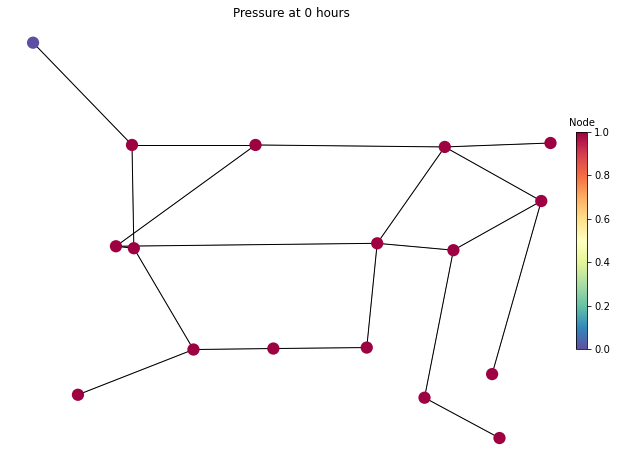

In [6]:
# Instantiate the pygad optimization class
water_model = WaterLeakModel(node='N6')
water_model.run()

In [7]:
# wipe all solutions in the directory
all_solutions = glob.glob(f'{water_model.TEMP_DIR}/FITNESS_SOLUTION_*')
all_generations = glob.glob(f'{water_model.TEMP_DIR}/GENERATION_*')
for i in all_solutions:
    os.remove(i)
for j in all_generations:
    os.remove(j)


# Uncomment and run the above code if you want to re-optimze this project otherwise, go ahead.
# Recommendation: Uncomment and run the code if you want re-optimize.

In [8]:
def fitness_function(solution, solution_idx):
    global current_node
    
    wn = wntr.network.WaterNetworkModel(water_model.INP_FILE_PATH)
    results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0])) #change emitter coefficient

    pressure = results.node['pressure']
    pressure_output = pressure.loc[:,water_model.node]

    demands=results.node['demand']
    demand_output = demands.loc[:,water_model.node]
    
    fitness = 1.0 / (np.abs(pressure_output - water_model.DESIRED_OUTPUT) + 0.000001)

    # Structure and export the output of the fitness
    data = pd.DataFrame(columns=['EMITTER_COEFFICIENT_SOLUTION','PRESSURE_OUTPUT','OUTPUT_DEMAND','FITNESS'])
    data = data.append({'EMITTER_COEFFICIENT_SOLUTION':abs(solution[0]),'PRESSURE_OUTPUT':list(pressure_output)[0],'FITNESS':list(fitness)[0],'OUTPUT_DEMAND':(list(demand_output) [0]*1000)},ignore_index=True)
    data.to_csv(f"{water_model.TEMP_DIR}/FITNESS_SOLUTION_{current_node}_{str(abs(solution[0]))}.csv",index=False) 

    print('=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========')
    print ('======|', abs(round(solution[0],3)),'|===========|',list(round(pressure_output,3))[0],'|==================|',list(round(fitness, 3))[0],'|==========')
    print('================================='*2)

    return list(fitness)[0]

In [9]:
#################### Create a Callback Function ########################
last_fitness = 0
def callback_generation(ga_instance): # This function prints algorithm progress
    global last_fitness
    print("Generation = {generation}".format(generation=ga_instance.generations_completed)) 
    print("Fitness = {fitness}".format(fitness=ga_instance.best_solution()[1]))
    print("Change = {change}".format(change=ga_instance.best_solution()[1] - last_fitness)) 

    data =pd.DataFrame(columns=['GENERATION','FITNESS'])
    data =data.append({'GENERATION':ga_instance.generations_completed,'FITNESS': ga_instance.best_solution ()[1]},ignore_index=True)
    data.to_csv(f"{water_model.TEMP_DIR}/GENERATION_{current_node}_{str(ga_instance.generations_completed)}.csv",index=False) 
    last_fitness = ga_instance.best_solution()[1]

In [10]:
wn = wntr.network.WaterNetworkModel(water_model.INP_FILE_PATH)
model_nodes = wn.junction_name_list

In [11]:
model_nodes

['N1',
 'N5',
 'N10',
 'N7',
 'N2',
 'N6',
 'N3',
 'N8',
 'N13',
 'N9',
 'N14',
 'N4',
 'N11',
 'N12',
 'N15',
 'N16']

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 9.364 |==================| 111.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 9.366 |==================| 88.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 9.347 |==================| 119.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 9.358 |==================| 323.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 9.346 |==================| 106.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 9.348 |==================| 136.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 9.363 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 9.354 |==================| 966.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 9.331 |==================| 41.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 9.348 |==================| 139.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.365 |==================| 101.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.355 |==================| 3676.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 9.33 |==================| 39.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 9.356 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 9.348 |==================| 139.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.365 |==================| 101.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.355 |==================| 3676.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 9.33 |==================| 39.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 9.356 |==================| 658.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 9.333 |==================| 45.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 9.359 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 18133.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 9.34 |==================| 67.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 9.369 |==================| 73.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 9.34 |==================| 66.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 9.355 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 9.34 |==================| 67.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 9.369 |==================| 73.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 9.34 |==================| 66.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 9.355 |==================| 12264.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 9.354 |==================| 1048.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 9.362 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 9.369 |==================| 73.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 9.34 |==================| 66.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 9.355 |==================| 12264.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 9.354 |==================| 1048.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 9.362 |==================| 147.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 9.355 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 9.356 |==================| 1654.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 9.338 |==================| 59.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 9.356 |==================| 1661.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 9.359 |==================| 233.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.361 |==================| 154.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 9.351 |==================| 279.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 9.36 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 9.338 |==================| 59.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 9.356 |==================| 1661.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 9.359 |==================| 233.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.361 |==================| 154.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 9.351 |==================| 279.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 9.36 |==================| 210.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 9.362 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 9.36 |==================| 202.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 9.366 |==================| 92.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 9.36 |==================| 193.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 9.338 |==================| 60.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 9.358 |==================| 302.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 9.342 |==================| 78.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 9.334 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 9.366 |==================| 92.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 9.36 |==================| 193.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 9.338 |==================| 60.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 9.358 |==================| 302.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 9.342 |==================| 78.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 9.334 |==================| 47.116 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 9.339 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 9.338 |==================| 60.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 9.358 |==================| 302.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 9.342 |==================| 78.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 9.334 |==================| 47.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 9.357 |==================| 575.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 9.333 |==================| 44.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 9.363 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 9.364 |==================| 111.558 |==========
Fitness = 18133.534579777555
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 9.357 |==================| 575.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 9.333 |==================| 44.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 9.363 |==================| 119.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 9.36 |==================| 203.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 9.345 |==================| 96.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 9.333 |==================| 44.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 9.363 |==================| 119.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 9.36 |==================| 203.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 9.345 |==================| 96.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 9.366 |==================| 91.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 9.326 |==================| 34.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 9.355 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 9.336 |==================| 52.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 9.365 |==================| 95.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 9.355 |==================| 2871.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 9.345 |==================| 96.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 9.347 |==================| 131.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 9.355 |==================| 2871.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 9.345 |==================| 96.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 9.347 |==================| 131.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |==================| 387.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 9.367 |==================| 81.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 9.359 |==================| 269.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 9.359 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 9.354 |==================| 702.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 9.355 |==================| 5767.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 9.358 |==================| 391.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================| 140.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 9.37 |==================| 68.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.365 |==================| 103.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 9.359 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 9.358 |==================| 391.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================| 140.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 9.37 |==================| 68.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.365 |==================| 103.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 9.359 |==================| 256.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 9.366 |==================| 87.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 9.369 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================| 140.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 9.37 |==================| 68.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.365 |==================| 103.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 9.359 |==================| 256.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 9.366 |==================| 87.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 9.369 |==================| 73.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 9.352 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 9.328 |==================| 37.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 9.324 |==================| 32.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 9.335 |==================| 49.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.906 |==========
Fitness = 18133.534579777555
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 9.351 |==================| 234.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.369 |==================| 72.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 9.335 |==================| 49.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 9.351 |==================| 234.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 9.369 |==================| 72.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.36 |==================| 187.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 9.366 |==================| 90.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 9.366 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 9.369 |==================| 69.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 9.347 |==================| 130.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.357 |==================| 401.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 9.333 |==================| 44.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 9.359 |==================| 256.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 9.364 |==================| 108.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 9.339 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.357 |==================| 401.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 9.333 |==================| 44.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 9.359 |==================| 256.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 9.364 |==================| 108.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 9.339 |==================| 62.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 9.33 |==================| 40.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 9.36 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 9.325 |==================| 32.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 9.342 |==================| 76.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 9.339 |==================| 62.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 9.37 |==================| 65.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 9.369 |==================| 70.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 9.355 |==================| 3418.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 9.37 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 9.37 |==================| 65.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 9.369 |==================| 70.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 9.355 |==================| 3418.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 9.37 |==================| 68.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.355 |==================| 2983.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 9.355 |==================| 2595.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 9.364 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 9.355 |==================| 3418.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 9.37 |==================| 68.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.355 |==================| 2983.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 9.355 |==================| 2595.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 9.364 |==================| 110.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 9.366 |==================| 88.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 9.356 |==================| 1300.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 9.361 |==================| 156.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 9.369 |==================| 73.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 9.335 |==================| 50.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 9.334 |==================| 48.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 9.332 |==================| 44.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.369 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 9.335 |==================| 50.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 9.334 |==================| 48.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 9.332 |==================| 44.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.369 |==================| 69.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 9.368 |==================| 75.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 9.351 |==================| 243.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 9.353 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 9.361 |==================| 173.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 9.333 |==================| 45.47 |==========
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 9.328 |==================| 37.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================| 139.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 9.358 |==================| 306.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 9.362 |==================| 150.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 9.341

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 9.328 |==================| 37.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================| 139.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 9.358 |==================| 306.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 9.362 |==================| 150.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 9.341 |==================| 71.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 9.328 |==================| 37.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 9.363 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 9.369 |==================| 69.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 9.327 |==================| 35.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 9.368 |==================| 76.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 9.346 |==================| 110.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.347 |==================| 122.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 9.364 |==================| 115.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 9.357 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 9.368 |==================| 76.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 9.346 |==================| 110.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.347 |==================| 122.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 9.364 |==================| 115.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 9.357 |==================| 627.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 9.358 |==================| 309.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 9.37 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 9.346 |==================| 110.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 9.347 |==================| 122.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 9.364 |==================| 115.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 9.357 |==================| 627.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 9.358 |==================| 309.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 9.37 |==================| 64.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 9.338 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 9.364 |==================| 105.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.349 |==================| 160.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 9.367 |==================| 83.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 9.367 |==================| 80.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 9.37 |==================| 67.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 9.345 |==================| 98.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 9.349 |==================| 160.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 9.367 |==================| 83.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 9.367 |==================| 80.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 9.37 |==================| 67.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 9.345 |==================| 98.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 740.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 9.368 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 9.337 |==================| 54.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 9.362 |==================| 150.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 9.339 |==================| 62.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 9.358 |==================| 341.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 9.33 |==================| 39.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 9.358 |==================| 347.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 9.37 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 9.362 |==================| 150.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 9.339 |==================| 62.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 9.358 |==================| 341.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 9.33 |==================| 39.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 9.358 |==================| 347.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 9.37 |==================| 66.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 9.338 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 9.358 |==================| 341.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 9.33 |==================| 39.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 9.358 |==================| 347.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 9.37 |==================| 66.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 9.338 |==================| 59.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 9.336 |==================| 52.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 9.359 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 9.338 |==================| 59.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 9.367 |==================| 82.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.36 |==================| 204.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 9.369 |==================| 70.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 9.369 |==================| 69.154 |==========
Fitness = 56250.57198491664
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 9.359 |==================| 273.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 9.369 |==================| 70.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 9.369 |==================| 69.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 9.359 |==================| 273.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 9.355 |==================| 56250.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 9.344 |==================| 89.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 9.357 |==================| 426.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 9.354 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 9.358 |==================| 286.972 |==========
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 9.325 |==================| 33.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 9.371 |==================| 64.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 9.365 |==================| 104.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 9.37 |==================| 68.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 9.361 |==================| 167.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 9.37 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 9.365 |==================| 104.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 9.37 |==================| 68.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 9.361 |==================| 167.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 9.37 |==================| 65.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 9.362 |==================| 142.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 9.349 |==================| 181.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 9.343 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 299.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 9.328 |==================| 37.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 9.332 |==================| 42.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 9.344 |==================| 88.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 155.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 9.325 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 9.328 |==================| 37.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 9.332 |==================| 42.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 9.344 |==================| 88.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 155.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 9.325 |==================| 33.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 9.34 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 9.344 |==================| 88.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 155.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 9.325 |==================| 33.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 9.34 |==================| 68.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 9.367 |==================| 85.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 9.337 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 9.361 |==================| 176.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 9.341 |==================| 74.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |==================| 390.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 9.355 |==================| 70493.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 9.335 |==================| 50.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 226.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.36 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |==================| 390.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 9.355 |==================| 70493.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 9.335 |==================| 50.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 226.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.36 |==================| 199.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 9.37 |==================| 66.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 9.341 |==================| 69.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 9.342 |==================| 77.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 226.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 9.364 |==================| 114.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1725.148 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 9.363 |==================| 126.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.36

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 226.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 9.364 |==================| 114.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1725.148 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 9.363 |==================| 126.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 9.36 |==================| 215.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 9.359 |==================| 280.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 9.333 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 9.325 |==================| 32.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 9.365 |==================| 101.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 9.348 |==================| 150.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 9.359 |==================| 223.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 9.334 |==================| 48.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.363 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 9.359 |==================| 223.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 9.334 |==================| 48.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.363 |==================| 129.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 9.334 |==================| 47.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 9.334 |==================| 48.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 9.357 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 9.334 |==================| 48.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.363 |==================| 129.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 9.334 |==================| 47.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 9.334 |==================| 48.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 9.357 |==================| 406.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 9.33 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 9.363 |==================| 118.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 9.367 |==================| 84.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 156.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 9.367 |==================| 84.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 9.356 |==================| 1364.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.369 |==================| 70.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 9.343 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 9.367 |==================| 84.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 156.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 9.367 |==================| 84.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 9.356 |==================| 1364.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.369 |==================| 70.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 9.343 |==================| 80.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 9.364 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 9.368 |==================| 77.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 9.339 |==================| 64.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 225.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 9.333 |==================| 45.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.345 |==================| 96.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 9.355 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 9.339 |==================| 64.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 225.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 9.333 |==================| 45.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.345 |==================| 96.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 9.355 |==================| 14614.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 9.361 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 225.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 9.333 |==================| 45.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 9.345 |==================| 96.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 9.355 |==================| 14614.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 9.361 |==================| 176.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 9.333 |==================| 46.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.366 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 9.34 |==================| 66.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 225.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.369 |==================| 70.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 9.329 |==================| 37.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 9.364 |==================| 109.113 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 9.346 |==================| 108.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 225.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.369 |==================| 70.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 9.329 |==================| 37.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 9.364 |==================| 109.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 9.346 |==================| 108.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 9.349 |==================| 176.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 9.348 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 9.328 |==================| 36.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 9.336 |==================| 51.616 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 9.327 |==================| 35.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.36 |==================| 203.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 9.359 |==================| 233.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 9.35 |==================| 195.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.369 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 9.327 |==================| 35.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.36 |==================| 203.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 9.359 |==================| 233.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 9.35 |==================| 195.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 9.369 |==================| 70.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 9.363 |==================| 131.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 9.361 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 9.365 |==================| 104.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 9.362 |==================| 144.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 9.358 |==================| 306.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.369 |==================| 72.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 9.345 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 9.362 |==================| 144.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 9.358 |==================| 306.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.369 |==================| 72.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 9.345 |==================| 97.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 9.365 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 9.369 |==================| 72.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 9.345 |==================| 97.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 9.365 |==================| 100.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 9.326 |==================| 35.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 9.368 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.366 |==================| 89.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 9.348 |==================| 144.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 9.363 |==================| 127.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 9.343 |==================| 83.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 9.364 |==================| 105.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 9.338 |==================| 60.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 9.363 |==================| 127.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 9.343 |==================| 83.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 9.364 |==================| 105.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 9.338 |==================| 60.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 9.367 |==================| 85.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 9.371 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 9.343 |==================| 82.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.368 |==================| 75.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 9.344 |==================| 94.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 65.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 9.366 |==================| 90.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 9.33 |==================| 39.873 |==========
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 9.36 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.368 |==================| 75.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 9.344 |==================| 94.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 65.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 9.366 |==================| 90.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 9.33 |==================| 39.873 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 9.36 |==================| 188.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 9.355 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 65.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 9.366 |==================| 90.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 9.33 |==================| 39.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 9.368 |==================| 78.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 9.344 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 9.349 |==================| 167.698 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 9.368 |==================| 78.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 9.344 |==================| 90.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 9.356 |==================| 1048.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 9.368 |==================| 78.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 9.344 |==================| 90.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 9.356 |==================| 1048.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 9.328 |==================| 36.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 9.33 |==================| 39.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 9.354 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 9.362 |==================| 135.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 9.346 |==================| 108.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 9.348 |==================| 147.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 9.369 |==================| 71.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 9.333 |==================| 46.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 9.347 |==================| 132.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 9.366 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 9.348 |==================| 147.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 9.369 |==================| 71.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 9.333 |==================| 46.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 9.347 |==================| 132.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 9.366 |==================| 91.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.368 |==================| 74.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 9.358 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 9.37 |==================| 67.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 9.328 |==================| 37.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 9.346 |==================| 111.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 9.327 |==================| 36.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 9.358 |==================| 378.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 9.353 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 9.327 |==================| 36.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 9.358 |==================| 378.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 9.353 |==================| 551.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |==================| 96.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 9.339 |==================| 61.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.352 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 9.327 |==================| 36.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 9.358 |==================| 378.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 9.353 |==================| 551.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |==================| 96.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 9.339 |==================| 61.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 9.352 |==================| 320.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 9.335 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 9.37 |==================| 66.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 9.335 |==================| 49.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 9.351 |==================| 244.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 734.343 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 9.353 |==================| 487.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 9.329 |==================| 37.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 9.335 |==================| 49.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 9.351 |==================| 244.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 734.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 9.353 |==================| 487.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 9.329 |==================| 37.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 9.354 |==================| 841.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 9.334 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 9.337 |==================| 56.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 9.33 |==================| 40.34 |==========
Generation = 33
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 9.353 |==================| 463.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 9.337 |==================| 55.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 9.351 |==================| 234.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.349 |==================| 169.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 9.357 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 9.353 |==================| 463.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 9.337 |==================| 55.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 9.351 |==================| 234.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 9.349 |==================| 169.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 9.357 |==================| 548.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 112.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 9.367 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 9.361 |==================| 154.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 9.339 |==================| 60.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.372 |===========| 9.327 |==================| 36.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 9.362 |==================| 134.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1163.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 9.358 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.372 |===========| 9.327 |==================| 36.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 9.362 |==================| 134.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1163.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 9.358 |==================| 311.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 9.361 |==================| 157.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 9.361 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 9.362 |==================| 134.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 9.356 |==================| 1163.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 9.358 |==================| 311.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 9.361 |==================| 157.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 9.361 |==================| 159.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 9.362 |==================| 135.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 9.367 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 9.345 |==================| 102.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 9.37 |==================| 68.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 9.36 |==================| 218.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 9.35 |==================| 211.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 9.365 |==================| 100.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 9.366 |==================| 87.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 9.335 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 9.37 |==================| 68.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 9.36 |==================| 218.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 9.35 |==================| 211.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 9.365 |==================| 100.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 9.366 |==================| 87.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 9.335 |==================| 50.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 9.348 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 9.37 |==================| 65.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 9.364 |==================| 116.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 9.34 |==================| 66.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 9.326 |==================| 34.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 9.335 |==================| 51.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 9.365 |==================| 97.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 9.356 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 9.34 |==================| 66.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 9.326 |==================| 34.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 9.335 |==================| 51.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 9.365 |==================| 97.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 9.356 |==================| 731.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |==================| 96.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 9.328 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 9.335 |==================| 51.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 9.365 |==================| 97.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 9.356 |==================| 731.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 9.365 |==================| 96.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 9.328 |==================| 36.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 9.353 |==================| 592.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 9.366 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.368 |==================| 75.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 9.36 |==================| 202.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.352 |==================| 299.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.343 |==================| 81.996 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 9.353 |==================| 592.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 9.366 |==================| 87.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.352 |==================| 299.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.343 |==================| 81.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 9.353 |==================| 592.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 9.366 |==================| 87.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 9.357 |==================| 553.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 9.359 |==================| 223.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 9.361 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 9.352 |==================| 292.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 9.362 |==================| 133.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 9.356 |==================| 955.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 9.343 |==================| 87.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 9.364 |==================| 114.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 9.366 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 9.37 |==================| 65.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 9.343 |==================| 87.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 9.364 |==================| 114.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 9.366 |==================| 92.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 9.363 |==================| 130.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 9.34 |==================| 66.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 9.342 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 9.324 |==================| 32.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 9.362 |==================| 151.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 9.342 |==================| 74.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.368 |==================| 75.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 9.332 |==================| 43.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.341 |==================| 70.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 9.37 |==================| 64

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 9.342 |==================| 74.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.368 |==================| 75.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 9.332 |==================| 43.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.341 |==================| 70.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 9.37 |==================| 64.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 9.334 |==================| 47.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 9.368 |==================| 75.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 9.332 |==================| 43.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 9.341 |==================| 70.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 9.37 |==================| 64.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 9.334 |==================| 47.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1812.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 9.345 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 9.364 |==================| 107.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 9.371 |==================| 64.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 9.325 |==================| 33.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 9.353 |==================| 408.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 9.36 |==================| 202.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 9.335 |==================| 50.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 9.349 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 9.371 |==================| 64.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 9.325 |==================| 33.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 9.353 |==================| 408.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 9.36 |==================| 202.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 9.335 |==================| 50.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 9.349 |==================| 172.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 9.358 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 9.367 |==================| 80.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.357 |==================| 517.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 9.359 |==================| 269.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 9.333 |==================| 45.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.783 |==========
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 9.327 |==================| 35.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 9.331 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.357 |==================| 517.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 9.359 |==================| 269.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 9.333 |==================| 45.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.783 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 9.327 |==================| 35.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 9.331 |==================| 41.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 9.328 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 9.333 |==================| 45.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 9.325 |==================| 33.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |==================| 77.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 9.36 |==================| 186.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 9.362 |==================| 136.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.355 |==================| 3634.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 9.361 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 9.356 |==================| 696.048 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |==================| 77.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 9.36 |==================| 186.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 9.362 |==================| 136.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.355 |==================| 3634.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 9.361 |==================| 174.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 9.362 |==================| 136.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.355 |==================| 3634.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 9.361 |==================| 174.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 9.348 |==================| 140.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 9.366 |==================| 88.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 9.336 |==================| 51.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 9.326 |==================| 34.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 9.362 |==================| 133.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 9.366 |==================| 88.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 9.34 |==================| 65.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 9.361 |==================| 172.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 9.365 |==================| 103.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 9.359 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 9.34 |==================| 65.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 9.361 |==================| 172.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 9.365 |==================| 103.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 9.359 |==================| 228.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 9.333 |==================| 45.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.369 |==================| 69.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 9.345 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 9.332 |==================| 43.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 9.353 |==================| 467.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 9.352 |==================| 328.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 12640.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 9.346 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 9.352 |==================| 328.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 12640.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 9.346 |==================| 109.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.362 |==================| 137.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 9.337 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 9.355 |==================| 12640.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 9.346 |==================| 109.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 9.362 |==================| 137.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 9.337 |==================| 54.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 9.339 |==================| 63.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 9.327 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 9.335 |==================| 49.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 9.338 |==================| 60.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 9.37 |==================| 68.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 9.356 |==================| 903.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 9.345 |==================| 99.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 9.351 |==================| 261.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 9.338 |==================| 60.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 9.37 |==================| 68.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 9.356 |==================| 903.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 9.345 |==================| 99.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 9.351 |==================| 261.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================| 140.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 9.341 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 9.354 |==================| 1904.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 9.328 |==================| 37.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 9.355 |==================| 60602.33 |==========
Generation = 46
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.354 |==================| 1236.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 9.356 |==================| 1202.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 9.34 |==================| 65.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 9.36

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 9.328 |==================| 37.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 9.355 |==================| 60602.33 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.354 |==================| 1236.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 9.356 |==================| 1202.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 9.34 |==================| 65.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 9.36 |==================| 198.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 9.336 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 9.368 |==================| 74.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 9.37 |==================| 65.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 9.346 |==================| 116.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 9.367 |==================| 83.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 9.351 |==================| 259.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 9.367 |==================| 81.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 9.346 |==================| 116.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 9.367 |==================| 83.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 9.351 |==================| 259.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 9.367 |==================| 81.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |==================| 78.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 9.324 |==================| 32.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 9.33 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 9.367 |==================| 83.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 9.351 |==================| 259.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 9.367 |==================| 81.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 9.368 |==================| 78.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 9.324 |==================| 32.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 9.33 |==================| 39.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 9.337 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 9.347 |==================| 128.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.357 |==================| 516.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 9.365 |==================| 98.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 9.333 |==================| 44.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================| 847.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 9.335 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 9.357 |==================| 516.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 9.365 |==================| 98.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 9.333 |==================| 44.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 9.356 |==================| 847.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 9.335 |==================| 51.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 9.339 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.365 |==================| 101.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 9.36 |==================| 202.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 9.327 |==================| 36.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 9.33 |==================| 40.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.366 |==================| 89.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 9.338 |==================| 58.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 9.346 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 9.36 |==================| 202.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 9.327 |==================| 36.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 9.33 |==================| 40.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.366 |==================| 89.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 9.338 |==================| 58.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 9.346 |==================| 108.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 9.367 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.366 |==================| 89.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 9.338 |==================| 58.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 9.346 |==================| 108.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 9.367 |==================| 85.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 9.338 |==================| 58.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 9.365 |==================| 100.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 9.366 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 9.348 |==================| 140.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 9.345 |==================| 104.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 537.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 9.36 |==================| 214.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 9.33 |==================| 39.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 9.356 |==================| 1430.356 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 9.345 |==================| 104.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 537.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 9.36 |==================| 214.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 9.33 |==================| 39.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 9.356 |==================| 1430.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 9.356 |==================| 782.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 9.365 |==================| 102.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 9.368 |==================| 74.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.363 |==================| 126.904 |==========
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 9.35 |==================| 192.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.363 |==================| 128.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 9.35

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 9.35 |==================| 192.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.363 |==================| 128.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 9.357 |==================| 463.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 9.36 |==================| 214.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 9.371 |==================| 63.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 9.347 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 9.329 |==================| 39.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 9.353 |==================| 403.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 9.336 |==================| 53.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 9.331 |==================| 42.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.348 |==================| 134.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 9.326 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 9.353 |==================| 403.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 9.336 |==================| 53.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 9.331 |==================| 42.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.348 |==================| 134.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 9.326 |==================| 34.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 9.331 |==================| 42.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 9.348 |==================| 134.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 9.363 |==================| 130.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 9.326 |==================| 34.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 9.332 |==================| 42.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 9.346 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 9.333 |==================| 46.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 9.33 |==================| 40.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 249.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 9.341 |==================| 74.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 9.33 |==================| 40.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 9.348 |==================| 139.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 249.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 9.341 |==================| 74.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 9.33 |==================| 40.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 9.348 |==================| 139.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================| 8828.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 9.355 |==================| 5907.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 9.367 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 9.345 |==================| 99.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 9.349 |==================| 178.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 9.333 |==================| 46.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 9.349 |==================| 162.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 247.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 64.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 9.333 |==================| 46.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 9.349 |==================| 162.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 247.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 64.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |==================| 47.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.369 |==================| 69.891 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 9.368 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 9.371 |==================| 64.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 9.334 |==================| 47.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 9.369 |==================| 69.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 65.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 9.366 |==================| 87.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 9.339 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 9.333 |==================| 44.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 65.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 9.366 |==================| 87.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 9.339 |==================| 60.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 9.356 |==================| 891.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 9.343 |==================| 83.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 9.363 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 9.339 |==================| 60.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 9.356 |==================| 891.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 9.343 |==================| 83.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 9.363 |==================| 132.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 9.365 |==================| 101.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 9.341 |==================| 72.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 9.348 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 9.342 |==================| 79.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.349 |==================| 166.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 9.324 |==================| 32.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 9.338 |==================| 60.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 9.368 |==================| 76.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 9.342 |==================| 75.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 9.363 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 9.324 |==================| 32.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 9.338 |==================| 60.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 9.368 |==================| 76.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 9.342 |==================| 75.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 9.363 |==================| 131.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 9.349 |==================| 162.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.355 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 9.338 |==================| 60.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 9.37 |==================| 65.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 9.35 |==================| 205.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 65.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 9.327 |==================| 35.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.357 |==================| 493.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 9.358 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 9.37 |==================| 65.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 9.327 |==================| 35.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.357 |==================| 493.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 9.358 |==================| 340.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 9.367 |==================| 81.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 9.334 |==================| 48.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 9.331 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.357 |==================| 493.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 9.358 |==================| 340.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 9.367 |==================| 81.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 9.334 |==================| 48.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 9.331 |==================| 41.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 9.333 |==================| 45.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 9.33 |==================| 39.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.354 |==================| 999.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 9.369 |==================| 73.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 9.36 |==================| 191.826 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.357 |==================| 487.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 9.354 |==================| 999.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 9.369 |==================| 73.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 9.36 |==================| 191.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 9.357 |==================| 487.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 9.366 |==================| 91.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 9.325 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 9.364 |==================| 113.99 |==========
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 224.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.367 |==================| 83.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 9.332 |==================| 43.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 9.355 |==================| 4336.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 9.362 |==================| 149.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 9.338

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 224.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 9.367 |==================| 83.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 9.332 |==================| 43.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 9.355 |==================| 4336.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 9.362 |==================| 149.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 9.338 |==================| 58.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 9.351 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 9.359 |==================| 263.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 9.36 |==================| 187.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 9.35 |==================| 201.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 9.367 |==================| 86.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 9.365 |==================| 95.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================| 7066.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 9.364 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 9.35 |==================| 201.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 9.367 |==================| 86.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 9.365 |==================| 95.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================| 7066.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 9.364 |==================| 108.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================| 502.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 9.355 |==================| 7066.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 9.364 |==================| 108.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================| 502.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 102.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 9.349 |==================| 170.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 9.339 |==================| 63.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 9.357 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 9.36 |==================| 198.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 9.332 |==================| 44.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 9.324 |==================| 32.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==================| 209.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 9.362 |==================| 151.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 9.352 |==================| 357.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 9.341 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 9.324 |==================| 32.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==================| 209.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 9.362 |==================| 151.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 9.352 |==================| 357.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 9.341 |==================| 72.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 9.359 |==================| 274.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 9.344 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 9.37 |==================| 67.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 9.329 |==================| 38.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 9.324 |==================| 32.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 9.329 |==================| 38.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 9.328 |==================| 37.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 9.335 |==================| 50.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 9.354 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 9.329 |==================| 38.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 9.324 |==================| 32.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 9.329 |==================| 38.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 9.328 |==================| 37.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 9.335 |==================| 50.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 9.354 |==================| 945.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 9.365 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 9.324 |==================| 32.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 9.329 |==================| 38.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 9.328 |==================| 37.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 9.335 |==================| 50.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 9.354 |==================| 945.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 9.365 |==================| 101.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 9.346 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 9.359 |==================| 238.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 9.365 |==================| 102.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 9.355 |==================| 5122.264 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 9.346 |==================| 107.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 9.355 |==================| 2858.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 9.338 |==================| 58.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 9.346 |==================| 107.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 9.355 |==================| 2858.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 9.338 |==================| 58.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 9.354 |==================| 1068.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 9.359 |==================| 246.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 9.366 |==================| 88.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 9.328 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 9.324 |==================| 32.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 9.331 |==================| 41.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 9.326 |==================| 34.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 9.324 |==================| 32.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 9.357 |==================| 425.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 9.341 |==================| 69.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 9.326 |==================| 34.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 9.324 |==================| 32.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 9.357 |==================| 425.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 9.341 |==================| 69.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================| 502.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 9.358 |==================| 296.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 9.329 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 9.364 |==================| 107.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 9.351 |==================| 232.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.36 |==================| 190.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 156.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.368 |==================| 75.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 9.356 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 9.351 |==================| 232.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.36 |==================| 190.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 156.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.368 |==================| 75.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 9.356 |==================| 998.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 9.358 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 9.349 |==================| 156.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 9.368 |==================| 75.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 9.366 |==================| 88.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 9.356 |==================| 998.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 9.358 |==================| 366.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 9.365 |==================| 101.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 9.364 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 9.367 |==================| 85.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 9.364 |==================| 114.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 9.357 |==================| 578.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 9.366 |==================| 92.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 9.36 |==================| 210.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 9.343 |==================| 83.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 9.353 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 9.357 |==================| 578.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 9.366 |==================| 92.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 9.36 |==================| 210.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 9.343 |==================| 83.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 9.353 |==================| 421.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 9.363 |==================| 129.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 9.326 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 9.364 |==================| 113.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 9.325 |==================| 33.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.36 |==================| 190.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.355 |==================| 2319.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.361 |==================| 170.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 66.199 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 9.364 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 9.325 |==================| 33.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 9.36 |==================| 190.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.355 |==================| 2319.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.361 |==================| 170.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 66.199 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 9.364 |==================| 110.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 9.37 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 9.361 |==================| 170.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 9.37 |==================| 66.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 9.369 |==================| 69.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 9.358 |==================| 302.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 9.329 |==================| 38.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 9.324 |==================| 32.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 9.349 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 9.369 |==================| 69.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 9.358 |==================| 302.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 9.329 |==================| 38.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 9.324 |==================| 32.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 9.349 |==================| 154.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.367 |==================| 85.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.36 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 9.324 |==================| 32.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 9.349 |==================| 154.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 9.367 |==================| 85.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 9.36 |==================| 195.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 9.337 |==================| 54.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 9.364 |==================| 109.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 9.37 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==================| 209.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.36 |==================| 203.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 9.37 |==================| 67.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.368 |==================| 78.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 734.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 9.36 |==================| 183.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.357 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 9.36 |==================| 203.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 9.37 |==================| 67.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 9.368 |==================| 78.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 9.356 |==================| 734.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 9.36 |==================| 183.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 9.357 |==================| 400.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.363 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 9.33 |==================| 40.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 9.353 |==================| 662.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |==================| 389.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 9.365 |==================| 99.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 862.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 9.35 |==================| 193.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 9.331 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 9.353 |==================| 662.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |==================| 389.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 9.365 |==================| 99.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 862.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 9.35 |==================| 193.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 9.331 |==================| 42.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 9.344 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 9.365 |==================| 99.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 9.356 |==================| 862.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 9.35 |==================| 193.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 9.331 |==================| 42.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 9.344 |==================| 90.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 9.325 |==================| 33.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 9.341 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 9.346 |==================| 114.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 9.349 |==================| 158.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 9.368 |==================| 76.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 9.364 |==================| 110.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.349 |==================| 175.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 9.324 |==================| 32.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 9.33 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 9.349 |==================| 158.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 9.368 |==================| 76.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 9.364 |==================| 110.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 9.349 |==================| 175.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 9.324 |==================| 32.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 9.33 |==================| 40.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 9.351 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 9.362 |==================| 142.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 9.359 |==================| 282.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 9.36 |==================| 213.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 9.342 |==================| 75.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 9.368 |==================| 79.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 9.348 |==================| 138.61 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 9.364 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 9.36 |==================| 213.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 9.342 |==================| 75.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 9.368 |==================| 79.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 9.348 |==================| 138.61 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 9.364 |==================| 114.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 9.329 |==================| 37.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 9.367 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 9.368 |==================| 79.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 9.348 |==================| 138.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 9.366 |==================| 87.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 9.346 |==================| 111.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 9.327 |==================| 36.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 9.37 |==================| 64.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 9.324 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 9.353 |==================| 569.612 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 9.366 |==================| 87.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 9.346 |==================| 111.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 9.327 |==================| 36.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 9.37 |==================| 64.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 9.324 |==================| 32.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 9.366 |==================| 87.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 9.346 |==================| 111.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 9.327 |==================| 36.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 9.37 |==================| 64.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 9.324 |==================| 32.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 9.343 |==================| 84.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 9.362 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 9.325 |==================| 33.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 9.355 |==================| 2505.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 9.364 |==================| 110.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 9.359 |==================| 239.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 9.335 |==================| 50.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |==================| 78.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 9.336 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 9.364 |==================| 110.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 9.359 |==================| 239.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 9.335 |==================| 50.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |==================| 78.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 9.336 |==================| 53.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 9.361 |==================| 169.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.347 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 9.325 |==================| 33.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 9.347 |==================| 119.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2565.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 9.348 |==================| 135.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 9.364 |==================| 106.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 9.331 |==================| 40.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 9.358 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 9.347 |==================| 119.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2565.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 9.348 |==================| 135.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 9.364 |==================| 106.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 9.331 |==================| 40.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 9.358 |==================| 361.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 9.348 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 9.364 |==================| 106.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 9.331 |==================| 40.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 9.358 |==================| 361.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 9.348 |==================| 139.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 9.37 |==================| 65.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 9.366 |==================| 89.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 9.341 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 9.343 |==================| 84.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 9.351 |==================| 247.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 299.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 9.359 |==================| 282.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 9.326 |==================| 35.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 9.36 |==================| 197.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 9.332 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 9.358 |==================| 299.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 9.359 |==================| 282.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 9.326 |==================| 35.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 9.36 |==================| 197.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 9.332 |==================| 42.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 9.348 |==================| 136.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 9.339 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 9.364 |==================| 113.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 9.326 |==================| 34.492 |==========
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 9.355 |==================| 3580.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 9.341 |==================| 69.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 9.334 |==================| 47.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.363 |==================| 127.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 9.33

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 9.341 |==================| 69.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 9.334 |==================| 47.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 9.363 |==================| 127.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 9.339 |==================| 61.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 9.34 |==================| 67.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 9.367 |==================| 86.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 9.351 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 9.352 |==================| 351.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 9.35 |==================| 206.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 542.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 9.366 |==================| 94.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 9.367 |==================| 82.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 9.331 |==================| 41.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 9.329 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 9.357 |==================| 542.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 9.366 |==================| 94.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 9.367 |==================| 82.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 9.331 |==================| 41.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 9.329 |==================| 39.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 9.362 |==================| 135.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 9.361 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 9.366 |==================| 94.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 9.367 |==================| 82.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 9.331 |==================| 41.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 9.329 |==================| 39.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 9.362 |==================| 135.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 9.361 |==================| 163.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 9.34 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 9.367 |==================| 82.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 9.352 |==================| 356.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 9.336 |==================| 53.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 9.361 |==================| 179.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 9.325 |==================| 33.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 9.355 |==================| 15837.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 9.355 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 9.361 |==================| 179.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 9.325 |==================| 33.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 9.355 |==================| 15837.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 9.355 |==================| 3071.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 9.356 |==================| 978.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 9.365 |==================| 95.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 9.325 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 9.369 |==================| 70.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 9.36 |==================| 194.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 9.363 |==================| 117.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.365 |==================| 103.315 |==========
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 9.349 |==================| 181.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 9.348 |==================| 146.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 9.36

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 9.365 |==================| 103.315 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 9.349 |==================| 181.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 9.348 |==================| 146.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 9.365 |==================| 100.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 9.353 |==================| 508.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 9.355 |==================| 5778.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 9.34 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 9.359 |==================| 269.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 9.362 |==================| 138.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 9.368 |==================| 74.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 9.324 |==================| 32.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 9.353 |==================| 419.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 9.364 |==================| 116.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 9.341 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 9.324 |==================| 32.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 9.353 |==================| 419.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 9.364 |==================| 116.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 9.341 |==================| 72.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 9.347 |==================| 129.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 9.366 |==================| 92.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 9.362 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 9.341 |==================| 72.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 9.347 |==================| 129.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 9.366 |==================| 92.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 9.362 |==================| 153.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 9.355 |==================| 4825.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 9.337 |==================| 54.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 9.352 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 9.363 |==================| 132.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 9.369 |==================| 69.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 9.357 |==================| 442.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 9.363 |==================| 120.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 9.361 |==================| 172.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 9.327 |==================| 35.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.343 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 9.357 |==================| 442.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 9.363 |==================| 120.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 9.361 |==================| 172.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 9.327 |==================| 35.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.343 |==================| 81.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 9.366 |==================| 91.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 9.337 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 9.328 |==================| 36.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.353 |==================| 427.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 9.334 |==================| 47.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.354 |==================| 1200.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.355 |==================| 2263.332 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 9.339 |==================| 64.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 9.3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 9.353 |==================| 427.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 9.334 |==================| 47.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 9.354 |==================| 1200.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.355 |==================| 2263.332 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 9.339 |==================| 64.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 9.357 |==================| 627.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 9.336

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 9.355 |==================| 2263.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 9.365 |==================| 98.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 103.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 9.37 |==================| 68.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |==================| 387.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 9.35 |==================| 203.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 9.332 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 9.365 |==================| 103.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 9.37 |==================| 68.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |==================| 387.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 9.35 |==================| 203.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 9.332 |==================| 43.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 9.331 |==================| 41.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 9.356 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 9.352 |==================| 387.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 9.35 |==================| 203.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 9.332 |==================| 43.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 9.331 |==================| 41.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 9.356 |==================| 714.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 9.353 |==================| 509.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 9.336 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 9.344 |==================| 91.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 9.325 |==================| 32.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.355 |==================| 2869.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 9.346 |==================| 111.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 9.365 |==================| 103.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 9.345 |==================| 95.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 9.334 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 9.325 |==================| 32.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.355 |==================| 2869.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 9.346 |==================| 111.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 9.365 |==================| 103.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 9.345 |==================| 95.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 9.334 |==================| 46.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 9.36 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 9.363 |==================| 126.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 9.368 |==================| 77.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 9.344 |==================| 95.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 9.357 |==================| 523.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 9.326 |==================| 34.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 9.355 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 9.344 |==================| 95.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 9.357 |==================| 523.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 9.326 |==================| 34.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 9.355 |==================| 2353.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 9.355 |==================| 9754.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 9.342 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 9.357 |==================| 523.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 9.326 |==================| 34.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 9.355 |==================| 2353.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 9.355 |==================| 9754.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 9.342 |==================| 74.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.349 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 9.333 |==================| 45.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 9.358 |==================| 373.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |==================| 78.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 9.362 |==================| 136.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.972 |==========
Fitness = 70493.4283238395
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.349 |==================| 166.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 9.368 |==================| 78.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 9.362 |==================| 136.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 9.349 |==================| 166.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 9.353 |==================| 639.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 9.356 |==================| 726.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 9.327 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 9.333 |==================| 44.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 9.356 |==================| 792.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 9.338 |==================| 58.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 9.365 |==================| 95.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 9.361 |==================| 173.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 9.329 |==================| 38.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 9.37 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 9.338 |==================| 58.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 9.365 |==================| 95.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 9.361 |==================| 173.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 9.329 |==================| 38.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 9.37 |==================| 67.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 9.344 |==================| 90.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 9.361 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 9.339 |==================| 61.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 9.335 |==================| 49.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 9.33 |==================| 40.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 9.342 |==================| 77.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 9.368 |==================| 78.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 9.354 |==================| 1183.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 9.342 |==================| 77.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 9.368 |==================| 78.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 9.354 |==================| 1183.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 9.324 |==================| 32.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 9.363 |==================| 131.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 9.324 |==================| 32.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 9.363 |==================| 131.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 9.367 |==================| 81.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 9.363 |==================| 122.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 9.348 |==================| 145.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 9.333 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 9.358 |==================| 365.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 9.356 |==================| 924.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 9.353 |==================| 562.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 9.358 |==================| 284.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 9.333 |==================| 44.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 9.358 |==================| 308.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 9.358 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 9.358 |==================| 284.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 9.333 |==================| 44.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 9.358 |==================| 308.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 9.358 |==================| 383.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 9.367 |==================| 84.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 9.332 |==================| 43.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 9.327 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 9.362 |==================| 139.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 9.366 |==================| 94.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 9.362 |==================| 138.395 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.36 |==================| 181.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.363 |==================| 124.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 9.356 |==================| 730.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 9.36

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 9.36 |==================| 181.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 9.363 |==================| 124.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 9.356 |==================| 730.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 9.365 |==================| 101.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 9.368 |==================| 76.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 9.337 |==================| 55.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 9.362 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 9.367 |==================| 80.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1790.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 65.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 9.325 |==================| 33.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 9.326 |==================| 33.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 9.351 |==================| 223.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 9.357 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1790.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 65.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 9.325 |==================| 33.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 9.326 |==================| 33.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 9.351 |==================| 223.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 9.357 |==================| 448.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.347 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 9.37 |==================| 65.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 9.325 |==================| 33.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.43 |===========| 9.326 |==================| 33.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 9.351 |==================| 223.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 9.357 |==================| 448.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 9.347 |==================| 131.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 9.341 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 9.36 |==================| 183.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 9.343 |==================| 83.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 9.343 |==================| 80.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 9.331 |==================| 42.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 9.325 |==================| 32.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 9.343 |==================| 8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 9.343 |==================| 80.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 9.331 |==================| 42.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 9.325 |==================| 32.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 9.37 |==================| 67.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 9.343 |==================| 81.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 9.356 |==================| 1504.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 9.362 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 9.344 |==================| 91.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.343 |==================| 81.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 9.348 |==================| 154.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.346 |==================| 105.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 9.346 |==================| 113.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 112.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 9.343 |==================| 81.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 9.348 |==================| 154.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 9.346 |==================| 105.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 9.346 |==================| 113.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 112.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1806.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 9.346 |==================| 113.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 9.364 |==================| 112.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 9.354 |==================| 1806.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==================| 290.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 9.349 |==================| 165.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 9.333 |==================| 45.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 9.33 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 9.368 |==================| 78.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 9.367 |==================| 84.315 |==========
Fitness = 764420.5166964853
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 9.333 |==================| 45.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 9.33 |==================| 39.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 9.362 |==================| 139.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 9.328 |==================| 37.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 9.367 |==================| 84.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 9.333 |==================| 45.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 9.33 |==================| 39.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 9.362 |==================| 139.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 9.328 |==================| 37.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 9.362 |==================| 144.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 9.355 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 9.361 |==================| 178.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 9.349 |==================| 172.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 9.37 |==================| 66.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.363 |==================| 127.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 223.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.367 |==================| 82.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 9.331 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 9.37 |==================| 66.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 9.363 |==================| 127.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 9.359 |==================| 223.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 9.367 |==================| 82.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 9.331 |==================| 41.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 9.361 |==================| 165.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 9.349 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 9.371 |==================| 64.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 226.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==================| 289.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 9.33 |==================| 40.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 9.337 |==================| 54.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 9.353 |==================| 434.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.343 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 9.359 |==================| 226.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==================| 289.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 9.33 |==================| 40.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 9.337 |==================| 54.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 9.353 |==================| 434.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.343 |==================| 82.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 9.343 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 9.358 |==================| 289.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 9.33 |==================| 40.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 9.337 |==================| 54.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 9.353 |==================| 434.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 9.343 |==================| 82.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 9.343 |==================| 85.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 9.369 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 9.333 |==================| 44.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 9.364 |==================| 111.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 9.338 |==================| 60.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |==================| 390.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 9.33 |==================| 39.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 9.34 |==================| 66.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 9.361 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 9.358 |==================| 390.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 9.33 |==================| 39.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 9.34 |==================| 66.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 9.361 |==================| 154.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 9.353 |==================| 618.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 9.329 |==================| 39.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 9.358 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 9.326 |==================| 34.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 9.361 |==================| 166.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 9.359 |==================| 244.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 9.347 |==================| 130.735 |==========
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 9.367 |==================| 80.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 9.337 |==================| 56.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.352 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 9.361 |==================| 166.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 9.359 |==================| 244.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 9.347 |==================| 130.735 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 9.367 |==================| 80.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 9.337 |==================| 56.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 9.352 |==================| 298.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 9.336 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 9.347 |==================| 130.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 9.355 |==================| 3946.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.366 |==================| 88.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 9.34 |==================| 68.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 9.349 |==================| 158.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2541.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 9.337 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.366 |==================| 88.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 9.34 |==================| 68.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 9.349 |==================| 158.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2541.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 9.337 |==================| 54.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 9.356 |==================| 667.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2541.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 9.337 |==================| 54.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 9.356 |==================| 667.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 9.362 |==================| 143.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 9.355 |==================| 2103.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 9.359 |==================| 274.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 9.365 |===========

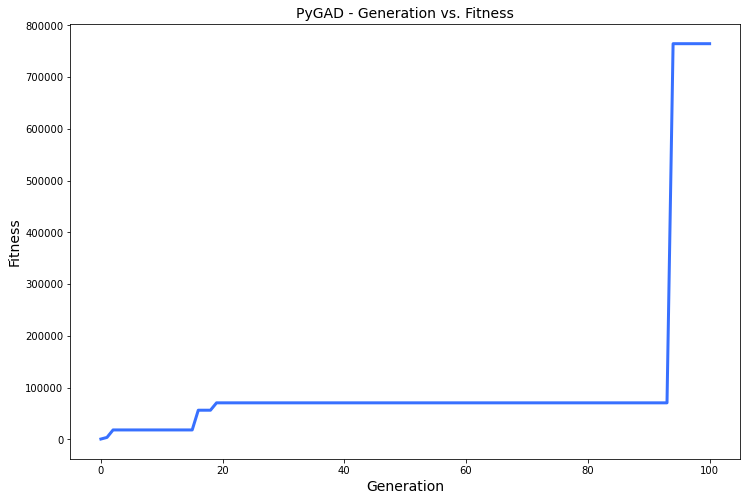

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 9.355 |==================| 3946.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 9.366 |==================| 88.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 9.34 |==================| 68.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 9.349 |==================| 158.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 9.355 |==================| 2541.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 9.337 |==================| 54.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 9.356 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 23.927 |==================| 22.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.992 |==================| 51.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.002 |==================| 33.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.975 |==================| 313.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 23.96 |==================| 83.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |==================| 25.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 23.871 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.002 |==================| 33.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.975 |==================| 313.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 23.96 |==================| 83.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |==================| 25.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 23.871 |==================| 9.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 23.998 |==================| 39.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.98 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.975 |==================| 313.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 23.96 |==================| 83.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.933 |==================| 25.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 23.871 |==================| 9.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 23.998 |==================| 39.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.98 |==================| 127.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.972 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 23.869 |==================| 9.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.014 |==================| 24.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.94 |==================| 31.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.916 |==================| 17.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 23.904 |==================| 14.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.972 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.94 |==================| 31.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.916 |==================| 17.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 23.904 |==================| 14.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.972 |==================| 25043.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.001 |==================| 34.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 23.947 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.987 |==================| 69.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.021 |==================| 20.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==================| 58.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.962 |==================| 99.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 23.912 |==================| 16.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 23.924 |==================| 20.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 23.897 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.021 |==================| 20.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==================| 58.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.962 |==================| 99.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 23.912 |==================| 16.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 23.924 |==================| 20.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 23.897 |==================| 13.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==================| 58.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.962 |==================| 99.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 23.912 |==================| 16.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 23.924 |==================| 20.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 23.897 |==================| 13.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.015 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 23.999 |==================| 37.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.975 |==================| 360.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 23.948 |==================| 41.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 23.908 |==================| 15.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.931 |==================| 24.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.778 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 23.948 |==================| 41.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 23.908 |==================| 15.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.931 |==================| 24.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 23.878 |==================| 10.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.021 |==================| 20.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.986 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.001 |==================| 34.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.973 |==================| 2318.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.011 |==================| 25.656 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.939 |==================| 30.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 23.898 |==================| 13.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 23.916 |==================| 17.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 23.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.973 |==================| 2318.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.011 |==================| 25.656 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.939 |==================| 30.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 23.898 |==================| 13.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 23.916 |==================| 17.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 23.933 |==================| 25.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 23.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.005 |==================| 31.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 23.95 |==================| 44.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 23.902 |==================| 14.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.939 |==================| 29.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.964 |==================| 123.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 23.902 |==================| 14.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 23.939 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 23.902 |==================| 14.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.939 |==================| 29.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 23.964 |==================| 123.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 23.902 |==================| 14.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 23.939 |==================| 29.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 23.895 |==================| 12.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.929 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 23.902 |==================| 14.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 23.939 |==================| 29.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 23.895 |==================| 12.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 23.929 |==================| 23.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.981 |==================| 115.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 23.999 |==================| 36.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.007 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.962 |==================| 98.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 23.883 |==================| 11.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.978 |==================| 187.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.017 |==================| 22.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 23.916 |==================| 17.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.964 |==================| 121.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 23.931 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.978 |==================| 187.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.017 |==================| 22.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 23.916 |==================| 17.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.964 |==================| 121.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 23.931 |==================| 24.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.896 |===========| 23.931 |==================| 24.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 23.932 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 23.995 |==================| 43.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |==================| 13.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 23.891 |==================| 12.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.952 |==================| 49.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 23.91 |==================| 16.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 23.906 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |==================| 13.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 23.891 |==================| 12.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.952 |==================| 49.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 23.91 |==================| 16.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 23.906 |==================| 15.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.0 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 23.891 |==================| 12.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.952 |==================| 49.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 23.987 |==================| 67.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 23.91 |==================| 16.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 23.906 |==================| 15.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.0 |==================| 35.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 23.965 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.002 |==================| 33.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |==================| 42.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.884 |==================| 11.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 23.89 |==================| 12.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 23.899 |==================| 13.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.605 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 23.89 |==================| 12.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 23.899 |==================| 13.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 23.911 |==================| 16.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.991 |==================| 53.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 23.917 |==================| 18.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.903 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.01 |==================| 26.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 23.872 |==================| 9.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 23.897 |==================| 13.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.012 |==================| 25.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.966 |==================| 162.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.923 |==================| 20.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.99 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 23.872 |==================| 9.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 23.897 |==================| 13.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.012 |==================| 25.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.966 |==================| 162.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 23.923 |==================| 20.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.99 |==================| 56.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 23.886 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.871 |==================| 9.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 23.935 |==================| 26.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 23.996 |==================| 41.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 23.984 |==================| 88.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.972 |==================| 5800.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.993 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.871 |==================| 9.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 23.935 |==================| 26.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 23.996 |==================| 41.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 23.984 |==================| 88.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.972 |==================| 5800.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.993 |==================| 48.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.986 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 23.935 |==================| 26.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 23.996 |==================| 41.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 23.984 |==================| 88.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.972 |==================| 5800.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.993 |==================| 48.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.986 |==================| 73.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.021 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 23.979 |==================| 147.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.868 |==================| 9.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 23.886 |==================| 11.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 23.968 |==================| 249.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 23.949 |==================| 42.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.941 |==================| 32.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 23.89 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.868 |==================| 9.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 23.886 |==================| 11.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 23.968 |==================| 249.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 23.949 |==================| 42.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 23.941 |==================| 32.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 23.89 |==================| 12.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 23.883 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 23.892 |==================| 12.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 23.883 |==================| 11.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.007 |==================| 28.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 23.9 |==================| 13.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 23.927 |==================| 21.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.001 |==================| 34.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 23.881 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.007 |==================| 28.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 23.9 |==================| 13.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 23.927 |==================| 21.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.001 |==================| 34.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 23.881 |==================| 10.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.008 |==================| 28.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 23.995 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 23.9 |==================| 13.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 23.927 |==================| 21.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.001 |==================| 34.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 23.881 |==================| 10.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.008 |==================| 28.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 23.995 |==================| 43.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 23.985 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 23.984 |==================| 82.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.934 |==================| 26.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.017 |==================| 22.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 23.98 |==================| 131.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 23.906 |==================| 15.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.01 |==================| 26.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 23.923 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.934 |==================| 26.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.017 |==================| 22.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 23.98 |==================| 131.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 23.906 |==================| 15.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.01 |==================| 26.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 23.923 |==================| 20.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 23.878 |==================| 10.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.964 |==================| 116.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |==================| 13.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 23.984 |==================| 85.867 |==========
Generation = 15
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.001 |==================| 35.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.948 |==================| 40.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |==================| 13.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 23.984 |==================| 85.867 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.001 |==================| 35.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 23.948 |==================| 40.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.98 |==================| 123.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 23.997 |==================| 41.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 23.88 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 23.984 |==================| 85.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 23.879 |==================| 10.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.98 |==================| 129.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 23.996 |==================| 41.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 23.986 |==================| 70.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 23.898 |==================| 13.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.868 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 23.879 |==================| 10.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.98 |==================| 129.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 23.996 |==================| 41.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 23.986 |==================| 70.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 23.898 |==================| 13.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.868 |==================| 9.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 23.894 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 23.986 |==================| 70.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 23.898 |==================| 13.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.868 |==================| 9.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 23.894 |==================| 12.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.943 |==================| 34.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 23.995 |==================| 43.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 23.914 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.99 |==================| 55.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 23.869 |==================| 9.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.99 |==================| 57.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.979 |==================| 156.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 23.888 |==================| 11.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 23.957 |==================| 65.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.936 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.99 |==================| 57.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.979 |==================| 156.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 23.888 |==================| 11.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 23.957 |==================| 65.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.936 |==================| 27.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.012 |==================| 25.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.975 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 23.89 |==================| 12.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 23.887 |==================| 11.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.019 |==================| 21.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==================| 58.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 23.97 |==================| 413.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 23.872 |==================| 10.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.946 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 23.887 |==================| 11.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.019 |==================| 21.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==================| 58.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 23.97 |==================| 413.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 23.872 |==================| 10.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.946 |==================| 38.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 23.978 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.019 |==================| 21.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 23.989 |==================| 58.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 23.97 |==================| 413.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 23.872 |==================| 10.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 23.946 |==================| 38.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 23.978 |==================| 172.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 23.877 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.013 |==================| 24.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 23.912 |==================| 16.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 110.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 23.919 |==================| 18.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 23.989 |==================| 59.766 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.943 |==================| 34.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 110.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 23.919 |==================| 18.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 23.989 |==================| 59.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.943 |==================| 34.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 23.996 |==================| 42.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 23.982 |==================| 102.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.977 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.024 |==================| 19.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.988 |==================| 63.153 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.87 |==================| 9.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 23.935 |==================| 26.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 23.976 |==================| 252.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.018 |==================| 21.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.87 |==================| 9.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 23.935 |==================| 26.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 23.976 |==================| 252.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.018 |==================| 21.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.92 |==================| 19.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 23.913 |==================| 16.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.951 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.01 |==================| 26.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.976 |==================| 294.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.889 |==================| 12.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 23.982 |==================| 103.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 23.986 |==================| 74.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.959 |==================| 75.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.976 |==================| 294.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.889 |==================| 12.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 23.982 |==================| 103.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 23.986 |==================| 74.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.959 |==================| 75.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |==================| 13.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.977 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 23.986 |==================| 74.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 23.959 |==================| 75.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 23.896 |==================| 13.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.977 |==================| 210.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.022 |==================| 20.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.022 |==================| 20.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.013 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 23.983 |==================| 93.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.961 |==================| 84.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 23.983 |==================| 96.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.926 |==================| 21.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 23.943 |==================| 34.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 23.89 |==================| 12.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.009 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.961 |==================| 84.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 23.983 |==================| 96.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.926 |==================| 21.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 23.943 |==================| 34.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 23.89 |==================| 12.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.009 |==================| 27.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.008 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.973 |==================| 4374.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 23.929 |==================| 23.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 23.921 |==================| 19.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 23.877 |==================| 10.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.902 |==================| 14.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 23.891 |==================| 12.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |===========

======| 0.91 |===========| 23.929 |==================| 23.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 23.921 |==================| 19.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 23.877 |==================| 10.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.902 |==================| 14.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 23.891 |==================| 12.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |==================| 28.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 23.881 |==================| 10.992 |==========
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.902 |==================| 14.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 23.891 |==================| 12.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |==================| 28.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 23.881 |==================| 10.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.919 |==================| 18.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 23.933 |==================| 25.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 23.913 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.024 |==================| 19.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 23.918 |==================| 18.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 23.903 |==================| 14.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 23.875 |==================| 10.303 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 23.948 |==================| 40.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.006 |==================| 30.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 23.875 |==================| 10.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 23.948 |==================| 40.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.006 |==================| 30.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 23.884 |==================| 11.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.975 |==================| 440.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 23.98 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.92 |==================| 19.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 23.93 |==================| 23.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.016 |==================| 23.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.01 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 23.93 |==================| 23.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 23.996 |==================| 42.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.016 |==================| 23.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.01 |==================| 26.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 23.99 |==================| 56.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 23.947 |==================| 39.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.956 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.974 |==================| 657.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 23.995 |==================| 44.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 23.868 |==================| 9.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 23.995 |==================| 44.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 23.915 |==================| 17.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.0 |==================| 36.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.013 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 23.868 |==================| 9.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 23.995 |==================| 44.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 23.915 |==================| 17.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.0 |==================| 36.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.013 |==================| 24.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.001 |==================| 34.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.0 |==================| 36.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.013 |==================| 24.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.001 |==================| 34.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.017 |==================| 22.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.006 |==================| 29.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.015 |==================| 23.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 23.993 |==================| 49.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.947 |==================| 39.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.018 |==================| 21.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.923 |==================| 20.454 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |==================| 138.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 23.987 |==================| 66.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 23.923 |==================| 20.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |==================| 138.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 23.987 |==================| 66.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 23.884 |==================| 11.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.919 |==================| 18.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 23.918 |==================| 18.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.91 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.009 |==================| 27.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 23.874 |==================| 10.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 23.878 |==================| 10.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.017 |==================| 22.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.984 |==================| 87.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.927 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 23.874 |==================| 10.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 23.878 |==================| 10.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.017 |==================| 22.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.981 |==================| 109.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.984 |==================| 87.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.927 |==================| 22.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.015 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 23.902 |==================| 14.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 23.89 |==================| 12.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.926 |==================| 21.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.007 |==================| 28.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.99 |==================| 55.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.922 |==================| 20.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 23.899 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.926 |==================| 21.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.007 |==================| 28.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 23.99 |==================| 55.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.922 |==================| 20.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 23.899 |==================| 13.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.971 |==================| 1127.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.985 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.922 |==================| 20.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 23.899 |==================| 13.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.971 |==================| 1127.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.985 |==================| 79.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 23.981 |==================| 120.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 23.948 |==================| 41.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 23.874 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |==================| 895.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 23.878 |==================| 10.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 23.998 |==================| 39.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 104.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 23.994 |==================| 46.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.988 |==================| 64.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 23.999 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 23.878 |==================| 10.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 23.998 |==================| 39.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 104.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 23.994 |==================| 46.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.988 |==================| 64.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 23.999 |==================| 37.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.012 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |==================| 19.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 23.876 |==================| 10.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 23.998 |==================| 38.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 23.932 |==================| 25.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.013 |==================| 24.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 23.999 |==================| 37.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 23.909 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 23.876 |==================| 10.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 23.998 |==================| 38.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 23.932 |==================| 25.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.013 |==================| 24.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 23.999 |==================| 37.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 23.909 |==================| 15.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.87 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 23.998 |==================| 38.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 23.932 |==================| 25.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.013 |==================| 24.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 23.999 |==================| 37.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 23.909 |==================| 15.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.87 |==================| 9.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 23.914 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.017 |==================| 22.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 23.932 |==================| 24.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 23.899 |==================| 13.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.974 |==================| 792.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 23.964 |==================| 119.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 23.882 |==================| 11.049 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 23.932 |==================| 24.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 23.899 |==================| 13.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 23.974 |==================| 792.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 23.964 |==================| 119.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 23.882 |==================| 11.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.942 |==================| 33.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 23.884 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 23.911 |==================| 16.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.009 |==================| 27.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.01 |==================| 26.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.021 |==================| 20.661 |==========
Generation = 33
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.021 |==================| 20.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.017 |==================| 22.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.009 |==================| 27.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.01 |==================| 26.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.021 |==================| 20.661 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.021 |==================| 20.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.017 |==================| 22.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.956 |==================| 61.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.006

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.01 |==================| 26.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.021 |==================| 20.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 23.982 |==================| 104.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 23.922 |==================| 19.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 23.984 |==================| 85.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.977 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.934 |==================| 25.955 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 23.982 |==================| 104.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 23.922 |==================| 19.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 23.984 |==================| 85.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.977 |==================| 195.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 23.938 |==================| 29.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 23.982 |==================| 104.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 23.922 |==================| 19.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 23.984 |==================| 85.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.977 |==================| 195.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 23.968 |==================| 255.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 23.983 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 23.962 |==================| 93.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 23.99 |==================| 55.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.958 |==================| 68.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.016 |==================| 22.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 23.879 |==================| 10.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 23.998 |==================| 38.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 23.965 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 23.99 |==================| 55.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.958 |==================| 68.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.016 |==================| 22.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 23.879 |==================| 10.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 23.998 |==================| 38.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 23.965 |==================| 145.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.015 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 23.982 |==================| 101.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.941 |==================| 32.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 23.989 |==================| 60.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |==================| 52.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.014 |==================| 24.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 23.998 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.941 |==================| 32.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 23.989 |==================| 60.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |==================| 52.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.014 |==================| 24.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 23.998 |==================| 39.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 23.997 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 23.989 |==================| 60.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.953 |==================| 52.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.014 |==================| 24.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 23.998 |==================| 39.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 23.997 |==================| 39.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.99 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.021 |==================| 20.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 23.915 |==================| 17.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.013 |==================| 24.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.008 |==================| 27.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.889 |==================| 12.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==================| 25.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 23.983 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 23.915 |==================| 17.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.013 |==================| 24.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.008 |==================| 27.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.889 |==================| 12.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==================| 25.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 23.983 |==================| 93.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.927 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.936 |==================| 27.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.01 |==================| 26.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 23.953 |==================| 51.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==================| 390.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.934 |==================| 26.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.991 |==================| 54.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 23.984 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 23.97 |==================| 390.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 23.934 |==================| 26.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.991 |==================| 54.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 23.984 |==================| 82.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.935 |==================| 26.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |==================| 19.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.005 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.991 |==================| 54.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 23.984 |==================| 82.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.935 |==================| 26.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 23.922 |==================| 19.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.005 |==================| 30.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 23.979 |==================| 148.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 23.991 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.982 |==================| 107.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 23.991 |==================| 52.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.981 |==================| 116.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.012 |==================| 25.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.975 |==================| 331.652 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 23.991 |==================| 53.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 23.991 |==================| 52.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 23.981 |==================| 116.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 24.012 |==================| 25.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.975 |==================| 331.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 23.991 |==================| 53.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.915 |==================| 17.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.993 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.974 |==================| 526.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.935 |==================| 26.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 23.997 |==================| 40.399 |==========
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.992 |==================| 50.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 23.907 |==================| 15.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.99 |==================| 57.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.935 |==================| 26.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 23.997 |==================| 40.399 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.992 |==================| 50.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 23.907 |==================| 15.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.99 |==================| 57.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.944 |==================| 35.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.972 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.006 |==================| 29.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 24.002 |==================| 33.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 23.964 |==================| 120.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.971 |==================| 1120.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 23.884 |==================| 11.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.005 |==================| 30.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.928 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.971 |==================| 1120.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 23.884 |==================| 11.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.005 |==================| 30.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.928 |==================| 22.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.926 |==================| 21.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.01 |==================| 26.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.987 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 23.884 |==================| 11.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.005 |==================| 30.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.928 |==================| 22.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 23.926 |==================| 21.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.01 |==================| 26.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.987 |==================| 69.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 23.888 |==================| 11.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.972 |==================| 3351.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.014 |==================| 24.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 23.913 |==================| 16.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.022 |==================| 20.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 150.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.948 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 23.913 |==================| 16.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.022 |==================| 20.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 23.979 |==================| 150.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.948 |==================| 41.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 23.868 |==================| 9.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 23.966 |==================| 166.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.993 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 23.994 |==================| 45.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 23.943 |==================| 33.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.006 |==================| 29.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.95 |==================| 45.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.918 |==================| 18.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.011 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.006 |==================| 29.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.95 |==================| 45.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.918 |==================| 18.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.011 |==================| 26.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.981 |==================| 118.405 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.944 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.011 |==================| 26.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.981 |==================| 118.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.945 |==================| 37.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.004 |==================| 31.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 23.874 |==================| 10.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.018 |==================| 22.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.004 |==================| 31.996 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.945 |==================| 37.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.004 |==================| 31.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 23.874 |==================| 10.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 21.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.004 |==================| 31.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 23.874 |==================| 10.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 21.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 23.955 |==================| 59.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 23.963 |==================| 104.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.99 |==================| 56.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 23.989 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 23.915 |==================| 17.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.014 |==================| 24.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 23.91 |==================| 15.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 23.89 |==================| 12.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.921 |==================| 19.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.015 |==================| 23.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.005 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.014 |==================| 24.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 23.91 |==================| 15.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 23.89 |==================| 12.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.921 |==================| 19.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.015 |==================| 23.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.005 |==================| 30.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 23.963 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.017 |==================| 22.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.004 |==================| 31.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.005 |==================| 30.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 23.888 |==================| 11.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.907 |==================| 15.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.959 |==================| 76.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.015 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.004 |==================| 31.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.005 |==================| 30.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 23.888 |==================| 11.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.907 |==================| 15.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.959 |==================| 76.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.015 |==================| 23.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.952 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.005 |==================| 30.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 23.888 |==================| 11.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.907 |==================| 15.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.959 |==================| 76.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.015 |==================| 23.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.952 |==================| 49.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 23.918 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 23.887 |==================| 11.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 23.88 |==================| 10.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 23.873 |==================| 10.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 23.873 |==================| 10.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.002 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 23.88 |==================| 10.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 23.873 |==================| 10.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.953 |==================| 52.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 23.873 |==================| 10.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.002 |==================| 34.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 23.889 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.904 |==================| 14.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 23.997 |==================| 40.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 23.981 |==================| 120.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.873 |==================| 10.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |==================| 642.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 23.894 |==================| 12.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.871 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 23.997 |==================| 40.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 23.981 |==================| 120.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 23.873 |==================| 10.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |==================| 642.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 23.894 |==================| 12.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.871 |==================| 9.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.921 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |==================| 642.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 23.894 |==================| 12.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.871 |==================| 9.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.921 |==================| 19.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.954 |==================| 53.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 23.966 |==================| 158.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 23.99 |==================| 55.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 23.915 |==================| 17.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 23.94 |==================| 30.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.896 |==================| 13.027 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==================| 25.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 23.872 |==================| 10.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 23.915 |==================| 17.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 23.94 |==================| 30.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.896 |==================| 13.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==================| 25.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 23.872 |==================| 10.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.012 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 23.878 |==================| 10.604 |==========
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 23.943 |==================| 33.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.955 |==================| 57.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.02 |==================| 21.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.017 |==================| 22.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.958 |==================| 72.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 23.943 |==================| 33.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.955 |==================| 57.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.02 |==================| 21.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.017 |==================| 22.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.958 |==================| 72.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.989 |==================| 61.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.889 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 23.883 |==================| 11.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 23.93 |==================| 23.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.014 |==================| 23.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 23.943 |==================| 34.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.02 |==================| 21.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.873 |==================| 10.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 23.912 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 23.943 |==================| 34.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.02 |==================| 21.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.873 |==================| 10.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 23.912 |==================| 16.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.019 |==================| 21.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.971 |==================| 977.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 23.978 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.873 |==================| 10.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 23.912 |==================| 16.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.019 |==================| 21.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.971 |==================| 977.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 23.978 |==================| 169.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 23.908 |==================| 15.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 23.936 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 23.876 |==================| 10.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.988 |==================| 63.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 23.937 |==================| 28.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.991 |==================| 53.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 23.885 |==================| 11.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.895 |==================| 12.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 23.93 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 23.885 |==================| 11.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.895 |==================| 12.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 23.93 |==================| 23.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.976 |==================| 269.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.023 |==================| 19.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 23.926 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==================| 217.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 23.984 |==================| 82.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.014 |==================| 23.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 23.895 |==================| 12.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 23.98 |==================| 134.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 23.998 |==================| 38.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.947 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 23.895 |==================| 12.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 23.98 |==================| 134.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 23.998 |==================| 38.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.947 |==================| 40.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.944 |==================| 35.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.874 |==================| 10.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.02 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.014 |==================| 24.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.91 |==================| 15.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 23.964 |==================| 125.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.979 |==================| 140.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 19.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.946 |==================| 37.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.977 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.023 |==================| 19.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.946 |==================| 37.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.977 |==================| 225.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 23.997 |==================| 39.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.993 |==================| 48.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 104.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 23.976 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.946 |==================| 37.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.977 |==================| 225.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 23.997 |==================| 39.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.993 |==================| 48.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 23.982 |==================| 104.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 23.976 |==================| 254.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 23.902 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 23.94 |==================| 30.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 23.921 |==================| 19.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.021 |==================| 20.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.938 |==================| 29.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.974 |==================| 503.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.964 |==================| 115.808 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.021 |==================| 20.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.938 |==================| 29.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.974 |==================| 503.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.964 |==================| 115.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 23.999 |==================| 37.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 23.927 |==================| 21.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.017 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 23.9 |==================| 13.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 23.904 |==================| 14.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.004 |==================| 31.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 23.999 |==================| 37.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.948 |==================| 41.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.008 |==================| 27.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 23.897 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.948 |==================| 41.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.008 |==================| 27.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 23.897 |==================| 13.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.941 |==================| 31.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.935 |==================| 26.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 23.943 |==================| 34.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.961 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.922 |==================| 19.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 23.964 |==================| 126.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.021 |==================| 20.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.972 |==================| 7917.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 23.989 |==================| 59.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 23.926 |==================| 21.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 23.992 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 23.989 |==================| 59.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 23.926 |==================| 21.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 23.992 |==================| 51.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.979 |==================| 140.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 23.888 |==================| 11.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.979 |==================| 140.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 23.888 |==================| 11.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 59.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.951 |==================| 46.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |==================| 867.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.963 |==================| 103.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 23.874 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.006 |==================| 30.093 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.963 |==================| 103.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 23.874 |==================| 10.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.022 |==================| 20.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 23.909 |==================| 15.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.963 |==================| 103.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 23.874 |==================| 10.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.022 |==================| 20.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 23.909 |==================| 15.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.018 |==================| 21.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 23.884 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.004 |==================| 31.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 23.921 |==================| 19.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 23.905 |==================| 14.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 23.995 |==================| 44.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.987 |==================| 69.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 23.899 |==================| 13.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.969 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 23.987 |==================| 69.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 23.899 |==================| 13.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.969 |==================| 351.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 23.937 |==================| 28.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.953 |==================| 53.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.975 |==================| 378.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 23.882 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 23.918 |==================| 18.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.975 |==================| 350.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.872 |==================| 9.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.879 |==================| 10.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 23.982 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 23.918 |==================| 18.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.975 |==================| 350.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.872 |==================| 9.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.879 |==================| 10.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 23.982 |==================| 101.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 23.976 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.975 |==================| 350.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.872 |==================| 9.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.003 |==================| 32.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.879 |==================| 10.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 23.982 |==================| 101.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 23.976 |==================| 254.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 23.893 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.915 |==================| 17.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 23.921 |==================| 19.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 23.916 |==================| 17.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.017 |==================| 22.566 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.975 |==================| 350.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.017 |==================| 22.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 23.921 |==================| 19.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 23.916 |==================| 17.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.017 |==================| 22.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.975 |==================| 350.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.017 |==================| 22.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 23.869 |==================| 9.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 23.998 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 23.947 |==================| 40.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 23.883 |==================| 11.142 |==========
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.016 |==================| 22.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.005 |==================| 30.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 23.93 |==================| 23.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 23.907 |==================| 15.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.005 |==================| 30.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 23.93 |==================| 23.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 23.907 |==================| 15.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 23.991 |==================| 53.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 23.951 |==================| 47.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 23.935 |==================| 26.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 23.993 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 23.957 |==================| 66.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.954 |==================| 54.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.012 |==================| 24.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.019 |==================| 21.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.952 |==================| 50.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.023 |==================| 19.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 23.999 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.019 |==================| 21.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.952 |==================| 50.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.023 |==================| 19.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 23.999 |==================| 38.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 23.987 |==================| 69.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.871 |==================| 9.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 23.965 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 23.999 |==================| 38.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 23.987 |==================| 69.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.871 |==================| 9.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 23.965 |==================| 135.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 23.911 |==================| 16.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.001 |==================| 35.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 23.897 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 23.941 |==================| 32.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 23.982 |==================| 99.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.006 |==================| 29.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.975 |==================| 438.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.966 |==================| 147.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 23.913 |==================| 16.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.934 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 23.982 |==================| 99.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.006 |==================| 29.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.975 |==================| 438.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 23.966 |==================| 147.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 23.913 |==================| 16.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 23.934 |==================| 26.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 23.907 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.013 |==================| 24.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.001 |==================| 34.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 23.987 |==================| 66.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 23.94 |==================| 31.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.932 |==================| 24.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |==================| 28.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.947 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.001 |==================| 34.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 23.987 |==================| 66.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 23.94 |==================| 31.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.932 |==================| 24.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |==================| 28.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.947 |==================| 39.061 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.975 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 23.987 |==================| 66.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 23.94 |==================| 31.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.932 |==================| 24.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |==================| 28.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.947 |==================| 39.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 23.94 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 23.914 |==================| 17.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.02 |==================| 20.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.928 |==================| 22.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 23.948 |==================| 41.222 |==========
Fitness = 25043.63494793189
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 23.94 |==================| 31.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.02 |==================| 20.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.928 |==================| 22.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 23.948 |==================| 41.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 23.94 |==================| 31.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 23.996 |==================| 42.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 23.994 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.016 |==================| 23.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 24.022 |==================| 20.23 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.884 |==================| 11.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.953 |==================| 50.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.924 |==================| 20.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.023 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 24.022 |==================| 20.23 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.884 |==================| 11.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.953 |==================| 50.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.924 |==================| 20.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |==================| 10.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.023 |==================| 19.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 23.944 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.013 |==================| 24.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.976 |==================| 301.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 21.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.975 |==================| 315.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 23.88 |==================| 10.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.023 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.976 |==================| 301.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 21.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.975 |==================| 315.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 23.88 |==================| 10.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.023 |==================| 19.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.902 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 23.925 |==================| 21.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 23.975 |==================| 315.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 23.88 |==================| 10.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.009 |==================| 27.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.023 |==================| 19.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.902 |==================| 14.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 23.911 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 23.917 |==================| 18.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.977 |==================| 221.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.002 |==================| 33.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.937 |==================| 27.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 212.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.019 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.977 |==================| 221.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.002 |==================| 33.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.937 |==================| 27.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.007 |==================| 28.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 212.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.019 |==================| 21.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 23.998 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 23.922 |==================| 19.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.992 |==================| 51.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 23.885 |==================| 11.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 23.914 |==================| 17.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.014 |==================| 23.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 22.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 23.908 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.014 |==================| 23.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 22.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 23.908 |==================| 15.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 23.927 |==================| 21.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.023 |==================| 19.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 22.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 23.908 |==================| 15.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 23.927 |==================| 21.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 24.003 |==================| 32.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.023 |==================| 19.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.932 |==================| 25.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 23.902 |==================| 14.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |==================| 889.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.019 |==================| 21.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 23.892 |==================| 12.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.001 |==================| 35.185 |==========
Fitness = 38277.33744813523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==================| 218.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.973 |==================| 889.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.019 |==================| 21.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 23.892 |==================| 12.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.001 |==================| 35.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.977 |==================| 218.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 23.997 |==================| 40.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 23.998 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.014 |==================| 24.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.972 |==================| 11294.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 23.933 |==================| 25.25 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 23.877 |==================| 10.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 23.986 |==================| 75.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 23.99 |==================| 55.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 23.986 |==================| 75.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 23.99 |==================| 55.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.004 |==================| 31.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.919 |==================| 18.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.922 |==================| 19.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 23.978 |==================| 168.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 23.981 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.007 |==================| 28.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 23.881 |==================| 10.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 23.921 |==================| 19.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 23.996 |==================| 42.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.941 |==================| 32.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 23.999 |==================| 37.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.0 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.941 |==================| 32.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 23.999 |==================| 37.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.0 |==================| 36.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 23.913 |==================| 17.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.017 |==================| 22.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.015 |==================| 23.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.021 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 23.999 |==================| 37.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.0 |==================| 36.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 23.913 |==================| 17.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.017 |==================| 22.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.015 |==================| 23.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.021 |==================| 20.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 23.868 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.024 |==================| 19.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 23.903 |==================| 14.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.951 |==================| 47.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 23.878 |==================| 10.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.946 |==================| 38.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.015 |==================| 23.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 23.903 |==================| 14.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.951 |==================| 47.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 23.878 |==================| 10.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.946 |==================| 38.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.015 |==================| 23.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.007 |==================| 28.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 23.882 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.985 |==================| 79.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 23.928 |==================| 22.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.01 |==================| 26.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 23.873 |==================| 10.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.907 |==================| 15.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.904 |==================| 14.584 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 23.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 23.873 |==================| 10.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.907 |==================| 15.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.904 |==================| 14.584 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 23.993 |==================| 48.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 23.988 |==================| 64.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.012 |==================| 25.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 23.875

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.907 |==================| 15.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.904 |==================| 14.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 23.894 |==================| 12.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.939 |==================| 30.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.87 |==================| 9.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.92 |==================| 19.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.939 |==================| 30.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.87 |==================| 9.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.92 |==================| 19.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |==================| 33.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.936 |==================| 27.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.87 |==================| 9.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.92 |==================| 19.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.003 |==================| 33.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.936 |==================| 27.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 23.991 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 23.957 |==================| 67.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 23.987 |==================| 65.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.01 |==================| 26.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.954 |==================| 54.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.958 |==================| 67.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 23.984 |==================| 83.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 23.897 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.954 |==================| 54.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.958 |==================| 67.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 23.984 |==================| 83.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 23.897 |==================| 13.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.988 |==================| 63.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.01 |==================| 26.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 23.893 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.007 |==================| 29.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.977 |==================| 227.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.944 |==================| 35.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.004 |==================| 31.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.947 |==================| 40.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.007 |==================| 28.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.953 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.977 |==================| 227.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.944 |==================| 35.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.004 |==================| 31.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.947 |==================| 40.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.007 |==================| 28.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.953 |==================| 51.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.021 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.947 |==================| 40.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.007 |==================| 28.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.953 |==================| 51.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.021 |==================| 20.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 216.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 23.926 |==================| 21.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 23.909 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.958 |==================| 68.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.02 |==================| 21.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 23.867 |==================| 9.469 |==========
Fitness = 38277.33744813523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |==================| 21.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 23.879 |==================| 10.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |==================| 59.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.02 |==================| 21.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 23.867 |==================| 9.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |==================| 21.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 23.879 |==================| 10.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |==================| 59.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 23.909 |==================| 15.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 23.889 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.017 |==================| 22.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.952 |==================| 49.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.016 |==================| 23.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.931 |==================| 24.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 23.938 |==================| 29.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 23.912 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 23.952 |==================| 49.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.016 |==================| 23.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 23.931 |==================| 24.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.939 |==================| 30.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 23.938 |==================| 29.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 23.912 |==================| 16.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 23.986 |============

======| 0.469 |===========| 23.975 |==================| 315.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 23.944 |==================| 35.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.003 |==================| 32.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 23.883 |==================| 11.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.977 |==================| 206.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.01 |==================| 26.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.02 |==================| 21.046 |==========
=====|SOLUTION|===========|OUTPUT|=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.003 |==================| 32.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 23.883 |==================| 11.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.977 |==================| 206.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.01 |==================| 26.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.02 |==================| 21.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.991 |==================| 54.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.004 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.977 |==================| 206.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.01 |==================| 26.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.02 |==================| 21.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.991 |==================| 54.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.004 |==================| 31.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.015 |==================| 23.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 23.888 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 23.872 |==================| 9.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 23.896 |==================| 13.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.001 |==================| 35.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 23.911 |==================| 16.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 23.878 |==================| 10.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.895 |==================| 12.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.008 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.001 |==================| 35.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 23.911 |==================| 16.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 23.878 |==================| 10.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.895 |==================| 12.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.008 |==================| 27.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.982 |==================| 108.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.952 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 23.874 |==================| 10.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.962 |==================| 93.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 23.894 |==================| 12.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 23.905 |==================| 14.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.002 |==================| 33.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 23.885 |==================| 11.45 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.92

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 23.905 |==================| 14.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.002 |==================| 33.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 23.885 |==================| 11.45 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 23.928 |==================| 22.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 23.973 |==================| 3980.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 23.893 |==================| 12.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 23.919

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.002 |==================| 33.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 23.885 |==================| 11.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 23.987 |==================| 67.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.014 |==================| 23.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 22.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 23.911 |==================| 16.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 23.878 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 23.987 |==================| 67.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.014 |==================| 23.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 22.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 23.911 |==================| 16.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 23.878 |==================| 10.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 23.987 |==================| 68.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.005 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.016 |==================| 22.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 23.911 |==================| 16.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 23.878 |==================| 10.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 23.987 |==================| 68.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.005 |==================| 30.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 23.996 |==================| 43.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 23.917 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 23.919 |==================| 18.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 23.994 |==================| 45.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 23.951 |==================| 47.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.004 |==================| 31.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.011 |==================| 25.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.001 |==================| 34.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.868 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.011 |==================| 25.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.001 |==================| 34.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.868 |==================| 9.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.021 |==================| 20.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.001 |==================| 34.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.007 |==================| 28.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 23.99 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.02 |==================| 20.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 23.898 |==================| 13.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.988 |==================| 63.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 23.969 |==================| 327.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 23.881 |==================| 10.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.975 |==================| 436.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.001 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 23.969 |==================| 327.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 23.881 |==================| 10.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.975 |==================| 436.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.001 |==================| 34.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.017 |==================| 22.171 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.956 |==================| 60.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 23.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.975 |==================| 436.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.001 |==================| 34.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.017 |==================| 22.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.929 |==================| 23.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.985 |==================| 78.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.01 |==================| 26.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.001 |==================| 35.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 23.892 |==================| 12.423 |==========
Fitness = 38277.33744813523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.929 |==================| 23.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.985 |==================| 78.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.01 |==================| 26.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |==================| 21.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 23.929 |==================| 23.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.985 |==================| 78.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.01 |==================| 26.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.02 |==================| 21.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.916 |==================| 17.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.957 |==================| 63.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.918 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 23.944 |==================| 35.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.992 |==================| 51.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 23.921 |==================| 19.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 23.998 |==================| 39.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.914 |==================| 17.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.004 |==================| 31.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.99 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 23.914 |==================| 17.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.004 |==================| 31.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.99 |==================| 56.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 23.867 |==================| 9.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.023 |==================| 19.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.005 |==================| 30.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.973 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.02 |==================| 20.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 23.995 |==================| 43.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 23.875 |==================| 10.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.929 |==================| 22.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.975 |==================| 333.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.974 |==================| 476.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.91 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.975 |==================| 333.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 23.974 |==================| 476.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.91 |==================| 16.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 23.912 |==================| 16.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.985 |==================| 80.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 23.998 |==================| 39.543 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.97

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.91 |==================| 16.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 23.912 |==================| 16.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.985 |==================| 80.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 23.998 |==================| 39.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 23.882 |==================| 11.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 23.918 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 23.867 |==================| 9.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.932 |==================| 24.955 |==========
Fitness = 38277.33744813523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 23.882 |==================| 11.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 23.918 |==================| 18.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 23.971 |==================| 904.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 23.932 |==================| 24.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 23.882 |==================| 11.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 24.008 |==================| 28.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 23.918 |==================| 18.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 23.971 |==================| 904.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.014 |==================| 24.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 23.896 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 23.894 |==================| 12.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.023 |==================| 19.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.016 |==================| 22.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 23.91 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.989 |==================| 60.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.0 |==================| 36.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.016 |==================| 22.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 23.91 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.989 |==================| 60.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.0 |==================| 36.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.873 |==================| 10.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.022 |==================| 20.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.978 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.014 |==================| 23.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.022 |==================| 20.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.988 |==================| 63.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 213.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 59.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.014 |==================| 23.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.022 |==================| 20.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.988 |==================| 63.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 213.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 59.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.014 |==================| 23.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |==================| 42.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.023 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.988 |==================| 63.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 23.977 |==================| 213.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 23.989 |==================| 59.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.014 |==================| 23.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |==================| 42.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.023 |==================| 19.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 23.957 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 23.98 |==================| 136.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.926 |==================| 21.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 23.908 |==================| 15.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 23.886 |==================| 11.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.933 |==================| 25.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.018 |==================| 22.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.017 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 23.886 |==================| 11.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.933 |==================| 25.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.018 |==================| 22.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.017 |==================| 22.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 23.875 |==================| 10.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.008 |==================| 28.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.02 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.978 |==================| 189.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 23.985 |==================| 76.775 |==========
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.0 |==================| 36.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.993 |==================| 48.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 23.9 |==================| 13.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 23.941 |==================| 31.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 23.876 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 23.9 |==================| 13.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 23.941 |==================| 31.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 23.876 |==================| 10.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 23.989 |==================| 59.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 23.91 |==================| 15.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.005 |==================| 30.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 23.89 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.005 |==================| 30.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 23.944 |==================| 35.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.005 |==================| 30.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 23.991 |==================| 52.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 23.914 |==================| 17.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.942 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 23.914 |==================| 17.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.942 |==================| 33.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.96 |==================| 84.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |==================| 138.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 23.994 |==================| 45.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.024 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.886 |==================| 11.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 23.942 |==================| 33.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 23.96 |==================| 84.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 23.98 |==================| 138.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 23.994 |==================| 45.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.024 |==================| 19.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.954 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 23.993 |==================| 48.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.958 |==================| 68.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.974 |==================| 721.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.019 |==================| 21.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.005 |==================| 30.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 23.894 |==================| 12.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.98 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.958 |==================| 68.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 23.974 |==================| 721.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.019 |==================| 21.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.005 |==================| 30.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 23.894 |==================| 12.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 23.98 |==================| 128.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.949 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.005 |==================| 30.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 23.874 |==================| 10.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.022 |==================| 19.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 23.981 |==================| 111.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.903 |==================| 14.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 23.869 |==================| 9.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 23.981 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 23.874 |==================| 10.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.022 |==================| 19.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 23.981 |==================| 111.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.903 |==================| 14.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 23.869 |==================| 9.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 23.981 |==================| 111.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.947 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.903 |==================| 14.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 23.869 |==================| 9.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 23.981 |==================| 111.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.947 |==================| 39.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.955 |==================| 58.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.921 |==================| 19.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.019 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.955 |==================| 58.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 23.921 |==================| 19.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.019 |==================| 21.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 23.917 |==================| 18.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.979 |==================| 160.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 23.984 |==================| 81.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.951 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.979 |==================| 160.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 23.984 |==================| 81.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.951 |==================| 46.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.933 |==================| 25.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.005 |==================| 30.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 23.908 |==================| 15.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 23.87 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 24.012 |==================| 25.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 23.908 |==================| 15.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 23.905 |==================| 14.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 23.892 |==================| 12.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 23.907 |==================| 15.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 23.982 |==================| 101.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.924 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 23.907 |==================| 15.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 23.982 |==================| 101.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.924 |==================| 20.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 23.901 |==================| 14.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.015 |==================| 23.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.022 |==================| 20.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 23.913 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 23.964 |==================| 120.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 23.87 |==================| 9.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.018 |==================| 21.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.021 |==================| 20.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 23.888 |==================| 11.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 23.901 |==================| 14.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 23.879 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.018 |==================| 21.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 24.021 |==================| 20.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 23.888 |==================| 11.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 23.901 |==================| 14.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 23.879 |==================| 10.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |==================| 621.895 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.013

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 23.901 |==================| 14.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 23.879 |==================| 10.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.971 |==================| 621.895 |==========


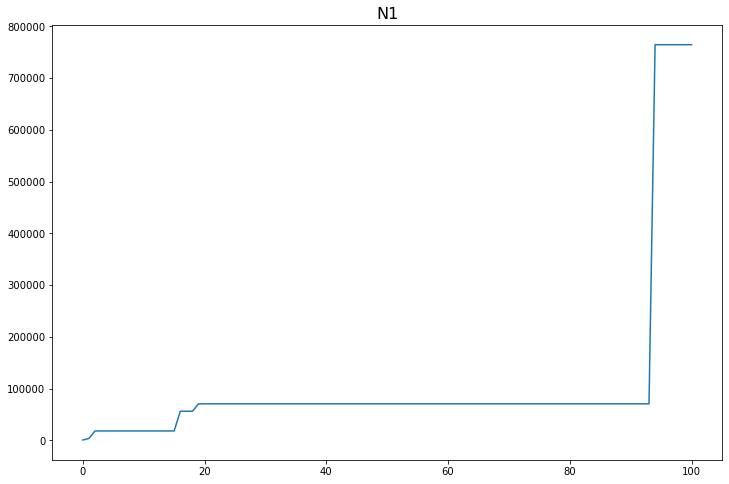

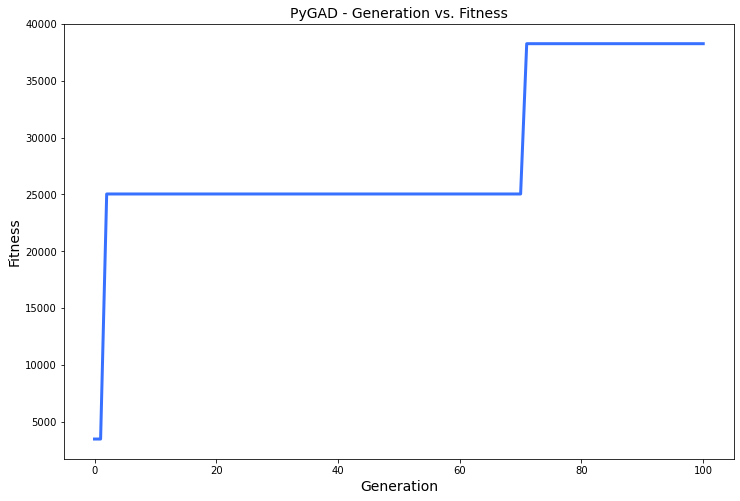

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.013 |==================| 24.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 23.894 |==================| 12.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 23.892 |==================| 12.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 23.942 |==================| 33.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 23.928 |==================| 22.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.958 |==================| 69.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 23.879 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.882 |==================| 35.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.783 |==================| 14.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.792 |==================| 16.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.836 |==================| 53.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 28.632 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 28.877 |==================| 44.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.836 |==================| 53.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 28.632 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 28.877 |==================| 44.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |==================| 11.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.913 |==================| 17.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.854 |==================| 3443.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.908 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 28.877 |==================| 44.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |==================| 11.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.913 |==================| 17.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.854 |==================| 3443.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.908 |==================| 18.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 28.782 |==================| 13.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.923 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 28.637 |==================| 4.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 28.943 |==================| 11.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 28.637 |==================| 4.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 28.681 |==================| 5.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.857 |==================| 335.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.718 |==================| 7.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.961 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 28.681 |==================| 5.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.857 |==================| 335.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.718 |==================| 7.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.961 |==================| 9.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 28.706 |==================| 6.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 28.742 |==================| 8.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 28.703 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.836 |==================| 55.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.932 |==================| 12.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.964 |==================| 9.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.907 |==================| 18.908 |==========
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.713 |==================| 7.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.923 |==================| 14.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.883

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.932 |==================| 12.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.964 |==================| 9.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.907 |==================| 18.908 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.713 |==================| 7.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.923 |==================| 14.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.883 |==================| 34.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 28.584 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.85 |==================| 217.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 28.634 |==================| 4.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 28.681 |==================| 5.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.848 |==================| 156.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 28.785 |==================| 14.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.938 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.848 |==================| 156.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 28.785 |==================| 14.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.938 |==================| 12.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 28.794 |==================| 16.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 28.587 |==================| 3.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 28.82 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.938 |==================| 12.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 28.794 |==================| 16.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 28.587 |==================| 3.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 28.82 |==================| 28.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.932 |==================| 12.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.9 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 28.653 |==================| 4.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.924 |==================| 14.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 28.658 |==================| 5.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 28.658 |==================| 5.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.92 |==================| 15.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 28.849 |==================| 184.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.785 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.92 |==================| 15.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 28.849 |==================| 184.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.785 |==================| 14.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.924 |==================| 14.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================| 10.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.817 |==================| 27.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.836 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.926 |==================| 13.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |==================| 17.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 28.571 |==================| 3.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.821 |==================| 30.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.862 |==================| 125.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.798 |==================| 17.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 28.841 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.911 |==================| 17.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 28.571 |==================| 3.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.821 |==================| 30.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.862 |==================| 125.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.798 |==================| 17.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 28.841 |==================| 78.03 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 28.666 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.798 |==================| 17.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 28.841 |==================| 78.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.82 |==================| 29.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.589 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.968 |==================| 8.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 28.847 |==================| 131.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.823 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.589 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.968 |==================| 8.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 28.847 |==================| 131.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.823 |==================| 32.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.894 |==================| 25.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.87 |==================| 61.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.941 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.823 |==================| 32.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.894 |==================| 25.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.87 |==================| 61.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.941 |==================| 11.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.962 |==================| 9.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.91 |==================| 18.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 28.678 |==================| 5.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 28.663 |==================| 5.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.905 |==================| 19.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.677 |==================| 5.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.884 |==================| 33.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 28.815 |==================| 25.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.744 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 28.677 |==================| 5.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.884 |==================| 33.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 28.815 |==================| 25.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.744 |==================| 9.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.851 |==================| 354.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.853 |==================| 638.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 28.584 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 28.636 |==================| 4.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.87 |==================| 61.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 28.635 |==================| 4.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.737 |==================| 8.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.408 |==========
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.885 |==================| 32.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 28.867 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.737 |==================| 8.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.408 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.885 |==================| 32.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 28.867 |==================| 80.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.969 |==================| 8.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 28.772 |==================| 12.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 28.713 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.837 |==================| 58.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.708 |==================| 6.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.95 |==================| 10.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 131.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.905 |==================| 19.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.846 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 28.708 |==================| 6.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.95 |==================| 10.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 131.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.905 |==================| 19.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.846 |==================| 117.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.786 |==================| 14.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 131.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.905 |==================| 19.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.846 |==================| 117.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.786 |==================| 14.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 28.719 |==================| 7.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.942 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 28.946 |==================| 10.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.774 |==================| 12.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.947 |==================| 10.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.598 |==================| 3.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.811 |==================| 23.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.934 |==================| 12.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.945 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.947 |==================| 10.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 28.598 |==================| 3.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.811 |==================| 23.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.934 |==================| 12.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.945 |==================| 11.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 28.841 |==================| 78.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 28.711 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.893 |==================| 25.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.895 |==================| 24.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 28.813 |==================| 24.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 28.758 |==================| 10.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.962 |==================| 9.316 |==========
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.96

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 28.758 |==================| 10.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.962 |==================| 9.316 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.965 |==================| 9.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.963 |==================| 9.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 28.948 |==================| 10.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 28.962 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.887 |==================| 30.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 28.695 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.851 |==================| 289.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.894 |==================| 24.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.823 |==================| 31.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 28.795 |==================| 16.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 28.627 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 28.695 |==================| 6.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.851 |==================| 289.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.894 |==================| 24.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.823 |==================| 31.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 28.795 |==================| 16.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 28.627 |==================| 4.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.937 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.894 |==================| 24.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 28.823 |==================| 31.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 28.795 |==================| 16.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 28.627 |==================| 4.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.937 |==================| 12.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.954 |==================| 10.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.864 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 28.654 |==================| 4.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.888 |==================| 29.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.74 |==================| 8.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 28.634 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 28.73 |==================| 8.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.967 |==================| 8.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 28.711 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 28.888 |==================| 29.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.74 |==================| 8.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 28.634 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 28.73 |==================| 8.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.967 |==================| 8.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 28.711 |==================| 6.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 28.839 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 28.82 |==================| 29.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.891 |==================| 27.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.918 |==================| 15.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.932 |==================| 12.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.953 |==================| 10.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |==================| 11.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 28.918 |==================| 15.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.932 |==================| 12.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.953 |==================| 10.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |==================| 11.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |==================| 44.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.824 |==================| 33.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.932 |==================| 12.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.953 |==================| 10.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |==================| 11.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |==================| 44.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.824 |==================| 33.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.896 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 28.773 |==================| 12.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.95 |==================| 10.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.843 |==================| 87.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.891 |==================| 26.858 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.893 |==================| 26.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.764 |==================| 11.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.95 |==================| 10.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.843 |==================| 87.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.891 |==================| 26.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.893 |==================| 26.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.764 |==================| 11.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.962 |==================| 9.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.95 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.791 |==================| 15.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 28.71 |==================| 6.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 28.723 |==================| 7.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.941 |==================| 11.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 28.628 |==================| 4.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.901 |==================| 21.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 28.902 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.941 |==================| 11.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 28.628 |==================| 4.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.901 |==================| 21.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 28.902 |==================| 20.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.96 |==================| 9.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.891 |==================| 27.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 28.696 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.665 |==================| 5.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.779 |==================| 13.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.937 |==================| 12.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 28.84 |==================| 69.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 28.831 |==================| 43.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.928 |==================| 13.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 28.84 |==================| 69.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 28.831 |==================| 43.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.928 |==================| 13.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.776 |==================| 12.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.751 |==================| 9.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.896 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 28.831 |==================| 43.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.928 |==================| 13.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.776 |==================| 12.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.751 |==================| 9.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.896 |==================| 24.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 28.729 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.78 |==================| 13.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 28.655 |==================| 5.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.965 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.911 |==================| 17.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.92 |==================| 15.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.953 |==================| 10.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.911 |==================| 17.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.92 |==================| 15.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.953 |==================| 10.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.958 |==================| 9.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.897 |==================| 23.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 28.612 |==================| 4.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 28.831 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.847 |==================| 140.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 28.627 |==================| 4.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 28.723 |==================| 7.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.896 |==================| 24.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.857 |==================| 306.238 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.913 |==================| 17.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 28.627 |==================| 4.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 28.723 |==================| 7.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.896 |==================| 24.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.857 |==================| 306.238 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.913 |==================| 17.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.926 |==================| 13.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.859

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 28.723 |==================| 7.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.896 |==================| 24.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.857 |==================| 306.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.848 |==================| 151.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |==================| 6.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.919 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.962 |==================| 9.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.797 |==================| 17.573 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.848 |==================| 151.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |==================| 6.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.919 |==================| 15.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.797 |==================| 17.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.928 |==================| 13.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.848 |==================| 151.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |==================| 6.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.919 |==================| 15.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.723 |==================| 7.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 28.632 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 28.622 |==================| 4.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |==================| 4.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.919 |==================| 15.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.69 |==================| 6.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.798 |==================| 17.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 28.711 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 28.646 |==================| 4.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.919 |==================| 15.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.883 |==================| 34.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 28.69 |==================| 6.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.798 |==================| 17.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 28.711 |==================| 6.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.904 |==================| 20.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.926 |==================| 13.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.792 |==================| 16.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.874 |==================| 51.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.843 |==================| 88.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.935 |==================| 12.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.957 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.843 |==================| 88.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.935 |==================| 12.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.957 |==================| 9.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 28.569 |==================| 3.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 28.623 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.841 |==================| 77.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.824 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.935 |==================| 12.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.957 |==================| 9.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 28.569 |==================| 3.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 28.623 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.841 |==================| 77.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 28.824 |==================| 33.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 28.717 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.96 |==================| 9.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.789 |==================| 15.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.905 |==================| 19.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.904 |==================| 19.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 9.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.791 |==================| 15.899 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.789 |==================| 15.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.905 |==================| 19.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.904 |==================| 19.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 9.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.791 |==================| 15.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.883 |==================| 34.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.95 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.953 |==================| 10.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.888 |==================| 29.277 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.954 |==================| 9.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 28.644 |==================| 4.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 28.648 |==================| 4.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.913 |==================| 17.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 28.66

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 28.648 |==================| 4.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.913 |==================| 17.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 28.665 |==================| 5.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.855 |==================| 1292.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.937 |==================| 12.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 28.639 |==================| 4.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 28.68 |==================| 5.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.746 |==================| 9.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.818 |==================| 27.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 28.799 |==================| 18.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.967 |==================| 8.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.894 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.967 |==================| 8.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.894 |==================| 25.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.888 |==================| 29.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.788 |==================| 15.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.751 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.894 |==================| 25.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 28.673 |==================| 5.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.888 |==================| 29.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.788 |==================| 15.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 28.751 |==================| 9.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 28.643 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.901 |==================| 21.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 28.705 |==================| 6.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.967 |==================| 8.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.754 |==================| 9.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 28.563 |==================| 3.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.746 |==================| 9.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.894 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.754 |==================| 9.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 28.563 |==================| 3.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.746 |==================| 9.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 28.894 |==================| 25.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.934 |==================| 12.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 28.639 |==================| 4.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.914 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |==================| 76.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.895 |==================| 24.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 28.721 |==================| 7.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.721 |==================| 7.507 |==========
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.859 |==================| 206.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 28.688 |==================| 6.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.82

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.895 |==================| 24.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 28.721 |==================| 7.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.721 |==================| 7.507 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.859 |==================| 206.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 28.688 |==================| 6.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.821 |==================| 30.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 28.563 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 28.721 |==================| 7.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.721 |==================| 7.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 28.635 |==================| 4.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 28.81 |==================| 22.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.856 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 28.81 |==================| 22.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.856 |==================| 746.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 28.596 |==================| 3.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 28.861 |==================| 148.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.946 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.856 |==================| 746.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 28.596 |==================| 3.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 28.861 |==================| 148.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.946 |==================| 10.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 28.823 |==================| 31.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.862 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.894 |==================| 25.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.803 |==================| 19.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.933 |==================| 12.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.872 |==================| 55.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 28.654 |==================| 5.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.788 |==================| 15.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.883 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.933 |==================| 12.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.872 |==================| 55.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 28.654 |==================| 5.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.788 |==================| 15.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.883 |==================| 35.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.818 |==================| 27.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.917 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.906 |==================| 19.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.929 |==================| 13.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.831 |==================| 43.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 28.783 |==================| 14.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 28.611 |==================| 4.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.956 |==================| 9.853 |==========
Generation = 31
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.73 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 28.611 |==================| 4.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.956 |==================| 9.853 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.73 |==================| 8.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.903 |==================| 20.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.931 |==================| 13.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.837 |==================| 59.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 28.892 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.811 |==================| 23.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.935 |==================| 12.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.824 |==================| 32.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.746 |==================| 9.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.768 |==================| 11.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 28.707 |==================| 6.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.808 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.768 |==================| 11.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 28.707 |==================| 6.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.808 |==================| 21.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.751 |==================| 9.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.893 |==================| 25.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 28.639 |==================| 4.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.9 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.808 |==================| 21.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.751 |==================| 9.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.893 |==================| 25.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 28.639 |==================| 4.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.9 |==================| 21.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 28.815 |==================| 25.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 28.678 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.923 |==================| 14.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.882 |==================| 35.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.888 |==================| 29.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.894 |==================| 25.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.954 |==================| 10.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.882 |==================| 35.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.905 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.882 |==================| 35.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.888 |==================| 29.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.894 |==================| 25.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.954 |==================| 10.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.882 |==================| 35.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.905 |==================| 19.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 28.78 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.872 |==================| 56.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==================| 9.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.846 |==================| 123.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.944 |==================| 11.101 |==========
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 28.966 |==================| 8.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 28.71 |==================| 6.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.701

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==================| 9.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.846 |==================| 123.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.944 |==================| 11.101 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 28.966 |==================| 8.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 28.71 |==================| 6.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.701 |==================| 6.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 28.623 |==================| 4.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==================| 9.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.718 |==================| 7.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.835 |==================| 53.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.959 |==================| 9.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.884 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==================| 9.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.718 |==================| 7.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.835 |==================| 53.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.959 |==================| 9.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.884 |==================| 33.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.893 |==================| 25.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 28.64 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.959 |==================| 9.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.884 |==================| 33.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.893 |==================| 25.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 28.64 |==================| 4.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.931 |==================| 12.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.731 |==================| 8.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 28.689 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 28.647 |==================| 4.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 28.877 |==================| 44.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.934 |==================| 12.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 28.667 |==================| 5.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.927 |==================| 13.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.856 |==================| 523.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 28.611 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 28.667 |==================| 5.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.927 |==================| 13.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.856 |==================| 523.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 28.611 |==================| 4.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.868 |==================| 73.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.929 |==================| 13.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.836 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 28.615 |==================| 4.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.962 |==================| 9.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 28.825 |==================| 33.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.829 |==================| 39.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.952 |==================| 10.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.958 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.829 |==================| 39.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.952 |==================| 10.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.958 |==================| 9.674 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.952 |==================| 10.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 28.592 |==================| 3.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 28.658 |==================| 5.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.879 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.919 |==================| 15.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.882 |==================| 36.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.85 |==================| 247.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.881 |==================| 36.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.77 |==================| 11.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 28.633 |==================| 4.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.78 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 28.85 |==================| 247.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.881 |==================| 36.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.77 |==================| 11.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 28.633 |==================| 4.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.78 |==================| 13.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 28.596 |==================| 3.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.78 |==================| 13.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 28.596 |==================| 3.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.95 |==================| 10.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.873 |==================| 52.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.904 |==================| 19.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.805 |==================| 20.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 28.735 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 28.616 |==================| 4.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 28.741 |==================| 8.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 28.563 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 28.644 |==================| 4.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.908 |==================| 18.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.951 |==================| 10.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 28.563 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 28.644 |==================| 4.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.908 |==================| 18.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.951 |==================| 10.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.69 |==================| 6.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 28.692 |==================| 6.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.951 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.915 |==================| 16.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |==================| 13.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 28.958 |==================| 9.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.872 |==================| 57.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.934 |==================| 12.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.841 |==================| 77.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 28.878 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.934 |==================| 12.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 28.841 |==================| 77.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 28.878 |==================| 42.908 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 28.696 |==================| 6.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 28.623 |==================| 4.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 28.594 |==================| 3.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.912 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.893 |==================| 25.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.944 |==================| 11.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.957 |==================| 9.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 28.701 |==================| 6.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.952 |==================| 10.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.895 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.944 |==================| 11.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.957 |==================| 9.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 28.701 |==================| 6.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.952 |==================| 10.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.895 |==================| 24.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.941 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.957 |==================| 9.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 28.701 |==================| 6.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.952 |==================| 10.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.895 |==================| 24.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.941 |==================| 11.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.933 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 28.815 |==================| 25.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 28.733 |==================| 8.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.883 |==================| 35.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.766 |==================| 11.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.966 |==================| 8.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.79 |==================| 15.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.956 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 28.733 |==================| 8.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.883 |==================| 35.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.766 |==================| 11.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.966 |==================| 8.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.79 |==================| 15.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.956 |==================| 9.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.969 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.933 |==================| 12.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 28.705 |==================| 6.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 28.687 |==================| 5.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.933 |==================| 12.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.846 |==================| 127.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==================| 95.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.933 |==================| 12.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.846 |==================| 127.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==================| 95.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |==================| 13.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.907 |==================| 18.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.939 |==================| 11.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 28.793 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.865 |==================| 95.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.929 |==================| 13.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.907 |==================| 18.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.939 |==================| 11.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 28.793 |==================| 16.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 28.661 |==================| 5.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 28.576 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 28.826 |==================| 35.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.934 |==================| 12.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 28.661 |==================| 5.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.96 |==================| 9.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.91 |==================| 17.871 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 28.576 |==================| 3.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.96 |==================| 9.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.91 |==================| 17.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 28.576 |==================| 3.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.781 |==================| 13.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.86 |==================| 161.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 28.598 |==================| 3.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.814 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.922 |==================| 14.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 28.636 |==================| 4.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 28.607 |==================| 4.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 28.653 |==================| 4.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.934 |==================| 12.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 28.566 |==================| 3.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.953 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 28.607 |==================| 4.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 28.653 |==================| 4.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.934 |==================| 12.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 28.566 |==================| 3.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.953 |==================| 10.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 28.605 |==================| 4.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.854 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 28.92 |==================| 15.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.912 |==================| 17.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 28.628 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.848 |==================| 166.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.784 |==================| 14.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.733 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 28.628 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.848 |==================| 166.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 28.784 |==================| 14.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.733 |==================| 8.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.669 |==================| 5.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.78 |==================| 13.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.669 |==================| 5.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.78 |==================| 13.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.903 |==================| 20.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.905 |==================| 19.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.601 |==================| 3.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.824 |==================| 33.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 28.632 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.875 |==================| 49.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 28.652 |==================| 4.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 28.685 |==================| 5.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==================| 53.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.723 |==================| 7.631 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.937 |==================| 12.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 28.685 |==================| 5.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==================| 53.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.723 |==================| 7.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.937 |==================| 12.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.967 |==================| 8.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.856 |==================| 461.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 28.669 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 9.369 |==========
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 28.953 |==================| 10.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.911 |==================| 17.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.891 |==================| 26.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.817 |==================| 27.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.71 |==================| 6.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 28.948

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.817 |==================| 27.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.71 |==================| 6.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 28.948 |==================| 10.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.933 |==================| 12.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.864 |==================| 98.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 28.965 |==================| 9.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.97 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.86 |==================| 159.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.824 |==================| 32.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.964 |==================| 9.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 28.828 |==================| 38.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.731 |==================| 8.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.861 |==================| 154.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.895 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.824 |==================| 32.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 28.964 |==================| 9.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 28.828 |==================| 38.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.731 |==================| 8.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.861 |==================| 154.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.895 |==================| 24.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 28.758 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 28.828 |==================| 38.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 28.731 |==================| 8.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.861 |==================| 154.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.895 |==================| 24.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 28.758 |==================| 10.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.961 |==================| 9.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.941 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.868 |==================| 70.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 28.687 |==================| 5.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 28.599 |==================| 3.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.776 |==================| 12.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 28.632 |==================| 4.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.747 |==================| 9.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.82 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 28.632 |==================| 4.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 28.747 |==================| 9.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.82 |==================| 29.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.922 |==================| 14.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.845 |==================| 108.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.833 |==================| 46.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.968 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.923 |==================| 14.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.802 |==================| 19.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.944 |==================| 11.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 28.64 |==================| 4.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.744 |==================| 9.038 |==========
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.856 |==================| 635.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 28.64

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.944 |==================| 11.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 28.64 |==================| 4.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 28.744 |==================| 9.038 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.856 |==================| 635.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 28.643 |==================| 4.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.811 |==================| 23.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.846 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.924 |==================| 14.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.857 |==================| 306.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.718 |==================| 7.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.881 |==================| 37.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.788 |==================| 15.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 28.592 |==================| 3.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 28.881 |==================| 37.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 28.788 |==================| 15.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 28.592 |==================| 3.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 28.752 |==================| 9.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.94 |==================| 11.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.87 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 28.592 |==================| 3.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.916 |==================| 16.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 28.752 |==================| 9.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.94 |==================| 11.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.87 |==================| 62.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.927 |==================| 13.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.909 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.885 |==================| 32.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.87 |==================| 63.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.89 |==================| 27.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.792 |==================| 16.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.803 |==================| 19.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.96 |==================| 9.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 28.649 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.792 |==================| 16.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.803 |==================| 19.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.96 |==================| 9.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 28.649 |==================| 4.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.877 |==================| 44.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.631 |==================| 4.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.954 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.919 |==================| 15.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.909 |==================| 18.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.95 |==================| 10.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.876 |==================| 45.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.905 |==================| 19.543 |==========
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 28.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.909 |==================| 18.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 28.95 |==================| 10.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.876 |==================| 45.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.905 |==================| 19.543 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 28.818 |==================| 27.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.932 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.905 |==================| 19.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 28.575 |==================| 3.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 28.68 |==================| 5.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.807 |==================| 21.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.845 |==================| 113.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 28.616 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 28.68 |==================| 5.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.807 |==================| 21.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.845 |==================| 113.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 28.616 |==================| 4.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.795 |==================| 16.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 28.684 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 28.845 |==================| 113.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 28.616 |==================| 4.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.795 |==================| 16.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 28.684 |==================| 5.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.745 |==================| 9.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.854 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 28.909 |==================| 18.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |==================| 44.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==================| 18.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.728 |==================| 7.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.846 |==================| 127.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.852 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.832 |==================| 44.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.881 |==================| 37.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==================| 18.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.728 |==================| 7.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 28.846 |==================| 127.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.852 |==================| 532.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.96 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 28.566 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.865 |==================| 89.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==================| 53.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.937 |==================| 12.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 28.65 |==================| 4.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.932 |==================| 12.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.802 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==================| 53.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.937 |==================| 12.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 28.65 |==================| 4.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.932 |==================| 12.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.802 |==================| 19.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 28.861 |==================| 139.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.802 |==================| 19.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 28.861 |==================| 139.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |==================| 76.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.856 |==================| 668.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.898 |==================| 23.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.827 |==================| 37.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 28.622 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.914 |==================| 16.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.774 |==================| 12.488 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.856 |==================| 668.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.898 |==================| 23.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.827 |==================| 37.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 28.622 |==================| 4.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 28.774 |==================| 12.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.856 |==================| 668.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.898 |==================| 23.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.827 |==================| 37.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 28.622 |==================| 4.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 28.649 |==================| 4.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.93 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.925 |==================| 14.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================| 168.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.693 |==================| 6.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.892 |==================| 26.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.893 |==================| 25.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.91 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.892 |==================| 26.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.893 |==================| 25.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.91 |==================| 17.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.893 |==================| 25.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.918 |==================| 15.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.72 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.868 |==================| 74.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.919 |==================| 15.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 28.923 |==================| 14.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.732 |==================| 8.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.928 |==================| 13.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.884 |==================| 33.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 28.672 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 28.732 |==================| 8.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.928 |==================| 13.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.884 |==================| 33.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 28.672 |==================| 5.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.807 |==================| 21.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.868 |==================| 73.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 28.656 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.884 |==================| 33.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 28.672 |==================| 5.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.807 |==================| 21.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.868 |==================| 73.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 28.656 |==================| 5.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.894 |==================| 24.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.875 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.951 |==================| 10.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 28.638 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 28.688 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.872 |==================| 55.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.881 |==================| 36.694 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.739 |==================| 8.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.881 |==================| 36.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.739 |==================| 8.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 28.703 |==================| 6.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 28.684 |==================| 5.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 28.705 |==================| 6.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 28.671 |==================| 5.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.856 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.873 |==================| 53.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.933 |==================| 12.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 28.626 |==================| 4.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 28.716 |==================| 7.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.938 |==================| 11.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.725 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.589 |==================| 3.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.938 |==================| 11.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.725 |==================| 7.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 28.943 |==================| 11.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 28.611 |==================| 4.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 28.615 |==================| 4.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.907 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 28.581 |==================| 3.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 28.788 |==================| 15.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 28.579 |==================| 3.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 28.656 |==================| 5.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 28.59 |==================| 3.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.947 |==================| 10.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 28.697 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 28.59 |==================| 3.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.947 |==================| 10.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 28.697 |==================| 6.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.905 |==================| 19.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 28.705 |==================| 6.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.954 |==================| 10.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.947 |==================| 10.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 28.697 |==================| 6.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.905 |==================| 19.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 28.705 |==================| 6.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.954 |==================| 10.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.896 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 28.588 |==================| 3.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.875 |==================| 48.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.86 |==================| 186.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.931 |==================| 12.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.934 |==================| 12.551 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.887 |==================| 30.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.86 |==================| 186.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.931 |==================| 12.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.934 |==================| 12.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 28.887 |==================| 30.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.858 |==================| 289.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.892 |==================| 26.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.968 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.913 |==================| 16.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.929 |==================| 13.385 |==========
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.817 |==================| 27.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.927 |==================| 13.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.931 |==================| 12.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.83 |==================| 40.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.929 |==================| 13.385 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.817 |==================| 27.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.927 |==================| 13.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.931 |==================| 12.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 28.83 |==================| 40.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 28.953 |==================| 10.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.884

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.894 |==================| 24.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 28.729 |==================| 8.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.907 |==================| 18.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.781 |==================| 13.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 28.694 |==================| 6.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.907 |==================| 18.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.781 |==================| 13.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 28.694 |==================| 6.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==================| 18.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.904 |==================| 19.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.799 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.875 |==================| 47.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 28.694 |==================| 6.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.801 |==================| 18.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.904 |==================| 19.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.799 |==================| 18.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 28.76 |==================| 10.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.898 |==================| 22.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 28.684 |==================| 5.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 28.932 |==================| 12.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.839 |==================| 66.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.908 |==================| 18.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.944 |==================| 11.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.904 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 28.932 |==================| 12.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 28.839 |==================| 66.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.908 |==================| 18.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.944 |==================| 11.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 28.904 |==================| 20.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.868 |==================| 73.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 28.706 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 28.571 |==================| 3.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 28.616 |==================| 4.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.927 |==================| 13.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.869 |==================| 66.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 28.712 |==================| 7.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.958 |==================| 9.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.748 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.869 |==================| 66.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 28.712 |==================| 7.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.958 |==================| 9.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.748 |==================| 9.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.94 |==================| 11.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 28.622 |==================| 4.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.767 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 28.748 |==================| 9.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.94 |==================| 11.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 28.622 |==================| 4.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.767 |==================| 11.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.96 |==================| 9.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.918 |==================| 15.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.743 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 28.922 |==================| 14.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.904 |==================| 19.991 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.96 |==================| 9.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.918 |==================| 15.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.743 |==================| 9.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.855 |==================| 1257.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.918 |==================| 15.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.743 |==================| 9.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.855 |==================| 1257.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.864 |==================| 102.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.794 |==================| 16.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 28.613 |==================| 4.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.747 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.783 |==================| 14.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.92 |==================| 15.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.918 |==================| 15.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 28.571 |==================| 3.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.896 |==================| 23.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.863 |==================| 118.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.905 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 28.571 |==================| 3.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.896 |==================| 23.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.863 |==================| 118.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.905 |==================| 19.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |==================| 6.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |==================| 6.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 28.571 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.908 |==================| 18.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.737 |==================| 8.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 28.708 |==================| 6.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.922 |==================| 14.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 28.608 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.783 |==================| 14.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.916 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.922 |==================| 14.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 28.608 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.783 |==================| 14.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.916 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.871 |==================| 59.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 28.664 |==================| 5.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.798 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 28.608 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.783 |==================| 14.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 28.916 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.871 |==================| 59.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 28.664 |==================| 5.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 28.798 |==================| 17.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.87 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.943 |==================| 11.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.912 |==================| 17.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 28.686 |==================| 5.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.836 |==================| 55.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.793 |==================| 16.459 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.87 |==================| 61.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.912 |==================| 17.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 28.686 |==================| 5.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.836 |==================| 55.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.793 |==================| 16.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.87 |==================| 61.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.847 |==================| 139.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.884 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.905 |==================| 19.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 28.57 |==================| 3.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 28.722 |==================| 7.586 |==========
Generation = 73
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 28.567 |==================| 3.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.78 |==================| 13.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 28.67 |==================| 5.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.956 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 28.722 |==================| 7.586 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 28.567 |==================| 3.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.78 |==================| 13.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 28.67 |==================| 5.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.956 |==================| 9.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.812 |==================| 23.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.924 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.899 |==================| 22.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.859 |==================| 202.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 28.622 |==================| 4.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.924 |==================| 14.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.631 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.942 |==================| 11.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.859 |==================| 202.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 28.622 |==================| 4.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.924 |==================| 14.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.631 |==================| 4.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 28.622 |==================| 4.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.924 |==================| 14.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.631 |==================| 4.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |==================| 15.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 28.631 |==================| 4.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.928 |==================| 13.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 28.675 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.966 |==================| 8.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.718 |==================| 7.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.865 |==================| 89.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 28.927 |==================| 13.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |==================| 76.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.865 |==================| 89.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 28.927 |==================| 13.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |==================| 76.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.806 |==================| 20.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.77 |==================| 11.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.753 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.777 |==================| 12.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 28.814 |==================| 24.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.869 |==================| 65.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.693 |==================| 6.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.914 |==================| 16.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.734 |==================| 8.299 |==========
Generation = 76
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.91

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.869 |==================| 65.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.693 |==================| 6.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.914 |==================| 16.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.734 |==================| 8.299 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.917 |==================| 15.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.726 |==================| 7.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.961 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 28.693 |==================| 6.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.914 |==================| 16.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.734 |==================| 8.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.858 |==================| 237.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.736 |==================| 8.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.919 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.858 |==================| 237.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.736 |==================| 8.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.919 |==================| 15.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.886 |==================| 31.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 28.628 |==================| 4.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.736 |==================| 8.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.833 |==================| 47.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.919 |==================| 15.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.886 |==================| 31.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 28.628 |==================| 4.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.848 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.908 |==================| 18.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.779 |==================| 13.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.863 |==================| 109.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 28.7 |==================| 6.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.731 |==================| 8.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 28.599 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.969 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.863 |==================| 109.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 28.7 |==================| 6.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.731 |==================| 8.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 28.599 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.969 |==================| 8.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 28.741 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 28.593 |==================| 3.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.811 |==================| 22.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 28.741 |==================| 8.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.743 |==================| 8.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.859 |==================| 229.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.869 |==================| 69.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.886 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 28.811 |==================| 22.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 28.741 |==================| 8.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.743 |==================| 8.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.859 |==================| 229.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.869 |==================| 69.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.886 |==================| 31.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.907 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 28.743 |==================| 8.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.859 |==================| 229.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.869 |==================| 69.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.886 |==================| 31.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.907 |==================| 18.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.851 |==================| 274.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.969 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.92 |==================| 15.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.949 |==================| 10.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.787 |==================| 14.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.763 |==================| 10.997 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |==================| 23.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.949 |==================| 10.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 28.903 |==================| 20.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 28.787 |==================| 14.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.763 |==================| 10.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.963 |==================| 9.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 28.691 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 28.58 |==================| 3.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 28.607 |==================| 4.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.731 |==================| 8.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 28.663 |==================| 5.218 |==========
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.942 |==================| 11.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.941 |==================| 11.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.733 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 28.607 |==================| 4.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.731 |==================| 8.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 28.663 |==================| 5.218 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.942 |==================| 11.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.941 |==================| 11.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.733 |==================| 8.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.955 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 28.663 |==================| 5.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.949 |==================| 10.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.746 |==================| 9.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.791 |==================| 15.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.97 |==================| 8.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.768 |==================| 11.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 28.603 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.949 |==================| 10.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.746 |==================| 9.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.791 |==================| 15.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.97 |==================| 8.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.768 |==================| 11.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 28.603 |==================| 3.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.746 |==================| 9.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.791 |==================| 15.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.97 |==================| 8.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.768 |==================| 11.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 28.603 |==================| 3.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.956 |==================| 9.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.879 |===============

======| 0.232 |===========| 28.919 |==================| 15.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.925 |==================| 14.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 28.595 |==================| 3.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.939 |==================| 11.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.858 |==================| 240.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.906 |==================| 19.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.885 |==================| 31.945 |==========
=====|SOLUTION|===========|OUTPUT|===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.925 |==================| 14.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 28.595 |==================| 3.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.939 |==================| 11.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.858 |==================| 240.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.906 |==================| 19.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.885 |==================| 31.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 28.94 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 28.71 |==================| 6.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.969 |==================| 8.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.587 |==================| 3.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.845 |==================| 108.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 28.601 |==================| 3.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 28.692 |==================| 6.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.77 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.845 |==================| 108.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 28.601 |==================| 3.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 28.692 |==================| 6.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.77 |==================| 11.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.742 |==================| 8.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.911 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 28.77 |==================| 11.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.742 |==================| 8.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.916 |==================| 16.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.911 |==================| 17.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 28.668 |==================| 5.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 28.588 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 28.75 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.959 |==================| 9.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.665 |==================| 5.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.936 |==================| 12.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.906 |==================| 19.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 132.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.741 |==================| 8.8 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.936 |==================| 12.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.906 |==================| 19.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 132.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.741 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.962 |==================| 9.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.909 |==================| 18.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 28.889 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.863 |==================| 118.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 28.719 |==================| 7.386 |==========
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 28.584 |==================| 3.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |==================| 76.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 28.661 |==================| 5.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.847 |==================| 139.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 28.584 |==================| 3.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.867 |==================| 76.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 28.661 |==================| 5.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 28.847 |==================| 139.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.909 |==================| 18.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 28.913 |==================| 16.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.867 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.936 |==================| 12.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.907 |==================| 18.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 28.697 |==================| 6.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.821 |==================| 29.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 9.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.881 |==================| 37.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.895 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 28.697 |==================| 6.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.821 |==================| 29.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 9.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.881 |==================| 37.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.895 |==================| 24.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.859 |==================| 231.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 28.694 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.821 |==================| 29.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 9.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.881 |==================| 37.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.895 |==================| 24.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.859 |==================| 231.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 28.694 |==================| 6.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.663 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 28.642 |==================| 4.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.946 |==================| 10.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.906 |==================| 19.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.84 |==================| 71.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.942 |==================| 11.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.795 |==================| 16.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.837 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 28.946 |==================| 10.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.906 |==================| 19.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 28.84 |==================| 71.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.942 |==================| 11.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.795 |==================| 16.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.837 |==================| 59.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.855 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.869 |==================| 69.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.739 |==================| 8.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.793 |==================| 16.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.836 |==================| 56.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.871 |==================| 60.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 28.681 |==================| 5.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 28.757 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.739 |==================| 8.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.793 |==================| 16.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.836 |==================| 56.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.871 |==================| 60.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 28.681 |==================| 5.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 28.757 |==================| 10.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.876 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.793 |==================| 16.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.836 |==================| 56.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.871 |==================| 60.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 28.681 |==================| 5.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 28.757 |==================| 10.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.876 |==================| 46.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 28.611 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 28.775 |==================| 12.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.929 |==================| 13.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 28.962 |==================| 9.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.97 |==================| 8.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 28.832 |==================| 45.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.889 |==================| 28.8 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 28.962 |==================| 9.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.97 |==================| 8.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 28.832 |==================| 45.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 28.889 |==================| 28.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 28.654 |==================| 4.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.81 |==================| 22.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 28.844 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.809 |==================| 22.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 28.761 |==================| 10.727 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.902 |==================| 20.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 9.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 28.576 |==================| 3.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 28.61 |==================| 4.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.941 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.902 |==================| 20.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.961 |==================| 9.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 28.576 |==================| 3.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 28.61 |==================| 4.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.941 |==================| 11.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.852 |==================| 555.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.896 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 28.686 |==================| 5.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.682 |==================| 5.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 28.757 |==================| 10.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.812 |==================| 23.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.925 |==================| 14.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 28.853 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.887 |==================| 30.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 28.757 |==================| 10.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.812 |==================| 23.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.925 |==================| 14.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 28.853 |==================| 1101.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 28.614 |==================| 4.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.967 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 28.757 |==================| 10.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.812 |==================| 23.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.925 |==================| 14.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 28.853 |==================| 1101.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 28.614 |==================| 4.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.967 |==================| 8.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 28.685 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.767 |==================| 11.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 28.7 |==================| 6.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.683 |==================| 5.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.86 |==================| 179.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 28.97 |==================| 8.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.803 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.683 |==================| 5.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 28.86 |==================| 179.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 28.907 |==================| 18.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 28.97 |==================| 8.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 28.803 |==================| 19.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.946 |==================| 10.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 28.716 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.937 |==================| 12.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.962 |==================| 9.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.77 |==================| 11.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.863 |==================| 107.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.834 |==================| 49.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.869 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 28.77 |==================| 11.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.935 |==================| 12.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.863 |==================| 107.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.834 |==================| 49.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.869 |==================| 66.492 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.936 |==================| 12.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.861 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.863 |==================| 107.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 28.834 |==================| 49.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.869 |==================| 66.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 132.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 28.689 |==================| 6.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.956 |==================| 9.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 28.664 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 28.62 |==================| 4.279 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 132.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 28.689 |==================| 6.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.956 |==================| 9.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 28.664 |==================| 5.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.938 |==================| 11.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 132.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 28.689 |==================| 6.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.956 |==================| 9.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 28.664 |==================| 5.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.938 |==================| 11.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 28.601 |==================| 3.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.894 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 28.67 |==================| 5.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.701 |==================| 6.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.898 |==================| 22.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.96 |==================| 9.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.862 |==================| 127.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.869 |==================| 67.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.701 |==================| 6.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.898 |==================| 22.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.96 |==================| 9.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.862 |==================| 127.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.869 |==================| 67.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.917 |==================| 16.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 28.65 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.792 |==================| 16.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.858 |==================| 289.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.895 |==================| 24.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.778 |==================| 13.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.852 |==================| 578.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.872 |==================| 55.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.601 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 28.778 |==================| 13.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.852 |==================| 578.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.872 |==================| 55.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.601 |==================| 3.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 28.61 |==================| 4.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.952 |==================| 10.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.907 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.852 |==================| 578.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.872 |==================| 55.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.601 |==================| 3.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 28.61 |==================| 4.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.952 |==================| 10.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.907 |==================| 19.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.804 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 28.665 |==================| 5.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.74 |==================| 8.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 28.833 |==================| 46.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.874 |==================| 49.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.864 |==================| 106.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 28.639 |==================| 4.645 |==========
Fitness = 14272.831058316315
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.874 |==================| 49.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 28.864 |==================| 106.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 28.639 |==================| 4.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.951 |==================| 10.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.831 |==================| 42.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 28.642 |==================| 4.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.944 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.964 |==================| 9.12 |==========
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.797 |==================| 17.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.939 |==================| 11.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.937 |==================| 12.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.9 |==================| 21.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.899 |==================| 22.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.934 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.939 |==================| 11.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.937 |==================| 12.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.9 |==================| 21.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.899 |==================| 22.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.934 |==================| 12.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.953 |==================| 10.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.854 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.869 |==================| 69.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 28.617 |==================| 4.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.954 |==================| 10.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.924 |==================| 14.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.879 |==================| 40.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.858 |==================| 244.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.734 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.924 |==================| 14.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.879 |==================| 40.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.858 |==================| 244.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.734 |==================| 8.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 134.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 28.655 |==================| 5.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.879 |==================| 40.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.858 |==================| 244.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.734 |==================| 8.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.862 |==================| 134.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 28.655 |==================| 5.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.86 |==================| 165.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 28.776 |=================

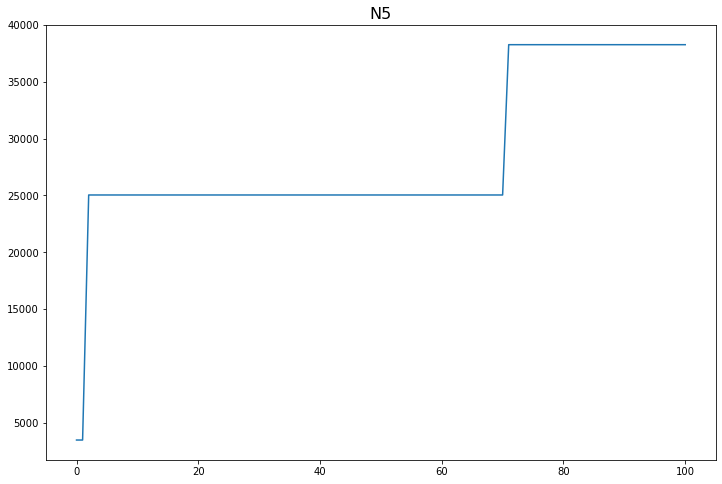

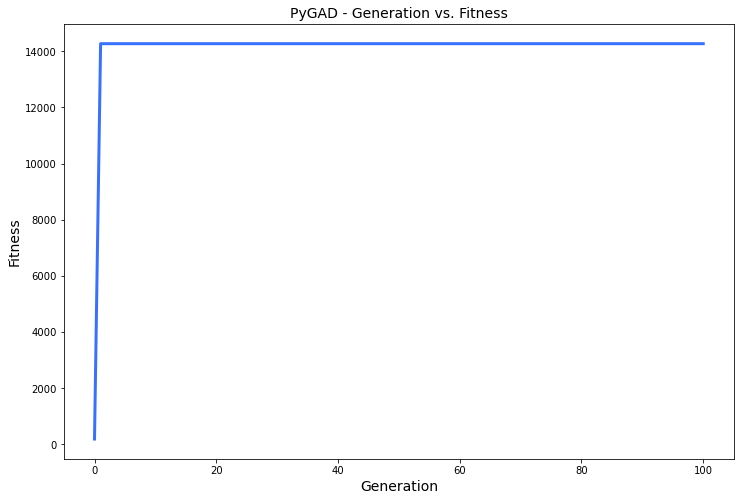

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.957 |==================| 9.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.902 |==================| 20.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.935 |==================| 12.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.869 |==================| 69.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 28.617 |==================| 4.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.954 |==================| 10.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.924 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.934 |==================| 12.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.146 |==================| 7.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 26.952 |==================| 15.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 26.686 |==================| 3.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.797 |==================| 4.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.517 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.238 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.146 |==================| 7.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 26.952 |==================| 15.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 26.686 |==================| 3.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.797 |==================| 4.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.517 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.238 |==================| 4.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 26.686 |==================| 3.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.797 |==================| 4.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.517 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.238 |==================| 4.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.238 |==================| 4.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.729 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.904 |==================| 8.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.178 |==================| 6.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.196 |==================| 5.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.674 |==================| 2.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.085 |==================| 14.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 26.786 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.178 |==================| 6.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.196 |==================| 5.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.674 |==================| 2.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.085 |==================| 14.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 26.786 |==================| 4.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.551 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 26.936 |==================| 12.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.066 |==================| 19.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.681 |==================| 2.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.817 |==================| 5.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.04 |==================| 40.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 26.639 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.092 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.681 |==================| 2.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.817 |==================| 5.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.04 |==================| 40.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 26.639 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.092 |==================| 12.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 26.526 |==================| 2.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 27.205 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.04 |==================| 40.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 26.639 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.092 |==================| 12.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 26.526 |==================| 2.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 27.205 |==================| 5.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 27.124 |==================| 9.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.028 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 26.607 |==================| 2.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.22 |==================| 4.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.876 |==================| 7.22 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.842 |==================| 5.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.239 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.22 |==================| 4.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.876 |==================| 7.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.842 |==================| 5.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.037 |==================| 45.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.623 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.133 |==================| 8.449 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 26.741 |==================| 3.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.191 |==================| 5.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.057 |==================| 23.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.24 |==================| 4.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.192 |==================| 5.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.103 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 26.741 |==================| 3.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.191 |==================| 5.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.057 |==================| 23.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.24 |==================| 4.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.192 |==================| 5.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.103 |==================| 11.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.536 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.038 |==================| 44.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.646 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.205 |==================| 5.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.113 |==================| 10.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.114 |==================| 10.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.121 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.646 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.205 |==================| 5.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.113 |==================| 10.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.114 |==================| 10.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.121 |==================| 9.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.05 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.205 |==================| 5.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.113 |==================| 10.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.114 |==================| 10.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.121 |==================| 9.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.05 |==================| 28.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.785 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.203 |==================| 5.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.13 |==================| 8.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 341.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.78 |==================| 4.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.953 |==================| 16.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.738 |==================| 3.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.172 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 341.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.78 |==================| 4.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 26.953 |==================| 16.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.738 |==================| 3.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.172 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.639 |==================| 2.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 27.093 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.253 |==================| 4.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.079 |==================| 15.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.201 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.68 |==================| 2.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.683 |==================| 3.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.017 |==================| 639.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.058 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.201 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.68 |==================| 2.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.683 |==================| 3.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.017 |==================| 639.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.058 |==================| 23.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.565 |==================| 2.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.017 |==================| 639.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.058 |==================| 23.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.565 |==================| 2.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.888 |==================| 7.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 26.682 |==================| 3.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.149 |==================| 7.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.088 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.861 |==================| 6.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.864 |==================| 6.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.841 |==================| 5.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.527 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.695 |==================| 3.126 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.088 |==================| 13.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.841 |==================| 5.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.527 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.695 |==================| 3.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 27.088 |==================| 13.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.906 |==================| 9.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.829 |==================| 5.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 27.188 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.747 |==================| 3.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.219 |==================| 4.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 26.713 |==================| 3.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.728 |==================| 3.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.895 |==================| 8.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.236 |=================

======| 1.107 |===========| 26.713 |==================| 3.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.728 |==================| 3.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.895 |==================| 8.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.236 |==================| 4.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.163 |==================| 6.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 26.521 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 27.003 |==================| 85.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.994 |==================| 47.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.116 |==================| 9.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.889 |==================| 7.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |==================| 7.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.761 |==================| 3.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.584 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.116 |==================| 9.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.889 |==================| 7.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |==================| 7.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.761 |==================| 3.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.584 |==================| 2.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 26.902 |==================| 8.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.104 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |==================| 7.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.761 |==================| 3.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.584 |==================| 2.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 26.902 |==================| 8.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.104 |==================| 11.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.525 |==================| 2.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.94 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.828 |==================| 5.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.15 |==================| 7.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.628 |==================| 2.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.226 |==================| 4.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.584 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.623 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.742 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.628 |==================| 2.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.226 |==================| 4.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.584 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.623 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.742 |==================| 3.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.555 |==================| 2.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 26.947 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.181 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.224 |==================| 4.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 26.601 |==================| 2.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.028 |==================| 78.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.158 |==================| 6.974 |==========
Generation = 13
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.166 |==================| 6.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.041 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 26.601 |==================| 2.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.028 |==================| 78.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.158 |==================| 6.974 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.166 |==================| 6.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.041 |==================| 38.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.161 |==================| 6.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.216 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.028 |==================| 78.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.158 |==================| 6.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.068 |==================| 18.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.938 |==================| 12.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.233 |==================| 4.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.664 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 26.674 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.068 |==================| 18.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.938 |==================| 12.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.233 |==================| 4.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.664 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 26.674 |==================| 2.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.171 |==================| 6.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.203 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.938 |==================| 12.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.233 |==================| 4.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.664 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 26.674 |==================| 2.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.171 |==================| 6.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.203 |==================| 5.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.807 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.531 |==================| 2.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.245 |==================| 4.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.068 |==================| 18.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.118 |==================| 9.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.078 |==================| 15.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.712 |==================| 3.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.917 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.068 |==================| 18.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.118 |==================| 9.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.078 |==================| 15.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.712 |==================| 3.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.917 |==================| 10.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.991 |==================| 42.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 26.737 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.72 |==================| 3.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.529 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.25 |==================| 4.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.567 |==================| 2.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.253 |==================| 4.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.148 |==================| 7.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.733 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.25 |==================| 4.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.567 |==================| 2.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.253 |==================| 4.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.148 |==================| 7.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.733 |==================| 3.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.754 |==================| 3.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.567 |==================| 2.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.253 |==================| 4.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.148 |==================| 7.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.733 |==================| 3.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.754 |==================| 3.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 4.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.04 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.129 |==================| 8.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.736 |==================| 3.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.045 |==================| 33.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 26.534 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.145 |==================| 7.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.108 |==================| 10.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.792 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.045 |==================| 33.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 26.534 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 27.145 |==================| 7.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.108 |==================| 10.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.792 |==================| 4.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.218 |==================| 4.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.098 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.022 |==================| 146.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.225 |==================| 4.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.079 |==================| 15.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.497 |==========
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.18 |==================| 6.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.07

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.225 |==================| 4.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.079 |==================| 15.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.497 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.935 |==================| 12.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.18 |==================| 6.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.072 |==================| 17.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.804 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |==================| 17.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.13 |==================| 8.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.976 |==================| 25.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.249 |==================| 4.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.194 |==================| 5.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.052 |==================| 26.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.224 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.13 |==================| 8.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.976 |==================| 25.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.249 |==================| 4.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.194 |==================| 5.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.052 |==================| 26.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.224 |==================| 4.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.529 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.976 |==================| 25.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.249 |==================| 4.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.194 |==================| 5.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.052 |==================| 26.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 27.224 |==================| 4.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.529 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.586 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.232 |==================| 4.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.215 |==================| 4.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 330.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.93 |==================| 11.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.555 |==================| 2.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.675 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.215 |==================| 4.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 330.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.93 |==================| 11.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.555 |==================| 2.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.675 |==================| 2.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.049 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.778 |==================| 4.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.243 |==================| 4.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.069 |==================| 18.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.204 |==================| 5.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.55 |==================| 2.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 65.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.811 |==================| 4

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.069 |==================| 18.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.204 |==================| 5.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.55 |==================| 2.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 65.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.811 |==================| 4.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.122 |==================| 9.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.615 |==================| 2.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.55 |==================| 2.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 65.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.811 |==================| 4.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.122 |==================| 9.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.615 |==================| 2.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.191 |==================| 5.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.949 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.021 |==================| 170.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 26.614 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.226 |==================| 4.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.827 |==================| 5.329 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.572 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.045 |==================| 32.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.827 |==================| 5.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.572 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.045 |==================| 32.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.075 |==================| 16.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.243 |==================| 4.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.754 |==================| 3.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.577 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.544 |==================| 2.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.864 |==================| 6.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.165 |==================| 6.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.696 |==================| 3.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.873 |==================| 7.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.117 |==================| 9.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.233 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.864 |==================| 6.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.165 |==================| 6.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.696 |==================| 3.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.873 |==================| 7.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.117 |==================| 9.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.233 |==================| 4.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.219 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.93 |==================| 11.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.034 |==================| 51.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.22 |==================| 4.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.11 |==================| 10.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.248 |==================| 4.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.514 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.154 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.11 |==================| 10.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.248 |==================| 4.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.514 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.154 |==================| 7.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.58 |==================| 2.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.8 |==================| 4.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 26.526 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.154 |==================| 7.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.58 |==================| 2.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 26.8 |==================| 4.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 26.526 |==================| 2.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.958 |==================| 17.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.045 |==================| 33.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.082 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.194 |==================| 5.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.627 |==================| 2.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.146 |==================| 7.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.909 |==================| 9.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.083 |==================| 14.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.911 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.627 |==================| 2.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.146 |==================| 7.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.909 |==================| 9.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.083 |==================| 14.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.911 |==================| 9.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.028 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.237 |==================| 4.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.818 |==================| 5.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.554 |==================| 2.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.77 |==================| 4.088 |==========
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |==================| 7.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.124 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.818 |==================| 5.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.554 |==================| 2.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.77 |==================| 4.088 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.878 |==================| 7.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.124 |==================| 9.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.92 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.616 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.77 |==================| 4.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.243 |==================| 4.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.194 |==================| 5.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.675 |==================| 2.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 26.521 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.064 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.854 |==================| 6.222 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.243 |==================| 4.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.194 |==================| 5.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.675 |==================| 2.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 26.521 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.064 |==================| 20.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.194 |==================| 5.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.675 |==================| 2.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 26.521 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.064 |==================| 20.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 27.036 |==================| 47.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.083 |==================| 14.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.764 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.206 |==================| 5.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.829 |==================| 5.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.991 |==================| 41.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.117 |==================| 9.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.162 |==================| 6.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.065 |==================| 20.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.024 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.829 |==================| 5.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.991 |==================| 41.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.117 |==================| 9.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.162 |==================| 6.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.065 |==================| 20.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.024 |==================| 105.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.247 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 26.968 |==================| 21.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.183 |==================| 5.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.022 |==================| 138.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.969 |==================| 21.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.872 |==================| 7.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.132 |==================| 8.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.081 |============

======| 0.153 |===========| 27.183 |==================| 5.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.022 |==================| 138.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.969 |==================| 21.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.872 |==================| 7.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.132 |==================| 8.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.081 |==================| 15.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.201 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.022 |==================| 138.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.969 |==================| 21.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.872 |==================| 7.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.132 |==================| 8.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.081 |==================| 15.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.201 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.035 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.786 |==================| 4.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.254 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.884 |==================| 7.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.599 |==================| 2.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.648 |==================| 2.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.96 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.254 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.884 |==================| 7.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.599 |==================| 2.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 26.648 |==================| 2.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.96 |==================| 18.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 26.87 |==================| 6.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.921 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.189 |==================| 5.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.233 |==================| 4.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.061 |==================| 21.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.528 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.024 |==================| 115.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.02 |==================| 195.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.061 |==================| 21.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.528 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.024 |==================| 115.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.02 |==================| 195.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.423 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 26.556 |==================| 2.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.037 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.528 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.024 |==================| 115.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.02 |==================| 195.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.108 |==================| 10.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.574 |==================| 2.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.017 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.206 |==================| 5.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.727 |==================| 3.472 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.108 |==================| 10.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.574 |==================| 2.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.017 |==================| 597.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 26.98 |==================| 28.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.108 |==================| 10.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.574 |==================| 2.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.017 |==================| 597.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 26.98 |==================| 28.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.819 |==================| 5.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.106 |==================| 11.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.801 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.707 |==================| 3.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.784 |==================| 4.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.026 |==================| 92.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.011 |==================| 240.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.078 |==================| 15.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.251 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.026 |==================| 92.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.011 |==================| 240.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.078 |==================| 15.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 27.251 |==================| 4.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.792 |==================| 4.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==================| 30.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.051 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.162 |==================| 6.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.169 |==================| 6.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.133 |==================| 8.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |==================| 5.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.068 |==================| 18.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.746 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |==================| 5.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.068 |==================| 18.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.746 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.181 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.167 |==================| 6.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.095 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.068 |==================| 18.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.746 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.919 |==================| 10.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.181 |==================| 6.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.167 |==================| 6.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.095 |==================| 12.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.185 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.194 |==================| 5.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.039 |==================| 42.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 26.689 |==================| 3.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.669 |==================| 2.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.65 |==================| 2.741 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 27.039 |==================| 42.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 26.689 |==================| 3.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.669 |==================| 2.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.65 |==================| 2.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.102 |==================| 11.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 26.622 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.034 |==================| 51.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.128 |==================| 8.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.17 |==================| 6.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.63 |==================| 2.596 |==========
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.218 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.168 |==================| 6.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.522 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.17 |==================| 6.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.63 |==================| 2.596 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.218 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.168 |==================| 6.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.522 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.081 |==================| 15.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.752 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.245 |==================| 4.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.804 |==================| 4.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.165 |==================| 6.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.502 |===========| 26.511 |==================| 1.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.046 |==================| 32.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.664 |==================| 2.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.541 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.165 |==================| 6.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.502 |===========| 26.511 |==================| 1.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.046 |==================| 32.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.664 |==================| 2.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.541 |==================| 2.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.035 |==================| 50.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.083 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.664 |==================| 2.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.541 |==================| 2.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.035 |==================| 50.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.083 |==================| 14.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.588 |==================| 2.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.184 |==================| 5.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 27.036 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 26.933 |==================| 12.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.037 |==================| 44.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.11 |==================| 10.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 26.985 |==================| 32.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.06 |==================| 22.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.673 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 26.985 |==================| 32.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.06 |==================| 22.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.673 |==================| 2.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.179 |==================| 6.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.126 |==================| 8.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.846 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.207 |==================| 5.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.805 |==================| 4.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.21 |==================| 5.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.253 |==================| 4.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.551 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.803 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.949 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.805 |==================| 4.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.21 |==================| 5.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.253 |==================| 4.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.551 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.803 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.949 |==================| 15.235 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.184 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.21 |==================| 5.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.253 |==================| 4.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.551 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.803 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.949 |==================| 15.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.811 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.072 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 26.72 |==================| 3.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 26.976 |==================| 25.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 27.006 |==================| 112.31 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.811 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.072 |==================| 17.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 27.006 |==================| 112.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.811 |==================| 4.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.072 |==================| 17.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.023 |==================| 129.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.937 |==================| 12.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.64 |==================| 2.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.924 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.157 |==================| 7.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.809 |==================| 4.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.2 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.246 |==================| 4.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.027 |==================| 83.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.866 |==================| 6.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.098 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.246 |==================| 4.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.027 |==================| 83.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.866 |==================| 6.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.098 |==================| 12.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.831 |==================| 5.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.178 |==================| 6.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.094 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.138 |==================| 8.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.157 |==================| 7.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.044 |==================| 34.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.134 |==================| 8.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.017 |==================| 429.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.244 |==================| 4.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.617 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.044 |==================| 34.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.134 |==================| 8.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.017 |==================| 429.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.244 |==================| 4.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.617 |==================| 2.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.136 |==================| 8.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.199 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.017 |==================| 429.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.244 |==================| 4.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.617 |==================| 2.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.136 |==================| 8.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.199 |==================| 5.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.669 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.922 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 26.749 |==================| 3.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.937 |==================| 12.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.976 |==================| 25.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.162 |==================| 6.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.912 |==================| 9.743 |==========
Fitness = 664.4094054730273
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 26.697 |==================| 3.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 26.937 |==================| 12.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 26.976 |==================| 25.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.162 |==================| 6.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.912 |==================| 9.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 26.697 |==================| 3.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 26.985 |==================| 33.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.177 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.076 |==================| 16.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 26.892 |==================| 8.134 |==========
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.071 |==================| 17.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.235 |==================| 4.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.512 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.001 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.071 |==================| 17.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.235 |==================| 4.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.512 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.883 |==================| 7.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.001 |==================| 72.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.685 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 26.818 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 26.521 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 27.091 |==================| 13.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 26.7 |==================| 3.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.016 |==================| 695.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.177 |==================| 6.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.129 |==================| 8.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 27.016 |==================| 695.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.177 |==================| 6.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.129 |==================| 8.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.081 |==================| 15.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.216 |==================| 4.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.606 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.129 |==================| 8.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.081 |==================| 15.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.216 |==================| 4.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.606 |==================| 2.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.642 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.974 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 26.984 |==================| 32.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.078 |==================| 15.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.015 |==================| 2349.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.146 |==================| 7.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.133 |==================| 8.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.772 |==================| 4.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.788 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.078 |==================| 15.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.015 |==================| 2349.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.146 |==================| 7.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.133 |==================| 8.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.772 |==================| 4.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.788 |==================| 4.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 26.897 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 26.745 |==================| 3.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.613 |==================| 2.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.041 |==================| 38.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.135 |==================| 8.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.931 |==================| 11.929 |==========
Generation = 47
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.102 |==================| 11.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.136

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.613 |==================| 2.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.041 |==================| 38.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.135 |==================| 8.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.931 |==================| 11.929 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.102 |==================| 11.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.136 |==================| 8.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.17 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 27.135 |==================| 8.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.931 |==================| 11.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.611 |==================| 2.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.727 |==================| 3.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.196 |==================| 5.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.06 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.164 |==================| 6.716 |==========
Fitness = 2349.4201162157065
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.611 |==================| 2.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.727 |==================| 3.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.196 |==================| 5.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.06 |==================| 22.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.727 |==================| 3.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.196 |==================| 5.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.06 |==================| 22.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.99 |==================| 39.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.524 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.041 |==================| 38.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.055 |==================| 25.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.128 |==================| 8.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.148 |==================| 7.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.035 |==================| 50.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.019 |==================| 230.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.221 |==================| 4.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.052 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.148 |==================| 7.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.035 |==================| 50.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.019 |==================| 230.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.221 |==================| 4.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.052 |==================| 27.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.918 |==================| 10.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.113 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.101 |==================| 11.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.554 |==================| 2.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.242 |==================| 4.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.06 |==================| 22.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.557 |==================| 2.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.916 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.554 |==================| 2.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 27.242 |==================| 4.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.06 |==================| 22.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.557 |==================| 2.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.916 |==================| 10.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.612 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.122 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.557 |==================| 2.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.916 |==================| 10.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 26.612 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.122 |==================| 9.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.775 |==================| 4.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.978 |==================| 27.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.584 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 27.205 |==================| 5.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.23 |==================| 4.647 |==========
Fitness = 6593.1383118576405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.978 |==================| 27.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.584 |==================| 2.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==================| 4.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 26.521 |==================| 2.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.978 |==================| 27.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.584 |==================| 2.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==================| 4.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 26.521 |==================| 2.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.185 |==================| 5.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 26.684 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.203 |==================| 5.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 26.727 |==================| 3.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 26.593 |==================| 2.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.0 |==================| 65.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.23 |==================| 4.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.144 |==================| 7.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.241 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 26.593 |==================| 2.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.0 |==================| 65.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.23 |==================| 4.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 27.144 |==================| 7.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.241 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.07 |==================| 18.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.045 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 26.823 |==================| 5.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.247 |==================| 4.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 26.607 |==================| 2.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.108 |==================| 10.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.087 |==================| 13.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.234 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.108 |==================| 10.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.087 |==================| 13.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.234 |==================| 4.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.811 |==================| 4.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.592 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.014 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.234 |==================| 4.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.811 |==================| 4.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.592 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.014 |==================| 1206.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.254 |==================| 4.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.217 |==================| 4.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 26.823 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 27.016 |==================| 917.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.842 |==================| 5.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 26.632 |==================| 2.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.522 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.62 |==================| 2.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 26.691 |==================| 3.086 |==========
Fitness = 6593.1383118576405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 26.632 |==================| 2.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.522 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.62 |==================| 2.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 26.691 |==================| 3.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.045 |==================| 33.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.213 |==================| 5.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 26.917 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.907 |==================| 9.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.061 |==================| 21.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.943 |==================| 13.934 |==========
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.548 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 26.543 |==================| 2.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.991 |==================| 42.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.069 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.548 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 26.543 |==================| 2.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.991 |==================| 42.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.069 |==================| 18.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.12 |==================| 9.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.218 |==================| 4.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.044 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.143 |==================| 7.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.02 |==================| 212.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.014 |==================| 2122.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.671 |==================| 2.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.563 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.065 |==================| 19.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.854 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.671 |==================| 2.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.563 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.065 |==================| 19.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.854 |==================| 6.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.842 |==================| 5.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.621 |==================| 2.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.129 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.563 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.065 |==================| 19.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.854 |==================| 6.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.842 |==================| 5.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.621 |==================| 2.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.129 |==================| 8.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.154 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.572 |==================| 2.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 26.993 |==================| 45.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.024 |==================| 115.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 26.84 |==================| 5.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.232 |==================| 4.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 26.952 |==================| 15.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.219 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 26.84 |==================| 5.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.232 |==================| 4.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 26.952 |==================| 15.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.219 |==================| 4.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 26.611 |==================| 2.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.232 |==================| 4.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.891 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.196 |==================| 5.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.666 |==================| 2.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 26.609 |==================| 2.46 |==========
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.074 |==================| 17.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 26.962 |==================| 18.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.184 |==================| 5.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.091 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.666 |==================| 2.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 26.609 |==================| 2.46 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 27.074 |==================| 17.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 26.962 |==================| 18.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.184 |==================| 5.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 27.091 |==================| 13.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.521 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 26.609 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.588 |==================| 2.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.157 |==================| 7.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.15 |==================| 7.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.577 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.087 |==================| 13.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.922 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.588 |==================| 2.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.157 |==================| 7.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.15 |==================| 7.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.577 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.087 |==================| 13.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.922 |==================| 10.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.253 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.157 |==================| 7.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.15 |==================| 7.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.577 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.087 |==================| 13.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.922 |==================| 10.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.253 |==================| 4.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.544 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.665 |==================| 2.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.067 |==================| 19.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.958 |==================| 17.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.885 |==================| 7.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.106 |==================| 10.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.831 |==================| 5.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.621 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.958 |==================| 17.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.885 |==================| 7.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.106 |==================| 10.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 26.831 |==================| 5.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.621 |==================| 2.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.11 |==================| 10.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 26.63 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.596 |==================| 2.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.693 |==================| 3.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.858 |==================| 6.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.129 |==================| 8.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.763 |==================| 3.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.884 |==================| 7.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.067 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.129 |==================| 8.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.763 |==================| 3.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.884 |==================| 7.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.067 |==================| 19.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.158 |==================| 6.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.247 |==================| 4.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.099 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.067 |==================| 19.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.158 |==================| 6.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.247 |==================| 4.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.099 |==================| 11.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.154 |==================| 7.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.054 |==================| 25.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.207 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 27.062 |==================| 21.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.925 |==================| 11.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.916 |==================| 10.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.87 |==================| 6.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.602 |==================| 2.419 |==========
Fitness = 6593.1383118576405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.158 |==================| 7.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.925 |==================| 11.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.916 |==================| 10.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.87 |==================| 6.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.602 |==================| 2.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.158 |==================| 7.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.94 |==================| 13.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.172 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.234 |==================| 4.574 |==========
Generation = 63
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.2 |==================| 5.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.173 |==================| 6.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.129 |==================| 8.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.237 |==================| 4.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.928 |==================| 11.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.804 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.173 |==================| 6.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.129 |==================| 8.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.237 |==================| 4.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 26.928 |==================| 11.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.804 |==================| 4.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 27.217 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.222 |==================| 4.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.046 |==================| 32.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.808 |==================| 4.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.922 |==================| 10.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.065 |==================| 19.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.804 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.046 |==================| 32.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.808 |==================| 4.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.922 |==================| 10.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.065 |==================| 19.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.804 |==================| 4.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.69 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 26.808 |==================| 4.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.922 |==================| 10.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.065 |==================| 19.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.804 |==================| 4.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.69 |==================| 3.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.072 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.774 |==================| 4.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.132 |==================| 8.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.53 |==================| 2.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.521 |==================| 2.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.769 |==================| 4.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.151 |==================| 7.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.132 |==================| 8.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.53 |==================| 2.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.521 |==================| 2.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.769 |==================| 4.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 315.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 26.568 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.769 |==================| 4.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.079 |==================| 15.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.71 |==================| 3.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.676 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.71 |==================| 3.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.676 |==================| 2.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.177 |==================| 6.184 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.832 |==================| 5.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.225 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.676 |==================| 2.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.177 |==================| 6.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.177 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.118 |==================| 9.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.087 |==================| 13.885 |==========
Fitness = 6593.1383118576405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.177 |==================| 6.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.105 |==================| 11.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.241 |==================| 4.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.177 |==================| 6.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.105 |==================| 11.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.074 |==================| 16.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.874 |==================| 7.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.067 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.141 |==================| 7.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 26.982 |==================| 30.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.177 |==================| 6.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.173 |==================| 6.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 26.822 |==================| 5.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.54 |==================| 2.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.101 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.173 |==================| 6.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 26.822 |==================| 5.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 26.54 |==================| 2.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 27.101 |==================| 11.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.708 |==================| 3.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.859 |==================| 6.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.056 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.57 |==================| 2.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.729 |==================| 3.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.183 |==================| 5.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.858 |==================| 6.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.943 |==================| 13.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 27.127 |==================| 8.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.858 |==================| 6.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.943 |==================| 13.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 27.127 |==================| 8.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.785 |==================| 4.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.797 |==================| 4.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 26.637 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.943 |==================| 13.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 27.127 |==================| 8.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.785 |==================| 4.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.797 |==================| 4.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 26.637 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.107 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.017 |==================| 475.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 26.848 |==================| 5.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.69 |==================| 3.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 26.618 |==================| 2.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 27.015 |==================| 2031.457 |==========
Fitness = 6593.1383118576405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.107 |==================| 10.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 26.618 |==================| 2.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 27.015 |==================| 2031.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.107 |==================| 10.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.249 |==================| 4.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.083 |==================| 14.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.202 |==================| 5.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 26.799 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 26.687 |==================| 3.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.136 |==================| 8.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.14 |==================| 7.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.04 |==================| 39.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.224 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 26.79 |==================| 4.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 27.136 |==================| 8.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.14 |==================| 7.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.189 |==================| 5.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.04 |==================| 39.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.224 |==================| 4.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 26.524 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.772 |==================| 4.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.123 |==================| 9.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.575 |==================| 2.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.902 |==================| 8.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.87 |==================| 6.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.575 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.575 |==================| 2.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.902 |==================| 8.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.87 |==================| 6.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.575 |==================| 2.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.159 |==================| 6.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.742 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.87 |==================| 6.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.575 |==================| 2.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.159 |==================| 6.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.742 |==================| 3.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 26.969 |==================| 21.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.129 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.155 |==================| 7.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.826 |==================| 5.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 26.907 |==================| 9.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.569 |==================| 2.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.129 |==================| 8.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.152 |==================| 7.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.978 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.826 |==================| 5.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 26.907 |==================| 9.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.569 |==================| 2.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 27.129 |==================| 8.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.152 |==================| 7.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.978 |==================| 27.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.125 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.915 |==================| 9.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.712 |==================| 3.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.712 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.621 |==================| 2.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.148 |==================| 7.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.245 |==================| 4.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.756 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.621 |==================| 2.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.148 |==================| 7.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.245 |==================| 4.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.756 |==================| 3.862 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.907 |==================| 9.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.0 |==================| 66.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 26.87 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.756 |==================| 3.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.563 |==================| 2.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.119 |==================| 9.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.817 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.619 |==================| 2.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.225 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.119 |==================| 9.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.817 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.619 |==================| 2.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.225 |==================| 4.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.022 |==================| 148.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.087 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.817 |==================| 5.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.619 |==================| 2.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.122 |==================| 9.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.225 |==================| 4.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.022 |==================| 148.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.087 |==================| 13.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.818 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.209 |==================| 5.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.893 |==================| 8.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.809 |==================| 4.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.162 |==================| 6.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.033 |==================| 56.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 27.016 |==================| 1000.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.234 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.162 |==================| 6.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.033 |==================| 56.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 27.016 |==================| 1000.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.234 |==================| 4.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.213 |==================| 5.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.819 |==================| 5.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.532 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.536 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.032 |==================| 58.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.014 |==================| 1108.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.633 |==================| 2.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.069 |==================| 18.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.159 |==================| 6.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.014 |==================| 1108.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.633 |==================| 2.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.069 |==================| 18.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.159 |==================| 6.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |==================| 7.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.972 |==================| 23.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.02 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.069 |==================| 18.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.159 |==================| 6.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 26.887 |==================| 7.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.972 |==================| 23.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.02 |==================| 189.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.96 |==================| 18.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.568 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.516 |==================| 2.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 26.724 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 26.97 |==================| 22.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.551 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.772 |==================| 4.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.172 |==================| 6.386 |==========
Fitness = 6593.1383118576405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 26.724 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 26.97 |==================| 22.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.551 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.772 |==================| 4.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.172 |==================| 6.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.93 |==================| 11.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.628 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.731 |==================| 3.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.524 |==================| 2.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.027 |==================| 81.048 |==========
Generation = 79
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.17 |==================| 6.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 27.055 |==================| 25.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |==================| 36.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 26.613 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.027 |==================| 81.048 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.17 |==================| 6.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 27.055 |==================| 25.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.042 |==================| 36.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 26.613 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.838 |==================| 5.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 26.679 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.226 |==================| 4.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.205 |==================| 5.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.856 |==================| 6.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.036 |==================| 48.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.609 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.154 |==================| 7.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.055 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.856 |==================| 6.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.036 |==================| 48.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.609 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.154 |==================| 7.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.055 |==================| 24.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.254 |==================| 4.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.198 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 27.154 |==================| 7.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.055 |==================| 24.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.254 |==================| 4.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.198 |==================| 5.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 26.887 |==================| 7.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.051 |==================| 27.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.239 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.113 |==================| 10.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.253 |==================| 4.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.099 |==================| 11.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.057 |==================| 23.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.6 |==================| 2.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.022 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.099 |==================| 11.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.057 |==================| 23.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.6 |==================| 2.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.049 |==================| 29.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.022 |==================| 151.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 26.708 |==================| 3.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 26.661 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.166 |==================| 6.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.237 |==================| 4.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.789 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 4.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.944 |==================| 14.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.827 |==================| 5.33 |==========
Generation = 82
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.58 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.237 |==================| 4.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.789 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 4.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.944 |==================| 14.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.827 |==================| 5.33 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.58 |==================| 2.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.801 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.944 |==================| 14.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.827 |==================| 5.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.946 |==================| 14.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.103 |==================| 11.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.181 |==================| 6.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 26.651 |==================| 2.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.836 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.103 |==================| 11.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 27.181 |==================| 6.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 26.651 |==================| 2.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.836 |==================| 5.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==================| 4.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.752 |==================| 3.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 27.047 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.836 |==================| 5.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==================| 4.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.752 |==================| 3.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 27.047 |==================| 30.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.042 |==================| 36.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.558 |==================| 2.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.204 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.114 |==================| 10.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.086 |==================| 14.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.801 |==================| 4.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.655 |==================| 2.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.187 |==================| 5.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.921 |==================| 10.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.573 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.801 |==================| 4.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.655 |==================| 2.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.187 |==================| 5.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 26.921 |==================| 10.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.573 |==================| 2.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.529 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.838 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.171 |==================| 6.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.21 |==================| 5.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.811 |==================| 4.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.139 |==================| 8.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.952 |==================| 15.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.599 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.21 |==================| 5.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.811 |==================| 4.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.139 |==================| 8.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.952 |==================| 15.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.599 |==================| 2.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.091 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.811 |==================| 4.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.139 |==================| 8.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.952 |==================| 15.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.619 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.599 |==================| 2.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.091 |==================| 13.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.161 |==================| 6.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 27.17 |==================| 6.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.152 |==================| 7.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 359.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.108 |==================| 10.769 |==========
Fitness = 6593.1383118576405
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.651 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 27.152 |==================| 7.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 27.018 |==================| 359.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.108 |==================| 10.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.651 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.995 |==================| 50.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.885 |==================| 7.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.761 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.251 |==================| 4.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.078 |==================| 15.781 |==========
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.621 |==================| 2.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.135 |==================| 8.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 26.734 |==================| 3.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.103 |==================| 11.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.879 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.621 |==================| 2.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 27.135 |==================| 8.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 26.734 |==================| 3.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.103 |==================| 11.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.879 |==================| 7.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 27.071 |==================| 18.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 26.66 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.2 |==================| 5.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.064 |==================| 20.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.043 |==================| 36.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.989 |==================| 37.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.11 |==================| 10.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.629 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.565 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.043 |==================| 36.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.989 |==================| 37.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.11 |==================| 10.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.629 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.565 |==================| 2.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.907 |==================| 9.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.232 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.629 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.565 |==================| 2.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 26.907 |==================| 9.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.232 |==================| 4.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 26.983 |==================| 31.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.914 |==================| 9.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.696 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.158 |==================| 7.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.011 |==================| 269.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 26.603 |==================| 2.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 26.733 |==================| 3.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.515 |==================| 1.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 26.643 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 26.603 |==================| 2.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 26.733 |==================| 3.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.09 |==================| 13.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.515 |==================| 1.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 26.643 |==================| 2.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.562 |==================| 2.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.924 |==================| 11.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.098 |==================| 12.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.583 |==================| 2.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.235 |==================| 4.543 |==========
Generation = 90
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.696 |==================| 3.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.913 |==================| 9.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.213 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.098 |==================| 12.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.583 |==================| 2.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.235 |==================| 4.543 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.696 |==================| 3.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.913 |==================| 9.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.213 |==================| 5.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.117 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.583 |==================| 2.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 27.235 |==================| 4.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.86 |==================| 6.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.219 |==================| 4.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.629 |==================| 2.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.86 |==================| 6.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.219 |==================| 4.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.629 |==================| 2.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 64.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.102 |==================| 11.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.029 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.195 |==================| 5.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.03 |==================| 64.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.102 |==================| 11.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.029 |==================| 70.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.08 |==================| 15.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.194 |==================| 5.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.779 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 27.235 |==================| 4.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.17 |==================| 6.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.142 |==================| 7.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.164 |==================| 6.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.163 |==================| 6.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.769 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.671 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.164 |==================| 6.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 27.163 |==================| 6.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.769 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.671 |==================| 2.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.116 |==================| 9.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.544 |==================| 2.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.184 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 27.052 |==================| 27.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.211 |==================| 5.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 26.611 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 26.8 |==================| 4.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.061 |==================| 21.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 26.95 |==================| 15.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.03 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.211 |==================| 5.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 26.611 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 26.8 |==================| 4.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.061 |==================| 21.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 26.95 |==================| 15.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.03 |==================| 67.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.76 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 26.611 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 26.8 |==================| 4.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.061 |==================| 21.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 26.95 |==================| 15.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.03 |==================| 67.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.76 |==================| 3.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.248 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.785 |==================| 4.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 26.657 |==================| 2.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==================| 29.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.901 |==================| 8.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.103 |==================| 11.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.748 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 26.657 |==================| 2.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 27.145 |==================| 7.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.048 |==================| 29.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.901 |==================| 8.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.103 |==================| 11.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.748 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.041 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.219 |==================| 4.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 27.021 |==================| 169.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.256 |==================| 4.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.568 |==================| 2.238 |==========
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.754 |==================| 3.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 26.539 |==================| 2.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.674

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.568 |==================| 2.238 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.754 |==================| 3.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.448 |===========| 26.539 |==================| 2.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.674 |==================| 2.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.523 |==================| 2.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.557 |==================| 2.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.614 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 26.658 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 26.965 |==================| 19.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 26.871 |==================| 6.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.857 |==================| 6.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.524 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 26.985 |==================| 33.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 26.871 |==================| 6.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.857 |==================| 6.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.524 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 26.985 |==================| 33.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.523 |==================| 2.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.848 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.857 |==================| 6.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 26.524 |==================| 2.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 26.985 |==================| 33.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.24 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.523 |==================| 2.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.848 |==================| 5.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.839 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.162 |==================| 6.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.879 |==================| 7.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 26.849 |==================| 6.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.834 |==================| 5.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.841 |==================| 5.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.924 |==================| 10.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.098 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.834 |==================| 5.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.841 |==================| 5.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.924 |==================| 10.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.098 |==================| 12.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 26.821 |==================| 5.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.185 |==================| 5.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 26.716 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.146 |==================| 7.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 27.212 |==================| 5.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.028 |==================| 74.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.994 |==================| 48.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.912 |==================| 9.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 26.98 |==================| 28.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 26.741 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.994 |==================| 48.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.912 |==================| 9.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 26.98 |==================| 28.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 26.741 |==================| 3.652 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 27.052 |==================| 27.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 26.682 |==================| 3.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.088 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.912 |==================| 9.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 26.98 |==================| 28.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 26.741 |==================| 3.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 26.993 |==================| 46.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.095 |==================| 12.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.746 |==================| 3.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.685 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 26.993 |==================| 46.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.095 |==================| 12.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.746 |==================| 3.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.685 |==================| 3.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.001 |==================| 72.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.698 |==================| 3.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.81 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 27.095 |==================| 12.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.746 |==================| 3.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.685 |==================| 3.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 27.001 |==================| 72.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.698 |==================| 3.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.81 |==================| 4.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 26.717 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.603 |==================| 2.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.595 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.148 |==================| 7.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.239 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.903 |==================| 8.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.084 |==================| 14.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.595 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.148 |==================| 7.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.239 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.903 |==================| 8.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.084 |==================| 14.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.213 |==================| 5.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.079 |===============

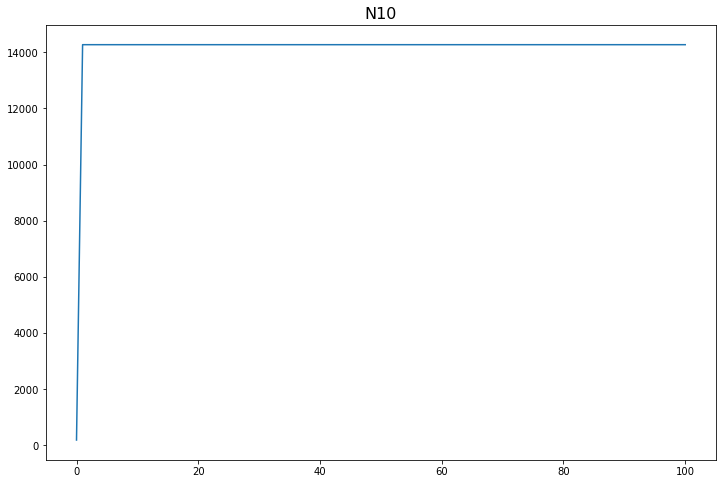

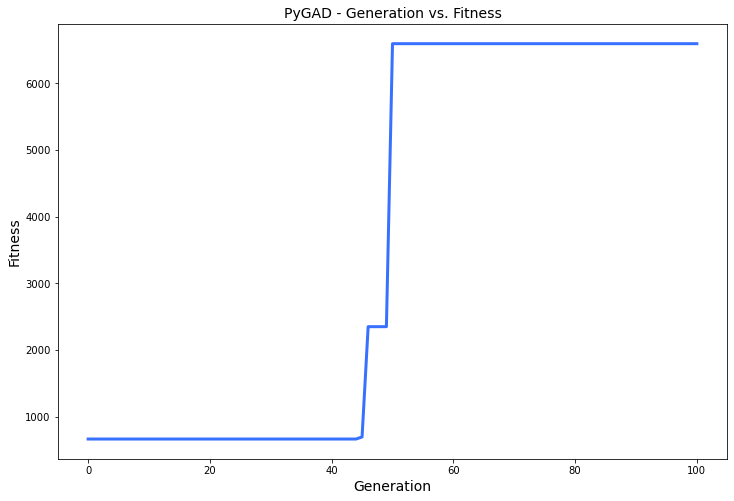

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.159 |==================| 6.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.159 |==================| 6.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.079 |==================| 15.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.603 |==================| 2.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.595 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.148 |==================| 7.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.239 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.825 |==================| 97.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.843 |==================| 34.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.814 |==================| 2847.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.83 |==================| 64.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 24.76 |==================| 18.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.79 |==================| 40.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 24.73 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.814 |==================| 2847.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.83 |==================| 64.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 24.76 |==================| 18.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.79 |==================| 40.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 24.73 |==================| 11.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.755 |==================| 16.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 24.768 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 24.76 |==================| 18.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.79 |==================| 40.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 24.73 |==================| 11.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.755 |==================| 16.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 24.768 |==================| 21.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.859 |==================| 22.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 24.751 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.857 |==================| 23.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.802 |==================| 79.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 24.704 |==================| 9.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 24.737 |==================| 12.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.817 |==================| 355.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.778 |==================| 27.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 24.762 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 24.704 |==================| 9.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 24.737 |==================| 12.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.817 |==================| 355.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.778 |==================| 27.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 24.762 |==================| 19.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 24.752 |==================| 16.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.827 |============

======| 0.399 |===========| 24.826 |==================| 88.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.844 |==================| 33.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.817 |==================| 467.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.805 |==================| 108.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.824 |==================| 108.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.815 |==================| 1192.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 24.718 |==================| 10.413 |==========
=====|SOLUTION|===========|OUTPUT|=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.817 |==================| 467.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.805 |==================| 108.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.824 |==================| 108.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.815 |==================| 1192.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 24.718 |==================| 10.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.855 |==================| 24.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.768 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.824 |==================| 108.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.815 |==================| 1192.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 24.718 |==================| 10.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.855 |==================| 24.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.768 |==================| 21.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.818 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.861 |==================| 21.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.819 |==================| 206.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.845 |==================| 32.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 24.713 |==================| 9.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 24.723 |==================| 10.953 |==========
Fitness = 2847.498842330824
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 24.777 |==================| 26.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.845 |==================| 32.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 24.713 |==================| 9.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 24.723 |==================| 10.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 24.777 |==================| 26.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.849 |==================| 28.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.826 |==================| 89.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.826 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.859 |==================| 22.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.862 |==================| 21.004 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 24.708 |==================| 9.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 24.724 |==================| 11.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 24.759 |==================| 17.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.837 |==================| 44.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.78

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.862 |==================| 21.004 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 24.708 |==================| 9.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 24.724 |==================| 11.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 24.759 |==================| 17.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.837 |==================| 44.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.786 |==================| 35.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.817 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.816 |==================| 568.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.839 |==================| 40.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.825 |==================| 93.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.793 |==================| 47.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.82 |==================| 191.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.826 |==================| 82.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.795 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.839 |==================| 40.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.825 |==================| 93.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.793 |==================| 47.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.82 |==================| 191.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.826 |==================| 82.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.795 |==================| 50.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.859 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.825 |==================| 93.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 24.793 |==================| 47.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.82 |==================| 191.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.826 |==================| 82.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 24.795 |==================| 50.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.859 |==================| 22.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.846 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 24.736 |==================| 12.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |==================| 19.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.855 |==================| 24.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |==================| 45.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 24.712 |==================| 9.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.852 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |==================| 45.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 24.712 |==================| 9.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.852 |==================| 26.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 24.729 |==================| 11.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.845 |==================| 33.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 24.733 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.853 |==================| 25.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.837 |==================| 43.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.847 |==================| 30.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 115.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.779 |==================| 27.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.777 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.837 |==================| 43.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.847 |==================| 30.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 115.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.779 |==================| 27.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.777 |==================| 26.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.772 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.779 |==================| 27.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 24.777 |==================| 26.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.772 |==================| 23.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1531.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.825 |==================| 94.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.869 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.837 |==================| 43.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.833 |==================| 53.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.819 |==================| 207.802 |==========
Fitness = 12155.13018932265
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.825 |==================| 94.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.869 |==================| 18.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.833 |==================| 53.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.819 |==================| 207.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.825 |==================| 94.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 24.869 |==================| 18.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 24.762 |==================| 19.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.796 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 24.722 |==================| 10.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.728 |==================| 11.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.861 |==================| 21.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.835 |==================| 47.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.833 |==================| 55.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.723 |==================| 10.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.801 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.861 |==================| 21.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.835 |==================| 47.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.833 |==================| 55.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.723 |==================| 10.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.801 |==================| 75.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.845 |==================| 32.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 24.713 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 24.701 |==================| 8.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.811 |==================| 340.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.851 |==================| 27.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 154.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.78 |==================| 29.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.832 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 24.701 |==================| 8.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.811 |==================| 340.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.851 |==================| 27.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 154.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.78 |==================| 29.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.832 |==================| 55.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.867 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 24.811 |==================| 340.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.851 |==================| 27.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 154.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 24.78 |==================| 29.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.832 |==================| 55.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.867 |==================| 19.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 24.77 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.822 |==================| 131.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.793 |==================| 46.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.853 |==================| 25.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 24.7 |==================| 8.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.795 |==================| 52.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 24.757 |==================| 17.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 24.752 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.793 |==================| 46.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.853 |==================| 25.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 24.7 |==================| 8.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.795 |==================| 52.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 24.757 |==================| 17.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 24.752 |==================| 16.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.849 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 24.804 |==================| 98.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.852 |==================| 26.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.86 |==================| 21.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.847 |==================| 30.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 24.795 |==================| 51.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.845 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.86 |==================| 21.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.847 |==================| 30.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 24.795 |==================| 51.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.845 |==================| 33.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 24.774 |==================| 24.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.831 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.847 |==================| 30.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 24.795 |==================| 51.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.845 |==================| 33.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 24.774 |==================| 24.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.831 |==================| 61.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 24.716 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 24.784 |==================| 32.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.826 |==================| 88.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.802 |==================| 81.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.787 |==================| 35.974 |==========
Fitness = 12155.13018932265
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 24.716 |==================| 10.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.846 |==================| 31.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 24.787 |==================| 35.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 24.716 |==================| 10.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.846 |==================| 31.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 32.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.869 |==================| 18.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 24.758 |==================| 17.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.764 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.842 |==================| 36.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 24.741 |==================| 13.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |==================| 38.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 123.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.835 |==================| 48.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 24.719 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |==================| 38.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 123.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.835 |==================| 48.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 24.719 |==================| 10.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.778 |==================| 27.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 24.723 |==================| 10.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.774 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.822 |==================| 141.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.832 |==================| 56.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.851 |==================| 27.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.84 |==================| 39.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.794 |==================| 49.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 24.765 |==================| 20.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.797 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.84 |==================| 39.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.794 |==================| 49.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 24.765 |==================| 20.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.797 |==================| 57.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.866 |==================| 19.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 24.722 |==================| 10.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.733 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 24.765 |==================| 20.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.797 |==================| 57.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.866 |==================| 19.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 24.722 |==================| 10.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.733 |==================| 12.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.789 |==================| 38.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.768 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.818 |==================| 247.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.85 |==================| 28.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.71 |==================| 9.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.838 |==================| 42.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.863 |==================| 20.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.829 |==================| 66.604 |==========
Fitness = 12155.13018932265
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.85 |==================| 28.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.71 |==================| 9.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.838 |==================| 42.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.863 |==================| 20.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.829 |==================| 66.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.846 |==================| 32.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.842 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 24.75 |==================| 15.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 24.713 |==================| 9.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 24.792 |==================| 43.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.84 |==================| 39.854 |==========
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.75 |==================| 15.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.842 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 24.713 |==================| 9.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 24.792 |==================| 43.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.84 |==================| 39.854 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.75 |==================| 15.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.842 |==================| 35.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 24.757 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.84 |==================| 39.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.794 |==================| 50.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 24.716 |==================| 10.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.868 |==================| 18.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 109.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.804 |==================| 92.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.855 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.868 |==================| 18.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 109.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.804 |==================| 92.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.855 |==================| 24.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.817 |==================| 381.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.845 |==================| 32.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.759 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.804 |==================| 92.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.855 |==================| 24.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.817 |==================| 381.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.845 |==================| 32.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.759 |==================| 18.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.866 |==================| 19.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.864 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.833 |==================| 53.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 24.703 |==================| 9.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.765 |==================| 20.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.796 |==================| 54.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.813 |==================| 548.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |==================| 38.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 24.77 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 24.703 |==================| 9.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.765 |==================| 20.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.796 |==================| 54.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 24.813 |==================| 548.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 24.789 |==================| 38.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 24.77 |==================| 22.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 24.76 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 24.703 |==================| 8.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.828 |==================| 73.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.86 |==================| 21.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 24.747 |==================| 14.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.787 |==================| 36.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.833 |==================| 52.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.769 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.86 |==================| 21.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 24.747 |==================| 14.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.787 |==================| 36.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.833 |==================| 52.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.769 |==================| 22.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.78 |==================| 28.879 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.761 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 24.747 |==================| 14.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.787 |==================| 36.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.833 |==================| 52.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.769 |==================| 22.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.78 |==================| 28.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.868 |==================| 18.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.816 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.852 |==================| 26.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 24.745 |==================| 14.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.733 |==================| 12.245 |==========
Fitness = 12155.13018932265
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.868 |==================| 18.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.816 |==================| 642.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 24.746 |==================| 14.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.733 |==================| 12.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.868 |==================| 18.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.816 |==================| 642.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 24.746 |==================| 14.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 24.758 |==================| 17.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.868 |==================| 18.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.807 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 24.714 |==================| 9.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 24.787 |==================| 36.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.807 |==================| 129.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.824 |==================| 102.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 24.751 |==================| 15.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.777 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.824 |==================| 102.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 24.751 |==================| 15.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.854 |==================| 25.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.777 |==================| 26.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.869 |==================| 18.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 24.704 |==================| 9.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 24.761 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.84 |==================| 39.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.869 |==================| 18.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.853 |==================| 26.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.831 |==================| 61.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.843 |==================| 34.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 24.728 |==================| 11.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.82 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.831 |==================| 61.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.843 |==================| 34.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 24.728 |==================| 11.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.82 |==================| 195.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.778 |==================| 27.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.861 |==================| 21.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.868 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.82 |==================| 195.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 24.778 |==================| 27.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.861 |==================| 21.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.868 |==================| 18.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 24.793 |==================| 46.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.807 |==================| 128.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 24.729 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.799 |==================| 66.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.82 |==================| 183.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.778 |==================| 27.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 24.737 |==================| 12.948 |==========
Fitness = 12155.13018932265
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.848 |==================| 29.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.827 |==================| 77.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.82 |==================| 183.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 24.778 |==================| 27.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 24.737 |==================| 12.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.848 |==================| 29.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.827 |==================| 77.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.758 |==================| 17.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.833 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.777 |==================| 27.008 |==========
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.846 |==================| 31.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.861 |==================| 21.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 154.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.848 |==================| 30.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.867 |==================| 19.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 24

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.861 |==================| 21.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.821 |==================| 154.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.848 |==================| 30.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.867 |==================| 19.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 24.754 |==================| 16.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 24.783 |==================| 31.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.843 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 24.777 |==================| 26.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.838 |==================| 42.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 24.749 |==================| 15.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.852 |==================| 26.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 24.71 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.852 |==================| 26.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 24.71 |==================| 9.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.825 |==================| 97.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.81 |==================| 238.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 24.718 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |==================| 60.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 24.71 |==================| 9.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.825 |==================| 97.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.81 |==================| 238.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 24.718 |==================| 10.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 24.844 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.813 |==================| 660.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.825 |==================| 90.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.85 |==================| 27.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.86 |==================| 21.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.79 |==================| 41.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.811 |==================| 323.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.863 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.825 |==================| 90.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.85 |==================| 27.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.86 |==================| 21.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.79 |==================| 41.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 24.811 |==================| 323.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.863 |==================| 20.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.827 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 24.794 |==================| 48.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.853 |==================| 25.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 24.721 |==================| 10.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.847 |==================| 31.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.795 |==================| 52.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.829 |==================| 68.002 |==========
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 24.721 |==================| 10.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.847 |==================| 31.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.795 |==================| 52.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.829 |==================| 68.002 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 24.78 |==================| 28.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 24.703 |==================| 8.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.808 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.847 |==================| 31.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 24.795 |==================| 52.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.829 |==================| 68.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 24.74 |==================| 13.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.782 |==================| 30.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1380.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.768 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.816 |==================| 643.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 24.792 |==================| 44.243 |==========
Fitness = 12155.13018932265
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 24.74 |==================| 13.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.782 |==================| 30.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1380.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.768 |==================| 21.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 24.782 |==================| 30.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1380.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.768 |==================| 21.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.851 |==================| 27.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.827 |==================| 81.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.862 |==================| 21.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 24.717 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.846 |==================| 31.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 24.735 |==================| 12.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.795 |==================| 51.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.832 |==================| 58.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.796 |==================| 52.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.834 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 24.735 |==================| 12.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 24.795 |==================| 51.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.832 |==================| 58.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.796 |==================| 52.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.834 |==================| 51.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.818 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 24.803 |==================| 84.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.834 |==================| 50.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.768 |==================| 21.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.829 |==================| 67.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.87 |==================| 17.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.835 |==================| 48.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.837 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.834 |==================| 50.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.768 |==================| 21.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.829 |==================| 67.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.87 |==================| 17.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.835 |==================| 48.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.837 |==================| 43.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.849 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.768 |==================| 21.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.829 |==================| 67.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.87 |==================| 17.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.835 |==================| 48.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.837 |==================| 43.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.849 |==================| 29.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.841 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.848 |==================| 29.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.845 |==================| 32.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.78 |==================| 29.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.839 |==================| 40.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.823 |==================| 114.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 24.704 |==================| 9.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 24.734 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.839 |==================| 40.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.823 |==================| 114.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 24.704 |==================| 9.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 24.734 |==================| 12.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 24.717 |==================| 10.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 24.705 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 24.716 |==================| 10.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 972.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.799 |==================| 65.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 24.753 |==================| 16.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.865 |==================| 19.713 |==========
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.837 |==================| 44.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.815 |==================| 972.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.799 |==================| 65.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 24.753 |==================| 16.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.865 |==================| 19.713 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.837 |==================| 44.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 24.722 |==================| 10.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.834

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.865 |==================| 19.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 24.747 |==================| 14.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 24.778 |==================| 27.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.789 |==================| 39.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 24.717 |==================| 10.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.834 |==================| 50.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.846 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 24.747 |==================| 14.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 24.778 |==================| 27.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.789 |==================| 39.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 24.717 |==================| 10.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.834 |==================| 50.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.846 |==================| 32.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.769 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 24.778 |==================| 27.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 24.789 |==================| 39.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 24.717 |==================| 10.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.834 |==================| 50.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.846 |==================| 32.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 24.769 |==================| 21.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.836 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 24.729 |==================| 11.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 24.713 |==================| 9.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.728 |==================| 11.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 24.726 |==================| 11.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 24.731 |==================| 11.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 24.749 |==================| 15.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.862 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 24.713 |==================| 9.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.728 |==================| 11.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 24.726 |==================| 11.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 24.731 |==================| 11.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 24.749 |==================| 15.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.862 |==================| 20.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.828 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.818 |==================| 271.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.856 |==================| 23.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 232.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.752 |==================| 15.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |==================| 19.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |==================| 20.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 24.744 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 232.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.752 |==================| 15.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |==================| 19.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |==================| 20.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 24.744 |==================| 14.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.826 |==================| 86.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 24.751 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.752 |==================| 15.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |==================| 19.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |==================| 20.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 24.744 |==================| 14.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.826 |==================| 86.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 24.751 |==================| 15.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 24.835 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.851 |==================| 27.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 24.706 |==================| 9.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.476 |===========| 24.702 |==================| 8.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 24.748 |==================| 15.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.857 |==================| 23.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 24.778 |==================| 27.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 24.753 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 24.748 |==================| 15.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.857 |==================| 23.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 24.778 |==================| 27.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 24.753 |==================| 16.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.767 |==================| 21.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.827 |==================| 80.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.819 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 24.8 |==================| 67.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 24.704 |==================| 9.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.864 |==================| 20.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.736 |==================| 12.792 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 24.742 |==================| 13.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.835 |==================| 49.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.734

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 24.704 |==================| 9.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.864 |==================| 20.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.736 |==================| 12.792 |==========
Change = 5717.088193661477
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 24.742 |==================| 13.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.835 |==================| 49.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.734 |==================| 12.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.864 |==================| 20.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 24.736 |==================| 12.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.838 |==================| 42.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.87 |==================| 18.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.87 |==================| 18.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 109.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.806 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.818 |==================| 318.608 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.838 |==================| 42.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.87 |==================| 18.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.87 |==================| 18.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 109.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.806 |==================| 112.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.87 |==================| 18.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 109.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.806 |==================| 112.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.854 |==================| 25.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.811 |==================| 301.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 24.722 |==================| 10.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 24.837 |==================| 45.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 24.753 |==================| 16.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.818 |==================| 265.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 24.738 |==================| 13.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.776 |==================| 25.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.835 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.818 |==================| 265.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 24.738 |==================| 13.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 24.776 |==================| 25.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.835 |==================| 48.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.801 |==================| 74.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.84 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 24.724 |==================| 11.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 24.718 |==================| 10.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 24.783 |==================| 31.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 24.727 |==================| 11.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.852 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.861 |==================| 21.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 24.727 |==================| 11.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.852 |==================| 26.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.738 |==================| 13.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 32.094 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.818 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 24.727 |==================| 11.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.852 |==================| 26.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.738 |==================| 13.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 32.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 24.729 |==================| 11.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.859 |==================| 22.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.746 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 232.52 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 24.729 |==================| 11.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.859 |==================| 22.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.746 |==================| 14.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 24.746 |==================| 14.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 24.706 |==================| 9.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 24.859 |==================| 22.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.746 |==================| 14.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 24.746 |==================| 14.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 24.706 |==================| 9.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 24.751 |==================| 15.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.818 |==================| 263.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 24.811 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 24.712 |==================| 9.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.731 |==================| 12.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.781 |==================| 29.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.74 |==================| 13.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 24.722 |==================| 10.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.767 |==================| 21.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.859 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.731 |==================| 12.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 24.781 |==================| 29.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.74 |==================| 13.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 24.722 |==================| 10.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 24.767 |==================| 21.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.859 |==================| 22.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.865 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 24.785 |==================| 33.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.858 |==================| 22.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.837 |==================| 44.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.747 |==================| 14.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 122.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.757 |==================| 17.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 24.717 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.858 |==================| 22.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.837 |==================| 44.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.747 |==================| 14.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 122.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.757 |==================| 17.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 24.717 |==================| 10.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.725 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.837 |==================| 44.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.747 |==================| 14.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 122.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.757 |==================| 17.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 24.717 |==================| 10.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.725 |==================| 11.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 24.7 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.862 |==================| 20.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 24.721 |==================| 10.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 24.752 |==================| 16.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.807 |==================| 142.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 24.75 |==================| 15.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.764 |==================| 19.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.861 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 24.721 |==================| 10.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 24.752 |==================| 16.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.807 |==================| 142.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 24.75 |==================| 15.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 24.764 |==================| 19.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.861 |==================| 21.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.794 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 24.768 |==================| 21.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 24.741 |==================| 13.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.831 |==================| 58.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 24.73 |==================| 11.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 24.772 |==================| 23.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 24.757 |==================| 17.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 24.762 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 24.73 |==================| 11.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 24.772 |==================| 23.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 24.757 |==================| 17.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 24.762 |==================| 19.018 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.786 |==================| 35.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.815 |==================| 1606.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 24.772 |==================| 23.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 24.757 |==================| 17.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 24.762 |==================| 19.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 24.737 |==================| 12.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.837 |==================| 44.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.841 |==================| 38.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 24.701 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 24.737 |==================| 12.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.837 |==================| 44.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.841 |==================| 38.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 24.701 |==================| 8.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 24.73 |==================| 11.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.84 |==================| 39.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.834 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 24.701 |==================| 8.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 24.73 |==================| 11.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.84 |==================| 39.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.834 |==================| 51.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.796 |==================| 53.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.857 |==================| 23.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.816 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 24.7 |==================| 8.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.867 |==================| 19.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 24.747 |==================| 14.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 32.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.85 |==================| 28.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.765 |==================| 20.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.849 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.867 |==================| 19.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 24.747 |==================| 14.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.783 |==================| 32.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.85 |==================| 28.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.765 |==================| 20.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.849 |==================| 29.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.858 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.812 |==================| 436.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.842 |==================| 35.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 24.714 |==================| 9.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.854 |==================| 24.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 24.794 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.842 |==================| 35.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 24.714 |==================| 9.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.854 |==================| 24.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 24.794 |==================| 47.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.83 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.844 |==================| 33.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 24.794 |==================| 47.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.83 |==================| 62.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 24.705 |==================| 9.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.835 |==================| 47.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.708 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.861 |==================| 21.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.825 |==================| 95.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 24.707 |==================| 9.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.867 |==================| 19.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 24.749 |==================| 15.35 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.848 |==================| 29.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.825 |==================| 95.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 24.707 |==================| 9.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.867 |==================| 19.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 24.749 |==================| 15.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.848 |==================| 29.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.815 |==================| 2407.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 24.777 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.786 |==================| 35.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 24.773 |==================| 24.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 24.702 |==================| 8.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.863 |==================| 20.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.855 |==================| 24.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.798 |==================| 60.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 24.717 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 24.702 |==================| 8.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.863 |==================| 20.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.855 |==================| 24.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.798 |==================| 60.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 24.717 |==================| 10.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 24.744 |==================| 14.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.805 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 24.765 |==================| 20.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.814 |==================| 3238.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.84 |==================| 39.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.769 |==================| 21.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 24.729 |==================| 11.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.833 |==================| 52.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 24.776 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.814 |==================| 3238.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.84 |==================| 39.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 24.769 |==================| 21.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 24.729 |==================| 11.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.833 |==================| 52.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 24.776 |==================| 26.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 24.743 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.833 |==================| 52.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 24.776 |==================| 26.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 24.743 |==================| 14.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.774 |==================| 24.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.867 |==================| 19.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 24.762 |==================| 19.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.819 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.82 |==================| 192.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.847 |==================| 30.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 24.741 |==================| 13.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |==================| 45.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 115.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 24.702 |==================| 8.907 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.847 |==================| 30.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 24.741 |==================| 13.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.792 |==================| 45.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 115.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 24.702 |==================| 8.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 24.747 |==================| 14.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 24.804 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.826 |==================| 86.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 24.817 |==================| 400.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 123.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 24.727 |==================| 11.418 |==========
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.827 |==================| 80.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 24.727 |==================| 11.418 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.827 |==================| 80.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 24.745 |==================| 14.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.767 |==================| 21.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 24.705 |==================| 9.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.787 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.83 |==================| 65.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.848 |==================| 29.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.845 |==================| 32.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.807 |==================| 133.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.836 |==================| 46.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.851 |==================| 27.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 24.701 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.807 |==================| 133.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.836 |==================| 46.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.851 |==================| 27.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 24.701 |==================| 8.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.826 |==================| 85.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 24.715 |==================| 10.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.815 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 24.836 |==================| 46.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.851 |==================| 27.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 24.701 |==================| 8.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.826 |==================| 85.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 24.715 |==================| 10.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.815 |==================| 1335.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 24.805 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.831 |==================| 59.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.794 |==================| 50.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 24.751 |==================| 15.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |==================| 14.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.851 |==================| 27.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 24.794 |==================| 50.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 24.751 |==================| 15.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |==================| 14.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.851 |==================| 27.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |==================| 54.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.842 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 24.766 |==================| 20.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 24.73 |==================| 11.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.779 |==================| 28.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.759 |==================| 18.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.824 |==================| 102.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 24.717 |==================| 10.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 24.73 |==================| 11.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.779 |==================| 28.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.759 |==================| 18.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.824 |==================| 102.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 24.717 |==================| 10.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |==================| 21.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.823 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 24.779 |==================| 28.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 24.759 |==================| 18.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.824 |==================| 102.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 24.717 |==================| 10.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |==================| 21.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.823 |==================| 111.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 24.713 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 24.775 |==================| 25.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 24.725 |==================| 11.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.861 |==================| 21.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 24.709 |==================| 9.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 292.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 109.687 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 24.709 |==================| 9.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 292.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.824 |==================| 109.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.854 |==================| 25.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.824 |==================| 105.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.851 |==================| 27.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.834 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 24.712 |==================| 9.75 |==========
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.861 |==================| 21.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 24.703 |==================| 8.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.784 |==================| 33.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 24.769 |==================| 21.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.794 |==================| 49.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.82 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 24.784 |==================| 33.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 24.769 |==================| 21.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 24.794 |==================| 49.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.82 |==================| 188.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 24.867 |==================| 18.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 24.729 |==================| 11.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.851 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 24.813 |==================| 1026.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 24.742 |==================| 13.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 24.703 |==================| 8.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.85 |==================| 28.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.821 |==================| 149.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.761 |==================| 18.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.84 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 24.742 |==================| 13.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 24.703 |==================| 8.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.85 |==================| 28.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.821 |==================| 149.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.761 |==================| 18.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.84 |==================| 38.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.782 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.761 |==================| 18.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.84 |==================| 38.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.782 |==================| 30.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.821 |==================| 146.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.832 |==================| 55.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 24.72 |==================| 10.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.824 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 24.721 |==================| 10.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.747 |==================| 14.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 24.796 |==================| 55.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 24.753 |==================| 16.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.778 |==================| 27.226 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 24.753 |==================| 16.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.778 |==================| 27.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.834 |==================| 51.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.862 |==================| 21.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 24.753 |==================| 16.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.7 |==================| 8.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.854 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.865 |==================| 19.58 |==========
Generation = 63
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 24.703 |==================| 9.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.824 |==================| 103.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |==================| 14.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.801 |==================| 74.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.83

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.824 |==================| 103.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.745 |==================| 14.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.801 |==================| 74.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.833 |==================| 52.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.834 |==================| 51.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.838 |==================| 41.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 24.714 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 24.703 |==================| 8.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.838 |==================| 41.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.814 |==================| 2367.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 24.743 |==================| 14.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.855 |==================| 24.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 24.726 |==================| 11.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.822 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.838 |==================| 41.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.814 |==================| 2367.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 24.743 |==================| 14.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.855 |==================| 24.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 24.726 |==================| 11.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.822 |==================| 128.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 24.755 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 24.726 |==================| 11.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.822 |==================| 128.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 24.755 |==================| 16.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.829 |==================| 70.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.827 |==================| 78.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.851 |==================| 27.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.802 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 24.724 |==================| 11.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 24.797 |==================| 57.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.849 |==================| 29.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.864 |==================| 20.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 24.801 |==================| 73.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.862 |==================| 21.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.836 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 24.801 |==================| 73.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.862 |==================| 21.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.836 |==================| 46.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 24.717 |==================| 10.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.834 |==================| 50.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.786 |==================| 35.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.795 |==================| 50.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 24.756 |==================| 17.246 |==========
Generation = 66
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.85 |==================| 28.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.74 |==================| 13.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.824 |==================| 102.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.74

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.74 |==================| 13.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.824 |==================| 102.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.74 |==================| 13.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.864 |==================| 20.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.771 |==================| 23.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.802 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.823 |==================| 120.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.797 |==================| 57.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 24.746 |==================| 14.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.762 |==================| 18.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.841 |==================| 37.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.865 |==================| 19.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.847 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 24.762 |==================| 18.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.841 |==================| 37.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.865 |==================| 19.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.847 |==================| 30.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.826 |==================| 87.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 24.768 |==================| 21.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.845 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.826 |==================| 87.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 24.768 |==================| 21.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.845 |==================| 32.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 24.78 |==================| 29.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.864 |==================| 20.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.854 |==================| 25.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.835 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 24.809 |==================| 187.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.731 |==================| 12.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 24.756 |==================| 17.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.775 |==================| 25.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 24.803 |==================| 88.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.81 |==================| 218.21 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.731 |==================| 12.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 24.756 |==================| 17.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.775 |==================| 25.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 24.803 |==================| 88.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.81 |==================| 218.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.867 |==================| 19.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.856 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 24.787 |==================| 35.874 |==========
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 24.783 |==================| 31.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.845 |==================| 32.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 24.768 |==================| 21.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 24.741 |==================| 13.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 24.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.845 |==================| 32.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 24.768 |==================| 21.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 24.741 |==================| 13.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 24.723 |==================| 10.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 24.812 |==================| 372.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.803 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |==================| 54.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 24.739 |==================| 13.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 24.728 |==================| 11.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.846 |==================| 31.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.836 |==================| 47.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 24.749 |==================| 15.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.839 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 24.739 |==================| 13.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 24.728 |==================| 11.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.846 |==================| 31.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.836 |==================| 47.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 24.749 |==================| 15.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.839 |==================| 39.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 24.789 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 24.749 |==================| 15.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.839 |==================| 39.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 24.789 |==================| 39.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 24.733 |==================| 12.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.828 |==================| 72.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 24.78 |==================| 29.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 24.801 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.779 |===========| 24.783 |==================| 31.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.855 |==================| 24.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 24.75 |==================| 15.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 24.737 |==================| 12.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.841 |==================| 37.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.784 |==================| 32.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.841 |==================| 37.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.784 |==================| 32.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 24.819 |==================| 232.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.79 |==================| 40.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 24.763 |==================| 19.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 24.729 |==================| 11.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.863 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 24.705 |==================| 9.109 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.772 |==================| 23.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.857 |==================| 23.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.835 |==================| 49.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 24.713 |==================| 9.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.841 |==================| 37.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 24.719

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 24.713 |==================| 9.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.841 |==================| 37.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 24.719 |==================| 10.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 24.73 |==================| 11.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 24.746 |==================| 14.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.844 |==================| 33.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.836 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 24.75 |==================| 15.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.752 |==================| 15.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 24.746 |==================| 14.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 24.799 |==================| 64.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.832 |==================| 56.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.799 |==================| 63.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 24.782 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 24.752 |==================| 15.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 24.746 |==================| 14.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 24.799 |==================| 64.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.832 |==================| 56.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.799 |==================| 63.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 24.782 |==================| 30.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 24.711 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.799 |==================| 63.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 24.782 |==================| 30.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 24.711 |==================| 9.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.822 |==================| 133.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.825 |==================| 92.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.819 |==================| 201.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 24.724 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.757 |==================| 17.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.85 |==================| 28.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 24.742 |==================| 13.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.703 |==================| 8.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.767 |==================| 20.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 24.749 |==================| 15.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.786 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.703 |==================| 8.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.767 |==================| 20.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 24.749 |==================| 15.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 24.786 |==================| 35.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.727 |==================| 11.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 24.774 |==================| 24.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 24.713 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.85 |==================| 27.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.85 |==================| 28.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.744 |==================| 14.208 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.816 |==================| 563.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 24.736 |==================| 12.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.85 |==================| 28.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.744 |==================| 14.208 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.816 |==================| 563.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 24.736 |==================| 12.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.831 |==================| 60.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.823 |==================| 122.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 24.73 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.744 |==================| 14.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 24.754 |==================| 16.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.834 |==================| 50.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.747 |==================| 14.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.858 |==================| 23.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 24.868 |==================| 18.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.834 |==================| 50.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.747 |==================| 14.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.858 |==================| 23.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 24.868 |==================| 18.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |==================| 18.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.855 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 24.747 |==================| 14.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.858 |==================| 23.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 24.868 |==================| 18.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.831 |==================| 59.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.87 |==================| 18.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.855 |==================| 24.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 24.729 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.854 |==================| 25.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.853 |==================| 25.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.849 |==================| 28.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 24.727 |==================| 11.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.81 |==================| 215.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.807 |==================| 137.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 24.789 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 24.81 |==================| 215.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.807 |==================| 137.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 24.789 |==================| 39.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.842 |==================| 36.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 24.747 |==================| 14.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.864 |==================| 20.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 24.731 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 24.712 |==================| 9.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.859 |==================| 22.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 24.753 |==================| 16.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |==================| 126.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.829 |==================| 70.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 24.724 |==================| 11.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.802 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.859 |==================| 22.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 24.753 |==================| 16.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |==================| 126.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.829 |==================| 70.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 24.724 |==================| 11.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.802 |==================| 83.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.869 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.822 |==================| 126.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.829 |==================| 70.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 24.724 |==================| 11.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.802 |==================| 83.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.869 |==================| 18.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.827 |==================| 81.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.806 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 24.732 |==================| 12.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.842 |==================| 35.774 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.827 |==================| 81.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.806 |==================| 120.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.866 |==================| 19.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 24.733 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.806 |==================| 120.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.866 |==================| 19.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 24.733 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.771 |==================| 23.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.86 |==================| 22.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.868 |==================| 18.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.831 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 24.718 |==================| 10.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.853 |==================| 26.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 24.756 |==================| 17.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 24.728 |==================| 11.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 24.708 |==================| 9.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.74 |==================| 13.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 24.743 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 24.708 |==================| 9.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 24.74 |==================| 13.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 24.743 |==================| 14.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 24.789 |==================| 39.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |==================| 109.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 24.737 |==================| 12.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 24.717 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 24.829 |==================| 66.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 24.796 |==================| 54.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.832 |==================| 58.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.86 |==================| 21.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.866 |==================| 19.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.832 |==================| 56.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.728 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.866 |==================| 19.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.832 |==================| 56.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.728 |==================| 11.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.854 |==================| 25.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 24.766 |==================| 20.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 24.704 |==================| 9.082 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.858

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.728 |==================| 11.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.854 |==================| 25.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 24.766 |==================| 20.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 24.704 |==================| 9.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.763 |==================| 19.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.741 |==================| 13.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.852 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 24.722 |==================| 10.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.865 |==================| 19.831 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.763 |==================| 19.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.741 |==================| 13.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.852 |==================| 26.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.721 |==================| 10.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.865 |==================| 19.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 24.763 |==================| 19.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.741 |==================| 13.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.852 |==================| 26.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 24.721 |==================| 10.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 24.724 |==================| 11.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 24.756 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.826 |==================| 84.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.855 |==================| 24.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.839 |==================| 39.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 24.714 |==================| 9.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.861 |==================| 21.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.855 |==================| 24.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.839 |==================| 39.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 24.714 |==================| 9.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.861 |==================| 21.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.861 |==================| 21.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 24.827 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.855 |==================| 24.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 24.72 |==================| 10.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.806 |==================| 124.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.849 |==================| 28.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |==================| 109.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.784 |==================| 33.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 24.745 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 24.72 |==================| 10.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.806 |==================| 124.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.849 |==================| 28.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |==================| 109.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.784 |==================| 33.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 24.745 |==================| 14.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.837 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.806 |==================| 124.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.849 |==================| 28.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |==================| 109.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 24.784 |==================| 33.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 24.745 |==================| 14.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.837 |==================| 44.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 24.705 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 24.771 |==================| 23.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.734 |==================| 12.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.832 |==================| 56.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |==================| 108.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.843 |==================| 34.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.725 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.843 |==================| 35.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.734 |==================| 12.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.832 |==================| 56.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.805 |==================| 108.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.843 |==================| 34.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 24.725 |==================| 11.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 24.737 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 24.722 |==================| 10.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.821 |==================| 157.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.809 |==================| 173.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 24.793 |==================| 46.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.774 |==================| 24.552 |==========
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.826 |==================| 84.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.809 |==================| 173.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 24.793 |==================| 46.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.774 |==================| 24.552 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.826 |==================| 84.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 24.728 |==================| 11.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.838 |==================| 43.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 24.704 |==================| 9.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.838 |==================| 42.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.817 |==================| 369.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 24.723 |==================| 10.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.835 |==================| 47.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.831 |==================| 58.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.849 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 24.723 |==================| 10.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.835 |==================| 47.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.831 |==================| 58.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.849 |==================| 28.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.864 |==================| 20.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.825 |==================| 94.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.773 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.849 |==================| 28.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.864 |==================| 20.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.825 |==================| 94.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.773 |==================| 24.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.807 |==================| 129.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 24.764 |==================| 19.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.864 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.835 |==================| 48.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 24.755 |==================| 16.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.833 |==================| 53.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |==================| 54.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.761 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.828 |==================| 71.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 24.755 |==================| 16.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.833 |==================| 53.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.833 |==================| 54.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 24.761 |==================| 18.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 24.835 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 24.804 |==================| 98.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.836 |==================| 46.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.866 |==================| 19.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.772 |==================| 23.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.821 |==================| 143.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 24.72 |==================| 10.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 24.726 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.836 |==================| 46.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.866 |==================| 19.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.772 |==================| 23.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.821 |==================| 143.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 24.72 |==================| 10.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 24.726 |==================| 11.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.81 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.866 |==================| 19.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 24.772 |==================| 23.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.821 |==================| 143.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 24.72 |==================| 10.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 24.726 |==================| 11.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 24.81 |==================| 247.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 24.801 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.869 |==================| 18.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 24.807 |==================| 129.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.827 |==================| 80.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 24.72 |==================| 10.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.86 |==================| 21.877 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 24.72 |==================| 10.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.86 |==================| 21.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 24.73 |==================| 11.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 24.768 |==================| 21.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.859 |==================| 22.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 24.788 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 24.798 |==================| 59.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 24.795 |==================| 50.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 24.701 |==================| 8.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 24.742 |==================| 13.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.816 |==================| 705.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.859 |==================| 22.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 24.805 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 24.742 |==================| 13.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.816 |==================| 705.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.859 |==================| 22.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 24.805 |==================| 106.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 24.738 |==================| 13.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.849 |==================| 28.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.772 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 24.798 |==================| 60.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.854 |==================| 25.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.866 |==================| 19.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.852 |==================| 26.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.819 |==================| 209.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.817 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.852 |==================| 26.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.819 |==================| 209.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.817 |==================| 352.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.75 |==================| 15.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.842 |==================| 36.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.781 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.841 |==================| 37.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.817 |==================| 352.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.75 |==================| 15.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.842 |==================| 36.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.781 |==================| 30.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 24.87 |==================| 17.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 24.709 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 24.735 |==================| 12.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.773 |==================| 24.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.853 |==================| 25.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 24.745 |==================| 14.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.867 |==================| 19.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 24.756 |==================| 17.157 |==========
Fitness = 17872.218382984127
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.853 |==================| 25.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 24.745 |==================| 14.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.867 |==================| 19.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 24.756 |==================| 17.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 24.766 |==================| 20.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.824 |==================| 101.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.813 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.844 |==================| 34.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 24.725 |==================| 11.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.869 |==================| 18.384 |==========
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.799 |==================| 66.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.861 |==================| 21.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 24.769 |==================| 22.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.869 |==================| 18.384 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 24.799 |==================| 66.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.861 |==================| 21.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 24.769 |==================| 22.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.857 |==================| 23.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.732 |==================| 12.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 24.72

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 24.738 |==================| 13.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.837 |==================| 43.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.792 |==================| 44.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.823 |==================| 119.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.866 |==================| 19.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.831 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.837 |==================| 43.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.792 |==================| 44.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.803 |==================| 87.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.823 |==================| 119.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.866 |==================| 19.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.831 |==================| 58.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.823 |==================| 119.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.866 |==================| 19.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.831 |==================| 58.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.839 |==================| 40.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 24.702 |==================| 8.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 24.776 |==================| 26.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 24.761 |===========

======| 1.062 |===========| 24.75 |==================| 15.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.84 |==================| 38.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 24.744 |==================| 14.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 24.775 |==================| 25.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.863 |==================| 20.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.838 |==================| 42.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |==================| 28.66 |==========
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 24.744 |==================| 14.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 24.775 |==================| 25.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.863 |==================| 20.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.838 |==================| 42.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.849 |==================| 28.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.822 |==================| 130.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.823 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 24.743 |==================| 14.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.835 |==================| 49.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 24.749 |==================| 15.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.771 |==================| 23.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 24.748 |==================| 14.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 24.801 |==================| 73.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 24.755 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 24.748 |==================| 14.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 24.801 |==================| 73.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 24.755 |==================| 16.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.82 |==================| 174.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.707 |==================| 9.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.864 |==================| 19.995 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.707 |==================| 9.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.864 |==================| 19.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 24.759 |==================| 18.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.87 |==================| 18.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.773 |==================| 23.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 24.736 |==================| 12.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.831 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.87 |==================| 18.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 24.773 |==================| 23.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 24.736 |==================| 12.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.831 |==================| 61.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.759 |==================| 17.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 24.715 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.831 |==================| 61.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.862 |==================| 20.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 24.759 |==================| 17.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 24.715 |==================| 10.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 24.795 |==================| 51.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.864 |==================| 20.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.823 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 24.777 |==================| 26.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 24.739 |==================| 13.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 24.723 |==================| 10.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.858 |==================| 22.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 296.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 24.77 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 24.739 |==================| 13.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 24.723 |==================| 10.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.858 |==================| 22.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 24.783 |==================| 32.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.818 |==================| 296.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 24.77 |==================| 22.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.836 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 24.784 |==================| 33.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.864 |==================| 20.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.819 |==================| 218.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 24.743 |==================| 13.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.838 |==================| 43.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.846 |==================| 31.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 24.743 |==================| 13.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.838 |==================| 43.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.846 |==================| 31.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 114.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.858 |==================| 23.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 24.755 |==================| 16.696 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.85

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.838 |==================| 43.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 24.846 |==================| 31.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.823 |==================| 114.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.858 |==================| 23.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 24.755 |==================| 16.696 |==========


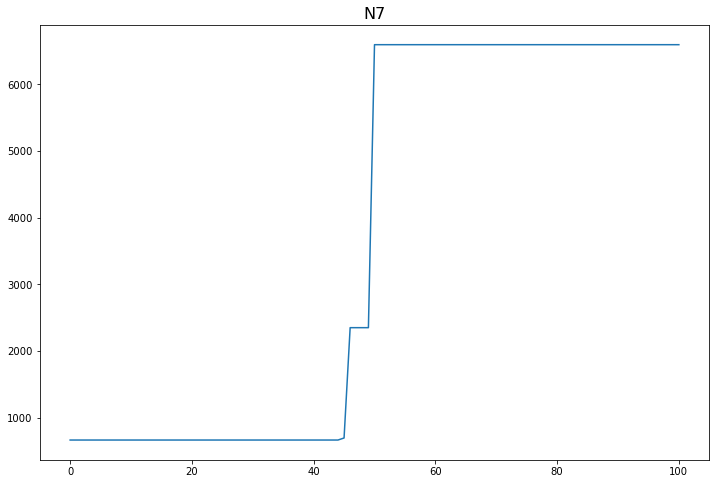

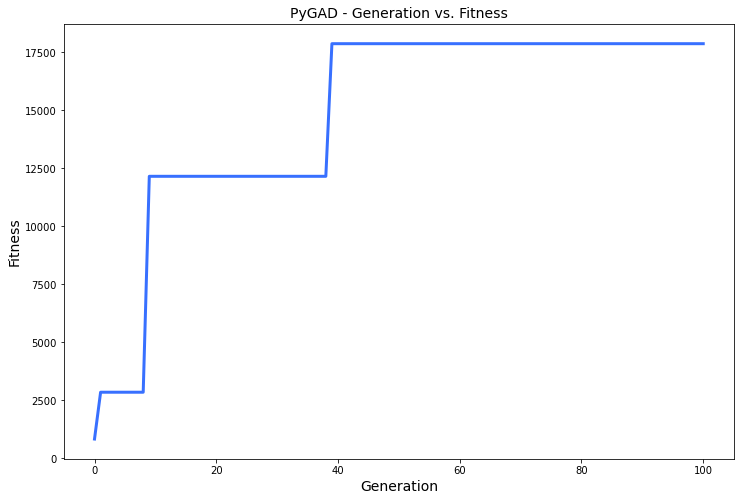

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.853 |==================| 25.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.844 |==================| 34.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.843 |==================| 34.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.768 |==================| 21.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.847 |==================| 30.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 24.808 |==================| 158.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 24.709 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 26.411 |==================| 7.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.452 |==================| 11.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 26.595 |==================| 18.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 26.53 |==================| 99.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.49 |==================| 19.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 26.615 |==================| 13.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.453 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.452 |==================| 11.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 26.595 |==================| 18.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 26.53 |==================| 99.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.49 |==================| 19.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 26.615 |==================| 13.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.453 |==================| 11.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 26.405 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.49 |==================| 19.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 26.615 |==================| 13.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 26.453 |==================| 11.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 26.405 |==================| 7.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 26.551 |==================| 96.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 26.592 |==================| 19.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 26.571 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.497 |==================| 22.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 26.38 |==================| 6.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 26.536 |==================| 230.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.469 |==================| 14.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 26.573 |==================| 30.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.599 |==================| 17.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.413 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 26.573 |==================| 30.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.599 |==================| 17.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.413 |==================| 7.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.536 |==================| 258.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 26.468 |==================| 13.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 26.61 |==================| 14.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.565 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.532 |==================| 118.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 26.384 |==================| 6.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.491 |==================| 20.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.423 |==================| 8.551 |==========
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.387 |==================| 6.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.578 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.423 |==================| 8.551 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.387 |==================| 6.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 26.578 |==================| 26.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.506 |==================| 28.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.605 |==================| 15.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.457 |==================| 11.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 26.52 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.479 |==================| 16.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.534 |==================| 159.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544 |==================| 266.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.578 |==================| 26.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.612 |==================| 13.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.539 |==================| 1136.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 26.588 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.612 |==================| 13.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.539 |==================| 1136.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 26.588 |==================| 20.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 26.586 |==================| 21.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.451 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.539 |==================| 1136.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 26.588 |==================| 20.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 26.586 |==================| 21.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.451 |==================| 11.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 26.565 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 26.561 |==================| 47.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.469 |==================| 14.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.584 |==================| 23.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 26.414 |==================| 7.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 26.562 |==================| 45.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.57 |==================| 34.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.578 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.584 |==================| 23.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 26.414 |==================| 7.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 26.562 |==================| 45.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.57 |==================| 34.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.578 |==================| 26.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.456 |==================| 11.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 26.589 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 26.609 |==================| 14.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 26.598 |==================| 17.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 26.615 |==================| 13.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.55 |==================| 107.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 26.521 |==================| 50.921 |==========
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 26.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 26.598 |==================| 17.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 26.615 |==================| 13.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.55 |==================| 107.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 26.521 |==================| 50.921 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 26.578 |==================| 26.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.55

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 26.542 |==================| 548.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 26.565 |==================| 40.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.496 |==================| 22.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 26.593 |==================| 18.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.513 |==================| 36.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 26.504 |==================| 27.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 26.565 |==================| 40.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.496 |==================| 22.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 26.593 |==================| 18.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.513 |==================| 36.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 26.504 |==================| 27.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |==================| 13.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 26.589 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 26.504 |==================| 27.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 26.616 |==================| 13.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 26.589 |==================| 20.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 26.569 |==================| 34.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.526 |==================| 70.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 26.607 |==================| 14.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.48 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.498 |==================| 23.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.477 |==================| 15.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.467 |==================| 13.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.391 |==================| 6.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.504 |==================| 27.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 26.61 |==================| 14.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.4 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.504 |==================| 27.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 26.61 |==================| 14.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.4 |==================| 7.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.554 |==================| 74.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 26.559 |==================| 54.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.535 |==================| 182.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.55 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 26.58 |==================| 24.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.469 |==================| 14.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 26.538 |==================| 512.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 26.393 |==================| 6.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.402 |==================| 7.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.298 |==========
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.402 |==================| 7.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.298 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544 |==================| 270.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 26.518 |==================| 44.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.616 |==================| 13.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |==================| 384.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 26.54 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.556 |==================| 62.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.486 |==================| 18.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.441 |==================| 10.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.408 |==================| 7.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.58 |==================| 24.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.383 |==================| 6.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.512 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.486 |==================| 18.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.441 |==================| 10.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.408 |==================| 7.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.58 |==================| 24.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.383 |==================| 6.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.512 |==================| 35.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 26.439 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.441 |==================| 10.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.408 |==================| 7.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.58 |==================| 24.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 26.383 |==================| 6.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 26.512 |==================| 35.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 26.439 |==================| 9.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.483 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.582 |==================| 24.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 26.515 |==================| 38.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 26.558 |==================| 55.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.478 |==================| 16.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.522 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 26.515 |==================| 38.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 26.558 |==================| 55.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.478 |==================| 16.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 26.522 |==================| 54.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 26.561 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 26.54 |==================| 3948.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 26.611 |==================| 14.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.495 |==================| 22.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 26.572 |==================| 31.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.469 |==================| 14.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.43 |==================| 9.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.504 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.495 |==================| 22.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 26.572 |==================| 31.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.469 |==================| 14.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.43 |==================| 9.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.504 |==================| 27.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 26.602 |==================| 16.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 26.387 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.43 |==================| 9.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.504 |==================| 27.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 26.602 |==================| 16.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 26.387 |==================| 6.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.494 |==================| 21.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.465 |==================| 13.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.54 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.578 |==================| 26.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |==================| 18.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.56 |==================| 50.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 26.606 |==================| 15.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.386 |==================| 6.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.542 |==================| 620.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.386 |==================| 6.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.542 |==================| 620.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.543 |==================| 412.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 26.56 |==================| 52.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 26.615 |==================| 13.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.469 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 26.607 |==================| 14.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 26.487 |==================| 18.601 |==========
Generation = 14
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.498 |==================| 23.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 26.557 |==================| 59.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 26.561 |==================| 49.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 26.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 26.487 |==================| 18.601 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 26.498 |==================| 23.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 26.557 |==================| 59.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 26.561 |==================| 49.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 26.608 |==================| 14.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.581

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 26.408 |==================| 7.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.458 |==================| 12.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 26.584 |==================| 22.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 26.617 |==================| 13.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.424 |==================| 8.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.554 |==================| 76.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.437 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 26.617 |==================| 13.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.424 |==================| 8.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.554 |==================| 76.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.437 |==================| 9.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 118.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.58 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 118.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.58 |==================| 24.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.573 |==================| 30.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 26.577 |==================| 27.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 26.575 |==================| 28.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 26.601 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.58 |==================| 25.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.504 |==================| 27.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 26.56 |==================| 51.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.473 |==================| 14.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |==================| 18.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 26.604 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |==================| 18.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 26.604 |==================| 15.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.471 |==================| 14.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.533 |==================| 134.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.5 |==================| 25.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.501 |==================| 25.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.452 |==================| 11.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 26.523 |==================| 58.293 |==========
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 26.595 |==================| 18.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.537 |==================| 279.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.541 |==================| 1978.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.537 |==================| 279.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.541 |==================| 1978.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 26.586 |==================| 22.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 26.515 |==================| 39.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 26.559 |==================| 52.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 26.601 |==================| 16.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 26.613 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.382 |==================| 6.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 26.566 |==================| 39.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.535 |==================| 174.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.546 |==================| 189.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.415 |==================| 7.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 26.565 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.415 |==================| 7.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 26.565 |==================| 40.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 26.393 |==================| 6.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.408 |==================| 7.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.567 |==================| 38.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.409 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.415 |==================| 7.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 26.565 |==================| 40.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 26.393 |==================| 6.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.408 |==================| 7.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.567 |==================| 38.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.409 |==================| 7.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.566 |==================| 38.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 26.401 |==================| 7.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.569 |==================| 35.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.603 |==================| 15.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 26.45 |==================| 11.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 26.612 |==================| 14.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 26.582 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.569 |==================| 35.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.603 |==================| 15.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 26.45 |==================| 11.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 26.612 |==================| 14.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 26.582 |==================| 23.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.485 |==================| 18.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 26.617 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 26.456 |==================| 11.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 26.434 |==================| 9.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 26.551 |==================| 89.872 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.534 |==================| 151.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.393 |==================| 6.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |==================| 67.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.534 |==================| 151.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.393 |==================| 6.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |==================| 67.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.523 |==================| 56.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.493 |==================| 21.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 26.593 |==================| 19.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.444 |==================| 10.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.555 |==================| 70.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.482 |==================| 17.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.46 |==================| 12.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 26.559 |==================| 52.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.533 |==================| 136.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.501 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 26.555 |==================| 70.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.482 |==================| 17.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.46 |==================| 12.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 26.559 |==================| 52.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.533 |==================| 136.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.501 |==================| 25.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.446 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.482 |==================| 17.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.46 |==================| 12.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 26.559 |==================| 52.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 26.533 |==================| 136.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.501 |==================| 25.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.446 |==================| 10.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.462 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.515 |==================| 39.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.403 |==================| 7.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.456 |==================| 11.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 26.516 |==================| 40.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.398 |==================| 7.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.444 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.515 |==================| 39.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.403 |==================| 7.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.456 |==================| 11.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 26.516 |==================| 40.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.398 |==================| 7.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.444 |==================| 10.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 26.602 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.491 |==================| 20.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.453 |==================| 11.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.564 |==================| 41.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 26.601 |==================| 16.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.452 |==================| 11.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.48 |==================| 16.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.453 |==================| 11.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.564 |==================| 41.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 26.601 |==================| 16.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.452 |==================| 11.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.48 |==================| 16.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.716 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.384 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.564 |==================| 41.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 26.601 |==================| 16.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.452 |==================| 11.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.48 |==================| 16.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.409 |==================| 7.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 26.548 |==================| 132.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.395 |==================| 6.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 26.575 |==================| 28.516 |==========
Fitness = 13999.080383297243
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.409 |==================| 7.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.395 |==================| 6.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 26.575 |==================| 28.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.409 |==================| 7.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 229.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 26.496 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.415 |==================| 8.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.534 |==================| 168.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 26.466 |==================| 13.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.511 |==================| 34.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.513 |==================| 36.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.514 |==================| 37.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.477 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.513 |==================| 36.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.514 |==================| 37.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 26.477 |==================| 15.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 26.442 |==================| 10.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 26.488 |==================| 18.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 26.611 |==================| 14.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 26.601 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.554 |==================| 72.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.42 |==================| 8.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.512 |==================| 34.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 26.561 |==================| 49.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.548 |==================| 123.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.424 |==================| 8.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 26.59 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.548 |==================| 123.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.424 |==================| 8.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 26.59 |==================| 20.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.547 |==================| 154.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 14.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 101.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 26.524 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.424 |==================| 8.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 26.59 |==================| 20.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.547 |==================| 154.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 14.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 101.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 26.524 |==================| 59.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.393 |==================| 6.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.536 |==================| 249.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 26.616 |==================| 13.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.395 |==================| 6.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 26.587 |==================| 21.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.47 |==================| 14.246 |==========
Fitness = 13999.080383297243
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 26.536 |==================| 249.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 26.616 |==================| 13.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.395 |==================| 6.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 26.587 |==================| 21.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.47 |==================| 14.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 26.565 |==================| 40.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 26.38 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 26.561 |==================| 48.554 |==========
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.388 |==================| 6.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.543 |==================| 431.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.379 |==================| 6.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.578 |==================| 26.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 26.579

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.543 |==================| 431.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.379 |==================| 6.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.578 |==================| 26.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 26.579 |==================| 25.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 26.501 |==================| 25.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.577 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |==================| 27.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.566 |==================| 38.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.594 |==================| 18.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.433 |==================| 9.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 26.609 |==================| 14.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.549 |==================| 113.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 26.464 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.566 |==================| 38.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.594 |==================| 18.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.433 |==================| 9.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 26.609 |==================| 14.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.549 |==================| 113.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 26.464 |==================| 13.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 26.592 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.594 |==================| 18.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 26.433 |==================| 9.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 26.609 |==================| 14.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.549 |==================| 113.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 26.464 |==================| 13.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 26.592 |==================| 19.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.512 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.45 |==================| 11.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 26.488 |==================| 18.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |==================| 53.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.557 |==================| 58.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.45 |==================| 11.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.407 |==================| 7.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 26.488 |==================| 18.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |==================| 53.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.557 |==================| 58.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.45 |==================| 11.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.407 |==================| 7.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 26.586 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.413 |==================| 7.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.405 |==================| 7.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |==================| 62.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 26.56 |==================| 51.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 26.613 |==================| 13.692 |==========
Generation = 31
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 26.405 |==================| 7.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |==================| 62.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 26.56 |==================| 51.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 26.613 |==================| 13.692 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 |==================| 14.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 26.532 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |==================| 62.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 26.56 |==================| 51.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 26.613 |==================| 13.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 26.387 |==================| 6.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.56 |==================| 49.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.551 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 26.387 |==================| 6.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.56 |==================| 49.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.551 |==================| 93.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 26.589 |==================| 20.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.601 |==================| 16.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 26.505 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.551 |==================| 93.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 26.589 |==================| 20.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.601 |==================| 16.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 26.505 |==================| 28.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 26.564 |==================| 41.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.446 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 26.603 |==================| 15.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 26.612 |==================| 13.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.616 |==================| 13.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.54 |==================| 21678.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 26.59 |==================| 20.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 26.403 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 26.612 |==================| 13.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 26.616 |==================| 13.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 26.54 |==================| 21678.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 26.59 |==================| 20.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.559 |==================| 53.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 26.403 |==================| 7.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.552 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.571 |==================| 33.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.601 |==================| 16.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 26.552 |==================| 84.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.514 |==================| 37.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.577 |==================| 27.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.402 |==================| 7.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 26.443 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 26.601 |==================| 16.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 26.552 |==================| 84.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.514 |==================| 37.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.577 |==================| 27.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.402 |==================| 7.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 26.443 |==================| 10.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.499 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.577 |==================| 27.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.402 |==================| 7.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 26.443 |==================| 10.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.499 |==================| 24.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.57 |==================| 34.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.533 |==================| 138.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 26.552 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.459 |==================| 12.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.557 |==================| 61.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.563 |==================| 43.334 |==========
Fitness = 21678.68672473147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.573 |==================| 30.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 26.612 |==================| 13.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 231.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.557 |==================| 61.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 26.563 |==================| 43.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.573 |==================| 30.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 26.612 |==================| 13.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 231.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.535 |==================| 179.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.489 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 26.571 |==================| 32.285 |==========
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 26.6 |==================| 16.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 26.608 |==================| 14.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 26.53 |==================| 100.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.577 |==================| 27.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.53

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 26.6 |==================| 16.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 26.608 |==================| 14.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 26.53 |==================| 100.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.577 |==================| 27.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.534 |==================| 163.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 26.554 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 26.504 |==================| 27.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.546 |==================| 189.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.397 |==================| 6.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.49 |==================| 19.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 26.587 |==================| 21.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 26.608 |==================| 14.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.428 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 26.49 |==================| 19.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 26.587 |==================| 21.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 26.608 |==================| 14.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.428 |==================| 8.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.583 |==================| 23.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.496 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 26.608 |==================| 14.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.428 |==================| 8.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.583 |==================| 23.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.777 |===========| 26.496 |==================| 22.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 26.571 |==================| 32.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.386 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 26.549 |==================| 121.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.428 |==================| 8.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 26.554 |==================| 71.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 26.617 |==================| 13.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.47 |==================| 14.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.492 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 26.554 |==================| 71.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 26.617 |==================| 13.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.47 |==================| 14.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.492 |==================| 20.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 26.605 |==================| 15.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 26.593 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.565 |==================| 41.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.554 |==================| 73.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 26.599 |==================| 17.137 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.459 |==================| 12.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 26.605 |==================| 15.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 26

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.459 |==================| 12.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 26.605 |==================| 15.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 26.606 |==================| 15.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.573 |==================| 31.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 26.552 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.42 |==================| 8.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.422 |==================| 8.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 26.602 |==================| 16.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.404 |==================| 7.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.485 |==================| 17.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.41 |==================| 7.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.556 |==================| 64

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.404 |==================| 7.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.485 |==================| 17.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.41 |==================| 7.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.556 |==================| 64.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.396 |==================| 6.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.472 |==================| 14.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.482 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 26.485 |==================| 17.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 26.41 |==================| 7.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.556 |==================| 64.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.396 |==================| 6.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.472 |==================| 14.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.482 |==================| 17.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 26.564 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 26.384 |==================| 6.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 26.513 |==================| 36.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 26.61 |==================| 14.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.438 |==================| 9.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.382 |==================| 6.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 26.562 |==================| 46.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.443 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 26.513 |==================| 36.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 26.61 |==================| 14.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.438 |==================| 9.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.382 |==================| 6.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 26.562 |==================| 46.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.443 |==================| 10.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 26.611 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 26.54 |==================| 1901.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |==================| 6.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.475 |==================| 15.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.42 |==================| 8.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 26.558 |==================| 57.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 26.59 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |==================| 6.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.475 |==================| 15.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.42 |==================| 8.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 26.558 |==================| 57.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 26.59 |==================| 20.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 26.573 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.391 |==================| 6.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 26.475 |==================| 15.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.42 |==================| 8.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 26.558 |==================| 57.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 26.59 |==================| 20.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 26.573 |==================| 30.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.509 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.579 |==================| 25.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.453 |==================| 11.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 26.492 |==================| 20.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 26.612 |==================| 13.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 26.59 |==================| 20.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.545 |==================| 209.813 |==========
Fitness = 21678.68672473147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 26.612 |==================| 13.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 26.59 |==================| 20.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.545 |==================| 209.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.406 |==================| 7.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 26.592 |==================| 19.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.547 |==================| 155.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 26.578 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 26.539 |==================| 1160.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 26.501 |==================| 25.375 |==========
Generation = 44
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 26.536 |==================| 206.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.568 |==================| 36.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 26.564 |==================| 41.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.55 |==================| 104.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 26.536 |==================| 206.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.568 |==================| 36.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 26.564 |==================| 41.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.55 |==================| 104.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 26.603 |==================| 15.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.543 |==================| 332.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 26.445 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.544 |==================| 285.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 26.524 |==================| 62.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.556 |==================| 63.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 26.58 |==================| 25.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |==================| 27.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.415 |==================| 7.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 26.38 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |==================| 27.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.415 |==================| 7.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 26.38 |==================| 6.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 26.592 |==================| 19.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.384 |==================| 6.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.387 |==================| 6.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 26.6 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.415 |==================| 7.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 26.38 |==================| 6.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 26.592 |==================| 19.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.384 |==================| 6.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.387 |==================| 6.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 26.6 |==================| 16.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 26.61 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.411 |==================| 7.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 26.6 |==================| 16.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 26.605 |==================| 15.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.436 |==================| 9.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 26.574 |==================| 29.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.399 |==================| 7.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.38 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 26.574 |==================| 29.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.399 |==================| 7.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.38 |==================| 6.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 26.611 |==================| 14.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 26.529 |==================| 86.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 26.569 |==================| 34.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.413 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.569 |==================| 34.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.39 |==================| 6.651 |==========
Generation = 47
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 26.584 |==================| 22.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.582 |==================| 23.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.469 |==================| 14.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 26.613

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 26.584 |==================| 22.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 26.56 |==================| 51.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.582 |==================| 23.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 26.469 |==================| 14.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 26.613 |==================| 13.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.421 |==================| 8.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 26.585 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 26.601 |==================| 16.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 26.581 |==================| 24.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 26.576 |==================| 28.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 26.577 |==================| 27.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.448 |==================| 10.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.442 |==================| 10.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.452 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 26.576 |==================| 28.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 26.577 |==================| 27.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.448 |==================| 10.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 26.442 |==================| 10.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.452 |==================| 11.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.561 |==================| 49.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.546 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.452 |==================| 11.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.561 |==================| 49.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.546 |==================| 183.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 26.604 |==================| 15.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.406 |==================| 7.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 26.449 |==================| 10.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 26.608 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 26.598 |==================| 17.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.55 |==================| 102.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.439 |==================| 9.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.552 |==================| 82.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.525 |==================| 66.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.42 |==================| 8.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 26.592 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.55 |==================| 102.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.439 |==================| 9.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.552 |==================| 82.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.525 |==================| 66.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.42 |==================| 8.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 26.592 |==================| 19.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.539 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.403 |==================| 7.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.498 |==================| 23.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 26.56 |==================| 49.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 26.582 |==================| 24.103 |==========
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.554 |==================| 75.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.463 |==================| 12.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.418

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 26.582 |==================| 24.103 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.554 |==================| 75.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.463 |==================| 12.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.418 |==================| 8.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 26.478 |==================| 16.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.477 |==================| 15.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 26.416 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.504 |==================| 27.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 26.472 |==================| 14.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 393.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 26.588 |==================| 21.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |==================| 6.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.477 |==================| 15.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.38 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 393.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 26.588 |==================| 21.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.395 |==================| 6.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.477 |==================| 15.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.38 |==================| 6.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.582 |==================| 23.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.478 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.38 |==================| 6.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.582 |==================| 23.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.478 |==================| 16.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.547 |==================| 162.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 26.382 |==================| 6.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 26.522 |==================| 53.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.487 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.537 |==================| 262.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 26.553 |==================| 81.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.498 |==================| 23.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.545 |==================| 210.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.463 |==================| 12.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.461 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================| 18.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.498 |==================| 23.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.545 |==================| 210.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.463 |==================| 12.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.461 |==================| 12.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.578 |==================| 26.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 26.533 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.395 |==================| 6.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 26.615 |==================| 13.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.534 |==================| 167.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 26.585 |==================| 22.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.551 |==================| 91.175 |==========
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.437 |==================| 9.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.54

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 26.585 |==================| 22.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.551 |==================| 91.175 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.437 |==================| 9.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.541 |==================| 932.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.423 |==================| 8.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 26.473 |==================| 14.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.418 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 26.551 |==================| 91.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |==================| 374.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.447 |==================| 10.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.46 |==================| 12.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.569 |==================| 34.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.407 |==================| 7.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 26.603 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |==================| 374.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.447 |==================| 10.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.46 |==================| 12.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.569 |==================| 34.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.407 |==================| 7.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 26.603 |==================| 16.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 26.614 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.407 |==================| 7.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 26.603 |==================| 16.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 26.614 |==================| 13.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.561 |==================| 49.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 26.608 |==================| 14.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 26.541 |==================| 987.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.571 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.541 |==================| 1379.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.394 |==================| 6.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 26.491 |==================| 20.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 26.384 |==================| 6.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.486 |==================| 18.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 26.587 |==================| 21.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.555 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 26.486 |==================| 18.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 26.587 |==================| 21.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.555 |==================| 68.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 26.591 |==================| 19.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.527 |==================| 72.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 26.617 |==================| 13.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 26.434 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 26.592 |==================| 19.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.385 |==================| 6.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.567 |==================| 37.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.46 |==================| 12.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 26.601 |==================| 16.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |==================| 67.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.502 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.385 |==================| 6.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.567 |==================| 37.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.46 |==================| 12.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 26.601 |==================| 16.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |==================| 67.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.502 |==================| 26.008 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.38 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.567 |==================| 37.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.46 |==================| 12.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 26.601 |==================| 16.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |==================| 67.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.502 |==================| 26.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 26.431 |==================| 9.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.401 |==================| 7.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 26.585 |==================| 22.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.554 |==================| 74.36 |==========
Fitness = 21678.68672473147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |==================| 67.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.401 |==================| 7.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 26.585 |==================| 22.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.554 |==================| 74.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.555 |==================| 67.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 26.45 |==================| 11.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.525 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.539 |==================| 845.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.385 |==================| 6.452 |==========
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 26.558 |==================| 56.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.548 |==================| 127.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |==================| 16.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.402 |==================| 7.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 26.572 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 26.558 |==================| 56.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.548 |==================| 127.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |==================| 16.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.402 |==================| 7.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 26.572 |==================| 31.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 26.586 |==================| 21.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.403 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 26.446 |==================| 10.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.502 |==================| 26.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 26.47 |==================| 14.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 26.466 |==================| 13.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.411 |==================| 7.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.516 |==================| 41.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.581 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.411 |==================| 7.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.516 |==================| 41.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.581 |==================| 24.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 26.397 |==================| 6.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.469 |==================| 14.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 26.529 |==================| 86.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.577 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 26.397 |==================| 6.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.469 |==================| 14.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 26.529 |==================| 86.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 26.577 |==================| 27.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.508 |==================| 31.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 26.612 |==================| 13.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.482 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 26.506 |==================| 29.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 26.467 |==================| 13.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 26.417 |==================| 8.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.49 |==================| 19.854 |==========
Fitness = 21678.68672473147
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |==================| 16.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 26.429 |==================| 8.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 26.602 |==================| 16.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 26.429 |==================| 8.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 26.605 |==================| 15.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.444 |==================| 10.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 26.609 |==================| 14.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.545 |==================| 196.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.435 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 26.553 |==================| 79.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 26.587 |==================| 21.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.546 |==================| 190.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 26.519 |==================| 46.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.565 |==================| 40.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.449 |==================| 10.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.535 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.565 |==================| 40.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 26.449 |==================| 10.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 26.535 |==================| 178.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 26.594 |==================| 18.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 26.581 |==================| 24.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 26.486 |==================| 18.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 26.476 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.431 |==================| 9.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 26.549 |==================| 110.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.51 |==================| 32.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.603 |==================| 15.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 226.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.385 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 26.549 |==================| 110.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.51 |==================| 32.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.603 |==================| 15.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 226.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.385 |==================| 6.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.38 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.51 |==================| 32.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 26.603 |==================| 15.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.545 |==================| 226.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 26.602 |==================| 16.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.385 |==================| 6.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.38 |==================| 6.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 26.576 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 26.426 |==================| 8.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.468 |==================| 13.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 26.594 |==================| 18.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 26.574 |==================| 29.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.518 |==================| 43.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 26.614 |==================| 13.49 |==========
Fitness = 130358.41504814004
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.518 |==================| 43.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 26.614 |==================| 13.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 26.564 |==================| 42.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 26.603 |==================| 15.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.518 |==================| 44.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.494 |==================| 21.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 26.566 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 26.605 |==================| 15.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.584 |==================| 22.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.444 |==================| 10.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 26.592 |==================| 19.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 26.604 |==================| 15.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 26.563 |==================| 43.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 26.576 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.584 |==================| 22.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 26.444 |==================| 10.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 26.592 |==================| 19.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 26.604 |==================| 15.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 26.563 |==================| 43.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 26.576 |==================| 27.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 26.593 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.526 |==================| 71.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.582 |==================| 23.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.564 |==================| 41.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.425 |==================| 8.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.389 |==================| 6.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.56 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.582 |==================| 23.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.564 |==================| 41.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.425 |==================| 8.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.389 |==================| 6.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.56 |==================| 50.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.518 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.389 |==================| 6.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.56 |==================| 50.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 26.518 |==================| 44.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.403 |==================| 7.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 |==================| 14.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.481 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 26.458 |==================| 12.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 26.574 |==================| 29.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 26.613 |==================| 13.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.465 |==================| 13.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 26.586 |==================| 21.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 26.571 |==================| 32.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 26.586 |==================| 21.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 26.571 |==================| 32.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.577 |==================| 27.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.428 |==================| 8.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 26.611 |==================| 14.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 26.599 |==================| 17.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 26.603 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.418 |==================| 8.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.482 |==================| 17.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.5 |==================| 24.983 |==========
Generation = 67
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.436 |==================| 9.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.546 |==================| 181.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |==================| 372.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.4

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.546 |==================| 181.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.543 |==================| 372.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.435 |==================| 9.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 26.558 |==================| 56.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.391 |==================| 6.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.542 |==================| 613.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 26.546 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.535 |==================| 185.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.388 |==================| 6.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.545 |==================| 241.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.488 |==================| 19.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.561 |==================| 48.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.479 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.388 |==================| 6.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.545 |==================| 241.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.488 |==================| 19.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.561 |==================| 48.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.479 |==================| 16.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 26.561 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.545 |==================| 241.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 26.611 |==================| 14.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.488 |==================| 19.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.561 |==================| 48.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 26.479 |==================| 16.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 26.561 |==================| 47.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.402 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.5 |==================| 25.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.396 |==================| 6.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 26.609 |==================| 14.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 26.591 |==================| 19.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.434 |==================| 9.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.38 |==================| 6.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.396 |==================| 6.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 26.609 |==================| 14.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 26.591 |==================| 19.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.434 |==================| 9.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.38 |==================| 6.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.544 |==================| 260.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 26.447 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.474 |==================| 14.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 26.565 |==================| 40.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 26.478 |==================| 16.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 26.553 |==================| 79.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.379 |==================| 6.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.607 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 26.553 |==================| 79.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.379 |==================| 6.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.607 |==================| 15.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 26.613 |==================| 13.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.484 |==================| 17.759 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 26.543 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.379 |==================| 6.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.607 |==================| 15.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 26.613 |==================| 13.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.484 |==================| 17.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==================| 300.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.594 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.519 |==================| 47.552 |==========
Fitness = 130358.41504814004
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==================| 300.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.594 |==================| 18.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.386 |==================| 6.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.538 |==================| 389.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 26.544 |==================| 300.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 26.594 |==================| 18.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.386 |==================| 6.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.538 |==================| 389.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 26.49 |==================| 19.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 26.615 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 26.599 |==================| 17.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.499 |==================| 24.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.48 |==================| 16.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 26.574 |==================| 29.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 26.43 |==================| 9.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.482 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.499 |==================| 24.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.48 |==================| 16.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 26.574 |==================| 29.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 26.43 |==================| 9.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |==================| 13.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.482 |==================| 17.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.392 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.547 |==================| 147.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 26.588 |==================| 21.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.461 |==================| 12.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 26.442 |==================| 10.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.403 |==================| 7.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 26.598 |==================| 17.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.563 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 26.588 |==================| 21.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.461 |==================| 12.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 26.442 |==================| 10.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.403 |==================| 7.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 26.598 |==================| 17.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.563 |==================| 44.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.393 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.403 |==================| 7.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 26.598 |==================| 17.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.563 |==================| 44.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.393 |==================| 6.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.523 |==================| 57.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.583 |==================| 23.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 26.574 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 26.583 |==================| 23.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 26.552 |==================| 85.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.58 |==================| 25.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 26.392 |==================| 6.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 26.588 |==================| 21.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.425 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 26.552 |==================| 85.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.58 |==================| 25.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 26.392 |==================| 6.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 26.588 |==================| 21.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.425 |==================| 8.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.578 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 163.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 26.571 |==================| 32.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.402 |==================| 7.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.572 |==================| 32.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.542 |==================| 771.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.178 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.572 |==================| 32.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.542 |==================| 771.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.178 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.486 |==================| 18.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 26.441 |==================| 10.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.381 |==================| 6.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 26.485

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.398 |==================| 7.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.575 |==================| 28.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 26.592 |==================| 19.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.469 |==================| 14.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 100.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |==================| 53.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.544 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.469 |==================| 14.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 100.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |==================| 53.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.544 |==================| 283.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 26.567 |==================| 36.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.561 |==================| 49.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 26.547 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==================| 100.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.559 |==================| 53.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.544 |==================| 283.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 26.567 |==================| 36.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 26.561 |==================| 49.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 26.547 |==================| 145.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 26.55 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.554 |==================| 73.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.544 |==================| 245.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 26.493 |==================| 20.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.415 |==================| 7.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.416 |==================| 8.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.571 |==================| 32.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.543 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.415 |==================| 7.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.416 |==================| 8.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 26.571 |==================| 32.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.543 |==================| 350.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.401 |==================| 7.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 26.57 |==================| 33.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 26.602 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 26.559 |==================| 55.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.494 |==================| 21.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.426 |==================| 8.769 |==========
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 26.59 |==================| 20.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.433 |==================| 9.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.494 |==================| 21.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.426 |==================| 8.769 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 26.59 |==================| 20.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.433 |==================| 9.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.503 |==================| 26.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 26.558 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 26.616 |==================| 13.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.426 |==================| 8.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.549 |==================| 114.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.573 |==================| 30.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.536 |==================| 238.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.541 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 26.57 |==================| 33.416 |==========
Fitness = 130358.41504814004
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 26.549 |==================| 114.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.573 |==================| 30.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.536 |==================| 238.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.541 |==================| 5414.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 26.573 |==================| 30.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.536 |==================| 238.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.541 |==================| 5414.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 26.505 |==================| 28.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 26.53 |==================| 92.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 26.568 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 26.572 |==================| 31.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.578 |==================| 26.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.543 |==================| 322.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.462 |==================| 12.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 26.598 |==================| 17.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.488 |==================| 19.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.542 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 26.598 |==================| 17.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.488 |==================| 19.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.542 |==================| 468.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 26.604 |==================| 15.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 26.467 |==================| 13.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.534 |==================| 146.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 26.419 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.581 |==================| 24.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.462 |==================| 12.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.406 |==================| 7.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.397 |==================| 6.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.528 |==================| 81.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.449 |==================| 10.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.528 |==================| 81.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.449 |==================| 10.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 26.604 |==================| 15.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 389.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.478 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 26.449 |==================| 10.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 26.6 |==================| 16.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 26.604 |==================| 15.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 26.543 |==================| 389.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.478 |==================| 15.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.413 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.549 |==================| 117.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 26.548 |==================| 132.133 |==========
Fitness = 130358.41504814004
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.413 |==================| 7.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.605 |==================| 15.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 26.446 |==================| 10.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.579 |==================| 25.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 26.548 |==================| 132.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.413 |==================| 7.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 26.605 |==================| 15.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 26.446 |==================| 10.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 26.537 |==================| 305.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 26.602 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.278 |===========| 26.416 |==================| 8.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.501 |==================| 25.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 26.581 |==================| 24.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.581 |==================| 24.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.455 |==================| 11.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.553 |==================| 77.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.501 |==================| 25.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 26.581 |==================| 24.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.581 |==================| 24.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.455 |==================| 11.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.553 |==================| 77.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |==================| 6.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.528 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 26.597 |==================| 17.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 26.515 |==================| 39.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.458 |==================| 12.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.387 |==================| 6.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.511 |==================| 33.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 26.552 |==================| 86.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 26.59 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 26.511 |==================| 33.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 26.552 |==================| 86.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 26.59 |==================| 19.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 26.557 |==================| 59.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 26.576 |==================| 27.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 26.59 |==================| 20.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 26.551 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 26.59 |==================| 19.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 26.557 |==================| 59.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 26.576 |==================| 27.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 26.59 |==================| 20.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 26.551 |==================| 95.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 26.612 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 26.601 |==================| 16.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 26.59 |==================| 19.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 26.601 |==================| 16.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.44 |==================| 9.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 26.605 |==================| 15.548 |==========
Fitness = 130358.41504814004
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.404 |==================| 7.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 26.605 |==================| 15.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.404 |==================| 7.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.416 |==================| 8.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 26.568 |==================| 36.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 26.597 |==================| 17.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 26.614 |==================| 13.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 26.575 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 26.569 |==================| 34.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |==================| 62.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.397 |==================| 6.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.459 |==================| 12.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.545 |==================| 201.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.556 |==================| 62.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 26.397 |==================| 6.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.459 |==================| 12.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.446 |==================| 10.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 26.545 |==================| 201.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.398 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 26.561 |==================| 47.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.58 |==================| 25.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.533 |==================| 138.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.533 |==================| 128.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.563 |==================| 44.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 26.596 |==================| 17.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.423 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.58 |==================| 25.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.533 |==================| 138.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 26.533 |==================| 128.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 26.563 |==================| 44.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 26.596 |==================| 17.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.423 |==================| 8.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 26.594 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 26.596 |==================| 17.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.423 |==================| 8.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 26.594 |==================| 18.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.434 |==================| 9.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 26.488 |==================| 19.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 26.609 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 26.552 |==================| 89.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 26.573 |==================| 30.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 26.583 |==================| 23.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.421 |==================| 8.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 26.464 |==================| 13.078 |==========
Fitness = 130358.41504814004
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 26.557 |==================| 60.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 26.573 |==================| 30.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 26.583 |==================| 23.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.421 |==================| 8.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 26.464 |==================| 13.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 26.557 |==================| 60.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 26.602 |==================| 16.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 26.576 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 26.582 |==================| 24.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.481 |==================| 16.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 26.392 |==================| 6.748 |==========
Generation = 89
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 26.562 |==================| 46.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 26.536 |==================| 207.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.541 |==================| 2843.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 26.536 |==================| 207.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.541 |==================| 2843.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 26.581 |==================| 24.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.401 |==================| 7.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 26.616 |==================| 13.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 26.594 |==================| 18.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 26.418 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 26.599 |==================| 17.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 26.452 |==================| 11.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.553 |==================| 78.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 26.601 |==================| 16.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 163.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.58 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 106.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 163.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.58 |==================| 25.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.546 |==================| 175.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.439 |==================| 9.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.422 |==================| 8.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.455 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.546 |==================| 163.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 26.58 |==================| 25.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.546 |==================| 175.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.439 |==================| 9.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.422 |==================| 8.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 26.455 |==================| 11.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 26.613 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 26.548 |==================| 124.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.527 |==================| 73.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.563 |==================| 45.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 26.6 |==================| 16.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.393 |==================| 6.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.517 |==================| 43.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 26.544 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.527 |==================| 73.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.563 |==================| 45.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 26.6 |==================| 16.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.393 |==================| 6.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.517 |==================| 43.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 26.544 |==================| 254.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 26.594 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 26.434 |==================| 9.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.507 |==================| 29.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.569 |==================| 35.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.318 |==========
Generation = 92
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.469 |==================| 14.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 26.61 |==================| 14.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.556 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.507 |==================| 29.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.569 |==================| 35.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.318 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.469 |==================| 14.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 26.61 |==================| 14.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 26.556 |==================| 63.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 26.595 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.569 |==================| 35.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 26.606 |==================| 15.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.794 |===========| 26.494 |==================| 21.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.538 |==================| 395.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 26.6 |==================| 16.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.566 |==================| 39.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.547 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 26.6 |==================| 16.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.566 |==================| 39.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.547 |==================| 149.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 26.516 |==================| 41.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.448 |==================| 10.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 26.405 |==================| 7.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.46 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 26.448 |==================| 10.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 26.405 |==================| 7.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.46 |==================| 12.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 26.607 |==================| 15.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.48 |==================| 16.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 26.462 |==================| 12.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 26.612 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 26.568 |==================| 35.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.42 |==================| 8.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.392 |==================| 6.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.381 |==================| 6.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.567 |==================| 38.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.405 |==================| 7.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.556 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.42 |==================| 8.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.392 |==================| 6.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.381 |==================| 6.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.567 |==================| 38.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.405 |==================| 7.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.556 |==================| 64.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.455 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.504 |==================| 27.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 26.544 |==================| 251.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.566 |==================| 38.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 105.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.45 |==================| 11.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.414 |==================| 7.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.456 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 26.544 |==================| 251.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 26.566 |==================| 38.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.55 |==================| 105.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.45 |==================| 11.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.414 |==================| 7.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.456 |==================| 11.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 26.593 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.45 |==================| 11.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.414 |==================| 7.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 26.456 |==================| 11.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 26.593 |==================| 19.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.39 |==================| 6.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.503 |==================| 26.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 26.393 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.523 |==================| 56.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 26.446 |==================| 10.565 |==========
Fitness = 130358.41504814004
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 26.393 |==================| 6.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.483 |==================| 17.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.469 |==================| 13.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 15.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.483 |==================| 17.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.469 |==================| 13.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 26.607 |==================| 15.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.435 |==================| 9.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.384 |==================| 6.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.499 |==================| 24.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.581 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.547 |==================| 142.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 26.571 |==================| 32.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.518 |==================| 44.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 26.399 |==================| 7.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.533 |==================| 131.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.53 |==================| 93.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.412 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 26.571 |==================| 32.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.518 |==================| 44.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 26.399 |==================| 7.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.533 |==================| 131.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 26.53 |==================| 93.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.412 |==================| 7.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 26.608 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 26.497 |==================| 23.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.501 |==================| 25.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.544 |==================| 246.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 26.599 |==================| 16.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 26.55 |==================| 98.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.382 |==================| 6.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.556 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 26.55 |==================| 98.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.382 |==================| 6.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.556 |==================| 64.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 |==================| 14.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 26.426 |==================| 8.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 26.42 |==================| 8.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.511 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.382 |==================| 6.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 26.556 |==================| 64.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 26.607 |==================| 14.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 26.426 |==================| 8.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 26.42 |==================| 8.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 26.511 |==================| 34.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 26.595 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.493 |==================| 21.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.413 |==================| 7.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.454 |==================| 11.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.418 |==================| 8.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.461 |==================| 12.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.414 |==================| 7.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.564 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 26.413 |==================| 7.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 26.454 |==================| 11.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.418 |==================| 8.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.0 |===========| 26.461 |==================| 12.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.414 |==================| 7.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.564 |==================| 42.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 26.54 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.425 |==================| 8.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.547 |==================| 156.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 26.505 |==================| 28.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.514 |==================| 38.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.4 |==================| 7.145 |==========
Generation = 100
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |==================| 6.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.399

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 26.547 |==================| 156.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 26.505 |==================| 28.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.514 |==================| 38.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.4 |==================| 7.145 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |==================| 6.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.399 |==================| 7.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.486 |==

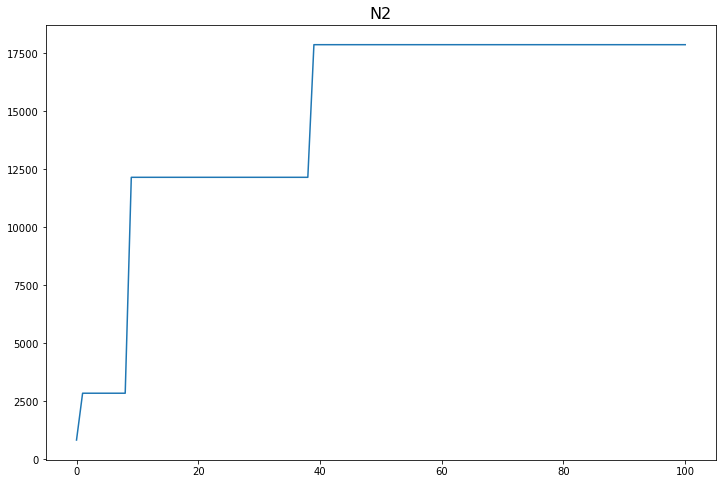

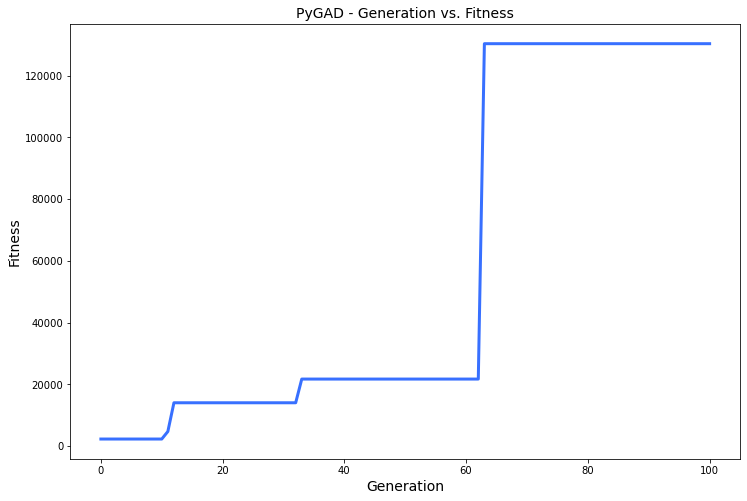

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.397 |==================| 6.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.399 |==================| 7.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 26.486 |==================| 18.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 26.551 |==================| 96.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 26.618 |==================| 12.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 26.417 |==================| 8.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 26.554 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 26.794 |==================| 10.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.562 |==================| 3.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.986 |==================| 9.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 26.752 |==================| 7.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.84 |==================| 21.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.77 |==================| 8.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.712 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.84 |==================| 21.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.77 |==================| 8.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.712 |==================| 5.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 26.958 |==================| 13.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.947 |==================| 16.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.978 |==================| 10.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.045 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 26.712 |==================| 5.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 26.958 |==================| 13.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 26.947 |==================| 16.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 26.978 |==================| 10.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.045 |==================| 6.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.683 |==================| 4.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.586 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.007 |==================| 8.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 26.815 |==================| 14.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 26.843 |==================| 23.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.069 |==================| 5.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.037 |==================| 6.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 26.949 |==================| 15.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.74 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 26.843 |==================| 23.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.069 |==================| 5.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.037 |==================| 6.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 26.949 |==================| 15.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.74 |==================| 6.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.883 |==================| 326.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.805 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 26.846 |==================| 24.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.515 |==================| 2.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.001 |==================| 8.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 26.862 |==================| 42.502 |==========
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.077 |==================| 5.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.071 |==================| 5.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.007 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 26.862 |==================| 42.502 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.077 |==================| 5.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 27.071 |==================| 5.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.007 |==================| 8.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.506 |==================| 2.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 26.578 |==================| 3.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.987 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.044 |==================| 6.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.679 |==================| 4.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.769 |==================| 8.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 26.933 |==================| 21.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.52 |==================| 2.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.05 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.679 |==================| 4.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.769 |==================| 8.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 26.933 |==================| 21.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.52 |==================| 2.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.05 |==================| 6.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.769 |==================| 8.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 26.933 |==================| 21.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.52 |==================| 2.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.05 |==================| 6.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==================| 5.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 26.595 |==================| 3.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 26.492 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |==================| 5.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 26.898 |==================| 81.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.062 |==================| 5.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.478 |==================| 2.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.043 |==================| 6.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.873 |==================| 76.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.851 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.043 |==================| 6.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.873 |==================| 76.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.851 |==================| 28.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 26.993 |==================| 9.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.521 |==================| 2.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.68 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.778 |==================| 9.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.642 |==================| 4.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 26.544 |==================| 2.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.013 |==================| 7.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.033 |==================| 6.808 |==========
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.94 |==================| 18.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.03 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 26.544 |==================| 2.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.013 |==================| 7.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.033 |==================| 6.808 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.94 |==================| 18.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.03 |==================| 6.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 26.971 |==================| 11.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.078 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.013 |==================| 7.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.033 |==================| 6.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 26.805 |==================| 12.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |==================| 28.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.904 |==================| 55.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.486 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 26.904 |==================| 55.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.486 |==================| 2.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.691 |==================| 5.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.006 |==================| 8.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 26.54 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.079 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.486 |==================| 2.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 26.691 |==================| 5.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.006 |==================| 8.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 26.54 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.079 |==================| 5.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 26.654 |==================| 4.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 26.941 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 26.972 |==================| 11.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.02 |==================| 7.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 26.89 |==================| 228.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.683 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.964 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.02 |==================| 7.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 26.89 |==================| 228.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.683 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 26.964 |==================| 12.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 26.954 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 26.971 |==================| 11.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.071 |==================| 5.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 26.837 |==================| 20.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 26.976 |==================| 11.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.914 |==================| 36.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |==================| 28.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.084 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.071 |==================| 5.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 26.837 |==================| 20.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 26.976 |==================| 11.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.914 |==================| 36.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |==================| 28.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.084 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.68 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |==================| 28.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.084 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 26.68 |==================| 4.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.93 |==================| 22.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.669 |==================| 4.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.529 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 26.958 |==================| 13.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.89 |==================| 245.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 26.984 |==================| 10.156 |==========
Fitness = 971.8304506154843
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.93 |==================| 22.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.669 |==================| 4.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.529 |==================| 2.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.669 |==================| 4.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.529 |==================| 2.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.776 |==================| 9.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.669 |==================| 4.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 26.99 |==================| 9.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.732 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 26.771 |==================| 8.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.91 |==================| 41.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 26.605 |==================| 3.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 26.569 |==================| 3.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.015 |==================| 7.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.859 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.015 |==================| 7.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.859 |==================| 36.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 26.521 |==================| 2.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 26.648 |==================| 4.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.926 |==================| 25.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 26.981 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 26.75 |==================| 7.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.054 |==================| 5.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.006 |==================| 8.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 26.986 |==================| 9.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 26.559 |==================| 3.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.78 |==================| 9.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.28 |===========| 26.559 |==================| 3.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.78 |==================| 9.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 26.643 |==================| 4.115 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.008 |==================| 8.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.659 |==================| 4.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.937 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.887 |==================| 1148.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.765 |==================| 8.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.7 |==================| 5.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.575 |==================| 3.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.711 |==================| 5.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.51 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.765 |==================| 8.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.7 |==================| 5.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.575 |==================| 3.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.711 |==================| 5.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.51 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |==================| 3.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.621 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.51 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |==================| 3.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 26.621 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.055 |==================| 5.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.503 |==================| 2.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.672 |==================| 4.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.478 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.583 |==================| 3.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.705 |==================| 5.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 26.973 |==================| 11.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 26.791 |==================| 10.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 26.97 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 26.973 |==================| 11.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 26.791 |==================| 10.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 26.97 |==================| 11.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 26.602 |==================| 3.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.582 |==================| 3.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.618 |==================| 3.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.768 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 26.98 |==================| 10.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.771 |==================| 8.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.724 |==================| 6.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.636 |==================| 3.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 26.824 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.027 |==================| 7.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.636 |==================| 3.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 26.824 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.027 |==================| 7.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |==================| 15.39 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.943 |==================| 17.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 26.824 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.027 |==================| 7.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |==================| 15.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 26.925 |==================| 25.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.927 |==================| 24.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 26.643 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 26.927 |==================| 24.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 26.643 |==================| 4.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.006 |==================| 8.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.879 |==================| 153.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.849 |==================| 26.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.937 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 26.643 |==================| 4.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.006 |==================| 8.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 26.879 |==================| 153.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 26.849 |==================| 26.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 26.937 |==================| 19.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 27.05 |==================| 6.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.704 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.6 |==================| 3.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.877 |==================| 106.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.068 |==================| 5.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.617 |==================| 3.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.948 |==================| 16.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.076 |==================| 5.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.948 |==================| 16.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.076 |==================| 5.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 26.858 |==================| 35.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.624 |==================| 3.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.044 |==================| 6.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 26.591 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 26.733 |==================| 6.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |==================| 9.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.992 |==================| 9.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.896 |==================| 101.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.728 |==========
Generation = 18
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.042 |==================| 6.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 26.711 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.992 |==================| 9.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.896 |==================| 101.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.728 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.042 |==================| 6.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 26.711 |==================| 5.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.823 |==================| 15.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.021 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.896 |==================| 101.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.763 |==================| 8.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.574 |==================| 3.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |==================| 49.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.085 |==================| 5.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.87 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |==================| 49.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.085 |==================| 5.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.87 |==================| 64.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.034 |==================| 6.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.6 |==================| 3.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 26.611 |==================| 3.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 26.698 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.085 |==================| 5.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.87 |==================| 64.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.034 |==================| 6.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.6 |==================| 3.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 26.611 |==================| 3.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 26.698 |==================| 5.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.502 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.997 |==================| 8.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 26.959 |==================| 13.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.041 |==================| 6.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 26.544 |==================| 2.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.577 |==================| 3.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.577 |==================| 3.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.692 |==================| 5.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 26.923 |==================| 26.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.745 |==================| 7.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.574 |==================| 3.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.765 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 26.797 |==================| 11.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.039 |==================| 6.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.056 |==================| 5.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.755 |==================| 7.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.62 |==================| 3.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.793 |==================| 10.713 |==========
Generation = 21
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 27.031 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.039 |==================| 6.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.056 |==================| 5.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.755 |==================| 7.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.62 |==================| 3.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.793 |==================| 10.713 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 27.031 |==================| 6.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.078 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 26.793 |==================| 10.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 26.993 |==================| 9.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 26.836 |==================| 20.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.84 |==================| 21.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.899 |==================| 79.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.852 |==================| 29.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.975 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 26.993 |==================| 9.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 26.836 |==================| 20.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.84 |==================| 21.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.899 |==================| 79.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.852 |==================| 29.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.975 |==================| 11.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 26.969 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 26.836 |==================| 20.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.84 |==================| 21.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.899 |==================| 79.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.852 |==================| 29.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 26.975 |==================| 11.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 26.969 |==================| 12.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.111 |===========| 26.632 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 27.011 |==================| 8.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.852 |==================| 29.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.06 |==================| 5.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.989 |==================| 9.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 26.633 |==================| 3.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |==================| 9.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.91 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 26.633 |==================| 3.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 26.997 |==================| 9.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 26.91 |==================| 41.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 26.934 |==================| 20.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.709 |==================| 5.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.527 |==================| 2.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 26.995 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 26.489 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.073 |==================| 5.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 26.922 |==================| 27.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 26.62 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 26.676 |==================| 4.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.72 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 26.676 |==================| 4.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.72 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.081 |==================| 5.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.94 |==================| 18.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.744 |==================| 7.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.72 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.081 |==================| 5.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 26.94 |==================| 18.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.744 |==================| 7.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.585 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 26.855 |==================| 31.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==================| 8.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 26.637 |==================| 4.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.529 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.309 |==========
Fitness = 1148.0089607239943
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.585 |==================| 3.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==================| 8.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 26.637 |==================| 4.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.529 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.044 |==================| 6.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.585 |==================| 3.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 331.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 26.98 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.072 |==================| 5.383 |==========
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 26.638 |==================| 4.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 26.913 |==================| 37.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 26.888 |==================| 423.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.833 |==================| 19.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.641 |==================| 4.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.96

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 26.638 |==================| 4.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 26.913 |==================| 37.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 26.888 |==================| 423.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.833 |==================| 19.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.641 |==================| 4.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.969 |==================| 12.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.047 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 26.89 |==================| 251.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.063 |==================| 5.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.02 |==================| 7.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.935 |==================| 20.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 26.632 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.063 |==================| 5.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.02 |==================| 7.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.935 |==================| 20.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 26.632 |==================| 3.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 26.835 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.02 |==================| 7.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.935 |==================| 20.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 26.981 |==================| 10.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 26.632 |==================| 3.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 26.835 |==================| 19.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 26.99 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 26.797 |==================| 11.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.787 |==================| 10.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.882 |==================| 235.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.034 |==================| 6.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.074 |==================| 5.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 26.965 |==================| 12.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.073 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.787 |==================| 10.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.882 |==================| 235.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.034 |==================| 6.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.074 |==================| 5.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 26.965 |==================| 12.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 27.073 |==================| 5.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.896 |==================| 100.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.493 |==================| 2.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.012 |==================| 7.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.894 |==================| 122.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.764 |==================| 8.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.562 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 26.918 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 26.894 |==================| 122.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.764 |==================| 8.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.562 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 26.918 |==================| 30.756 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 26.696 |==================| 5.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 26.963 |==================| 12.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 26.979 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 26.764 |==================| 8.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.562 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 26.918 |==================| 30.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.073 |==================| 5.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.98 |==================| 10.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.721 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==================| 5.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 26.711 |==================| 5.718 |==========
Fitness = 1148.0089607239943
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.073 |==================| 5.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.98 |==================| 10.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.721 |==================| 6.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 26.711 |==================| 5.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 27.073 |==================| 5.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 26.909 |==================| 43.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 26.98 |==================| 10.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.721 |==================| 6.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.817 |==================| 14.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 26.846 |==================| 25.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.039 |==================| 6.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 26.705 |==================| 5.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.786 |==================| 10.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.892 |==================| 177.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.497 |==================| 2.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.065 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 26.705 |==================| 5.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 26.786 |==================| 10.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.892 |==================| 177.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.497 |==================| 2.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.065 |==================| 5.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.489 |==================| 2.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.651 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.02 |==================| 7.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 26.912 |==================| 38.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.785 |==================| 9.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.002 |==================| 8.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.862 |==================| 41.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.025 |==================| 7.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.002 |==================| 8.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.862 |==================| 41.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.025 |==================| 7.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |==================| 14.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.899 |==================| 78.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.959 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.862 |==================| 41.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.025 |==================| 7.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |==================| 14.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 26.899 |==================| 78.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 26.914 |==================| 35.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 26.959 |==================| 13.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 26.644 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==================| 5.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.045 |==================| 6.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.928 |==================| 23.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.953 |==================| 14.846 |==========
Fitness = 1148.0089607239943
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.018 |==================| 7.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.085 |==================| 5.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.045 |==================| 6.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 26.928 |==================| 23.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 26.953 |==================| 14.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.018 |==================| 7.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.085 |==================| 5.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 537.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 26.948 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.506 |==================| 2.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.055 |==================| 5.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 26.948 |==================| 16.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.518 |==================| 2.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |==================| 7.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.055 |==================| 5.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 26.948 |==================| 16.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.518 |==================| 2.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |==================| 7.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==================| 5.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.8 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.576 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.046 |==================| 6.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.666 |==================| 4.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.041 |==================| 6.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.061 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.576 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.046 |==================| 6.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.666 |==================| 4.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.041 |==================| 6.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.061 |==================| 5.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 26.576 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.046 |==================| 6.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.666 |==================| 4.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.041 |==================| 6.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.061 |==================| 5.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 26.576 |==================| 3.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.896 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.901 |==================| 67.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.529 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 26.962 |==================| 13.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.539 |==================| 2.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 26.501 |==================| 2.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 26.947 |==================| 16.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.778 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.529 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 26.962 |==================| 13.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.539 |==================| 2.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.415 |===========| 26.501 |==================| 2.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 26.947 |==================| 16.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.778 |==================| 9.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.862 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.042 |==================| 6.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 26.464 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.082 |==================| 5.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 26.994 |==================| 9.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |==================| 32.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.708 |==================| 5.628 |==========
Generation = 37
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.679 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |==================| 32.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.708 |==================| 5.628 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.679 |==================| 4.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 26.878 |==================| 118.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.894 |==================| 128.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 27.08 |==================| 5.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 26.754 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 26.933 |==================| 21.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.851 |==================| 28.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.996 |==================| 9.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.644 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.011 |==================| 7.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 26.929 |==================| 23.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.583 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.011 |==================| 7.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 26.929 |==================| 23.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.583 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.077 |==================| 5.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.879 |==================| 147.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.873 |==================| 77.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.764 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.583 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.077 |==================| 5.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.879 |==================| 147.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.873 |==================| 77.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 26.764 |==================| 8.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 26.737 |==================| 6.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 26.904 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 26.683 |==================| 4.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 26.991 |==================| 9.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 26.994 |==================| 9.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.986 |==================| 10.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.619 |==================| 3.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 26.656 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 26.991 |==================| 9.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 26.994 |==================| 9.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 26.986 |==================| 10.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.619 |==================| 3.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 26.656 |==================| 4.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.014 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.022 |==================| 7.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 26.59 |==================| 3.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 26.836 |==================| 19.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.982 |==================| 10.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.793 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 26.59 |==================| 3.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 26.836 |==================| 19.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.982 |==================| 10.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.793 |==================| 10.778 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 26.622 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 26.982 |==================| 10.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.793 |==================| 10.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.969 |==================| 12.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.826 |==================| 16.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.934 |==================| 20.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.05 |==================| 6.099 |==========
Fitness = 2682.5142139034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.969 |==================| 12.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 26.826 |==================| 16.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 26.934 |==================| 20.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.084 |==================| 5.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.047 |==================| 6.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.084 |==================| 5.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 26.862 |==================| 41.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.0 |==================| 8.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.757 |==================| 7.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.048 |==================| 6.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.597 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.831 |==================| 18.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.74 |==================| 6.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.759 |==================| 7.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 26.498 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.556 |==================| 3.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.647 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.74 |==================| 6.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.759 |==================| 7.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 26.498 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 26.556 |==================| 3.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.647 |==================| 4.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.066 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.652 |==================| 4.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 26.591 |==================| 3.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.065 |==================| 5.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.802 |==================| 11.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.473 |==================| 2.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.054 |==================| 5.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 26.95 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 26.591 |==================| 3.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 27.065 |==================| 5.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.802 |==================| 11.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.473 |==================| 2.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.054 |==================| 5.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 26.95 |==================| 15.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 26.931 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 26.473 |==================| 2.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.054 |==================| 5.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 26.95 |==================| 15.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 26.931 |==================| 22.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 26.936 |==================| 20.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.037 |==================| 6.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.756 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.72 |==================| 6.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.077 |==================| 5.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.812 |==================| 13.444 |==========
Fitness = 2682.5142139034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.811 |==================| 13.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.054 |==================| 5.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.894 |==================| 130.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.812 |==================| 13.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.811 |==================| 13.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 27.054 |==================| 5.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.894 |==================| 130.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 26.973 |==================| 11.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.682 |==================| 4.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.025 |==================| 7.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.645 |==================| 4.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.958 |==================| 13.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.01 |==================| 8.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.022 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.659 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.645 |==================| 4.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 26.958 |==================| 13.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.01 |==================| 8.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.022 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 26.947 |==================| 16.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.659 |==================| 4.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 26.927 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.045 |==================| 6.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 26.991 |==================| 9.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 26.712 |==================| 5.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.606 |==================| 3.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.819 |==================| 14.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.644 |==================| 4.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 26.819 |==================| 14.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.644 |==================| 4.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.899 |==================| 75.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.0 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.864 |==================| 45.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.774 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.899 |==================| 75.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.0 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.864 |==================| 45.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.774 |==================| 8.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.85 |==================| 27.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.013 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.028 |==================| 7.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.015 |==================| 7.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.901 |==================| 67.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.91 |==================| 41.337 |==========
Fitness = 2682.5142139034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.555 |==================| 3.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |==================| 25.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.015 |==================| 7.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 26.901 |==================| 67.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 26.91 |==================| 41.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.555 |==================| 3.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 26.847 |==================| 25.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.738 |==================| 6.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.075 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.898 |==================| 86.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.672 |==================| 4.679 |==========
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 26.852 |==================| 29.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.048 |==================| 6.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 26.977 |==================| 10.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.058

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 26.924 |==================| 26.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 26.977 |==================| 10.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.058 |==================| 5.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 26.654 |==================| 4.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 26.943 |==================| 17.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.069 |==================| 5.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 26.757 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 26.719 |==================| 5.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.014 |==================| 7.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 26.973 |==================| 11.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.875 |==================| 91.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.055 |==================| 5.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.579 |==================| 3.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.855 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 26.973 |==================| 11.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.875 |==================| 91.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.055 |==================| 5.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.579 |==================| 3.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.855 |==================| 32.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.72 |==================| 6.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.001 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 26.579 |==================| 3.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.855 |==================| 32.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.72 |==================| 6.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.001 |==================| 8.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.061 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.988 |==================| 9.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.572 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.803 |==================| 11.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.004 |==================| 8.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 26.933 |==================| 21.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 26.62 |==================| 3.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.612 |==================| 3.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.873 |==================| 77.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.734 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.004 |==================| 8.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 26.933 |==================| 21.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 26.62 |==================| 3.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.612 |==================| 3.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 26.873 |==================| 77.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.734 |==================| 6.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.014 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 26.969 |==================| 12.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.07 |==================| 5.442 |==========
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 26.92 |==================| 29.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.502 |==================| 2.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.478 |==================| 2.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.705 |==================| 5.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.961 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.478 |==================| 2.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.705 |==================| 5.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.961 |==================| 13.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 26.968 |==================| 12.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.882 |==================| 226.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 26.939 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 26.624 |==================| 3.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 26.868 |==================| 55.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.69 |==================| 5.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 26.92 |==================| 29.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.007 |==================| 8.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.673 |==================| 4.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.822 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.007 |==================| 8.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 26.673 |==================| 4.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 26.822 |==================| 15.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 26.819 |==================| 14.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 26.654 |==================| 4.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 26.48 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 26.654 |==================| 4.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.035 |==================| 6.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 26.48 |==================| 2.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.06 |==================| 5.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.777 |==================| 9.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 26.806 |==================| 12.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 26.96 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 26.811 |==================| 13.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.037 |==================| 6.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.042 |==================| 6.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |==================| 32.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 26.878 |==================| 126.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.507 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |==================| 32.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 26.878 |==================| 126.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.507 |==================| 2.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.022 |==================| 7.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 26.757 |==================| 7.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.628 |==================| 3.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 26.47 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.471 |==================| 2.41 |==========
Generation = 54
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 26.932 |==================| 21.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.636 |==================| 3.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.063 |==================| 5.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.948 |==================| 16.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.647 |==================| 4.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 27.031 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.636 |==================| 3.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.063 |==================| 5.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.948 |==================| 16.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.647 |==================| 4.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 27.031 |==================| 6.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.005 |==================| 8.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.03 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 26.899 |==================| 74.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 114.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 26.94 |==================| 18.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.502 |==================| 2.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.879 |==================| 148.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.553 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.502 |==================| 2.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 26.879 |==================| 148.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.553 |==================| 3.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 26.687 |==================| 5.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.864 |==================| 44.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.063 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.553 |==================| 3.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.98 |===========| 26.687 |==================| 5.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.864 |==================| 44.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.063 |==================| 5.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 27.048 |==================| 6.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.893 |==================| 134.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 26.503 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 26.902 |==================| 63.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |==================| 14.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.533 |==================| 2.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 26.861 |==================| 40.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.803 |==================| 12.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |==================| 3.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.818 |==================| 14.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.533 |==================| 2.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 26.861 |==================| 40.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 26.803 |==================| 12.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.562 |==================| 3.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==================| 5.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.977 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.593 |==================| 3.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.668 |==================| 4.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.061 |==================| 5.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.072 |==================| 5.369 |==========
Generation = 57
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 26.825 |==================| 16.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.871 |==================| 65.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.602 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 26.825 |==================| 16.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 26.871 |==================| 65.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 26.602 |==================| 3.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.028 |==================| 7.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 26.983 |==================| 10.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 26.5 |==================| 2.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.776 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.674 |==================| 4.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |==================| 31.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.055 |==================| 5.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 26.896 |==================| 103.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.903 |==================| 57.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.983 |==================| 10.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.053 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 26.903 |==================| 57.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.983 |==================| 10.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.053 |==================| 6.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.79 |==================| 10.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 26.839 |==================| 21.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.791 |==================| 10.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.022 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 26.983 |==================| 10.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.053 |==================| 6.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.79 |==================| 10.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 26.839 |==================| 21.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.791 |==================| 10.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.022 |==================| 7.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 27.003 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.007 |==================| 8.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.558 |==================| 3.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.026 |==================| 7.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.521 |==================| 2.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.902 |==================| 61.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.0 |==================| 8.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.782 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.026 |==================| 7.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.521 |==================| 2.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.902 |==================| 61.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.0 |==================| 8.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.782 |==================| 9.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.497 |==================| 2.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.504 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 26.858 |==================| 35.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 26.975 |==================| 11.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.558 |==================| 3.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.554 |==================| 3.011 |==========
Generation = 60
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.865 |==================| 47.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |==================| 49.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.9 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.554 |==================| 3.011 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.865 |==================| 47.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |==================| 49.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 26.9 |==================| 70.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.768 |==================| 8.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.597 |==================| 3.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 26.985 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 26.784 |==================| 9.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.025 |==================| 7.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.689 |==================| 5.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.504 |==================| 2.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 26.993 |==================| 9.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |==================| 28.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.784 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.025 |==================| 7.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.689 |==================| 5.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.504 |==================| 2.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 26.993 |==================| 9.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |==================| 28.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.784 |==================| 9.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.006 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.689 |==================| 5.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.504 |==================| 2.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 26.993 |==================| 9.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |==================| 28.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.784 |==================| 9.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.006 |==================| 8.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 26.921 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 26.92 |==================| 29.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 837.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 455.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.041 |==================| 6.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.877 |==================| 107.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.861 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 837.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 455.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.041 |==================| 6.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 26.877 |==================| 107.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.861 |==================| 40.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 27.029 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.077 |==================| 5.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.057 |==================| 5.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.651 |==================| 4.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.748 |==================| 7.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.974 |==================| 11.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.041 |==================| 6.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.013 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.057 |==================| 5.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 26.651 |==================| 4.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 26.748 |==================| 7.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.974 |==================| 11.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.041 |==================| 6.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.013 |==================| 7.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.543 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.041 |==================| 6.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.013 |==================| 7.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.543 |==================| 2.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.038 |==================| 6.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.574 |==================| 3.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 26.797 |==================| 11.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.478 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.064 |==================| 5.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.87 |==================| 61.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.996 |==================| 9.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.786 |==================| 10.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.01 |==================| 8.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.567 |==========
Fitness = 2682.5142139034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.01 |==================| 8.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.679 |==================| 4.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.956 |==================| 14.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.679 |==================| 4.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.776 |==================| 9.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.852 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 26.985 |==================| 10.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.063 |==================| 5.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.632 |==================| 3.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 26.6 |==================| 3.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.716 |==================| 5.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.019 |==================| 7.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.962 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.716 |==================| 5.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.019 |==================| 7.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 26.962 |==================| 13.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.061 |==================| 5.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 26.772 |==================| 8.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.007 |==================| 8.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 26.929 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.964 |==================| 12.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.911 |==================| 39.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.027 |==================| 7.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.93 |==================| 22.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.83 |==================| 17.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.483 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.821 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 26.911 |==================| 39.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.027 |==================| 7.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.93 |==================| 22.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.83 |==================| 17.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.483 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.821 |==================| 15.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.788 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.027 |==================| 7.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 26.93 |==================| 22.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 26.83 |==================| 17.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.483 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.821 |==================| 15.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.788 |==================| 10.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 26.546 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 26.662 |==================| 4.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.517 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.599 |==================| 3.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 26.814 |==================| 13.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 26.917 |==================| 32.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.61 |==================| 3.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 26.917 |==================| 32.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 26.61 |==================| 3.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |==================| 9.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.489 |==================| 2.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.072 |==================| 5.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.083 |==================| 5.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.016 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 26.8 |==================| 11.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 26.987 |==================| 9.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.05 |==================| 6.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 26.853 |==================| 30.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.078 |==================| 5.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 26.946 |==================| 16.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 26.604 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.078 |==================| 5.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 26.946 |==================| 16.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 26.604 |==================| 3.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.795 |==================| 10.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 26.816 |==================| 14.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 26.66 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.046 |==================| 6.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 26.917 |==================| 32.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 26.994 |==================| 9.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.466 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.029 |==================| 6.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |==================| 30.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.685 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 26.994 |==================| 9.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.466 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.029 |==================| 6.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |==================| 30.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.685 |==================| 4.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.974 |==================| 11.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.497 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.466 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.029 |==================| 6.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |==================| 30.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.685 |==================| 4.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 26.974 |==================| 11.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.497 |==================| 2.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 26.906 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.495 |==================| 2.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 26.553 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 26.939 |==================| 18.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.066 |==========
Fitness = 2682.5142139034
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.769 |==================| 8.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 26.553 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 26.939 |==================| 18.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 26.769 |==================| 8.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 27.052 |==================| 6.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 26.941 |==================| 18.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.511 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.513 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.977 |==================| 10.987 |==========
Generation = 71
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.964 |==================| 12.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.893 |==================| 142.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.96 |==================| 13.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.977 |==================| 10.987 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 26.964 |==================| 12.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 26.893 |==================| 142.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 26.915 |==================| 34.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 26.96 |==================| 13.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.032

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 26.894 |==================| 130.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.0 |==================| 8.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.898 |==================| 84.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 26.495 |==================| 2.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.727 |==================| 6.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 26.941 |==================| 18.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.735 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 27.0 |==================| 8.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 26.898 |==================| 84.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 26.495 |==================| 2.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.727 |==================| 6.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 26.941 |==================| 18.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.735 |==================| 6.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 26.878 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.727 |==================| 6.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 26.941 |==================| 18.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 26.735 |==================| 6.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 26.878 |==================| 130.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.039 |==================| 6.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 26.672 |==================| 4.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.524 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.076 |==================| 5.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 26.502 |==================| 2.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 26.996 |==================| 9.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 26.639 |==================| 4.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 26.725 |==================| 6.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.043 |==================| 6.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 26.965 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 26.725 |==================| 6.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.043 |==================| 6.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 26.965 |==================| 12.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 26.887 |==================| 1203.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.808 |==================| 12.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 26.878 |==================| 119.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 26.997 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 26.994 |==================| 9.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.833 |==================| 18.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 26.948 |==================| 16.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 26.924 |==================| 26.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.03 |==================| 6.929 |==========
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.479 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.598 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.03 |==================| 6.929 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.479 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.598 |==================| 3.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.028 |==================| 7.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.192 |===========| 26.597 |==================| 3.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 26.909 |==================| 44.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.755 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.507 |==================| 2.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.501 |==================| 2.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.032 |==================| 6.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.896 |==================| 95.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.465 |==================| 2.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.939 |==================| 18.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.03 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.032 |==================| 6.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.896 |==================| 95.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.465 |==================| 2.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.939 |==================| 18.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.03 |==================| 6.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.593 |==================| 3.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.574 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.896 |==================| 95.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.465 |==================| 2.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 26.939 |==================| 18.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.03 |==================| 6.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.593 |==================| 3.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.574 |==================| 3.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.007 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 26.955 |==================| 14.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.02 |==================| 7.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.886 |==================| 2979.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |==================| 30.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.561 |==================| 3.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.685 |==================| 4.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.714 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.02 |==================| 7.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 26.886 |==================| 2979.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 26.919 |==================| 30.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.561 |==================| 3.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.685 |==================| 4.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.714 |==================| 5.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.062 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.628 |==================| 3.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 27.003 |==================| 8.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 26.984 |==================| 10.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.944 |==================| 17.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.896 |==================| 96.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.762 |==================| 8.034 |==========
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.882 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 26.896 |==================| 96.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.762 |==================| 8.034 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.882 |==================| 226.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 26.956 |==================| 14.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 512.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.67 |==================| 4.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.492 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 26.621 |==================| 3.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 26.908 |==================| 45.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.916 |==================| 33.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 26.846 |==================| 24.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.641 |==================| 4.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.866 |==================| 50.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.714 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 26.916 |==================| 33.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 26.846 |==================| 24.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.641 |==================| 4.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 26.866 |==================| 50.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.714 |==================| 5.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 26.489 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 26.976 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.714 |==================| 5.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 26.489 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 26.976 |==================| 11.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.02 |==================| 7.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 26.897 |==================| 89.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.816 |==================| 14.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.832 |================

======| 0.766 |===========| 26.776 |==================| 9.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.998 |==================| 8.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.051 |==================| 6.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 26.954 |==================| 14.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.853 |==================| 30.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.469 |==================| 2.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.962 |==================| 13.121 |==========
=====|SOLUTION|===========|OUTPUT|================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 26.853 |==================| 30.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 26.469 |==================| 2.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 26.962 |==================| 13.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 367.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 26.64 |==================| 4.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 26.998 |==================| 8.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 26.63 |==================| 3.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.943 |==================| 17.433 |==========
Generation = 80
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 26.932 |==================| 21.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.057 |==================| 5.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.017

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 26.943 |==================| 17.433 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.059 |==================| 5.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 26.932 |==================| 21.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.057 |==================| 5.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 26.919 |==================| 30.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.017 |==================| 7.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.004 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.773 |==================| 8.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.011 |==================| 7.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.817 |==================| 14.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.893 |==================| 133.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.547 |==================| 2.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.902 |==================| 61.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.033 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.011 |==================| 7.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 26.817 |==================| 14.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 26.893 |==================| 133.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.547 |==================| 2.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.902 |==================| 61.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.033 |==================| 6.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.025 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 26.902 |==================| 61.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.033 |==================| 6.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.025 |==================| 7.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 27.072 |==================| 5.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 26.996 |==================| 9.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.001 |==================| 8.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.783 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.598 |==================| 3.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 26.96 |==================| 13.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.032 |==================| 6.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.025 |==================| 7.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 26.958 |==================| 13.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 26.537 |==================| 2.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.574 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 26.958 |==================| 13.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 26.537 |==================| 2.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 26.574 |==================| 3.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 26.988 |==================| 9.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.555 |==================| 3.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.71 |==================| 5.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 26.997 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 26.987 |==================| 9.936 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.077 |==================| 5.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.804 |==================| 12.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.487 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.039 |==================| 6.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 26.915 |==================| 34.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.018 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.077 |==================| 5.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.804 |==================| 12.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.487 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.039 |==================| 6.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 26.915 |==================| 34.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.018 |==================| 7.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.763 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.0 |==================| 8.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 26.878 |==================| 119.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 26.977 |==================| 11.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.019 |==================| 7.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 26.494 |==================| 2.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 26.925 |==================| 25.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.741 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 26.494 |==================| 2.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 26.925 |==================| 25.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 26.741 |==================| 6.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 26.557 |==================| 3.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.79 |==================| 10.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.063 |==================| 5.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 26.97 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.79 |==================| 10.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.063 |==================| 5.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 26.97 |==================| 11.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 26.892 |==================| 172.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.321 |===========| 26.541 |==================| 2.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.571 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 26.828 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 27.084 |==================| 5.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.484 |==================| 2.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.683 |==================| 4.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.531 |==================| 2.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.943 |==================| 17.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 26.946 |==================| 16.713 |==========
Fitness = 2979.2801881735504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 26.943 |==================| 17.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 26.946 |==================| 16.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 26.992 |==================| 9.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 26.889 |==================| 359.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 26.887 |==================| 795.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 26.968 |==================| 12.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 26.697 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 26.923 |==================| 26.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.728 |==================| 6.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.619 |==================| 3.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.558 |==================| 3.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 26.936 |==================| 19.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.08 |==================| 5.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.688 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.728 |==================| 6.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.619 |==================| 3.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.558 |==================| 3.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 26.936 |==================| 19.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 27.08 |==================| 5.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.688 |==================| 5.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 26.793 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 26.619 |==================| 3.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.558 |==================| 3.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.926 |==================| 25.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.468 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.691 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.062 |==================| 5.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.558 |==================| 3.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 26.926 |==================| 25.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.468 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.691 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.062 |==================| 5.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 110.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.673 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.468 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.691 |==================| 5.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.062 |==================| 5.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 110.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.673 |==================| 4.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.593 |==================| 3.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 26.939 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.016 |==================| 7.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.645 |==================| 4.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 26.575 |==================| 3.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.076 |==================| 5.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 26.747 |==================| 7.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 26.878 |==================| 118.04 |==========
Fitness = 2979.2801881735504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.076 |==================| 5.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 26.747 |==================| 7.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 26.878 |==================| 118.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 26.64 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 26.572 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.058 |==================| 5.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 26.544 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 26.626 |==================| 3.841 |==========
Generation = 89
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 26.97 |==================| 11.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.033 |==================| 6.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 26.889 |==================| 306.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.517 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 26.979 |==================| 10.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.517 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 26.979 |==================| 10.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.618 |==================| 3.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 26.603 |==================| 3.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.501 |==================| 2.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 27.012 |==================| 7.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.872 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.08 |==================| 5.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.034 |==================| 6.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==================| 5.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.851 |==================| 28.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.914 |==================| 36.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.802 |==================| 11.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.806 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.034 |==================| 6.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==================| 5.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.851 |==================| 28.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.914 |==================| 36.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.802 |==================| 11.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.806 |==================| 12.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.829 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.066 |==================| 5.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 26.851 |==================| 28.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 26.914 |==================| 36.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.802 |==================| 11.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.806 |==================| 12.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 26.829 |==================| 17.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.529 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 26.816 |==================| 14.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.0 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.003 |==================| 8.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.841 |==================| 22.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.688 |==================| 5.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.024 |==================| 7.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.818 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.0 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.003 |==================| 8.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 26.841 |==================| 22.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 26.688 |==================| 5.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.024 |==================| 7.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.818 |==================| 14.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 26.977 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |==================| 48.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.773 |==================| 8.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.597 |==================| 3.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.562 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==================| 5.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 507.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.562 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==================| 5.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 507.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 111.328 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.063 |==================| 5.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 26.967 |==================| 12.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 26.576 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.079 |==================| 5.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 26.888 |==================| 507.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 26.895 |==================| 111.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.956 |==================| 14.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.85 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.583 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.517 |==================| 2.713 |==========
Fitness = 2979.2801881735504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.956 |==================| 14.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.85 |==================| 27.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.517 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 26.923 |==================| 27.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 26.956 |==================| 14.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 26.85 |==================| 27.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 27.031 |==================| 6.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.764 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 26.992 |==================| 9.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.002 |==================| 8.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 26.664 |==================| 4.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.934 |==================| 20.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.652 |==================| 4.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.578 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.07 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 26.664 |==================| 4.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 26.934 |==================| 20.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.652 |==================| 4.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.578 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.07 |==================| 5.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 26.742 |==================| 6.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.013 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.036 |==================| 6.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 26.888 |==================| 431.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.506 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 26.885 |==================| 767.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.731 |==================| 6.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.728 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.506 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 26.885 |==================| 767.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.731 |==================| 6.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.728 |==================| 6.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.711 |==================| 5.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.022 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 26.911 |==================| 40.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 26.728 |==================| 6.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 26.711 |==================| 5.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.022 |==================| 7.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 26.564 |==================| 3.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.827 |==================| 16.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 26.77 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 26.845 |==================| 24.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.465 |==================| 2.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.083 |==================| 5.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.075 |==================| 5.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |==================| 48.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.535 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 26.646 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.465 |==================| 2.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 27.083 |==================| 5.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.075 |==================| 5.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 26.906 |==================| 48.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.535 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 26.646 |==================| 4.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 26.872 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.495 |==================| 2.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.67 |==================| 4.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.52 |==================| 2.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.702 |==================| 5.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.007 |==================| 8.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.987 |==================| 9.863 |==========
Generation = 97
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.027 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 26.67 |==================| 4.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 26.52 |==================| 2.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.702 |==================| 5.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.007 |==================| 8.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.987 |==================| 9.863 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.027 |==================| 7.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.508 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.702 |==================| 5.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.007 |==================| 8.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 26.987 |==================| 9.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.479 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |==================| 7.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.854 |==================| 31.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.004 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.083 |==================| 5.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 26.709 |==================| 5.636 |==========
Fitness = 2979.2801881735504
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.479 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |==================| 7.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.854 |==================| 31.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.004 |==================| 8.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.017 |==================| 7.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.854 |==================| 31.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 27.004 |==================| 8.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 26.928 |==================| 23.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 26.994 |==================| 9.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.011 |==================| 7.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.516 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.025 |==================| 7.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 26.568 |==================| 3.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.824 |==================| 16.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 26.976 |==================| 11.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 26.495 |==================| 2.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.9 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 26.824 |==================| 16.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 26.976 |==================| 11.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.067 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 26.495 |==================| 2.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 26.9 |==================| 71.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 26.766 |==================| 8.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 26.626 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.042 |==================| 6.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.517 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.802 |==================| 11.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.011 |==================| 7.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.505 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 26.937 |==================| 19.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.517 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.802 |==================| 11.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.011 |==================| 7.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.505 |==================| 2.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.798 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.517 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 26.802 |==================| 11.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.011 |==================| 7.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.505 |==================| 2.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 26.798 |==================| 11.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 26.538 |===============

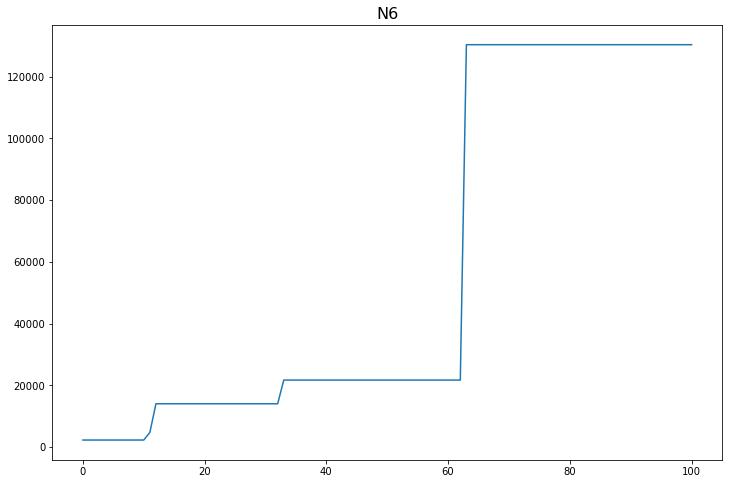

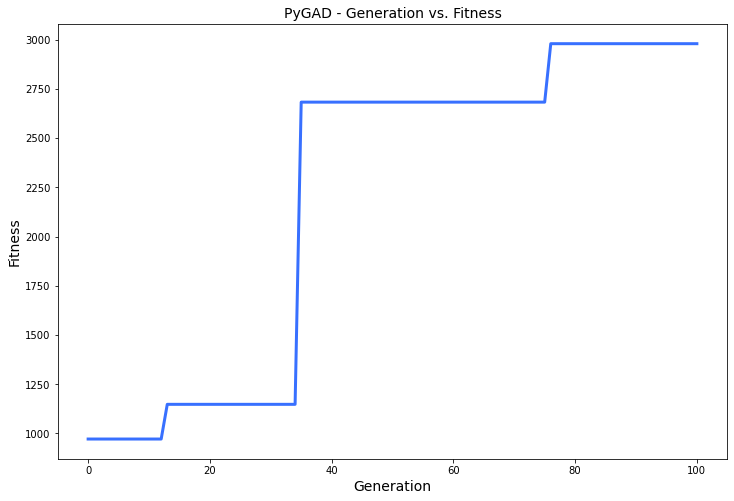

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.741 |==================| 6.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 26.951 |==================| 15.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 26.95 |==================| 15.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 26.932 |==================| 21.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.788 |==================| 10.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 26.901 |==================| 64.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 26.883 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 25.098 |==================| 4.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 24.426 |==================| 2.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.906 |==================| 18.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 10.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.061 |==================| 4.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.87 |==================| 61.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 24.315 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 24.426 |==================| 2.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.906 |==================| 18.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 10.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.061 |==================| 4.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.87 |==================| 61.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 24.315 |==================| 1.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.867 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.061 |==================| 4.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.87 |==================| 61.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 24.315 |==================| 1.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 24.867 |==================| 71.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 24.394 |==================| 2.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.902 |==================| 20.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 24.317 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.985 |==================| 7.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.866 |==================| 76.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 25.103 |==================| 4.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.922 |==================| 14.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.135 |==================| 3.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.899 |==================| 22.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.964 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.922 |==================| 14.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.135 |==================| 3.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.899 |==================| 22.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.964 |==================| 9.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 24.53 |==================| 3.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.788 |==================| 15.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.917 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.883 |==================| 34.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.094 |==================| 4.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 25.058 |==================| 4.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.829 |==================| 40.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.933 |==================| 12.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.994 |==================| 7.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 25.018 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.094 |==================| 4.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 25.058 |==================| 4.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.829 |==================| 40.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.933 |==================| 12.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.994 |==================| 7.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 25.018 |==================| 6.093 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 24.758 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 24.829 |==================| 40.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.933 |==================| 12.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.994 |==================| 7.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 25.018 |==================| 6.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.894 |==================| 24.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.902 |==================| 20.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 25.063 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 24.318 |==================| 1.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.915 |==================| 16.316 |==========
Fitness = 76.55105491294023
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.894 |==================| 24.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.902 |==================| 20.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 25.063 |==================| 4.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 24.281 |==================| 1.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.915 |==================| 16.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.894 |==================| 24.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.902 |==================| 20.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 25.063 |==================| 4.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 24.281 |==================| 1.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.157 |==================| 3.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 25.071 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 25.107 |==================| 3.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 25.029 |==================| 5.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 24.622 |==================| 4.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.626 |==================| 4.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.151 |==================| 3.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.886 |==================| 30.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.773 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 24.626 |==================| 4.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.151 |==================| 3.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.886 |==================| 30.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 24.773 |==================| 12.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.994 |==================| 7.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 25.052 |==================| 5.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.933 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 24.463 |==================| 2.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.97 |==================| 8.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 24.461 |==================| 2.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.869 |==================| 65.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.957 |==================| 9.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.909 |==================| 18.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 24.597 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.869 |==================| 65.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.957 |==================| 9.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.909 |==================| 18.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 24.597 |==================| 3.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.87 |==================| 60.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.598 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 25.08 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.909 |==================| 18.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 24.597 |==================| 3.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 24.87 |==================| 60.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 24.598 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 25.08 |==================| 4.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 24.748 |==================| 9.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.882 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.123 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 25.116 |==================| 3.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 24.39 |==================| 2.156 |==========
Fitness = 116.63651859882653
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.882 |==================| 35.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.618 |==================| 4.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 25.008 |==================| 6.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.882 |==================| 35.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 24.618 |==================| 4.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 25.008 |==================| 6.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 24.593 |==================| 3.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.552 |==================| 3.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.78 |==================| 13.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 24.547 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 24.813 |==================| 24.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.142 |==================| 3.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.654 |==================| 5.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 24.49 |==================| 2.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 24.253 |==================| 1.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 25.034 |==================| 5.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.895 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.142 |==================| 3.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 24.654 |==================| 5.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 24.49 |==================| 2.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 24.253 |==================| 1.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 25.034 |==================| 5.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.895 |==================| 24.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.821 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 25.054 |==================| 4.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 25.021 |==================| 5.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 24.319 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.14 |==================| 3.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.901 |==================| 21.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.875 |==================| 47.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.223 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 25.021 |==================| 5.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 24.319 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.14 |==================| 3.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.901 |==================| 21.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.875 |==================| 47.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.223 |==================| 1.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 24.437 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 24.319 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.14 |==================| 3.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.901 |==================| 21.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 24.875 |==================| 47.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.223 |==================| 1.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 24.437 |==================| 2.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 24.589 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.887 |==================| 29.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |==================| 3.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.88 |==================| 37.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.535 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 25.032 |==================| 5.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.711 |==================| 7.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 24.527 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.141 |==================| 3.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.88 |==================| 37.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.535 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 25.032 |==================| 5.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 24.711 |==================| 7.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 24.527 |==================| 3.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.935 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 24.56 |==================| 3.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.926 |==================| 13.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 25.004 |==================| 6.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 24.508 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.072 |==================| 4.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.111 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.926 |==================| 13.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 25.004 |==================| 6.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 24.508 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.072 |==================| 4.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.111 |==================| 3.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.943 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 24.508 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 25.072 |==================| 4.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.111 |==================| 3.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.943 |==================| 11.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 24.501 |==================| 2.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 24.54 |==================| 3.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.677 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 24.792 |==================| 16.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 24.725 |==================| 7.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.755 |==================| 10.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 24.953 |==================| 9.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 24.531 |==================| 3.099 |==========
Fitness = 593.884520441798
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.677 |==================| 5.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 24.953 |==================| 9.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 24.531 |==================| 3.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 24.677 |==================| 5.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 24.548 |==================| 3.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.845 |==================| 117.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 24.777 |==================| 13.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.234 |===========| 24.39 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 25.12 |==================| 3.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 25.032 |==================| 5.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.91 |==================| 17.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.496 |==================| 2.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.13 |==================| 3.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.785 |==================| 14.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.869 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.496 |==================| 2.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 25.13 |==================| 3.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.785 |==================| 14.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.869 |==================| 63.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 24.459 |==================| 2.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 24.364 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 24.289 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.861 |==================| 124.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.717 |==================| 7.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.876 |==================| 44.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.441 |==================| 2.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.875 |==================| 45.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.581 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.861 |==================| 124.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.717 |==================| 7.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.876 |==================| 44.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.441 |==================| 2.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.875 |==================| 45.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.581 |==================| 3.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 24.717 |==================| 7.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.876 |==================| 44.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.441 |==================| 2.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.875 |==================| 45.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.581 |==================| 3.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |==================| 3.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 24.528 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 25.028 |==================| 5.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.988 |==================| 7.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 24.36 |==================| 2.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 24.327 |==================| 1.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 25.088 |==================| 4.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 24.356 |==================| 2.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.974 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 24.36 |==================| 2.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 24.327 |==================| 1.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 25.088 |==================| 4.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 24.356 |==================| 2.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.974 |==================| 8.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 25.009 |==================| 6.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 24.506 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 25.009 |==================| 6.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.498 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.847 |==================| 164.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.594 |==================| 3.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.449 |==================| 2.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 24.221 |==================| 1.58 |==========
Generation = 16
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 24.482 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 24.847 |==================| 164.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.914 |===========| 24.594 |==================| 3.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.449 |==================| 2.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 24.221 |==================| 1.58 |==========
Change = 2.0448169379960746e-08
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 24.482 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 24.568 |==================| 3.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 24.221 |==================| 1.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.374 |==================| 2.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 24.43 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.285 |==================| 1.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 25.019 |==================| 6.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 25.086 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.374 |==================| 2.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 24.43 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.285 |==================| 1.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 25.019 |==================| 6.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 25.086 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.988 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 24.43 |==================| 2.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 24.285 |==================| 1.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 24.269 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 25.019 |==================| 6.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 25.086 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.988 |==================| 7.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 24.268 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.931 |==================| 12.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 24.516 |==================| 2.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.899 |==================| 22.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.695 |==================| 6.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.776 |==================| 12.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.065 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.858 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 24.516 |==================| 2.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.899 |==================| 22.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 24.695 |==================| 6.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 24.776 |==================| 12.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.065 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 24.858 |==================| 243.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 24.697 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.888 |==================| 29.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.914 |==================| 16.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 24.345 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 24.511 |==================| 2.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.476 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 24.584 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.943 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.914 |==================| 16.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 24.345 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 24.511 |==================| 2.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.476 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 24.584 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.943 |==================| 11.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 24.444 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 24.345 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 24.511 |==================| 2.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 24.476 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 24.584 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.943 |==================| 11.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 24.444 |==================| 2.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 25.109 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 24.498 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 24.866 |==================| 80.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 24.569 |==================| 3.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.094 |==================| 4.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.375 |==================| 2.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 25.112 |==================| 3.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.949 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.954 |===========| 24.569 |==================| 3.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 25.094 |==================| 4.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 24.375 |==================| 2.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 25.112 |==================| 3.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.949 |==================| 10.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 24.662 |==================| 5.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.134 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 25.149 |==================| 3.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 24.524 |==================| 3.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.946 |==================| 10.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.972 |==================| 8.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.551 |==================| 3.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.64 |==================| 4.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.001 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 24.524 |==================| 3.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.946 |==================| 10.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.972 |==================| 8.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.551 |==================| 3.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.64 |==================| 4.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.001 |==================| 6.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.999 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.551 |==================| 3.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 24.64 |==================| 4.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 25.001 |==================| 6.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.999 |==================| 6.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 25.014 |==================| 6.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 25.006 |==================| 6.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 24.372 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 25.092 |==================| 4.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.945 |==================| 10.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 24.583 |==================| 3.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.615 |==================| 4.194 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 25.006 |==================| 6.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 24.372 |==================| 2.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.945 |==================| 10.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 24.583 |==================| 3.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.615 |==================| 4.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 25.006 |==================| 6.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 24.372 |==================| 2.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.734 |==================| 8.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 24.849 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.146 |==================| 3.417 |==========
Generation = 23
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 24.473 |==================| 2.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.851 |==================| 362.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 25.023 |==================| 5.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.904 |==================| 19.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.63

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.851 |==================| 362.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 25.023 |==================| 5.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.904 |==================| 19.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 24.638 |==================| 4.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 24.878 |==================| 39.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 24.616 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 24.507 |==================| 2.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.914 |==================| 16.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 25.134 |==================| 3.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 24.497 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.955 |==================| 9.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.018 |==================| 6.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.996 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 24.497 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.955 |==================| 9.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.018 |==================| 6.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.996 |==================| 7.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.535 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 24.44 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 24.251 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.955 |==================| 9.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 25.018 |==================| 6.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.996 |==================| 7.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 24.535 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 24.44 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 24.251 |==================| 1.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 24.709 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.115 |==================| 3.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 24.316 |==================| 1.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 25.052 |==================| 5.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |==================| 3.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 25.068 |==================| 4.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 24.414 |==================| 2.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 25.052 |==================| 5.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |==================| 3.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 25.068 |==================| 4.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 24.414 |==================| 2.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 24.604 |==================| 4.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 24.625 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.996 |==================| 6.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 24.285 |==================| 1.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 25.072 |==================| 4.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.836 |==================| 58.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.978 |==================| 8.023 |==========
Generation = 26
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.636 |==================| 4.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.615 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.978 |==================| 8.023 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.636 |==================| 4.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 24.615 |==================| 4.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 24.652 |==================| 4.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 24.412 |==================| 2.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 24.615 |==================| 4.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 24.607 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 24.472 |==================| 2.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 25.027 |==================| 5.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.879 |==================| 38.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 24.513 |==================| 2.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 25.033 |==================| 5.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.883 |==================| 34.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.731 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 25.033 |==================| 5.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 24.883 |==================| 34.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.731 |==================| 8.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.916 |==================| 16.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.88 |==================| 36.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.843 |==================| 94.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 25.11 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 24.731 |==================| 8.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.916 |==================| 16.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 24.88 |==================| 36.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 24.843 |==================| 94.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 25.11 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.89 |==================| 27.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.857 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.159 |==================| 3.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 25.08 |==================| 4.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.909 |==================| 17.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |==================| 10.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.832 |==================| 46.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.002 |==================| 6.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 25.054 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |==================| 10.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.832 |==================| 46.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.002 |==================| 6.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 25.054 |==================| 4.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.934 |==================| 12.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 25.06 |==================| 4.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 24.535 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.955 |==================| 9.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 25.1 |==================| 4.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |==================| 3.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.86 |==================| 141.76 |==========
Generation = 29
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.147 |==================| 3.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.793 |==================| 16.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.149 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |==================| 3.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.86 |==================| 141.76 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.147 |==================| 3.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.793 |==================| 16.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.149 |==================| 3.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 25.059 |==================| 4.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 24.513 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.803 |==================| 19.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.131 |==================| 3.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.918 |==================| 15.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 24.275 |==================| 1.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.818 |==================| 28.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 24.473 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.737 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.131 |==================| 3.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.918 |==================| 15.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 24.275 |==================| 1.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.818 |==================| 28.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 24.473 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.737 |==================| 8.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 24.726 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.818 |==================| 28.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 24.473 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 24.737 |==================| 8.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 24.726 |==================| 7.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 24.405 |==================| 2.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 24.849 |==================| 245.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 24.479 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.939 |==================| 11.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 24.297 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.749 |==================| 9.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 24.74 |==================| 8.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 25.005 |==================| 6.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.724 |==================| 7.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 24.423 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 24.749 |==================| 9.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 24.74 |==================| 8.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 25.005 |==================| 6.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 24.724 |==================| 7.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 24.423 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 24.283 |==================| 1.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 24.527 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.767 |==================| 11.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 24.488 |==================| 2.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.961 |==================| 9.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 25.077 |==================| 4.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 24.267 |==================| 1.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 24.357 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 25.077 |==================| 4.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 24.267 |==================| 1.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 24.357 |==================| 2.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.759 |==================| 10.554 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.924 |==================| 14.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 24.491 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 24.267 |==================| 1.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 24.357 |==================| 2.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 24.759 |==================| 10.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 25.004 |==================| 6.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.884 |==================| 32.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 24.311 |==================| 1.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 25.004 |==================| 6.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.884 |==================| 32.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 24.311 |==================| 1.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 25.079 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.918 |==================| 15.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 24.322 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.884 |==================| 32.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 24.311 |==================| 1.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 25.079 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 24.918 |==================| 15.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 24.322 |==================| 1.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.915 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.976 |==================| 8.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 24.75 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.72 |==================| 7.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.989 |==================| 7.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.899 |==================| 22.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 25.127 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.941 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 24.72 |==================| 7.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.989 |==================| 7.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.899 |==================| 22.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 25.127 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.941 |==================| 11.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 24.48 |==================| 2.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.808 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 24.365 |==================| 2.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.015 |==================| 6.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.852 |==================| 921.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 24.426 |==================| 2.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.136 |==================| 3.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.064 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.958 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 24.426 |==================| 2.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.136 |==================| 3.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.064 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.958 |==================| 9.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.896 |==================| 23.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.963 |==================| 9.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.692 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 25.136 |==================| 3.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.064 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.958 |==================| 9.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.896 |==================| 23.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.963 |==================| 9.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.692 |==================| 6.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.906 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 24.78 |==================| 13.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.824 |==================| 33.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 25.044 |==================| 5.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 24.221 |==================| 1.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 24.399 |==================| 2.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.901 |==================| 21.077 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 24.824 |==================| 33.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 25.044 |==================| 5.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 24.221 |==================| 1.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.22 |===========| 24.399 |==================| 2.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.901 |==================| 21.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 25.056 |==================| 4.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 24.666 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 24.379 |==================| 2.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 24.732 |==================| 8.247 |==========
Generation = 37
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.872 |==================| 52.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.636 |==================| 4.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 24.521 |==================| 3.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 24.505 |==================| 2.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.872 |==================| 52.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 24.636 |==================| 4.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 24.521 |==================| 3.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 24.505 |==================| 2.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================| 3.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.15 |==================| 3.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 24.865 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.989 |==================| 7.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.825 |==================| 35.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 25.06 |==================| 4.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.916 |==================| 15.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.679 |==================| 5.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 25.098 |==================| 4.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.698 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 24.679 |==================| 5.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 25.098 |==================| 4.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 24.698 |==================| 6.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 24.313 |==================| 1.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 25.052 |==================| 5.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.928 |==================| 13.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.844 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 25.052 |==================| 5.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.928 |==================| 13.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 24.844 |==================| 111.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 24.497 |==================| 2.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.064 |==================| 4.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.82 |==================| 29.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 24.244 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.896 |==================| 23.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 25.085 |==================| 4.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 24.642 |==================| 4.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 24.311 |==================| 1.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.277 |==================| 1.736 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.449 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 25.085 |==================| 4.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 24.642 |==================| 4.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 24.311 |==================| 1.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 24.277 |==================| 1.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.449 |==================| 2.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 24.25 |==================| 1.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 24.357 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 25.082 |==================| 4.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 24.366 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.811 |==================| 23.401 |==========
Generation = 40
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.147 |==================| 3.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.308 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.988 |==================| 7.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 25.107 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 24.366 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 24.811 |==================| 23.401 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 25.147 |==================| 3.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.308 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.988 |==================| 7.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 25.107 |==================| 3.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 24.492 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 24.783 |==================| 14.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 25.006 |==================| 6.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.126 |==================| 3.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 25.1 |==================| 4.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 24.566 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.879 |==================| 39.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.15 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 25.126 |==================| 3.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 25.1 |==================| 4.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 24.566 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.879 |==================| 39.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.15 |==================| 3.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.785 |==================| 14.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.906 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 25.1 |==================| 4.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 24.566 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.879 |==================| 39.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.15 |==================| 3.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 24.785 |==================| 14.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.906 |==================| 19.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 24.537 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 24.779 |==================| 13.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.906 |==================| 19.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.124 |==================| 3.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.621 |==================| 4.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.896 |==================| 23.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.946 |==================| 10.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.88 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.906 |==================| 19.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.124 |==================| 3.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 24.621 |==================| 4.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.896 |==================| 23.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.946 |==================| 10.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.88 |==================| 37.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 24.627 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 24.23 |==================| 1.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.919 |==================| 15.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 24.955 |==================| 9.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 24.481 |==================| 2.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.919 |==================| 15.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 24.34 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 24.481 |==================| 2.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.919 |==================| 15.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 24.34 |==================| 1.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 24.222 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.917 |==================| 15.772 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 24.331 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.919 |==================| 15.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 24.34 |==================| 1.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 24.222 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.917 |==================| 15.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 24.642 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 24.35 |==================| 1.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 25.129 |==================| 3.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 24.835 |==================| 55.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.965 |==================| 8.942 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 24.642 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |==================| 181.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.965 |==================| 8.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 24.642 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |==================| 181.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 24.77 |==================| 11.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 24.704 |==================| 6.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 24.786 |==================| 14.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 24.505 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 24.39 |==================| 2.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 24.769 |==================| 11.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 25.104 |==================| 3.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 24.238 |==================| 1.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 24.714 |==================| 7.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 24.313 |==================| 1.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.142 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 25.104 |==================| 3.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 24.238 |==================| 1.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 24.714 |==================| 7.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 24.313 |==================| 1.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.142 |==================| 3.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 24.409 |==================| 2.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.496 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 24.441 |==================| 2.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.499 |==================| 2.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.656 |==================| 5.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 25.032 |==================| 5.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.533 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 24.478 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 24.499 |==================| 2.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 24.956 |==================| 9.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.656 |==================| 5.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 25.032 |==================| 5.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.533 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 24.478 |==================| 2.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 25.13 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.656 |==================| 5.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 25.032 |==================| 5.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.533 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 24.478 |==================| 2.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 25.13 |==================| 3.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.939 |==================| 11.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 24.418 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 25.032 |==================| 5.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.976 |==================| 8.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 25.024 |==================| 5.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 25.048 |==================| 5.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.142 |==================| 3.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 25.01 |==================| 6.387 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.142 |==================| 3.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 25.01 |==================| 6.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.874 |==================| 49.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 25.045 |==================| 5.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 25.016 |==================| 6.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.934 |==================| 12.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.154 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.909 |==================| 18.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.786 |==================| 14.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.754 |==================| 10.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 25.104 |==================| 3.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 24.489 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.821 |==================| 30.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.046 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.786 |==================| 14.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 24.754 |==================| 10.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 25.104 |==================| 3.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 24.489 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 24.821 |==================| 30.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.046 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 24.711 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.815 |==================| 25.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 25.013 |==================| 6.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.705 |==================| 6.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 24.781 |==================| 13.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.872 |==================| 54.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.134 |==================| 3.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.691 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 24.872 |==================| 54.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 25.134 |==================| 3.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.691 |==================| 6.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 24.537 |==================| 3.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 24.466 |==================| 2.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.599 |==================| 3.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.066 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 24.466 |==================| 2.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 24.599 |==================| 3.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.066 |==================| 4.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.159 |==================| 3.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 25.088 |==================| 4.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.672 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 24.58 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.065 |==================| 4.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 24.486 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.784 |==================| 14.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.908 |==================| 18.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.988 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 24.254 |==================| 1.668 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 24.486 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 24.784 |==================| 14.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.908 |==================| 18.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 24.988 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 24.254 |==================| 1.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 24.536 |==================| 3.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.941 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 24.376 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.921 |==================| 14.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 24.431 |==================| 2.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.694 |==================| 6.271 |==========
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 24.435 |==================| 2.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 25.098 |==================| 4.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 24.434 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.921 |==================| 14.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 24.431 |==================| 2.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.694 |==================| 6.271 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 24.435 |==================| 2.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 25.098 |==================| 4.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 24.434 |==================| 2.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 24.45 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 24.431 |==================| 2.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 24.694 |==================| 6.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 24.318 |==================| 1.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 24.482 |==================| 2.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.123 |==================| 3.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 24.44 |==================| 2.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.866 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 24.318 |==================| 1.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 24.482 |==================| 2.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.123 |==================| 3.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 24.44 |==================| 2.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.866 |==================| 78.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 25.024 |==================| 5.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 24.488 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 25.123 |==================| 3.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 24.44 |==================| 2.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.866 |==================| 78.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 25.024 |==================| 5.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 24.488 |==================| 2.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 25.014 |==================| 6.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 24.585 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 25.119 |==================| 3.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.916 |==================| 15.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.015 |==================| 6.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.158 |==================| 3.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.682 |==================| 5.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 25.068 |==================| 4.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 25.113 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.916 |==================| 15.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.015 |==================| 6.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.158 |==================| 3.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.682 |==================| 5.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 25.068 |==================| 4.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 25.113 |==================| 3.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 24.656 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 24.371 |==================| 2.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 24.279 |==================| 1.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 24.667 |==================| 5.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 24.4 |==================| 2.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.095 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.65 |==================| 4.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.927 |==================| 13

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 24.279 |==================| 1.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 24.667 |==================| 5.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 24.4 |==================| 2.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.095 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.65 |==================| 4.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.927 |==================| 13.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.818 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 24.667 |==================| 5.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 24.4 |==================| 2.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.095 |==================| 4.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 24.65 |==================| 4.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.927 |==================| 13.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.818 |==================| 28.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.988 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 24.374 |==================| 2.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 25.101 |==================| 4.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 24.3 |==================| 1.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 24.544 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.864 |==================| 98.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.735 |==================| 8.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 24.439 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.864 |==================| 98.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 24.735 |==================| 8.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 24.439 |==================| 2.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 24.828 |==================| 38.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 24.275 |==================| 1.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 24.574 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 24.63 |==================| 4.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 24.4 |==================| 2.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.998 |==================| 6.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.064 |==================| 4.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.132 |==================| 3.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.947 |==================| 10.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 25.153 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 24.998 |==================| 6.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 25.064 |==================| 4.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 25.132 |==================| 3.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.947 |==================| 10.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 25.153 |==================| 3.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 24.259 |==================| 1.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 24.655 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 24.481 |==================| 2.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 24.732 |==================| 8.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 24.42 |==================| 2.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 24.356 |==================| 2.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 24.4 |==================| 2.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 24.537 |==================| 3.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.861 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 24.4 |==================| 2.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 24.537 |==================| 3.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.861 |==================| 140.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.131 |==================| 3.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.02 |==================| 6.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.986 |==================| 7.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.861 |==================| 140.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 25.131 |==================| 3.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.02 |==================| 6.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.986 |==================| 7.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 24.266 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 24.767 |==================| 11.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 25.066 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 24.397 |==================| 2.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.905 |==================| 19.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.882 |==================| 35.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.859 |==================| 165.094 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 24.827 |==================| 38.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 24.334 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 24.882 |==================| 35.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.859 |==================| 165.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 24.827 |==================| 38.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 24.334 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.121 |==================| 3.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================| 3.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.921 |==================| 14.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 24.326 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.953 |==================| 10.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.985 |==================| 7.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 25.121 |==================| 3.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.128 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 24.326 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.953 |==================| 10.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.985 |==================| 7.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 25.121 |==================| 3.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 25.128 |==================| 3.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 24.815 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 24.783 |==================| 14.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 25.087 |==================| 4.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.881 |==================| 35.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 25.083 |==================| 4.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.675 |==================| 5.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.901 |==================| 20.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.533 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 25.087 |==================| 4.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.881 |==================| 35.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 25.083 |==================| 4.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.675 |==================| 5.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.901 |==================| 20.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.533 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.59 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.675 |==================| 5.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.901 |==================| 20.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 24.533 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 24.59 |==================| 3.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 24.37 |==================| 2.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 25.016 |==================| 6.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.945 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 24.387 |==================| 2.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.147 |==================| 3.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.118 |==================| 3.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 24.331 |==================| 1.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 24.699 |==================| 6.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.978 |==================| 8.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 24.222 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.147 |==================| 3.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.118 |==================| 3.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 24.331 |==================| 1.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 24.699 |==================| 6.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.978 |==================| 8.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 24.222 |==================| 1.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 24.424 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 25.078 |==================| 4.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.632 |==================| 4.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 24.387 |==================| 2.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.898 |==================| 22.264 |==========
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 24.219 |==================| 1.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 25.054 |==================| 4.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 24.499 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 24.632 |==================| 4.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 24.387 |==================| 2.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.898 |==================| 22.264 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.5 |===========| 24.219 |==================| 1.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 25.054 |==================| 4.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 24.499 |==================| 2.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 24.28 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 24.463 |==================| 2.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 24.607 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.273 |==================| 1.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.816 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 24.607 |==================| 4.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.273 |==================| 1.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.816 |==================| 26.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 24.222 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 24.273 |==================| 1.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 24.816 |==================| 26.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 24.222 |==================| 1.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 24.637 |==================| 4.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 24.356 |==================| 2.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.964 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 25.012 |==================| 6.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 24.793 |==================| 16.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 24.552 |==================| 3.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.625 |==================| 4.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.763 |==================| 11.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.784 |==================| 14.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |=============

======| 0.866 |===========| 24.625 |==================| 4.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 24.763 |==================| 11.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 24.784 |==================| 14.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.892 |==================| 26.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 25.015 |==================| 6.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 25.082 |==================| 4.365 |==========
=====|SOLUTION|===========|OUTPUT|=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 25.077 |==================| 4.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 25.102 |==================| 4.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.98 |==================| 7.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.067 |==================| 4.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 25.09 |==================| 4.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 25.028 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 25.124 |==================| 3.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.98 |==================| 7.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.067 |==================| 4.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 25.09 |==================| 4.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 25.028 |==================| 5.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.657 |==================| 5.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 24.467 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 25.028 |==================| 5.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 24.657 |==================| 5.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 24.467 |==================| 2.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 25.06 |==================| 4.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.053 |==================| 5.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.893 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 25.053 |==================| 5.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.893 |==================| 25.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.047 |==================| 5.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.884 |==================| 32.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.991 |==================| 7.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 25.138 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.047 |==================| 5.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.884 |==================| 32.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.991 |==================| 7.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 25.138 |==================| 3.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 24.221 |==================| 1.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 24.806 |==================| 21.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 24.298 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 24.567 |==================| 3.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 25.07 |==================| 4.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.111 |==================| 3.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.864 |==================| 93.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.408 |==================| 2.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.845 |==================| 125.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 24.378 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 25.111 |==================| 3.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.864 |==================| 93.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 24.408 |==================| 2.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.845 |==================| 125.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 24.378 |==================| 2.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 25.036 |==================| 5.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 25.04 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 25.026 |==================| 5.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.993 |==================| 7.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.791 |==================| 15.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.721 |==================| 7.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.671 |==================| 5.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.351 |==================| 1.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 25.1 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.993 |==================| 7.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.791 |==================| 15.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.721 |==================| 7.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.671 |==================| 5.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.351 |==================| 1.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 25.1 |==================| 4.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.372 |===========| 24.302 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 24.791 |==================| 15.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 24.721 |==================| 7.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 24.671 |==================| 5.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.351 |==================| 1.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 25.1 |==================| 4.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.372 |===========| 24.302 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.577 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.931 |==================| 12.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.041 |==================| 5.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.864 |==================| 95.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.02 |==================| 5.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.905 |==================| 19.35 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.577 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 25.041 |==================| 5.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.864 |==================| 95.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.02 |==================| 5.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 24.905 |==================| 19.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 24.577 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.869 |==================| 64.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 24.447 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 24.54 |==================| 3.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.14 |==================| 3.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.572 |==================| 3.548 |==========
Generation = 70
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.618 |==================| 4.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.578 |==================| 3.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.773 |==================| 12.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.761 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.14 |==================| 3.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.572 |==================| 3.548 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 24.618 |==================| 4.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.578 |==================| 3.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 24.773 |==================| 12.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 24.761 |==================| 10.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.14 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 24.572 |==================| 3.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 24.493 |==================| 2.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 25.117 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.472 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.989 |==================| 7.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 24.376 |==================| 2.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 24.538 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 24.493 |==================| 2.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 25.117 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.472 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.989 |==================| 7.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 24.376 |==================| 2.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 24.538 |==================| 3.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.578 |=================

======| 0.279 |===========| 24.989 |==================| 7.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 24.376 |==================| 2.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 24.538 |==================| 3.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 24.578 |==================| 3.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 24.37 |==================| 2.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 24.352 |==================| 1.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 24.413 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 25.103 |==================| 4.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.948 |==================| 10.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.584 |==================| 3.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 24.267 |==================| 1.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.239 |==================| 1.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 25.105 |==================| 3.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 24.596 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.948 |==================| 10.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 24.584 |==================| 3.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 24.267 |==================| 1.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 24.239 |==================| 1.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 25.105 |==================| 3.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 24.596 |==================| 3.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.994 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 24.414 |==================| 2.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 24.761 |==================| 10.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.067 |==================| 4.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.963 |==================| 9.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 25.076 |==================| 4.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.046 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 24.227 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 25.067 |==================| 4.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.963 |==================| 9.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 25.076 |==================| 4.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.046 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 24.227 |==================| 1.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 25.075 |==================| 4.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.957 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 25.046 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 24.227 |==================| 1.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 25.075 |==================| 4.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.957 |==================| 9.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.929 |==================| 13.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.876 |==================| 43.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 25.154 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.957 |==================| 9.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 25.033 |==================| 5.554 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.876 |==================| 43.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 25.154 |==================| 3.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.892 |==================| 25.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.637 |==================| 4.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 25.033 |==================| 5.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.876 |==================| 43.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 25.154 |==================| 3.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.892 |==================| 25.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 24.637 |==================| 4.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.965 |==================| 8.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 24.655 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.996 |==================| 7.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 24.387 |==================| 2.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 24.669 |==================| 5.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.577 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 24.456 |==================| 2.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 24.506 |==================| 2.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.994 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 24.577 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 24.456 |==================| 2.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 24.506 |==================| 2.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.994 |==================| 7.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 24.432 |==================| 2.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 25.09 |==================| 4.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 24.601 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 24.482 |==================| 2.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 25.072 |==================| 4.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.308 |==================| 1.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.889 |==================| 28.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.693 |==================| 6.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.873 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 25.084 |==================| 4.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 25.072 |==================| 4.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 24.308 |==================| 1.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.889 |==================| 28.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.693 |==================| 6.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.873 |==================| 51.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 25.079 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 24.693 |==================| 6.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 24.873 |==================| 51.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 25.079 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 24.625 |==================| 4.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.919 |==================| 15.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 24.629 |==================| 4.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 24.394 |==================| 2.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 24.404 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 24.323 |==================| 1.884 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 24.272 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.794 |==================| 16.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 24.272 |==================| 1.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.794 |==================| 16.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.825 |==================| 35.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.815 |==================| 26.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 24.597 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.825 |==================| 35.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.976 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.145 |==================| 3.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.151 |==================| 3.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 24.38 |==================| 2.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 24.224 |==================| 1.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 25.066 |==================| 4.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 25.058 |==================| 4.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 25.016 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 25.151 |==================| 3.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 24.38 |==================| 2.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 24.224 |==================| 1.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 25.066 |==================| 4.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 25.058 |==================| 4.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 25.016 |==================| 6.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 24.84 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.02 |==================| 5.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.465 |==================| 2.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 25.109 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.922 |==================| 14.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 24.52 |==================| 3.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.885 |==================| 31.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 24.465 |==================| 2.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 25.109 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.922 |==================| 14.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 24.52 |==================| 3.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.885 |==================| 31.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |==================| 10.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 25.004 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 25.109 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 24.922 |==================| 14.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 24.52 |==================| 3.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.885 |==================| 31.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.947 |==================| 10.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 25.004 |==================| 6.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.987 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 25.115 |==================| 3.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.932 |==================| 12.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.133 |==================| 3.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 24.27 |==================| 1.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.346 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.374 |==================| 2.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 24.27 |==================| 1.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 25.011 |==================| 6.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 24.374 |==================| 2.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.937 |==================| 12.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.82 |==================| 29.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 24.311 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 24.224 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 24.85 |==================| 277.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 24.262 |==================| 1.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.997 |==================| 6.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.803 |==================| 19.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.966 |==================| 8.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.35 |==================| 1.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.67 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.966 |==================| 8.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 24.35 |==================| 1.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 24.67 |==================| 5.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 24.62 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 24.513 |==================| 2.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.96 |==================| 9.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 25.078 |==================| 4

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 24.404 |==================| 2.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 24.319 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.986 |==================| 7.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.862 |==================| 116.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.699 |==================| 6.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.896 |==================| 23.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.819 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.986 |==================| 7.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 24.862 |==================| 116.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.699 |==================| 6.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.896 |==================| 23.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.819 |==================| 29.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 25.069 |==================| 4.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.69 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.699 |==================| 6.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 24.896 |==================| 23.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 24.819 |==================| 29.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 25.069 |==================| 4.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 24.69 |==================| 6.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.959 |==================| 9.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 24.407 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.951 |==================| 10.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 25.067 |==================| 4.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.742 |==================| 8.999 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.887 |==================| 29.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 24.334 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 25.034 |==================| 5.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 25.067 |==================| 4.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 24.742 |==================| 8.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.887 |==================| 29.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 24.334 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 25.034 |==================| 5.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 25.027 |==================| 5.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 24.482 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 24.437 |==================| 2.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 24.448 |==================| 2.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.406 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 25.087 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 24.563 |==================| 3.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 24.239 |==================| 1.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.061 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 24.448 |==================| 2.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.21 |===========| 24.406 |==================| 2.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 25.087 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 24.563 |==================| 3.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 24.239 |==================| 1.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.061 |==================| 4.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 24.291 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.943 |==================| 11.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 24.229 |==================| 1.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 24.734 |==================| 8.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.133 |==================| 3.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.658 |==================| 5.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.995 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 25.133 |==================| 3.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.658 |==================| 5.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.995 |==================| 7.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==================| 14.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 24.345 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.729 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 24.658 |==================| 5.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.995 |==================| 7.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.924 |==================| 14.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 24.345 |==================| 1.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 24.729 |==================| 8.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 24.651 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.9 |==================| 21.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 24.482 |==================| 2.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 24.583 |==================| 3.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 25.116 |==================| 3.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 25.066 |==================| 4.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.634 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 24.482 |==================| 2.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.157 |==================| 3.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 24.583 |==================| 3.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 25.116 |==================| 3.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 25.066 |==================| 4.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 24.634 |==================| 4.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 25.116 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 24.478 |==================| 2.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 24.584 |==================| 3.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.147 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.874 |==================| 49.286 |==========
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 25.114 |==================| 3.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 25.147 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.874 |==================| 49.286 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 25.114 |==================| 3.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.962 |==================| 9.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================| 3.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.876 |==================| 44.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.979 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 25.019 |==================| 6.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 25.138 |==================| 3.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 24.239 |==================| 1.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 24.463 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.916 |==================| 15.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 24.397 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.106 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 25.138 |==================| 3.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 24.239 |==================| 1.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 24.463 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.916 |==================| 15.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 24.397 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.106 |==================| 3.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 24.288 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 24.239 |==================| 1.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 24.463 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.916 |==================| 15.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 24.397 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 25.106 |==================| 3.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 24.288 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 24.566 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 24.78 |==================| 13.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 24.396 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 24.245 |==================| 1.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.682 |==================| 5.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.948 |==================| 10.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 24.464 |==================| 2.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 24.396 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 24.245 |==================| 1.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 24.682 |==================| 5.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.948 |==================| 10.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 24.464 |==================| 2.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 25.108 |==================| 3.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.15 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.947 |==================| 10.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 25.14 |==================| 3.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 24.701 |==================| 6.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 24.252 |==================| 1.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.716 |==================| 7.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.123 |==================| 3.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.401 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 24.716 |==================| 7.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 25.123 |==================| 3.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 24.401 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 24.425 |==================| 2.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.12 |==================| 3.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.931 |==================| 12.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 25.12 |==================| 3.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.931 |==================| 12.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 25.093 |==================| 4.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 25.049 |==================| 5.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 24.424 |==================| 2.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 25.057 |==================| 4.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.794 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 25.043 |==================| 5.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 25.066 |==================| 4.703 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 24.424 |==================| 2.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 25.057 |==================| 4.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.794 |==================| 16.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.991 |==================| 7.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 25.066 |==================| 4.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 24.424 |==================| 2.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 25.057 |==================| 4.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 24.794 |==================| 16.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.991 |==================| 7.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 24.456 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.938 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 25.02 |==================| 5.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 25.01 |==================| 6.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 24.425 |==================| 2.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.931 |==================| 12.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.672 |==================| 5.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.788 |==================| 15.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 25.008 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 24.672 |==================| 5.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 24.788 |==================| 15.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 25.008 |==================| 6.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 25.056 |==================| 4.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.985 |==================| 7.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 25.026 |==================| 5.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 24.292 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 24.921 |==================| 14.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 24.559 |==================| 3.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.902 |==================| 20.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 25.104 |==================| 3.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.675 |==================| 5.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.933 |==================| 12.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 25.033 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 24.902 |==================| 20.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 25.104 |==================| 3.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.675 |==================| 5.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.933 |==================| 12.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 25.033 |==================| 5.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.118 |==================| 3.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.547 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 24.675 |==================| 5.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.933 |==================| 12.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.208 |===========| 25.033 |==================| 5.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.118 |==================| 3.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 24.547 |==================| 3.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 25.117 |==================| 3.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 24.825 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.889 |==================| 28.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 24.581 |==================| 3.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 24.582 |==================| 3.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 24.454 |==================| 2.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 24.538 |==================| 3.175 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.015 |==================| 6.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 24.454 |==================| 2.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 24.538 |==================| 3.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.015 |==================| 6.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 24.448 |==================| 2.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 25.097 |==================| 4.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 25.118 |==================| 3.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 24.753 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 24.546 |==================| 3.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.971 |==================| 8.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 24.705 |==================| 6.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.884 |==================| 32.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.696 |==================| 6.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 25.109 |==================| 3.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.978 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 24.884 |==================| 32.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 24.696 |==================| 6.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 25.109 |==================| 3.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.978 |==================| 8.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 24.613 |==================| 4.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 25.026 |==================| 5.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.686 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 25.123 |==================| 3.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 25.119 |==================| 3.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.953 |==================| 10.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 24.631 |==================| 4.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 25.068 |==================| 4.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.886 |==================| 30.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.102 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 25.119 |==================| 3.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.953 |==================| 10.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 24.631 |==================| 4.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 25.068 |==================| 4.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.886 |==================| 30.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.102 |==================| 4.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.993 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.953 |==================| 10.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 24.631 |==================| 4.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 25.068 |==================| 4.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 24.886 |==================| 30.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 25.102 |==================| 4.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.993 |==================| 7.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 24.256 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 24.818 |==================| 28.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 24.281 |==================| 1.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.917 |==================| 15.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 25.086 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 24.276 |==================| 1.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.566 |==================| 3.484 |==========
Fitness = 2399.10704072067
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 25.086 |==================| 4.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 24.276 |==================| 1.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 24.566 |==================| 3.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.678 |==================| 5.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 24.699 |==================| 6.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 24.686 |==================| 5.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 24.496 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 24.246 |==================| 1.646 |==========
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 25.095 |==================| 4.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 25.058 |==================| 4.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.929 |==================| 13.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 24.586 |==================| 3.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.472 |==================| 2.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.836 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 25.058 |==================| 4.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.929 |==================| 13.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 24.586 |==================| 3.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 24.472 |==================| 2.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.836 |==================| 57.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 25.116 |==================| 3.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 24.238 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 24.789 |==================| 15.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 24.83 |==================| 42.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.575 |==================| 3.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |==================| 180.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.974 |==================| 8.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.138 |==================| 3.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.785 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 24.575 |==================| 3.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |==================| 180.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.974 |==================| 8.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.138 |==================| 3.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.785 |==================| 14.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.889 |==================| 28.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.015 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.859 |==================| 180.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.974 |==================| 8.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 25.138 |==================| 3.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 24.785 |==================| 14.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 24.889 |==================| 28.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 25.015 |==================| 6.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 24.879 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 25.04 |==================| 5.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 24.678 |==================| 5.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.962 |==================| 9.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.984 |==================| 7.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 24.435 |==================| 2.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.127 |==================| 3.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.003 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.962 |==================| 9.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.984 |==================| 7.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 24.435 |==================| 2.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 25.127 |==================| 3.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 25.003 |==================| 6.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 25.061 |==================| 4.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 24.464 |================

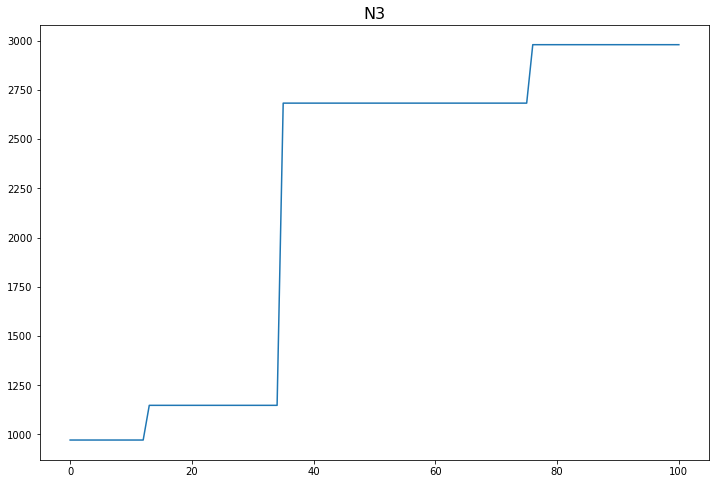

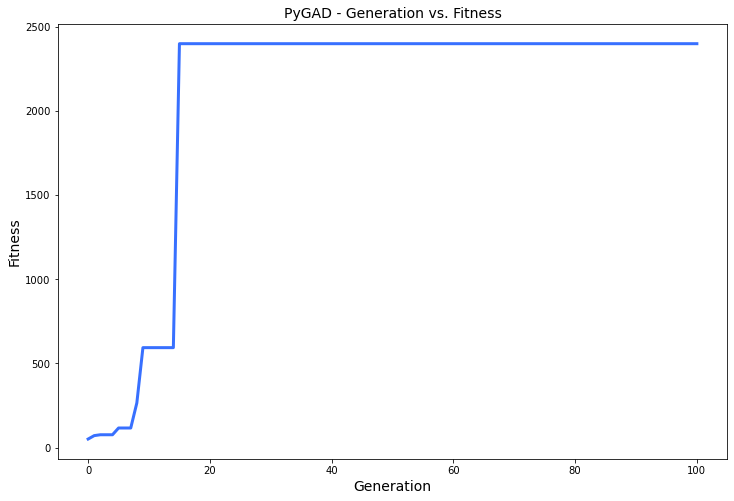

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 24.809 |==================| 22.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.948 |==================| 10.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.933 |==================| 12.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 25.111 |==================| 3.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 24.777 |==================| 13.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 25.063 |==================| 4.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 25.08 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 29.549 |==================| 9.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 29.314 |==================| 7.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 30.545 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 30.473 |==================| 0.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.113 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.329 |==================| 1.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 30.133 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.113 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.329 |==================| 1.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 30.133 |==================| 1.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 29.347 |==================| 10.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 29.613 |==================| 5.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.855 |==================| 1.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 28.278 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.538 |===========| 29.347 |==================| 10.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 29.613 |==================| 5.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.855 |==================| 1.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 28.278 |==================| 0.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 28.364 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 30.48 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 30.185 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 29.536 |==================| 11.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.45 |==================| 0.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 29.574 |==================| 7.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 29.653 |==================| 4.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 27.226 |==================| 0.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 29.369 |==================| 13.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.282 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.45 |==================| 0.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 29.574 |==================| 7.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 29.653 |==================| 4.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 27.226 |==================| 0.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 29.369 |==================| 13.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.282 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 29.233 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.636 |==================| 0.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.435 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.459 |==================| 1.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 29.843 |==================| 2.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.465 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 29.947 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 29.845 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.465 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 29.947 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 29.845 |==================| 2.504 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.475 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 30.389 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.493 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 27.502 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.226 |==================| 0.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.803 |==================| 0.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 27.803 |==================| 0.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 29.44 |==================| 201.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 27.891 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.839 |==================| 1.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.399 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 27.891 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.839 |==================| 1.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.399 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 30.311 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 30.58 |==================| 0.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.577 |==================| 0.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 29.792 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 30.311 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 30.58 |==================| 0.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.577 |==================| 0.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 29.792 |==================| 2.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 30.358 |==================| 1.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 30.024 |==================| 1.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 30.267 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.587 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.944 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.111 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 30.012 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 29.563 |==================| 8.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.225 |==================| 1.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.932 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.944 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.111 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 30.012 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 29.563 |==================| 8.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.225 |==================| 1.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.932 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 30.06 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 26.495 |==================| 0.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 29.736 |==================| 3.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.72 |==================| 1.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 28.019 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.187 |==================| 3.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 27.948 |==================| 0.668 |==========
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.629 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 29.187 |==================| 3.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 27.948 |==================| 0.668 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 28.629 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 30.341 |==================| 1.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 30.404 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 30.592 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.847 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 30.486 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 30.182 |==================| 1.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.896 |==================| 0.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 26.722 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 29.227 |==================| 4.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 29.842 |==================| 2.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.473 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 30.182 |==================| 1.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.896 |==================| 0.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 26.722 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 29.227 |==================| 4.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 29.842 |==================| 2.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.473 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.839 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 29.227 |==================| 4.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 29.842 |==================| 2.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.473 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 26.839 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 27.3 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 27.136 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.812 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 30.14 |==================| 1.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 27.974 |==================| 0.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 27.412 |==================| 0.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.173 |==================| 1.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 30.257 |==================| 1.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.699 |==================| 3.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 29.887 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 30.173 |==================| 1.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 30.257 |==================| 1.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.699 |==================| 3.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 29.887 |==================| 2.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 27.851 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.913 |===========| 28.299 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.631 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 27.274 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 28.928 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 28.096 |==================| 0.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.336 |==================| 1.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 27.541 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 27.249 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 30.1 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 27.541 |==================| 0.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 27.249 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 30.1 |==================| 1.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.973 |==================| 2.119 |==========
Change = 200.7943252680467
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 27.987 |==================| 0.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 29.992 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.063 |==================| 1.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 27.175 |==================| 0.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.464 |==================| 1.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.424 |==================| 0.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 29.778 |==================| 3.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 29.201 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 29.475 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 29.778 |==================| 3.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 29.201 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 29.475 |==================| 33.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 30.419 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.59 |==================| 1.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 29.69 |==================| 4.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.267 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 29.475 |==================| 33.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 30.419 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.59 |==================| 1.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 29.69 |==================| 4.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.267 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 27.846 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.653 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 28.107 |==================| 0.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.764 |==================| 1.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 27.973 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 29.68 |==================| 4.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 27.73 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 29.497 |==================| 19.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 29.966 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 29.68 |==================| 4.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 27.73 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 29.497 |==================| 19.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 29.966 |==================| 1.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 26.583 |==================| 0.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 30.448 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 29.646 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 29.661 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.629 |==================| 0.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.934 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.432 |==================| 0.987 |==========
Generation = 12
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.748 |==================| 1.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.88 |==================| 1.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 29.692 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 28.432 |==================| 0.987 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 28.748 |==================| 1.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 28.88 |==================| 1.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 29.692 |==================| 4.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 30.486 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 30.246 |==================| 1.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 29.666 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 29.428 |==================| 58.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.522 |==================| 0.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 27.957 |==================| 0.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 27.86 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 29.558 |==================| 8.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 26.465 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 28.213 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 27.86 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 29.558 |==================| 8.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 26.465 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 28.213 |==================| 0.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.567 |==================| 0.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 30.185 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 27.236 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 28.213 |==================| 0.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.567 |==================| 0.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 30.185 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.26 |===========| 27.236 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 29.549 |==================| 9.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 29.911 |==================| 2.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 29.49 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 27.23 |==================| 0.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 30.071 |==================| 1.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 29.62 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.995 |==================| 2.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |==================| 1.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 29.275 |==================| 5.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 29.343 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 29.62 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.995 |==================| 2.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |==================| 1.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 29.275 |==================| 5.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 29.343 |==================| 9.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 27.782 |==================| 0.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 27.436 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 27.813 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 29.602 |==================| 6.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 30.467 |==================| 0.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 29.801 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.563 |==================| 0.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 29.857 |==================| 2.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.572 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 29.801 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.563 |==================| 0.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 29.857 |==================| 2.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.572 |==================| 1.145 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 30.477 |==================| 0.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 29.654 |==================| 4.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.419 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 28.572 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 29.958 |==================| 1.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 29.984 |==================| 1.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 29.017 |==================| 2.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.413 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 29.246 |==================| 5.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.848 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 29.017 |==================| 2.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.413 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 29.246 |==================| 5.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.848 |==================| 0.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 29.982 |==================| 1.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.152 |==================| 0.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 30.131 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.413 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 29.246 |==================| 5.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.848 |==================| 0.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 29.982 |==================| 1.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.152 |==================| 0.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 30.131 |==================| 1.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 29.628 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 29.568 |==================| 8.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 27.876 |==================| 0.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 29.433 |==================| 82.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.539 |==================| 1.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.796 |==================| 1.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.586 |==================| 0.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 29.83 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 28.539 |==================| 1.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 28.796 |==================| 1.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.586 |==================| 0.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 29.83 |==================| 2.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 29.923 |==================| 2.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 26.655 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 28.036 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 30.454 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 30.03 |==================| 1.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 29.927 |==================| 2.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 29.533 |==================| 11.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 27.135 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 29.341 |==================| 9.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 30.199 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 27.135 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 29.341 |==================| 9.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 30.199 |==================| 1.327 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 28.363 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 30.438 |==================| 1.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 26.684 |==================| 0.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.487 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 30.199 |==================| 1.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 27.993 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 30.495 |==================| 0.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 26.703 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.522 |==================| 0.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.664 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 27.923 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 26.703 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.522 |==================| 0.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.664 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 27.923 |==================| 0.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 27.728 |==================| 0.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 30.522 |==================| 0.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.664 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 27.923 |==================| 0.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 27.728 |==================| 0.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 30.309 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |==================| 2.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 29.692 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.748 |==================| 1.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 29.472 |==================| 37.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 30.076 |==================| 1.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.419 |==================| 0.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 30.199 |==================| 1.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.383 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.213 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 30.076 |==================| 1.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.419 |==================| 0.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 30.199 |==================| 1.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 30.383 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 29.213 |==================| 4.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 27.597 |==================| 0.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 30.436 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 29.723 |==================| 3.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 30.244 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.46 |==================| 1.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 29.748 |==================| 3.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.945 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.093 |==================| 0.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 27.141 |==================| 0.4

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 26.945 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 28.093 |==================| 0.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 27.141 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 26.959 |==================| 0.402 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.324 |==================| 0.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 29.206 |==================| 4.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.507 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 27.141 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 26.959 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.379 |==================| 0.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 29.875 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 30.278 |==================| 1.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.607 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 29.403 |==================| 23.915 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.379 |==================| 0.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 29.875 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 30.278 |==================| 1.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.607 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.379 |==================| 0.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 29.875 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 30.278 |==================| 1.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.607 |==================| 1.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 30.349 |==================| 1.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.371 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 30.051 |==================| 1.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 29.481 |==================| 27.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 29.053 |==================| 2.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.849 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 29.095 |==================| 2.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.699 |==================| 3.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 27.87 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 29.095 |==================| 2.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 29.699 |==================| 3.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 27.87 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 29.055 |==================| 2.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.798 |==================| 1.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 28.268 |==================| 0.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 27.121 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.236 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 30.206 |==================| 1.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 27.73 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 30.303 |==================| 1.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.565 |==================| 0.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.868 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 27.312 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 27.73 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 30.303 |==================| 1.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.565 |==================| 0.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.868 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 27.312 |==================| 0.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 29.914 |==================| 2.133 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.469 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.868 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 27.312 |==================| 0.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 29.914 |==================| 2.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.693 |==================| 0.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.333 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.779 |==================| 1.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 26.902 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 30.333 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.779 |==================| 1.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 26.902 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 28.212 |==================| 0.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 29.813 |==================| 2.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 30.392 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 30.312 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 29.813 |==================| 2.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 30.392 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 30.312 |==================| 1.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.136 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 28.025 |==================| 0.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 27.674 |==================| 0.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 29.136 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.557 |===========| 29.295 |==================| 6.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.813 |==================| 0.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.735 |==================| 1.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 30.476 |==================| 0.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 27.355 |==================| 0.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.161 |==================| 1.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 29.302 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.813 |==================| 0.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.735 |==================| 1.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 30.476 |==================| 0.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 27.355 |==================| 0.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.161 |==================| 1.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 29.302 |==================| 6.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.281 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 30.445 |==================| 1.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 29.991 |==================| 1.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 27.78 |==================| 0.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.842 |==================| 0.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.922 |==================| 1.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 27.16 |==================| 0.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.988 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.922 |==================| 1.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 27.16 |==================| 0.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.988 |==================| 0.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.949 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.281 |==================| 0.859 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 29.553 |==================| 9.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 30.239 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.949 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.281 |==================| 0.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.495 |==================| 0.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.134 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 29.21 |==================| 4.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 30.058 |==================| 1.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 29.549 |==================| 9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.495 |==================| 0.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.134 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 29.21 |==================| 4.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 30.058 |==================| 1.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 29.549 |==================| 9.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.344 |==================| 0.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 29.888 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 30.058 |==================| 1.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 29.549 |==================| 9.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 28.344 |==================| 0.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 29.888 |==================| 2.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.985 |==================| 1.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 29.507 |==================| 16.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 28.002 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 27.946 |==================| 0.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 30.048 |==================| 1.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 29.479 |==================| 29.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 27.829 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 29.047 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 27.295 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 29.55 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 27.829 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 29.047 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 27.295 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 29.55 |==================| 9.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 30.097 |==================| 1.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.377 |===========| 26.858 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 27.026 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 28.143 |==================| 0.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 27.614 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 29.6 |==================| 6.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 29.938 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.788 |==================| 1.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.956 |==================| 2.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 29.127 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 27.614 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 29.6 |==================| 6.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 29.938 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.788 |==================| 1.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.956 |==================| 2.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 29.127 |==================| 3.141 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 27.085 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 29.6 |==================| 6.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 29.938 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.788 |==================| 1.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.956 |==================| 2.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 29.127 |==================| 3.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.889 |==================| 1.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 29.266 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 30.245 |==================| 1.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 27.408 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 27.05 |==================| 0.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.764 |==================| 1.468 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.889 |==================| 1.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 29.266 |==================| 5.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 27.408 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 27.05 |==================| 0.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.764 |==================| 1.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 28.889 |==================| 1.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 29.266 |==================| 5.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 26.654 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 29.804 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 27.212 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 30.279 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 30.242 |==================| 1.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 29.419 |==================| 38.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 29.771 |==================| 3.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.493 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 29.097 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 29.419 |==================| 38.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 29.771 |==================| 3.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 30.493 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 29.097 |==================| 2.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 30.475 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 27.87 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 30.397 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 30.517 |==================| 0.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 30.572 |==================| 0.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.664 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 27.477 |==================| 0.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |==================| 1.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.494 |==================| 0.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 27.618 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 27.477 |==================| 0.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |==================| 1.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.494 |==================| 0.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 27.618 |==================| 0.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 30.365 |==================| 1.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 29.674 |==================| 4.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.163 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 27.618 |==================| 0.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 30.365 |==================| 1.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 29.674 |==================| 4.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.163 |==================| 1.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 30.379 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 27.741 |==================| 0.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 29.876 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.171 |==================| 0.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.647 |===========| 29.056 |==================| 2.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 30.363 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 29.855 |==================| 2.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 27.189 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.823 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.781 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 27.189 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.823 |==================| 2.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 28.781 |==================| 1.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.923 |==================| 1.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 29.587 |==================| 7.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 27.02 |==================| 0.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 29.902 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 30.177 |==================| 1.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.398 |==================| 0.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 28.424 |==================| 0.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 29.408 |==================| 26.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.853 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.958 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 29.501 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 28.424 |==================| 0.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 29.408 |==================| 26.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 26.853 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.958 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 29.501 |==================| 17.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.631 |==================| 0.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.575 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 29.8 |==================| 2.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 29.556 |==================| 9.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 29.562 |==================| 8.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 27.286 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 29.818 |==================| 2.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 29.353 |==================| 10.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.526 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 29.556 |==================| 9.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 29.562 |==================| 8.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 27.286 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 29.818 |==================| 2.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 29.353 |==================| 10.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.526 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 29.493 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 29.562 |==================| 8.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 27.286 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 29.818 |==================| 2.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 29.353 |==================| 10.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.526 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 29.493 |==================| 21.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 29.568 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 29.697 |==================| 3.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 29.461 |==================| 64.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 29.617 |==================| 5.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.111 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 30.574 |==================| 0.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.337 |==================| 1.121 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 28.111 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 30.574 |==================| 0.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.337 |==================| 1.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.441 |==================| 1.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 27.476 |==================| 0.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 27.992 |==================| 0.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 29.895 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 26.882 |==================| 0.39 |==========
Generation = 38
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 28.397 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 27.633 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 27.813 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.534 |==================| 1.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.697 |==================| 1.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.148 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 27.633 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 27.813 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 28.534 |==================| 1.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.697 |==================| 1.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 29.148 |==================| 3.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.899 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.565 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.065 |==================| 1.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 28.303 |==================| 0.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.4 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.414 |==================| 0.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.336 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 29.786 |==================| 2.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 29.646 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 28.414 |==================| 0.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.336 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 29.786 |==================| 2.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 29.646 |==================| 4.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 29.765 |==================| 3.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 30.343 |==================| 1.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 29.612 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.336 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 29.786 |==================| 2.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 29.646 |==================| 4.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 29.765 |==================| 3.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 30.343 |==================| 1.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 29.612 |==================| 5.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 30.009 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 30.336 |==================| 1.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 28.157 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.526 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 30.283 |==================| 1.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 27.008 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.618 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 29.949 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 27.526 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 30.283 |==================| 1.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 27.008 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.618 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 29.949 |==================| 1.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.69 |==================| 0.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 30.498 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 29.398 |==================| 21.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.558 |==================| 1.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 29.464 |==================| 54.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 29.92 |==================| 2.108 |==========
Generation = 41
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 28.063 |==================| 0.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.803 |==================| 1.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 27.962 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.558 |==================| 1.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 29.464 |==================| 54.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 29.92 |==================| 2.108 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 28.063 |==================| 0.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.803 |==================| 1.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 27.962 |==================| 0.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 27.785 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 29.464 |==================| 54.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 29.92 |==================| 2.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.508 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 29.447 |==================| 534.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.73 |==================| 3.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 29.456 |==================| 90.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.204 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 29.506 |==================| 16.322 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.508 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 29.447 |==================| 534.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.73 |==================| 3.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 29.456 |==================| 90.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.204 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 30.508 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 29.447 |==================| 534.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.73 |==================| 3.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 29.456 |==================| 90.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 28.204 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.732 |==================| 1.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 30.389 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 27.712 |==================| 0.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 29.656 |==================| 4.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 30.086 |==================| 1.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 30.572 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 29.766 |==================| 3.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 30.511 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 30.572 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 29.766 |==================| 3.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 30.511 |==================| 0.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 30.582 |==================| 0.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 30.327 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 30.304 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.936 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 30.028 |==================| 1.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 29.202 |==================| 4.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 30.071 |==================| 1.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.731 |==================| 3.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 29.029 |==================| 2.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.678 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.731 |==================| 3.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 29.029 |==================| 2.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.678 |==================| 0.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 30.138 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.664 |==================| 4.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.244 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.803 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.678 |==================| 0.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 30.138 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.664 |==================| 4.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.244 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.803 |==================| 1.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 29.794 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.942 |===========| 28.214 |==================| 0.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 29.13 |==================| 3.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 29.975 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.115 |==================| 3.026 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 29.794 |==================| 2.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 29.975 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 29.115 |==================| 3.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |==================| 2.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 29.794 |==================| 2.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.037 |==================| 1.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 29.156 |==================| 3.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.003 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 29.584 |==================| 7.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.163 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.935 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.183 |==================| 0.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 30.143 |==================| 1.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 29.603 |==================| 6.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 29.309 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.935 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 28.183 |==================| 0.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 30.143 |==================| 1.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 29.603 |==================| 6.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 29.309 |==================| 7.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.408 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.394 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 30.188 |==================| 1.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.196 |==================| 1.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 29.999 |==================| 1.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 26.719 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.235 |==================| 4.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 29.091 |==================| 2.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.464 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 26.719 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 29.235 |==================| 4.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 29.091 |==================| 2.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.464 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.325 |==================| 0.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.224 |==================| 0.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 28.521 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 29.091 |==================| 2.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 27.464 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 28.325 |==================| 0.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.224 |==================| 0.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 28.521 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 29.624 |==================| 5.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 27.301 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.86 |==================| 1.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 27.404 |==================| 0.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 27.21 |==================| 0.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 30.571 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 30.228 |==================| 1.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 29.981 |==================| 1.865 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 27.404 |==================| 0.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 27.21 |==================| 0.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 30.571 |==================| 0.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 30.228 |==================| 1.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 29.981 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 29.585 |==================| 7.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 30.561 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 30.012 |==================| 1.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.614 |===========| 29.143 |==================| 3.31 |==========
Generation = 49
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.473 |==================| 1.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.08 |==================| 1.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 30.378 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.004 |==================| 1.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 30.257 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.08 |==================| 1.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 30.378 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.004 |==================| 1.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 30.257 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 30.073 |==================| 1.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 28.327 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 27.785 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.721 |==================| 1.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 27.299 |==================| 0.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.869 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.898 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 29.546 |==================| 9.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 29.44 |==================| 181.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 30.138 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.898 |==================| 0.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 29.546 |==================| 9.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 29.44 |==================| 181.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 30.138 |==================| 1.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.193 |==================| 3.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 29.171 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.847 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 29.44 |==================| 181.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 30.138 |==================| 1.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 29.193 |==================| 3.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 29.171 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 27.847 |==================| 0.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 29.804 |==================| 2.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 29.925 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.367 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 30.088 |==================| 1.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.815 |==================| 0.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.962 |==================| 2.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 30.327 |==================| 1.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.698 |==================| 1.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 30.585 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.815 |==================| 0.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 28.962 |==================| 2.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 30.327 |==================| 1.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.698 |==================| 1.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 30.585 |==================| 0.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 28.154 |==================| 0.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 29.691 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.948 |===========| 28.195 |==================| 0.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 29.869 |==================| 2.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 29.956 |==================| 1.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 30.262 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.624 |==================| 0.355 |==========
Generation = 52
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 29.182 |==================| 3.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 29.687 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.624 |==================| 0.355 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 29.182 |==================| 3.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 29.687 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 28.646 |==================| 1.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 30.226 |==================| 1.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.272 |==================| 0.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 27.931 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 27.772 |==================| 0.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 29.355 |==================| 11.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.595 |==================| 0.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 29.89 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.463 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 27.568 |==================| 0.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 29.528 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 26.595 |==================| 0.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 29.89 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 28.463 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 27.568 |==================| 0.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 29.528 |==================| 12.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 30.48 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 27.8 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 27.568 |==================| 0.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 29.528 |==================| 12.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 30.48 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 27.8 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 29.835 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 30.318 |==================| 1.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.693 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 30.428 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 27.236 |==================| 0.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 29.878 |==================| 2.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 29.814 |==================| 2.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.932 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 29.91 |==================| 2.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.489 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 29.814 |==================| 2.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 27.932 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 29.91 |==================| 2.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.489 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 27.841 |==================| 0.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 27.855 |==================| 0.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 27.489 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 30.255 |==================| 1.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 30.007 |==================| 1.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 29.98 |==================| 1.871 |==========
Generation = 55
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 30.536 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 30.473 |==================| 0.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 28.991 |==================| 2.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.718 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 30.473 |==================| 0.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 28.991 |==================| 2.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.718 |==================| 3.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 29.682 |==================| 4.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 28.56 |==================| 1.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 29.912 |==================| 2.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.549 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 30.064 |==================| 1.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.558 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.575 |==================| 0.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 29.527 |==================| 12.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 30.342 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.125 |==================| 0.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.558 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 29.527 |==================| 12.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 30.342 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.125 |==================| 0.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.558 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.548 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 30.388 |==================| 1.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 30.253 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 30.342 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.125 |==================| 0.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.558 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 28.548 |==================| 1.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 30.388 |==================| 1.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 30.253 |==================| 1.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 27.02 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 27.072 |==================| 0.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.933 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 30.114 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 29.723 |==================| 3.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.739 |==================| 1.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 29.704 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.534 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 30.114 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 29.723 |==================| 3.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 28.739 |==================| 1.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 29.704 |==================| 3.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.534 |==================| 0.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 29.695 |==================| 4.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 29.5 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 29.863 |==================| 2.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 29.579 |==================| 7.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 30.322 |==================| 1.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.509 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.608 |==================| 1.194 |==========
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.129 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 29.867 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.509 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 28.608 |==================| 1.194 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.129 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 29.867 |==================| 2.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 27.101 |==================| 0.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.541 |==================| 1.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 27.237 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.022 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 30.449 |==================| 0.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 27.274 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 29.855 |==================| 2.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.196 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.723 |==================| 0.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.629 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 30.449 |==================| 0.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 27.274 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 29.855 |==================| 2.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.196 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.723 |==================| 0.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.629 |==================| 0.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 30.41 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 30.196 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.723 |==================| 0.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.629 |==================| 0.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 30.41 |==================| 1.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 29.11 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.761 |==================| 0.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 29.468 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 30.464 |==================| 0.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 30.235 |==================| 1.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 27.86 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.226 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 29.495 |==================| 19.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 29.089 |==================| 2.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 28.866 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 27.86 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.226 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 29.495 |==================| 19.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 29.089 |==================| 2.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 28.866 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 30.224 |==================| 1.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 28.764 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 30.302 |==================| 1.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 30.475 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 29.621 |==================| 5.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 28.465 |==================| 1.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 28.979 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.743 |==================| 0.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 29.751 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 28.979 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.743 |==================| 0.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 29.751 |==================| 3.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.484 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 30.578 |==================| 0.882 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 29.529 |==================| 11.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.329 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.743 |==================| 0.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 29.751 |==================| 3.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.484 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 30.578 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 29.684 |==================| 4.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.984 |==================| 1.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.568 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 29.616 |==================| 5.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 28.017 |==================| 0.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 30.364 |==================| 1.089 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 29.684 |==================| 4.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.984 |==================| 1.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.568 |==================| 0.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 29.684 |==================| 4.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 29.984 |==================| 1.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 30.568 |==================| 0.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.762 |==================| 0.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 29.582 |==================| 7.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.21 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 29.007 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 27.051 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 27.311 |==================| 0.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 29.23 |==================| 4.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 27.096 |==================| 0.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 27.964 |==================| 0.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.783 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.135 |==================| 1.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 27.964 |==================| 0.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 26.783 |==================| 0.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 29.041 |==================| 2.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 28.528 |==================| 1.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 28.015 |==================| 0.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 28.387 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 29.124 |==================| 3.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 30.22 |==================| 1.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 29.629 |==================| 5.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 27.97 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 29.419 |==================| 38.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 29.176 |==================| 3.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 27.032 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 27.97 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 29.419 |==================| 38.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 29.176 |==================| 3.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 27.032 |==================| 0.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 29.979 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.321 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 29.323 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 29.419 |==================| 38.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 29.176 |==================| 3.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 27.032 |==================| 0.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 29.979 |==================| 1.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.321 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 29.323 |==================| 8.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.761 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 29.966 |==================| 1.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 26.753 |==================| 0.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 30.489 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 27.525 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.728 |==================| 0.368 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 30.489 |==================| 0.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 27.525 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 26.728 |==================| 0.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 29.765 |==================| 3.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 29.474 |==================| 34.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 29.387 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 30.255 |==================| 1.235 |==========
Generation = 66
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 28.287 |==================| 0.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 29.875 |==================| 2.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 29.659 |==================| 4.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.226 |==================| 0.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 30.088 |==================| 1.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.147 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.226 |==================| 0.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 30.088 |==================| 1.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.147 |==================| 0.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 29.528 |==================| 12.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 28.905 |==================| 1.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 30.264 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 28.084 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 27.912 |==================| 0.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 29.013 |==================| 2.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.474 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.95 |==================| 2.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 30.55 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.565 |==================| 1.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.629 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 29.013 |==================| 2.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.474 |==================| 1.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.95 |==================| 2.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 30.55 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.565 |==================| 1.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.629 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 30.465 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 28.565 |==================| 1.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.629 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 30.465 |==================| 0.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 30.186 |==================| 1.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 29.841 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 30.159 |==================| 1.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.213 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 30.364 |==================| 1.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 30.179 |==================| 1.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 29.833 |==================| 2.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.52 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.625 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 29.873 |==================| 2.337 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.52 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 28.625 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 29.873 |==================| 2.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 30.235 |==================| 1.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 29.408 |==================| 27.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 28.137 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 29.015 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 30.176 |==================| 1.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 30.052 |==================| 1.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.108 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 29.592 |==================| 6.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.527 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 29.628 |==================| 5.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.933 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.527 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 29.628 |==================| 5.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.933 |==================| 1.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 29.721 |==================| 3.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 29.968 |==================| 1.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 29.573 |==================| 7.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 30.432 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 27.057 |==================| 0.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.44 |==================| 1.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 29.762 |==================| 3.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 26.512 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.92 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 29.885 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 27.255 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 26.512 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.92 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 29.885 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 27.255 |==================| 0.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 27.422 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.494 |==================| 0.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.557 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.92 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 29.885 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 27.255 |==================| 0.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 27.422 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 30.494 |==================| 0.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 30.557 |==================| 0.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 30.391 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 30.405 |==================| 1.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.468 |==================| 1.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.871 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 28.507 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.07 |==================| 0.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 29.394 |==================| 19.474 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 28.468 |==================| 1.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 26.871 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 28.507 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 28.07 |==================| 0.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 29.394 |==================| 19.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 29.794 |==================| 2.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 30.455 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.855 |==================| 1.695 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 29.827 |==================| 2.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 28.52 |==================| 1.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 29.073 |==================| 2.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.697 |==================| 1.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 29.002 |==================| 2.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 30.403 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 29.073 |==================| 2.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.697 |==================| 1.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 29.002 |==================| 2.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 30.403 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 30.497 |==================| 0.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 30.483 |==================| 0.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.83 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 29.673 |==================| 4.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 30.48 |==================| 0.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.362 |==================| 1.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 30.099 |==================| 1.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.209 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 27.519 |==================| 0.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 30.592 |==================| 0.8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 30.48 |==================| 0.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 30.362 |==================| 1.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 30.099 |==================| 1.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.209 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 27.519 |==================| 0.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 30.592 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 29.096 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.209 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 27.519 |==================| 0.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 30.592 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 29.096 |==================| 2.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 27.845 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 30.551 |==================| 0.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 30.565 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.366 |==================| 1.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 27.189 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 29.382 |==================| 15.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 29.562 |==================| 8.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.21 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 29.791 |==================| 2.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 29.788 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 30.21 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 29.791 |==================| 2.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 29.788 |==================| 2.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 28.279 |==================| 0.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 30.536 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 29.96 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.397 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 29.466 |==================| 48.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 30.33 |==================| 1.13 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.955 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 29.603 |==================| 6.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 27.248 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.669 |==================| 1.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 30.148 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.955 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 29.603 |==================| 6.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 27.248 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.669 |==================| 1.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 30.148 |==================| 1.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 30.369 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 29.71 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 29.963 |==================| 1.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.418 |==================| 0.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.434 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.796 |==================| 0.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.451 |==================| 0.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.664 |==================| 4.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.619 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.418 |==================| 0.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.434 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.796 |==================| 0.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.451 |==================| 0.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.664 |==================| 4.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.619 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 27.798 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 26.796 |==================| 0.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 30.451 |==================| 0.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.664 |==================| 4.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 28.619 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 27.798 |==================| 0.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 29.892 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 28.654 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 29.538 |==================| 10.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.722 |==================| 1.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 30.476 |==================| 0.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 27.069 |==================| 0.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 30.374 |==================| 1.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 29.88 |==================| 2.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 30.321 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.722 |==================| 1.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 30.476 |==================| 0.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.312 |===========| 27.069 |==================| 0.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 30.374 |==================| 1.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 29.88 |==================| 2.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 30.321 |==================| 1.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 26.674 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 30.14 |==================| 1.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 29.219 |==================| 4.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 30.429 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.727 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.472 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.941 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 30.181 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.472 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.941 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.063 |==================| 1.619 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 28.322 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.109 |==================| 0.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 26.715 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.472 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.941 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 30.063 |==================| 1.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 29.894 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.022 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.003 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 29.566 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 29.648 |==================| 4.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.238 |==================| 0.828 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 29.894 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.022 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.003 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 29.566 |==================| 8.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.238 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 29.894 |==================| 2.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 27.022 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 30.003 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 29.566 |==================| 8.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 29.489 |==================| 22.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 29.052 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 26.744 |==================| 0.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.731 |==================| 1.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 29.16 |==================| 3.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 30.034 |==================| 1.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 30.019 |==================| 1.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.633 |==================| 0.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 30.186 |==================| 1.3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 29.16 |==================| 3.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 30.034 |==================| 1.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 30.019 |==================| 1.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.633 |==================| 0.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 30.186 |==================| 1.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 30.126 |==================| 1.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 27.218 |==================| 0.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 27.215 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 29.545 |==================| 10.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.71 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 29.579 |==================| 7.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.55 |==================| 1.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 29.969 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 26.71 |==================| 0.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 29.579 |==================| 7.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 28.55 |==================| 1.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 29.969 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.73 |==================| 3.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.455 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 29.969 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 30.36 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 29.73 |==================| 3.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.455 |==================| 1.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 26.664 |==================| 0.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 29.672 |==================| 4.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 29.619 |==================| 5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 30.576 |==================| 0.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 30.329 |==================| 1.132 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 29.619 |==================| 5.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.526 |==================| 1.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.665 |==================| 4.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 29.677 |==================| 4.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 29.619 |==================| 5.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 28.526 |==================| 1.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 29.665 |==================| 4.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 29.677 |==================| 4.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.209 |==================| 0.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 27.437 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 27.583 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 29.16 |==================| 3.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.964 |==================| 0.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.382 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.453 |==================| 1.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.136 |==================| 1.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 29.497 |==================| 19.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 29.933 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.964 |==================| 0.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.382 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 28.453 |==================| 1.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 30.136 |==================| 1.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 29.497 |==================| 19.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 29.933 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 28.246 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.542 |==================| 1.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.956 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 30.071 |==================| 1.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.036 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.946 |==================| 2.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 30.501 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 29.392 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 30.071 |==================| 1.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 30.036 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.946 |==================| 2.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 30.501 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 29.392 |==================| 18.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 26.792 |==================| 0.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 29.866 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 30.501 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 29.392 |==================| 18.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 26.792 |==================| 0.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 29.866 |==================| 2.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 29.586 |==================| 7.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 29.118 |==================| 3.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 28.403 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 29.708 |==================| 3.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 27.042 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.256 |==================| 0.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 29.279 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 30.191 |==================| 1.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.788 |==================| 1.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.945 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 27.042 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 28.256 |==================| 0.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 29.279 |==================| 6.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 30.191 |==================| 1.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 28.788 |==================| 1.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.945 |==================| 0.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 26.699 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 29.927 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 29.135 |==================| 3.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.732 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.848 |==================| 1.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 29.989 |==================| 1.841 |==========
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 30.299 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 27.523 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 29.135 |==================| 3.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.732 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.848 |==================| 1.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 29.989 |==================| 1.841 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 30.299 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 27.523 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 30.47 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 28.732 |==================| 1.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.848 |==================| 1.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 29.989 |==================| 1.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 27.521 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.604 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 29.762 |==================| 3.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.062 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 26.637 |==================| 0.356 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 27.521 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.604 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 29.762 |==================| 3.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.062 |==================| 2.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.474 |==================| 1.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 29.762 |==================| 3.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 29.062 |==================| 2.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 28.474 |==================| 1.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.531 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.109 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 29.507 |==================| 16.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 30.189 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 29.938 |==================| 2.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 30.041 |==================| 1.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 30.351 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 29.941 |==================| 2.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 30.254 |==================| 1.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.435 |==================| 93.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 29.873 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 30.351 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 29.941 |==================| 2.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 30.254 |==================| 1.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 29.435 |==================| 93.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 29.873 |==================| 2.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 29.31 |==================| 7.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.958 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 30.264 |==================| 1.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.083 |===========| 27.786 |==================| 0.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 27.871 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.267 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 27.042 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 29.587 |==================| 7.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 29.321 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 27.871 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.267 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 27.042 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 29.587 |==================| 7.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 29.321 |==================| 8.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 29.993 |==================| 1.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 30.029 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 28.267 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.32 |===========| 27.042 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 29.587 |==================| 7.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 29.321 |==================| 8.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 29.993 |==================| 1.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 30.029 |==================| 1.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.746 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 29.934 |==================| 2.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 27.716 |==================| 0.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 30.485 |==================| 0.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 27.44 |==================| 0.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.162 |==================| 1.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 30.186 |==================| 1.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 29.818 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 27.44 |==================| 0.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 30.162 |==================| 1.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 30.186 |==================| 1.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 29.818 |==================| 2.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 27.375 |==================| 0.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 27.313 |==================| 0.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 30.211 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 30.373 |==================| 1.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 29.848 |==================| 2.485 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 30.455 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.982 |==================| 2.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 27.15 |==================| 0.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 27.845 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 30.049 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 28.982 |==================| 2.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 27.15 |==================| 0.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 27.845 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 30.049 |==================| 1.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 30.019 |==================| 1.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 28.376 |==================| 0.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 27.99 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.076 |==================| 0.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 27.483 |==================| 0.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 27.197 |==================| 0.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 29.47 |==================| 40.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 29.96 |==================| 1.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 29.167 |==================| 3.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 30.021 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 29.47 |==================| 40.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 29.96 |==================| 1.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 29.167 |==================| 3.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 30.021 |==================| 1.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 30.034 |==================| 1.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 29.677 |==================| 4.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 29.91 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 29.167 |==================| 3.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 30.021 |==================| 1.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 30.034 |==================| 1.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 29.677 |==================| 4.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 29.91 |==================| 2.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 30.438 |==================| 1.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 29.647 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 29.929 |==================| 2.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 29.39 |==================| 18.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.759 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.37 |==================| 1.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.894 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 27.529 |==================| 0.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 27.054 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 29.39 |==================| 18.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.759 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 30.37 |==================| 1.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.894 |==================| 1.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 27.529 |==================| 0.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 27.054 |==================| 0.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 27.402 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 29.251 |==================| 5.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 29.781 |==================| 2.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 28.362 |==================| 0.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.39 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 30.215 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.079 |==================| 1.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.719 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 28.39 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 30.215 |==================| 1.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 30.079 |==================| 1.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.719 |==================| 1.376 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 26.939 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 29.32 |==================| 7.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 30.268 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.719 |==================| 1.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 30.322 |==================| 1.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.735 |==================| 1.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 30.304 |==================| 1.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.576 |==================| 0.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 29.579 |==================| 7.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 29.086 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 30.304 |==================| 1.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 30.576 |==================| 0.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 29.579 |==================| 7.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 29.086 |==================| 2.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.857 |==================| 1.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 30.588 |==================| 0.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 29.581 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 29.086 |==================| 2.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.857 |==================| 1.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 30.588 |==================| 0.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 29.581 |==================| 7.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 27.592 |==================| 0.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 30.367 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.937 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.676 |==================| 1.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 29.989 |==================| 1.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 29.642 |==================| 5.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 29.903 |==================| 2.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 27.131 |==================| 0.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 29.808 |==================| 2.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 29.657 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 29.989 |==================| 1.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 29.642 |==================| 5.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 29.903 |==================| 2.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 27.131 |==================| 0.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 29.808 |==================| 2.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 29.657 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 29.719 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 27.382 |==================| 0.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 30.391 |==================| 1.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 28.172 |==================| 0.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 30.543 |==================| 0.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 27.028 |==================| 0.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 28.169 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.519 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 30.543 |==================| 0.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 27.028 |==================| 0.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 28.169 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.519 |==================| 0.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.441 |==================| 1.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.823 |==================| 2.646 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 29.492 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 28.169 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 30.519 |==================| 0.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 30.441 |==================| 1.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 29.823 |==================| 2.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.046 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 29.803 |==================| 2.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.434 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 30.049 |==================| 1.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.554 |==================| 0.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.526 |==================| 0.925 |==========
Fitness = 921.2824851589584
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.046 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 29.803 |==================| 2.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.434 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 30.554 |==================| 0.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 30.526 |==================| 0.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.046 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 29.803 |==================| 2.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.434 |==================| 1.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 27.811 |==================| 0.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.075 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 27.103 |==================| 0.427 |==========
Generation = 99
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 30.478 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 30.433 |==================| 1.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 30.356 |==================| 1.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 29.596 |==================| 6.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 30.408 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 29.558 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 30.356 |==================| 1.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 29.596 |==================| 6.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 30.408 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 29.558 |==================| 8.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.4 |==================| 0.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.826 |==================| 0.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 29.453 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.752 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 29.275 |==================| 5.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.122 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 29.677 |==================| 4.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 27.969 |==================| 0.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.938 |==================| 1.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 29.403 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 29.677 |==================| 4.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 27.969 |==================| 0.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.938 |==================| 1.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 29.403 |==================| 23.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.278 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 29.651 |==================| 4.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.745 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.938 |==================| 1.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 29.403 |==================| 23.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.278 |==================| 0.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 29.651 |==================| 4.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 29.745 |==================| 3.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 27.735 |==================| 0.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 30.321 |==================|

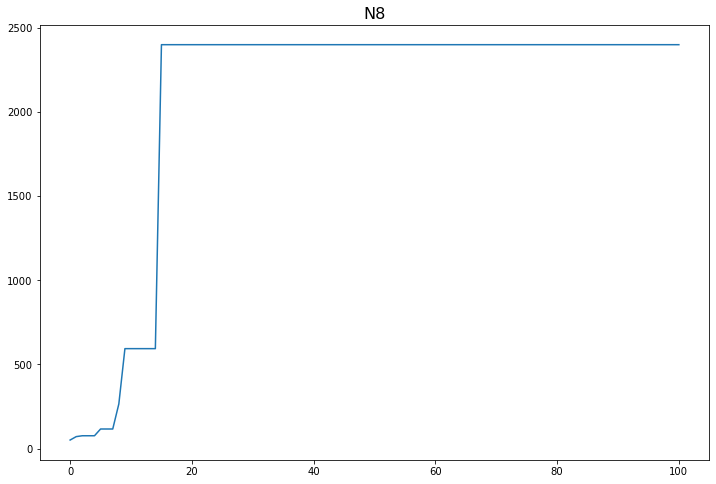

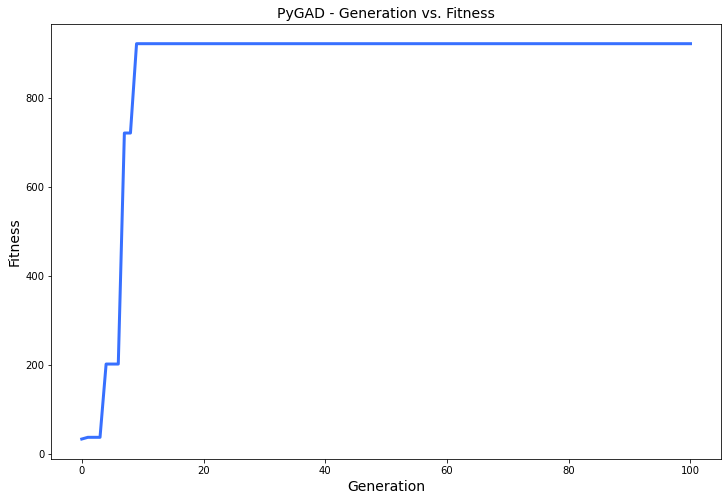

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 29.724 |==================| 3.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 29.619 |==================| 5.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 29.891 |==================| 2.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.752 |==================| 1.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 29.275 |==================| 5.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.122 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 29.677 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.311 |==================| 4.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.345 |==================| 3.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.789 |==================| 3.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 23.585 |==================| 2.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.298 |==================| 4.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.062 |==================| 9

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.789 |==================| 3.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 23.585 |==================| 2.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.298 |==================| 4.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.062 |==================| 973.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.12 |==================| 16.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.14 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 23.585 |==================| 2.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.298 |==================| 4.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.062 |==================| 973.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.12 |==================| 16.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.14 |==================| 12.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 23.815 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 23.472 |==================| 1.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.059 |==================| 501.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.926 |==================| 7.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.265 |==================| 4.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.362 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.011 |==================| 20.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.893 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.265 |==================| 4.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.362 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 24.011 |==================| 20.261 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.893 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 23.47 |==================| 1.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 23.969 |==================| 10.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 24.039 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.897 |==================| 6.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.111 |==================| 19.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.358 |==================| 3.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.257 |==================| 5.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.192 |==================| 7.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.262 |==================| 4.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 23.749 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.358 |==================| 3.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.257 |==================| 5.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.192 |==================| 7.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.262 |==================| 4.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 23.749 |==================| 3.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.132 |==================| 13.968 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.183 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.257 |==================| 5.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.192 |==================| 7.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 24.262 |==================| 4.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 23.749 |==================| 3.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.132 |==================| 13.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.779 |==================| 3.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.334 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.961 |==================| 10.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 23.432 |==================| 1.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.304 |==================| 4.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.903 |==================| 6.367 |==========
Fitness = 973.9171679815826
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.779 |==================| 3.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.334 |==================| 3.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.304 |==================| 4.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 23.903 |==================| 6.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 23.779 |==================| 3.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.334 |==================| 3.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.274 |==================| 4.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 24.16 |==================| 10.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.311 |===========| 23.546 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 23.709 |==================| 2.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.225 |==================| 6.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 23.761 |==================| 3.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.015 |==================| 21.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.086 |==================| 38.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.284 |==================| 4.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.147 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.225 |==================| 6.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 23.761 |==================| 3.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 24.015 |==================| 21.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.086 |==================| 38.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.284 |==================| 4.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 24.147 |==================| 11.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 23.891 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.116 |==================| 18.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 23.792 |==================| 3.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 23.667 |==================| 2.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.069 |==================| 124.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.966 |==================| 10.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.24 |==================| 5.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.82 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 23.667 |==================| 2.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.069 |==================| 124.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.966 |==================| 10.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.24 |==================| 5.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.82 |==================| 4.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.974 |==================| 11.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.355 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.966 |==================| 10.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.24 |==================| 5.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.82 |==================| 4.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.974 |==================| 11.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.355 |==================| 3.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.299 |==================| 4.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.27 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 23.484 |==================| 1.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.041 |==================| 52.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 23.45 |==================| 1.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.969 |==================| 10.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.664 |==================| 2.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 23.578 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.273 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.969 |==================| 10.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.664 |==================| 2.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 23.578 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.273 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.784 |==================| 3.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 24.123 |==================| 15.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 24.169 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 23.702 |==================| 2.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.061 |===========| 23.706 |==================| 2.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 23.755 |==================| 3.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |==================| 6.577 |==========
Generation = 8
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.118 |==================| 17.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.347 |==================| 3.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.783 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |==================| 6.577 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.118 |==================| 17.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.347 |==================| 3.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 23.783 |==================| 3.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 23.705 |==================| 2.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.352 |==================| 3.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 24.086 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.246 |==================| 5.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.212 |==================| 6.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 23.9 |==================| 6.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |==================| 5.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.845 |==================| 4.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 23.595 |==================| 2.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.831 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |==================| 5.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.845 |==================| 4.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 23.595 |==================| 2.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.864 |===========| 23.831 |==================| 4.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 23.522 |==================| 1.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.1 |==================| 25.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.119 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 23.522 |==================| 1.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.1 |==================| 25.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.119 |==================| 16.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 23.659 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 23.915 |==================| 6.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 23.996 |==================| 15.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.252 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 23.565 |==================| 2.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 23.453 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.893 |==================| 5.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.194 |==================| 7.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.999 |==================| 16.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.276 |==================| 4.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.059 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.893 |==================| 5.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.194 |==================| 7.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.999 |==================| 16.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.276 |==================| 4.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 24.059 |==================| 592.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 23.806 |==================| 3.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 24.014 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 23.865 |==================| 5.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 23.785 |==================| 3.628 |==========
Generation = 11
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.175 |==================| 8.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.251 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.769 |==================| 3.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.642 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.297 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 23.785 |==================| 3.628 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.175 |==================| 8.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 24.251 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 23.769 |==================| 3.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.642 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.297 |==================| 4.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.961 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.325 |==================| 3.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.272 |==================| 4.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.085 |==================| 40.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.067 |==================| 160.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.32 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.272 |==================| 4.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.085 |==================| 40.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.067 |==================| 160.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.35 |==================| 3.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.32 |==================| 3.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.32 |==================| 3.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |==================| 12.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 23.608 |==================| 2.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.307 |==================| 4.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.947 |==================| 8.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 23.537 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 23.607 |==================| 2.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.636 |==================| 2.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |==================| 10.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 24.21 |==================| 6.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 23.435 |==================| 1.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.265 |==================| 4.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.062 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 23.435 |==================| 1.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.265 |==================| 4.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 24.062 |==================| 536.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 23.556 |==================| 1.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.304 |==================| 4.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 23.657 |==================| 2.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.368 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.487 |===========| 23.434 |==================| 1.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 23.673 |==================| 2.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.369 |==================| 3.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 23.517 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 23.597 |==================| 2.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.782 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 23.517 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 23.597 |==================| 2.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.782 |==================| 3.594 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 23.648 |==================| 2.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 23.613 |==================| 2.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |==================| 2.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 23.818 |====

======| 1.232 |===========| 23.597 |==================| 2.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.782 |==================| 3.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.347 |==================| 3.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.826 |==================| 4.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.101 |==================| 24.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.222 |==================| 6.187 |==========
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 23.826 |==================| 4.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.101 |==================| 24.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.222 |==================| 6.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 23.655 |==================| 2.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.152 |==================| 10.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.048 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.101 |==================| 24.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.222 |==================| 6.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 23.655 |==================| 2.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 24.152 |==================| 10.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 24.048 |==================| 79.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.344 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 24.071 |==================| 93.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.455 |==================| 1.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 23.608 |==================| 2.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.147 |==================| 11.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.594 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.058 |==================| 452.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.993 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 23.455 |==================| 1.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 23.608 |==================| 2.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.147 |==================| 11.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.594 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 24.058 |==================| 452.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.993 |==================| 14.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 23.716 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.257 |==================| 5.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.161 |==================| 9.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.218 |==================| 6.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.142 |==================| 12.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.357 |==================| 3.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.066 |==================| 183.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 23.771 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.142 |==================| 12.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.357 |==================| 3.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 24.066 |==================| 183.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 23.771 |==================| 3.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.206 |==================| 6.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.17 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.149 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.206 |==================| 6.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.17 |==================| 9.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.149 |==================| 11.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.156 |==================| 10.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.929 |==================| 7.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 23.506 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.284 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 23.436 |==================| 1.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.853 |==================| 4.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 23.741 |==================| 3.126 |==========
Fitness = 973.9171679815826
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 23.506 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.284 |==================| 4.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.853 |==================| 4.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 23.741 |==================| 3.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 23.506 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.284 |==================| 4.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.233 |==================| 5.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.804 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.77 |==================| 3.441 |==========
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.366 |==================| 3.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.15 |==================| 11.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.301 |==================| 4.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.198 |==================| 7.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.969 |==================| 10.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.168 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.366 |==================| 3.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 24.15 |==================| 11.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.301 |==================| 4.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.198 |==================| 7.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.969 |==================| 10.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.168 |==================| 9.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.097 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 23.526 |==================| 1.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.895 |==================| 6.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.052 |==================| 121.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.864 |==================| 5.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.116 |==================| 18.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 23.52 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.895 |==================| 6.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 24.052 |==================| 121.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 23.864 |==================| 5.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.116 |==================| 18.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 23.52 |==================| 1.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 23.607 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.116 |==================| 18.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 23.52 |==================| 1.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 23.607 |==================| 2.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 23.916 |==================| 6.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.893 |==================| 5.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 23.55 |==================| 1.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 23.713 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 24.084 |==================| 42.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.982 |==================| 12.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.305 |==================| 4.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 24.09 |==================| 34.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 23.432 |==================| 1.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.287 |==================| 4.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.278 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 23.432 |==================| 1.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.287 |==================| 4.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.278 |==================| 4.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.358 |==================| 3.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 24.18 |==================| 8.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 23.615 |==================| 2.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 24.057 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.233 |==================| 5.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 24.061 |==================| 1728.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 23.988 |==================| 13.776 |==========
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.157 |==================| 10.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 23.528 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.157 |==================| 10.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 23.528 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 24.009 |==================| 19.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.249 |==================| 5.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.125 |==================| 15.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.3 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 24.088 |==================| 36.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 23.55 |==================| 1.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.714 |==================| 2.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.123 |==================| 16.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.337 |==================| 3.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.473 |==================| 1.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.256 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 23.55 |==================| 1.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.714 |==================| 2.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.123 |==================| 16.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.337 |==================| 3.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.473 |==================| 1.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.256 |==================| 5.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.177 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 23.714 |==================| 2.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.123 |==================| 16.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.337 |==================| 3.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.473 |==================| 1.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.256 |==================| 5.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.177 |==================| 8.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 24.174 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 24.069 |==================| 124.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.161 |==================| 9.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.264 |==================| 4.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.359 |==================| 3.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 23.73 |==================| 3.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.162 |==================| 9.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.249 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.161 |==================| 9.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.264 |==================| 4.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.359 |==================| 3.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 23.73 |==================| 3.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.339 |===========| 24.162 |==================| 9.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.249 |==================| 5.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 23.698 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.264 |==================| 4.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 23.725 |==================| 2.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.943 |==================| 8.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.286 |==================| 4.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.636 |==================| 2.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 23.803 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 23.725 |==================| 2.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.943 |==================| 8.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.286 |==================| 4.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.636 |==================| 2.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 23.803 |==================| 3.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 23.666 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.154 |==================| 10.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 23.636 |==================| 2.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 23.803 |==================| 3.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.124 |===========| 23.666 |==================| 2.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 23.752 |==================| 3.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.212 |==================| 6.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.19 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 23.86 |==================| 4.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 24.081 |==================| 48.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.041 |==================| 51.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.156 |==================| 10.447 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.19 |==================| 7.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 24.041 |==================| 51.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.156 |==================| 10.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 24.19 |==================| 7.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 23.66 |==================| 2.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |==================| 8.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.365 |==================| 3.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.938 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.261 |==================| 4.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.365 |==================| 3.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.817 |==================| 4.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 23.872 |==================| 5.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 23.673 |==================| 2.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.288 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.886 |===========| 23.817 |==================| 4.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 23.872 |==================| 5.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 23.673 |==================| 2.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.288 |==================| 4.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.237 |==================| 5.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 23.759 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 23.536 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 23.883 |==================| 5.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 23.621 |==================| 2.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.938 |==================| 8.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.965 |==================| 10.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 23.883 |==================| 5.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 23.621 |==================| 2.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.938 |==================| 8.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.965 |==================| 10.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.067 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.938 |==================| 8.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.965 |==================| 10.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 24.067 |==================| 166.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 23.858 |==================| 4.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.115 |==================| 18.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 23.547 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.939 |==================| 8.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 23.572 |==================| 2.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.244 |==================| 5.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 23.529 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 23.709 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.323 |==================| 3.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 23.922 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 23.709 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.323 |==================| 3.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 23.922 |==================| 7.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 23.812 |==================| 4.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.311 |==================| 3.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 23.456 |==================| 1.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.107 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.078 |==================| 56.376 |==========
Generation = 30
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.178 |==================| 8.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 24.357 |==================| 3.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 24.244 |==================| 5.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 23.481 |==================| 1.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 23.897 |==================| 6.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.185 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 23.481 |==================| 1.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 23.897 |==================| 6.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 24.185 |==================| 8.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 24.074 |==================| 73.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |==================| 12.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 23.617 |==================| 2.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.152 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 24.363 |==================| 3.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 23.685 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 23.804 |==================| 3.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.533 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.027 |==================| 29.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 23.686 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 23.575 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 24.027 |==================| 29.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 23.686 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 23.575 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.109 |==================| 20.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.258 |==================| 5.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 23.616 |==================| 2.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 23.686 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 23.575 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.109 |==================| 20.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.258 |==================| 5.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 23.616 |==================| 2.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.254 |==================| 5.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.119 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 23.453 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.938 |==================| 8.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 23.696 |==================| 2.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.939 |==================| 8.257 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 23.807 |==================| 3.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 23.453 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.938 |==================| 8.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 23.696 |==================| 2.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.939 |==================| 8.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 23.807 |==================| 3.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 23.621 |==================| 2.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.2 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 23.601 |==================| 2.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.214 |==================| 6.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.665 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.038 |==================| 43.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.079 |==================| 55.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.183 |==================| 8.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.059 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.665 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 24.038 |==================| 43.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 24.079 |==================| 55.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.183 |==================| 8.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 24.059 |==================| 823.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.852 |===========| 23.838 |==================| 4.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.136 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.77 |==================| 3.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 24.187 |==================| 7.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 24.25 |==================| 5.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.794 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.102 |==================| 23.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.797 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.269 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 23.794 |==================| 3.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.102 |==================| 23.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.797 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.269 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 23.709 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.764 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.212 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 23.797 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.269 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 23.709 |==================| 2.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.764 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.212 |==================| 6.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.134 |==================| 13.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 23.884 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 23.585 |==================| 2.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.264 |==================| 4.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.273 |==================| 4.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 23.486 |==================| 1.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.899 |==================| 6.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.857 |==================| 4.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 23.866 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.264 |==================| 4.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.273 |==================| 4.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 23.486 |==================| 1.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.899 |==================| 6.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.857 |==================| 4.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 23.866 |==================| 5.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.305 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 23.994 |==================| 15.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.143 |==================| 12.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 23.593 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.828 |==================| 4.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.199 |==========
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.132 |==================| 13.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.31 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.143 |==================| 12.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 23.593 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.828 |==================| 4.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.199 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.132 |==================| 13.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.31 |==================| 4.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.934 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 23.593 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 23.828 |==================| 4.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.095 |==================| 29.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.464 |==================| 1.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 3.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.195 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 24.355 |==================| 3.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 23.663 |==================| 2.514 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.095 |==================| 29.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.464 |==================| 1.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 3.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.195 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 3.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.195 |==================| 7.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 24.332 |==================| 3.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.358 |==================| 3.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 23.942 |==================| 8.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 23.797 |==================| 3.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.25 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 24.247 |==================| 5.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 23.548 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.326 |==================| 3.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 23.528 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.909 |==================| 6.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 23.533 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 23.884 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.909 |==================| 6.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 23.533 |==================| 1.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 23.884 |==================| 5.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.462 |==================| 1.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 23.522 |==================| 1.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 23.628 |==================| 2.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 23.875 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.165 |==================| 9.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.336 |==================| 3.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.263 |==================| 4.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 23.551 |==================| 1.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 23.439 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.782 |==================| 3.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.665 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 23.439 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 23.782 |==================| 3.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.665 |==================| 2.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.278 |==================| 4.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.346 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.859 |==================| 4.962 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.105 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 23.665 |==================| 2.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.278 |==================| 4.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.346 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.859 |==================| 4.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.917 |==================| 6.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.352 |==================| 3.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.108 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.179 |==================| 8.475 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.917 |==================| 6.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.352 |==================| 3.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.108 |==================| 21.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.371 |==================| 3.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.188 |==================| 7.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.917 |==================| 6.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.352 |==================| 3.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.108 |==================| 21.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.371 |==================| 3.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.188 |==================| 7.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.966 |==================| 10.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.923 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.34 |==================| 3.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.32 |==================| 3.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.949 |==================| 8.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 23.823 |==================| 4.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 23.495 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.994 |==================| 15.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.269 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.32 |==================| 3.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.949 |==================| 8.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 23.823 |==================| 4.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.392 |===========| 23.495 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.994 |==================| 15.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.269 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.895 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 23.537 |==================| 1.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 24.141 |==================| 12.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.971 |==================| 11.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.962 |==================| 10.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.091 |==================| 32.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.102 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 24.091 |==================| 32.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.102 |==================| 24.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.055 |==================| 197.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 24.145 |==================| 11.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.641 |==================| 2.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.758 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.102 |==================| 24.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 24.055 |==================| 197.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 24.145 |==================| 11.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.641 |==================| 2.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.758 |==================| 3.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.464 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.266 |==================| 4.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.9 |==================| 6.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.315 |==================| 3.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.147 |==================| 11.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 23.489 |==================| 1.749 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.464 |==================| 1.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 23.489 |==================| 1.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.464 |==================| 1.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 24.18 |==================| 8.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.294 |==================| 4.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 23.884 |==================| 5.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.34 |==================| 3.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.953 |==================| 9.3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.32 |==================| 3.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.501 |==================| 1.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.128 |==================| 14.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.856 |==================| 4.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.284 |==================| 4.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 23.671 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 23.501 |==================| 1.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.128 |==================| 14.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 23.683 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 23.856 |==================| 4.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.284 |==================| 4.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 23.671 |==================| 2.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.315 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.218 |==================| 6.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.76 |==================| 3.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 23.802 |==================| 3.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.665 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.724 |==================| 2.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.323 |==================| 3.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 23.804 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 23.76 |==================| 3.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 23.802 |==================| 3.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.665 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.724 |==================| 2.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.323 |==================| 3.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 23.804 |==================| 3.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.758 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 23.665 |==================| 2.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 23.724 |==================| 2.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.323 |==================| 3.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 23.804 |==================| 3.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.758 |==================| 3.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 24.001 |==================| 16.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 23.525 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 24.023 |==================| 26.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.195 |==================| 7.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.992 |==================| 14.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 23.894 |==================| 6.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.217 |==================| 6.399 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.611 |==================| 2.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.217 |==================| 6.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.611 |==================| 2.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.305 |==================| 4.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 24.106 |==================| 21.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.168 |==================| 9.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.259 |==================| 5.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.149 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.325 |==================| 3.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 23.862 |==================| 5.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.294 |==================| 4.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.891 |==================| 5.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.464 |==================| 1.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.352 |==================| 3.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 23.464 |==================| 1.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.352 |==================| 3.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |==================| 10.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.1 |==================| 25.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 23.589 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 145.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 23.758 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.2 |==================| 7.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 23.588 |==================| 2.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 23.537 |==================| 1.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.303 |==================| 4.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.883 |==================| 5.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 23.825 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 23.588 |==================| 2.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 23.537 |==================| 1.912 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 24.303 |==================| 4.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.883 |==================| 5.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 23.825 |==================| 4.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.089 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 23.883 |==================| 5.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 23.825 |==================| 4.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 24.089 |==================| 35.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.239 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.078 |==================| 57.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 23.466 |==================| 1.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 23.462 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.36 |==================| 3.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 23.812 |==================| 4.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.283 |==================| 4.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.17 |==================| 9.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 23.713 |==================| 2.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.949 |==================| 8.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 23.812 |==================| 4.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.283 |==================| 4.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.17 |==================| 9.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 23.713 |==================| 2.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.949 |==================| 8.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.321 |==================| 3.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 24.366 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.142 |==================| 12.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.955 |==================| 9.439 |==========
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.119 |==================| 16.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.191 |==================| 7.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.311 |==================| 3.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.098 |==================| 26.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 23.553 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.119 |==================| 16.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.191 |==================| 7.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.311 |==================| 3.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 24.098 |==================| 26.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 23.553 |==================| 1.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 23.841 |==================| 4.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.283 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 23.437 |==================| 1.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 23.772 |==================| 3.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 23.628 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.233 |==================| 5.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 23.452 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 23.628 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.233 |==================| 5.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 23.452 |==================| 1.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.789 |==================| 3.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.222 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.133 |==================| 13.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 23.452 |==================| 1.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.789 |==================| 3.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.222 |==================| 6.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 23.601 |==================| 2.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 23.914 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 23.507 |==================| 1.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.999 |==================| 16.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.186 |==================| 7.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 23.719 |==================| 2.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.271 |==================| 4.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.1 |==================| 25.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.103 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.271 |==================| 4.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 24.1 |==================| 25.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.103 |==================| 23.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 24.173 |==================| 8.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 24.008 |==================| 18.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.358 |==================| 3.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 23.845 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 23.7 |==================| 2.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 23.732 |==================| 3.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.17 |==================| 9.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 23.816 |==================| 4.093 |==========
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 23.559 |==================| 1.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.824 |==================| 4.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.064 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 23.559 |==================| 1.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.824 |==================| 4.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 24.064 |==================| 282.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.321 |==================| 3.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 23.905 |==================| 6.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.262 |==================| 4.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.227 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.323 |==================| 3.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 23.483 |==================| 1.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.998 |==================| 16.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 24.209 |==================| 6.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.351 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.853 |==================| 4.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.351 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.853 |==================| 4.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 23.563 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.122 |==================| 16.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.144 |==================| 11.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.163 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.853 |==================| 4.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 23.563 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.122 |==================| 16.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.144 |==================| 11.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.163 |==================| 9.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 23.592 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 145.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 23.512 |==================| 1.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 23.679 |==================| 2.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 24.288 |==================| 4.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |==================| 6.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.955 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |==================| 6.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.955 |==================| 9.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 23.795 |==================| 3.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.646 |===========| 23.969 |==================| 10.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.325 |==================| 3.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 23.563 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.063 |==================| 443.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.099 |==================| 26.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 23.435 |==================| 1.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 23.644 |==================| 2.401 |==========
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.365 |==================| 3.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.448 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.11

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.099 |==================| 26.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 23.435 |==================| 1.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 23.644 |==================| 2.401 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.365 |==================| 3.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 23.448 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 24.111 |==================| 19.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 23.895 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 23.919 |==================| 7.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.158 |==================| 10.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.368 |==================| 3.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |==================| 15.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.365 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.124 |==================| 15.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.37 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 24.368 |==================| 3.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |==================| 15.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.365 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.124 |==================| 15.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.37 |==================| 3.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 23.761 |==================| 3.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.962 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.365 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 24.124 |==================| 15.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.37 |==================| 3.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 23.761 |==================| 3.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 23.962 |==================| 10.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |==================| 3.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 23.895 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 24.063 |==================| 393.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.962 |==================| 10.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 23.622 |==================| 2.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.216 |==================| 6.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.22 |==================| 6.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 23.663 |==================| 2.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 23.651 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 23.622 |==================| 2.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.216 |==================| 6.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.22 |==================| 6.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 23.663 |==================| 2.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 23.651 |==================| 2.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 23.483 |==================| 1.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 23.821 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.835 |===========| 23.85 |==================| 4.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 23.701 |==================| 2.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.244 |==================| 5.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.968 |==========
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 23.641 |==================| 2.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |==================| 15.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.154 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 23.701 |==================| 2.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.244 |==================| 5.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.968 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 23.641 |==================| 2.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.126 |==================| 15.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.154 |==================| 10.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.253 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.244 |==================| 5.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |==================| 7.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.23 |==================| 5.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 23.662 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.001 |==================| 16.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.23 |==================| 5.887 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.23 |==================| 5.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 23.662 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.001 |==================| 16.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |==================| 3.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 24.001 |==================| 16.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |==================| 3.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.319 |==================| 3.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 23.804 |==================| 3.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 23.817 |==================| 4.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.358 |==================| 3.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 23.967 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.165 |==================| 9.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 23.807 |==================| 3.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 24.068 |==================| 130.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.234 |==================| 5.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 23.581 |==================| 2.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.992 |==================| 14.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.206 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 23.581 |==================| 2.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.992 |==================| 14.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.206 |==================| 6.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 23.65 |==================| 2.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.203 |==================| 7.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 23.734 |==================| 3.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.202 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 23.616 |==================| 2.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.132 |==================| 13.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.37 |==================| 3.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.155 |==================| 10.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.918 |==================| 6.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.115 |==================| 18.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.844 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.132 |==================| 13.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.37 |==================| 3.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.155 |==================| 10.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.918 |==================| 6.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.115 |==================| 18.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.844 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.078 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 24.37 |==================| 3.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.155 |==================| 10.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 23.918 |==================| 6.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.115 |==================| 18.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 23.844 |==================| 4.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 24.078 |==================| 57.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 23.653 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 24.083 |==================| 44.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.195 |==================| 7.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.159 |==================| 10.203 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.179 |==================| 8.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.784 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.099 |==================| 26.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.195 |==================| 7.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.159 |==================| 10.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 24.179 |==================| 8.43 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 23.784 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.099 |==================| 26.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.171 |==================| 9.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.997 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 23.533 |==================| 1.897 |==========
Generation = 64
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.224 |==================| 6.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 23.637 |==================| 2.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 23.514 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.239 |==================| 5.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 23.727 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 23.604 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.224 |==================| 6.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 23.637 |==================| 2.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 23.514 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.239 |==================| 5.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 23.727 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 23.604 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.168 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.188 |==================| 7.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.146 |==================| 11.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.359 |==================| 3.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |==================| 8.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 146.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.239 |==================| 5.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 23.675 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 24.146 |==================| 11.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.359 |==================| 3.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |==================| 8.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 146.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.239 |==================| 5.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 23.675 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.151 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 24.359 |==================| 3.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.178 |==================| 8.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 146.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.239 |==================| 5.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.11 |===========| 23.675 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.151 |==================| 11.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 23.833 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.282 |==================| 4.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.314 |==================| 3.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.642 |==================| 2.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |==================| 10.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.286 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.314 |==================| 3.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.161 |===========| 23.642 |==================| 2.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.159 |==================| 10.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.286 |==================| 4.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 23.528 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 23.764 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 23.515 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.295 |==================| 4.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 23.995 |==================| 15.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.122 |==================| 16.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 23.716 |==================| 2.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.206 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 23.995 |==================| 15.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 24.122 |==================| 16.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 23.716 |==================| 2.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.206 |==================| 6.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 23.554 |==================| 1.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.892 |==================| 5.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.891 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 23.716 |==================| 2.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.206 |==================| 6.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 23.554 |==================| 1.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 23.892 |==================| 5.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.891 |==================| 5.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 24.209 |==================| 6.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 23.878 |==================| 5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.347 |==================| 3.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 23.535 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.051 |==================| 102.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.86 |==================| 4.978 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.07 |==================| 101.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 23.499 |==================| 1.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 23.535 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 24.051 |==================| 102.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 23.86 |==================| 4.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 24.07 |==================| 101.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 23.499 |==================| 1.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 24.019 |==================| 23.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 23.844 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.3 |==================| 4.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.561 |===========| 24.022 |==================| 26.12 |==========
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.135 |==================| 13.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 23.853 |==================| 4.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.186 |==================| 7.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 23.687 |==================| 2.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.289 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.186 |==================| 7.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 23.687 |==================| 2.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.289 |==================| 4.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 23.664 |==================| 2.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 23.532 |==================| 1.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 24.347 |==================| 3.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 23.553 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.311 |==================| 3.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 23.862 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 23.721 |==================| 2.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 23.725 |==================| 2.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.444 |==================| 1.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 23.731 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 23.862 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 23.721 |==================| 2.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 23.725 |==================| 2.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.444 |==================| 1.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 23.731 |==================| 3.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 23.727 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 23.444 |==================| 1.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 23.731 |==================| 3.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 23.727 |==================| 3.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.281 |==================| 4.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 24.012 |==================| 20.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.32 |==================| 3.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.956 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 24.158 |==================| 10.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.242 |==================| 5.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 23.482 |==================| 1.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.077 |==================| 60.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 23.461 |==================| 1.669 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.242 |==================| 5.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 23.482 |==================| 1.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 24.077 |==================| 60.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 23.461 |==================| 1.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.263 |==================| 4.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 23.627 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 23.785 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.268 |==================| 4.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 23.502 |==================| 1.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 23.491 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.135 |==================| 13.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 23.557 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.638 |==================| 2.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 23.536 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 23.502 |==================| 1.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 23.491 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.135 |==================| 13.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 23.557 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.638 |==================| 2.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 23.536 |==================| 1.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.32 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 23.756 |==================| 3.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 23.472 |==================| 1.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.253 |==================| 5.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.255 |==================| 5.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.075 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 24.173 |==================| 8.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.253 |==================| 5.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.255 |==================| 5.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.075 |==================| 67.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.01 |==================| 19.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 23.539 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.253 |==================| 5.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.255 |==================| 5.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 24.075 |==================| 67.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 24.01 |==================| 19.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 23.539 |==================| 1.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.743 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 23.581 |==================| 2.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 23.561 |==================| 2.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.743 |===========| 23.907 |==================| 6.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 23.605 |==================| 2.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 23.965 |==================| 10.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 23.669 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.043 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 23.965 |==================| 10.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 23.669 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.528 |===========| 24.043 |==================| 56.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 24.062 |==================| 932.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 23.544 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 23.819 |==================| 4.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 23.498 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 24.072 |==================| 86.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.594 |==================| 2.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 23.658 |==================| 2.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 23.889 |==================| 5.833 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.074 |==================| 77.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 23.484 |==================| 1.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 23.51 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 23.594 |==================| 2.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.137 |===========| 23.658 |==================| 2.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 23.889 |==================| 5.833 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 24.074 |==================| 77.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 23.484 |==================| 1.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 23.51 |==================| 1.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 23.702 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.98 |==================| 12.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 23.696 |==================| 2.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.308 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 23.496 |==================| 1.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.029 |==================| 31.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.293 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 24.029 |==================| 31.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.293 |==================| 4.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 23.95 |==================| 9.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 23.69 |==================| 2.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 23.509 |==================| 1.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.202 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 23.834 |==================| 4.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.293 |==================| 4.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 23.95 |==================| 9.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 23.69 |==================| 2.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 23.509 |==================| 1.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.202 |==================| 7.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.119 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 23.645 |==================| 2.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 23.477 |==================| 1.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 23.94 |==================| 8.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.331 |==================| 3.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 23.555 |==================| 1.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.093 |==================| 31.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.261 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.331 |==================| 3.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 23.555 |==================| 1.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 24.093 |==================| 31.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.261 |==================| 4.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.205 |==================| 6.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.954 |==================| 9.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.991 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 23.895 |==================| 6.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 23.463 |==================| 1.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.306 |==================| 4.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.37 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 23.855 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.157 |==================| 10.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 23.748 |==================| 3.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 23.855 |==================| 4.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.349 |==================| 3.469 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 23.674 |==================| 2.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 23.445 |==================| 1.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 23.81 |==================| 3.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.17 |==================| 9.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.286 |==================| 4.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.102 |==================| 23.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.731 |==================| 3.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.141 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.102 |==================| 23.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.731 |==================| 3.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.141 |==================| 12.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.369 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.182 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 23.731 |==================| 3.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.238 |==================| 5.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 24.141 |==================| 12.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.337 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.369 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.306 |===========| 24.182 |==================| 8.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 23.728 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 23.607 |==================| 2.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.264 |==================| 4.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 23.785 |==================| 3.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.165 |==================| 9.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 23.727 |==================| 3.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.737 |==================| 3.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.04 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 23.727 |==================| 3.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 23.737 |==================| 3.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 24.04 |==================| 48.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.963 |===========| 23.768 |==================| 3.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 23.858 |==================| 4.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.702 |===========| 23.933 |==================| 7.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.221 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.761 |===========| 23.896 |==================| 6.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.789 |==================| 3.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 23.789 |==================| 3.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.963 |==================| 10.287 |==========
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.839 |==================| 4.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 23.524 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 23.572 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 23.963 |==================| 10.287 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.851 |===========| 23.839 |==================| 4.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 23.524 |==================| 1.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 23.74 |==================| 3.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.202 |==================| 7.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.35 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 23.613 |==================| 2.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 23.627 |==================| 2.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.888 |==================| 5.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.186 |==================| 7.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.085 |==================| 41.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 23.483 |==================| 1.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.027 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 23.888 |==================| 5.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 24.186 |==================| 7.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 24.085 |==================| 41.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 23.483 |==================| 1.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.027 |==================| 29.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.094 |==================| 29.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.161 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.027 |==================| 29.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.094 |==================| 29.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.161 |==================| 9.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.352 |==================| 3.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 23.77 |==================| 3.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.175 |==================| 8.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.345 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 23.704 |==================| 2.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 23.954 |==================| 9.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 23.618 |==================| 2.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.259 |==================| 5.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.357 |==================| 3.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 23.656 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.868 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.259 |==================| 5.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 24.357 |==================| 3.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 23.656 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 23.868 |==================| 5.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.155 |==================| 10.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 23.518 |==================| 1.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 24.35 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 24.032 |==================| 35.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 24.026 |==================| 29.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 23.65 |==================| 2.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 23.97 |==================| 11.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 23.474 |==================| 1.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.065 |==================| 204.835 |==========
Generation = 84
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.27

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 23.474 |==================| 1.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.065 |==================| 204.835 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.272 |==================| 4.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 23.679 |==================| 2.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 23.982 |==================| 12.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 24.076 |==================| 63.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.23 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 24.065 |==================| 204.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 24.019 |==================| 24.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.331 |==================| 3.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 23.59 |==================| 2.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.859 |==================| 4.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.974 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.331 |==================| 3.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 23.59 |==================| 2.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.859 |==================| 4.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.974 |==================| 11.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.816 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.354 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 23.59 |==================| 2.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.82 |===========| 23.859 |==================| 4.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.974 |==================| 11.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 23.816 |==================| 4.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.354 |==================| 3.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 23.599 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.161 |==================| 9.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.229 |==================| 5.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.998 |==================| 16.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 23.668 |==================| 2.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.866 |==================| 5.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.229 |==================| 5.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 23.998 |==================| 16.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 23.668 |==================| 2.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.809 |===========| 23.866 |==================| 5.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 24.067 |==================| 146.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 23.897 |==================| 6.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.935 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 23.695 |==================| 2.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 23.439 |==================| 1.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 23.809 |==================| 3.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 23.463 |==================| 1.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.339 |==================| 3.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.294 |==================| 4.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.217 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 23.463 |==================| 1.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 24.339 |==================| 3.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.294 |==================| 4.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.217 |==================| 6.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.298 |==================| 4.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.236 |==================| 5.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 23.49 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.298 |==================| 4.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 24.236 |==================| 5.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 23.49 |==================| 1.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.118 |==================| 17.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.134 |==================| 13.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.288 |==================| 4.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 23.55 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 24.214 |==================| 6.515 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.134 |==================| 13.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.288 |==================| 4.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 23.55 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 23.986 |==================| 13.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.243 |==================| 5.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.134 |==================| 13.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.288 |==================| 4.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 23.55 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 23.986 |==================| 13.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.243 |==================| 5.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 24.034 |==================| 37.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 23.506 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 24.271 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 23.489 |==================| 1.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 23.648 |==================| 2.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 23.97 |==================| 11.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.236 |==================| 5.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.367 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.828 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 23.489 |==================| 1.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.153 |===========| 23.648 |==================| 2.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 23.97 |==================| 11.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.236 |==================| 5.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 24.367 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 23.828 |==================| 4.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 23.526 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.172 |==================| 9.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 23.434 |==================| 1.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 23.524 |==================| 1.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.267 |==================| 4.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.241 |==================| 5.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |==================| 12.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 23.488 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.241 |==================| 5.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 24.138 |==================| 12.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 23.488 |==================| 1.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.744 |==================| 3.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.366 |==================| 3.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 23.45 |==================| 1.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.157 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 23.488 |==================| 1.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 23.744 |==================| 3.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.366 |==================| 3.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 23.45 |==================| 1.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.157 |==================| 10.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.888 |==================| 5.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.203 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 24.142 |==================| 12.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.254 |==================| 5.173 |==========
Fitness = 713268.0534368429
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.888 |==================| 5.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.203 |==================| 7.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 23.709 |==================| 2.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.869 |==================| 5.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.254 |==================| 5.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 23.888 |==================| 5.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.203 |==================| 7.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 23.709 |==================| 2.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.804 |===========| 23.869 |==================| 5.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 24.161 |==================| 9.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.118 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.937 |==================| 8.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.231 |==================| 5.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.254 |==================| 5.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 24.268 |==================| 4.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.323 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 23.751 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 23.66 |==================

======| 0.169 |===========| 24.268 |==================| 4.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.323 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 23.751 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 23.66 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 23.649 |==================| 2.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.328 |==================| 3.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.228 |==================| 5.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|F

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.231 |==================| 5.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.196 |==================| 7.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 4.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.135 |==================| 13.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 23.62 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.26 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 4.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.135 |==================| 13.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 23.62 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.26 |==================| 5.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.325 |==================| 3.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.135 |==================| 13.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 24.107 |==================| 21.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 23.62 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.26 |==================| 5.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.325 |==================| 3.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.213 |==================| 6.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.913 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.28 |==================| 4.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.111 |==================| 19.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.353 |==================| 3.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.317 |==================| 3.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 23.727 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 24.177 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.111 |==================| 19.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.353 |==================| 3.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.317 |==================| 3.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 23.727 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.931 |==================| 7.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 24.177 |==================| 8.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.364 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.196 |==================| 7.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.611 |==================| 2.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.12 |==================| 16.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.301 |==================| 4.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.87 |==================| 5.258 |==========
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.281 |==================| 4.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.559 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 23.611 |==================| 2.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.12 |==================| 16.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.301 |==================| 4.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.87 |==================| 5.258 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.281 |==================| 4.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 23.559 |==================| 1.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 24.183 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 24.12 |==================| 16.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.301 |==================| 4.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 23.87 |==================| 5.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.226 |==================| 6.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.108 |==================| 21.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.845 |==================| 4.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.927 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.226 |==================| 6.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 24.108 |==================| 21.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.845 |==================| 4.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.927 |==================| 7.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.15 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 23.845 |==================| 4.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 23.927 |==================| 7.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.207 |==================| 6.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.327 |==================| 3.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.15 |==================| 11.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 23.542 |==================| 1.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.217 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.17 |==================| 9.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.312 |==================| 3.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.226 |==================| 6.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.02 |==================| 24.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.434 |==================| 1.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |==================| 3.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.221 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.226 |==================| 6.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 24.02 |==================| 24.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 23.434 |==================| 1.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 23.768 |==================| 3.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.221 |==================| 6.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 23.745 |==================| 3.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.128 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 24.122 |==================| 16.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.924 |==================| 7.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 23.907 |==================| 6.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.191 |==================| 7.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 23.654 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.641 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.825 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 23.654 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 23.641 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.825 |==================| 4.249 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 23.516 |==================| 1.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 23.638 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 23.551 |==================| 1.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 23.939 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 23.825 |==================| 4.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.311 |==================| 3.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 24.134 |==================| 13.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 24.082 |==================| 45.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.198 |==================| 7.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.16 |==================| 10.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 23.525 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.198 |==================| 7.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.16 |==================| 10.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 23.525 |==================| 1.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.335 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.128 |==================| 14.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 23.679 |==================| 2.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.099 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.16 |==================| 10.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 23.525 |==================| 1.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.335 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.128 |==================| 14.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 23.679 |==================| 2.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 24.099 |==================| 25.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 23.704 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.224 |==================| 6.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.064 |==================| 319.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.191 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.212 |==================| 6.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.111 |==================| 19.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.17 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.064 |==================| 319.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.283 |==================| 4.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 24.191 |==================| 7.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.212 |==================| 6.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 24.111 |==================| 19.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 24.17 |==================| 9.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.255 |===============

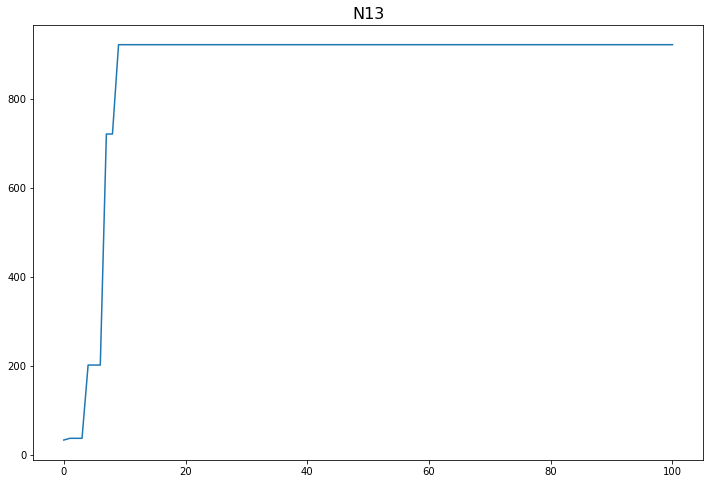

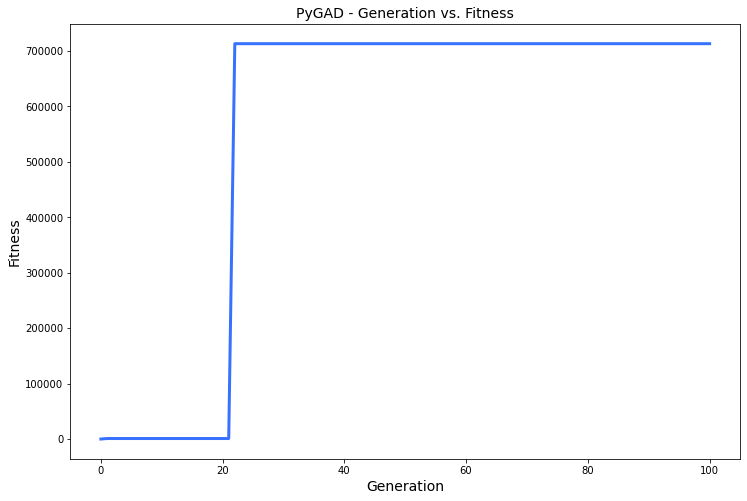

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 24.188 |==================| 7.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 23.438 |==================| 1.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 23.824 |==================| 4.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.264 |==================| 4.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.913 |==================| 6.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.224 |==================| 6.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 24.064 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 22.239 |==================| 0.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.65 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.826 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.677 |==================| 1.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.362 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 21.329 |==================| 0.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.271 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.65 |==================| 1.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.826 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.677 |==================| 1.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.362 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 21.329 |==================| 0.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.271 |==================| 1.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.263 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 24.826 |==================| 1.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.677 |==================| 1.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.362 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 21.329 |==================| 0.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.271 |==================| 1.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 22.263 |==================| 0.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 20.929 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 22.058 |==================| 0.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 20.86 |==================| 0.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.583 |==================| 1.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 25.014 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.997 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.199 |==================| 1.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.423 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.583 |==================| 1.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 25.014 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.997 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.716 |===========| 23.199 |==================| 1.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.423 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.517 |==================| 1.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 21.638 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.01 |==================| 6.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.814 |==================| 1.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.388 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.038 |==================| 5.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.101 |==================| 4.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.095 |==================| 4.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.796 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.388 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.038 |==================| 5.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.101 |==================| 4.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.095 |==================| 4.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.796 |==================| 1.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 22.441 |==================| 0.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.919 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.101 |==================| 4.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 24.095 |==================| 4.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.796 |==================| 1.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 22.441 |==================| 0.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.919 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 22.201 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 22.049 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 20.817 |==================| 0.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.06 |==================| 1.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 23.868 |==================| 61.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.454 |==================| 1.66 |==========
Fitness = 61.169724832920515
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.578 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.156 |==================| 3.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 23.578 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.156 |==================| 3.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 25.046 |==================| 0.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.445 |==================| 1.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 22.428 |==================| 0.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 21.029 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.361 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 20.885 |==================| 0.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.233 |==================| 2.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.975 |==================| 0.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.874 |==================| 0.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.533 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 22.832 |==================| 0.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.407 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.874 |==================| 0.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.533 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.829 |===========| 22.832 |==================| 0.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.407 |==================| 1.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.147 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.016 |==================| 0.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.606 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 23.512 |==================| 2.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 24.004 |==================| 6.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.942 |==================| 11.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 22.238 |==================| 0.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 23.284 |==================| 1.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 22.62 |==================| 0.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 20.943 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 23.284 |==================| 1.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 22.62 |==================| 0.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 20.943 |==================| 0.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 22.344 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.123 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 21.5 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 22.874 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 20.943 |==================| 0.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 22.344 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.123 |==================| 3.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 21.5 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 22.874 |==================| 1.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 20.474 |==================| 0.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.954 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 21.034 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.321 |==================| 1.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 22.245 |==================| 0.622 |==========
Fitness = 61.169724832920515
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 22.524 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.058 |==================| 0.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.546 |==================| 1.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.321 |==================| 1.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 22.245 |==================| 0.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 22.524 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.058 |==================| 0.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.546 |==================| 1.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 24.845 |==================| 1.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.383 |===========| 20.865 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.612 |==================| 1.316 |==========
Generation = 8
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 22.236 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.282 |==================| 0.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.056 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.17 |==================| 3.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.682 |==================| 1.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.664 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 22.236 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.282 |==================| 0.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.056 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.17 |==================| 3.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.682 |==================| 1.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 24.664 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.379 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.883 |==================| 31.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.092 |==================| 4.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 21.385 |==================| 0.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 21.447 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.396 |==================| 1.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.884 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.869 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 21.447 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.396 |==================| 1.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.884 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.869 |==================| 0.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.494 |==================| 2.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 22.196 |==================| 0.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.727 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 24.396 |==================| 1.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.884 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.869 |==================| 0.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 23.494 |==================| 2.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 22.196 |==================| 0.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.727 |==================| 1.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 23.439 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 23.92 |==================| 14.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 22.166 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.297 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.241 |==================| 2.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.217 |==================| 1.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.582 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 22.428 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 22.166 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.297 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.241 |==================| 2.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 23.217 |==================| 1.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 24.582 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 22.428 |==================| 0.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.273 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.824 |==================| 35.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 20.526 |==================| 0.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 23.642 |==================| 4.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.58 |===========| 23.617 |==================| 4.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.125 |==================| 1.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 23.993 |==================| 7.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 20.738 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 23.125 |==================| 1.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 23.993 |==================| 7.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 20.738 |==================| 0.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 22.65 |==================| 0.832 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 21.654 |==================| 0.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 23.547 |==================| 3.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.305 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.637 |==================| 1.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 21.905 |==================| 0.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.882 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 23.629 |==================| 4.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 23.463 |==================| 2.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.044 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.71 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 21.905 |==================| 0.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.882 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 23.629 |==================| 4.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 23.463 |==================| 2.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.044 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.71 |==================| 1.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.294 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.882 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 23.629 |==================| 4.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 23.463 |==================| 2.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.044 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.71 |==================| 1.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.294 |==================| 0.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.718 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.47 |==================| 1.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 23.059 |==================| 1.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================| 8.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.714 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.095 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 22.865 |==================| 1.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 22.219 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 23.095 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.819 |===========| 22.865 |==================| 1.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 22.219 |==================| 0.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.634 |==================| 4.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 23.508 |==================| 2.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 21.295 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 23.69 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 21.19 |==================| 0.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.153 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 22.227 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.67 |==================| 0.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 21.091 |==================| 0.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.507 |==================| 1.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 21.065 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 21.091 |==================| 0.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.507 |==================| 1.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 21.065 |==================| 0.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.715 |==================| 1.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 21.041 |==================| 0.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.016 |==================| 0.859 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.183 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 21.065 |==================| 0.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.715 |==================| 1.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 21.041 |==================| 0.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 25.016 |==================| 0.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.037 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.998 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.221 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 24.98 |==================| 0.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.042 |==================| 0.84 |==========
Fitness = 2077.793918178409
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.037 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.998 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.221 |==================| 1.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.071 |==================| 1.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 25.042 |==================| 0.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.037 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.998 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.709 |===========| 23.221 |==================| 1.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 23.071 |==================| 1.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.893 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.851 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 22.396 |==================| 0.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 23.764 |==================| 11.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 22.158 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 22.201 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 22.266 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.099 |==================| 4.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.244 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 23.764 |==================| 11.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 22.158 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 22.201 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 22.266 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 24.099 |==================| 4.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 24.244 |==================| 2.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.251 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.768 |==================| 1.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.555 |==================| 3.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 25.059 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 22.06 |==================| 0.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.218 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 22.096 |==================| 0.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.406 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 24.218 |==================| 2.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 22.096 |==================| 0.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.406 |==================| 1.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.202 |==================| 2.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.148 |==================| 3.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 21.841 |==================| 0.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 22.366 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.202 |==================| 2.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.148 |==================| 3.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 21.841 |==================| 0.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.967 |===========| 22.366 |==================| 0.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.038 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 24.436 |==================| 1.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 24.809 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.525 |==================| 1.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 22.611 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 21.411 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.662 |==================| 1.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 23.599 |==================| 3.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 22.2 |==================| 0.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 22.18 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 23.599 |==================| 3.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.015 |===========| 22.2 |==================| 0.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 22.18 |==================| 0.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.831 |===========| 22.826 |==================| 0.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.903 |==================| 0.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.801 |==================| 1.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 22.491 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 21.834 |==================| 0.496 |==========
Generation = 19
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.107 |==================| 3.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.943 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.165 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.677 |==================| 1.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.916 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 21.687 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 24.943 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 24.165 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.677 |==================| 1.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.916 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 21.687 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.966 |==================| 0.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 22.406 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.852 |==================| 1.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 25.014 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.473 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 23.509 |==================| 2.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 22.519 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 22.796 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 23.509 |==================| 2.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 22.519 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 22.796 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.117 |==================| 1.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.355 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 22.519 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 22.796 |==================| 0.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.117 |==================| 1.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 23.355 |==================| 2.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 22.395 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 20.667 |==================| 0.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.928 |==================| 0.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.193 |==================| 2.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.52 |==================| 1.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.597 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.944 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 21.588 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 24.597 |==================| 1.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 24.944 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 21.588 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 22.336 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 20.5 |==================| 0.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.011 |==================| 6.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.963 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 25.038 |==================| 0.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 23.831 |==================| 46.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 21.403 |==================| 0.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.265 |==================| 2.42 |==========
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 21.441 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.446 |==================| 1.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.632 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 21.403 |==================| 0.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.265 |==================| 2.42 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 21.441 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.446 |==================| 1.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 23.632 |==================| 4.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 25.011 |==================| 0.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.066 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 20.571 |==================| 0.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 25.048 |==================| 0.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 21.98 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.466 |==================| 1.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.039 |==================| 1.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 22.031 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.32 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 23.039 |==================| 1.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 22.031 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.32 |==================| 1.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.894 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.775 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.274 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.008 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.32 |==================| 1.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.894 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 24.775 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 24.274 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.008 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 24.814 |==================| 1.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.434 |===========| 20.677 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 24.958 |==================| 0.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 20.846 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.995 |==================| 0.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 22.964 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 22.602 |==================| 0.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 21.658 |==================| 0.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 21.851 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 20.846 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 24.995 |==================| 0.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 22.964 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 22.602 |==================| 0.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 21.658 |==================| 0.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 21.851 |==================| 0.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.119 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.038 |==================| 5.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 21.339 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.633 |==================| 1.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.217 |==================| 2.74 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 21.785 |==================| 0.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 22.748 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 20.432 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 24.633 |==================| 1.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.217 |==================| 2.74 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 21.785 |==================| 0.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 22.748 |==================| 0.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 20.432 |==================| 0.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.594 |==================| 1.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 22.072 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.149 |==================| 3.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 23.584 |==================| 3.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.684 |==================| 1.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.299 |==================| 2.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.427 |==================| 0.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 21.867 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.462 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.684 |==================| 1.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 24.299 |==================| 2.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.427 |==================| 0.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 21.867 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.462 |==================| 0.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.028 |==================| 5.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.083 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.462 |==================| 0.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 24.028 |==================| 5.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 23.083 |==================| 1.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.25 |===========| 24.518 |==================| 1.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.784 |==================| 1.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.423 |==================| 1.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 24.493 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 20.847 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.801 |==================| 0.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 20.568 |==================| 0.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 20.468 |==================| 0.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 23.488 |==================| 2.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.277 |==================| 2.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.669 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.801 |==================| 0.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.463 |===========| 20.568 |==================| 0.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 20.468 |==================| 0.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 23.488 |==================| 2.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.277 |==================| 2.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.669 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.828 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 24.476 |==================| 1.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.311 |==================| 1.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.745 |==================| 1.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 20.978 |==================| 0.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.515 |==================| 1.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.071 |==================| 4.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.031 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.515 |==================| 1.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 24.071 |==================| 4.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 25.031 |==================| 0.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 21.124 |==================| 0.367 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 22.001 |==================| 0.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.433 |==================| 1.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 24.214 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 21.124 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.081 |==================| 1.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 23.8 |==================| 19.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.986 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.876 |==================| 41.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 23.128 |==================| 1.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 21.025 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.081 |==================| 1.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 23.8 |==================| 19.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.986 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.876 |==================| 41.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 23.128 |==================| 1.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 21.025 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.676 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 23.128 |==================| 1.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 21.025 |==================| 0.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.676 |==================| 1.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.471 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 24.151 |==================| 3.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.762 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.179 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 22.575 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.52 |==================| 1.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 20.978 |==================| 0.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.619 |==================| 1.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 23.135 |==================| 1.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.975 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 21.284 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.619 |==================| 1.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 23.135 |==================| 1.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.975 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 21.284 |==================| 0.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 23.704 |==================| 6.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.463 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 20.464 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.33 |==================| 2.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.4 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.216 |==================| 2.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 20.537 |==================| 0.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.499 |==================| 1.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 22.456 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.659 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.4 |==================| 2.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 24.216 |==================| 2.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 20.537 |==================| 0.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.499 |==================| 1.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 22.456 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.659 |==================| 1.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 22.456 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.659 |==================| 1.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================| 8.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 20.981 |==================| 0.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.62 |==================| 1.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.55 |==================| 1.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 21.015 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 25.018 |==================| 0.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 22.348 |==================| 0.665 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.55 |==================| 1.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 21.015 |==================| 0.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.897 |==================| 22.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 20.785 |==================| 0.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 21.015 |==================| 0.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.897 |==================| 22.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.405 |===========| 20.785 |==================| 0.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 24.455 |==================| 1.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 21.944 |==================| 0.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 22.966 |==================| 1.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 22.392 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.825 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.876 |==================| 41.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.446 |==================| 1.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 21.627 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 23.757 |==================| 10.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 22.161 |==================| 0.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 22.47 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.876 |==================| 41.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.446 |==================| 1.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 21.627 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 23.757 |==================| 10.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 22.161 |==================| 0.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 22.47 |==================| 0.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.333 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 24.441 |==================| 1.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 20.954 |==================| 0.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.316 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.662 |==================| 1.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.733 |==================| 1.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.434 |==================| 2.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.723 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.733 |==================| 1.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.434 |==================| 2.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.723 |==================| 1.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 24.318 |==================| 2.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.171 |==================| 3.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.281 |==================| 2.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.828 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.171 |==================| 3.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 24.281 |==================| 2.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.828 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.555 |==================| 1.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 24.141 |==================| 3.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.87 |==================| 0.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.067 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 24.106 |==================| 3.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 24.17 |==================| 3.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 21.296 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 21.825 |==================| 0.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 23.648 |==================| 4.904 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.086 |==================| 4.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 23.648 |==================| 4.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 24.086 |==================| 4.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.01 |==================| 6.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 20.531 |==================| 0.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.381 |==================| 1.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 21.573 |==================| 0.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.482 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.189 |==================| 2.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.446 |==================| 1.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 24.179 |==================| 3.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 25.03 |==================| 0.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 20.751 |==================| 0.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 22.29 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.317 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 20.751 |==================| 0.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 22.29 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 23.317 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 21.745 |==================| 0.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 24.846 |==================| 1.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 23.51 |==================| 2.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.261 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 21.898 |==================| 0.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.172 |==================| 3.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 22.583 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.872 |==================| 50.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 23.496 |==================| 2.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.901 |==================| 20.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.598 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.172 |==================| 3.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 22.583 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.872 |==================| 50.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 23.496 |==================| 2.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.901 |==================| 20.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.598 |==================| 1.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.982 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 22.583 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.872 |==================| 50.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 23.496 |==================| 2.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 23.901 |==================| 20.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.598 |==================| 1.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.982 |==================| 7.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.198 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.457 |==================| 1.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 21.494 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.743 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 21.448 |==================| 0.416 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.117 |==================| 3.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.576 |==================| 1.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 24.743 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 21.448 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 24.117 |==================| 3.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.576 |==================| 1.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.816 |===========| 22.876 |==================| 1.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.298 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.425 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 24.163 |==================| 3.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.884 |===========| 22.649 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 22.526 |==================| 0.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.884 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 21.383 |==================| 0.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 21.124 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.977 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.884 |==================| 0.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.243 |===========| 21.383 |==================| 0.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.314 |===========| 21.124 |==================| 0.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 24.977 |==================| 0.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 24.906 |==================| 0.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.702 |==================| 1.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.699 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 23.119 |==================| 1.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.25 |===========| 21.357 |==================| 0.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 22.736 |==================| 0.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.756 |==================| 1.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 21.742 |==================| 0.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 22.341 |==================| 0.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.711 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 21.742 |==================| 0.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 22.341 |==================| 0.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.711 |==================| 1.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.154 |==================| 3.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.577 |==================| 1.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.643 |==================| 1.264 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 21.094 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 22.341 |==================| 0.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.711 |==================| 1.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 24.154 |==================| 3.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.577 |==================| 1.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.643 |==================| 1.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.557 |==================| 3.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.246 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.892 |==================| 24.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.943 |==================| 10.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 22.858 |==================| 1.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 22.258 |==================| 0.627 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.557 |==================| 3.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.246 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.943 |==================| 10.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 22.858 |==================| 1.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 22.258 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.557 |==================| 3.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.246 |==================| 1.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 22.511 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.726 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.399 |==================| 0.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 22.12 |==================| 0.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 24.918 |==================| 0.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 24.563 |==================| 1.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.86 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.289 |==================| 2.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.455 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 24.86 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.289 |==================| 2.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 20.455 |==================| 0.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 21.26 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 21.852 |==================| 0.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.518 |==================| 0.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 22.096 |==================| 0.5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 21.347 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.296 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 20.934 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 21.414 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.299 |==================| 1.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.916 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.415 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.296 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 20.934 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 21.414 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.299 |==================| 1.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.916 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.415 |==================| 1.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.517 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.916 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.415 |==================| 1.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.517 |==================| 0.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.895 |==================| 23.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.235 |==================| 2.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.197 |===========| 21.55 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 21.001 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 23.147 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.421 |===========| 20.725 |==================| 0.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.953 |==================| 9.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 25.003 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.47 |==================| 2.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.182 |==================| 3.031 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.47 |==================| 2.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.182 |==================| 3.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 23.023 |==================| 1.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 24.349 |==================| 2.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.671 |==================| 5.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 21.109 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 21.758 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.623 |==================| 1.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 25.056 |==================| 0.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 24.123 |==================| 3.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.678 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.789 |==================| 1.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.673 |==================| 1.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 20.933 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.789 |==================| 1.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.673 |==================| 1.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 20.933 |==================| 0.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.871 |===========| 22.693 |==================| 0.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.962 |===========| 22.382 |==================| 0.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.501 |==================| 2.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 25.055 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 22.513 |==================| 0.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 22.361 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 23.58 |==================| 3.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.343 |==================| 2.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.91 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.026 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 23.641 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 24.343 |==================| 2.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.91 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.026 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 23.641 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 21.626 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.101 |==================| 4.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.184 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.91 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.026 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 23.641 |==================| 4.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 21.626 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 24.101 |==================| 4.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 24.184 |==================| 3.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 24.27 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.684 |==================| 1.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.137 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 23.786 |==================| 15.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.104 |==================| 3.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.933 |==================| 12.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.112 |==================| 3.85 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 24.137 |==================| 3.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 23.786 |==================| 15.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 24.104 |==================| 3.969 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.933 |==================| 12.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.112 |==================| 3.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 22.586 |==================| 0.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 23.866 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 24.023 |==================| 5.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 21.094 |==================| 0.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 22.058 |==================| 0.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.906 |==================| 18.555 |==========
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.444 |==================| 1.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.01 |==================| 6.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 20.545 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.444 |==================| 1.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 24.01 |==================| 6.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 20.545 |==================| 0.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.97 |==================| 0.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.524 |==================| 1.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.021 |===========| 22.177 |==================| 0.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 24.236 |==================| 2

======| 0.389 |===========| 24.16 |==================| 3.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.89 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.32 |==================| 2.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.927 |==================| 0.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.38 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 21.104 |==================| 0.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 23.076 |==================| 1.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FI

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 24.89 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 24.32 |==================| 2.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.927 |==================| 0.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.38 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 21.104 |==================| 0.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 23.076 |==================| 1.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 23.627 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.927 |==================| 0.93 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.38 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 21.104 |==================| 0.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 23.076 |==================| 1.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.577 |===========| 23.627 |==================| 4.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.063 |===========| 22.032 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.768 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 23.571 |==================| 3.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.861 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 22.331 |==================| 0.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.681 |==================| 1.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 22.918 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 20.928 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.894 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 22.918 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 20.928 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.894 |==================| 23.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.615 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.678 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 22.175 |==================| 0.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 21.525 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 22.525 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.332 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.533 |==================| 1.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 22.539 |==================| 0.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 21.951 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.013 |==================| 0.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 22.107 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 21.951 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.013 |==================| 0.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 22.107 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.425 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.593 |==================| 1.349 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 22.569 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 24.049 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 25.013 |==================| 0.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 22.107 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.425 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.218 |===========| 24.593 |==================| 1.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.263 |==================| 2.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 20.686 |==================| 0.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.108 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.554 |==================| 1.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.519 |==================| 3.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.452 |==================| 2.502 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.263 |==================| 2.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 20.686 |==================| 0.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.108 |==================| 3.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.519 |==================| 3.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.635 |===========| 23.452 |==================| 2.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 24.263 |==================| 2.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 20.686 |==================| 0.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 24.108 |==================| 3.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 22.111 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 24.58 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 21.17 |==================| 0.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.873 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.49 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 21.477 |==================| 0.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.698 |==================| 1.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.877 |==================| 39.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 21.717 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.873 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 23.49 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 21.477 |==================| 0.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.698 |==================| 1.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.877 |==================| 39.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 21.717 |==================| 0.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.952 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.785 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 20.964 |==================| 0.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.985 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.964 |==================| 8.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.525 |==================| 3.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 21.603 |==================| 0.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.628 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.985 |==================| 0.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.964 |==================| 8.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 23.525 |==================| 3.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 21.603 |==================| 0.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.628 |==================| 1.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.996 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.509 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 21.603 |==================| 0.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.628 |==================| 1.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.996 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.509 |==================| 1.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.464 |==================| 1.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.51 |==================| 1.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 20.911 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 21.039 |==================| 0.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.463 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 20.992 |==================| 0.35 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.111 |==================| 3.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.556 |==================| 1.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 21.589 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 22.463 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 20.992 |==================| 0.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 24.111 |==================| 3.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.556 |==================| 1.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.186 |===========| 21.589 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.712 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 21.264 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 20.728 |==================| 0.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 22.511 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 22.027 |==================| 0.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 22.019 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 21.694 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.695 |==================| 1.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.984 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 22.511 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.064 |===========| 22.027 |==================| 0.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.066 |===========| 22.019 |==================| 0.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 21.694 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.695 |==================| 1.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.984 |==================| 0.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.86 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.933 |==================| 12.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 23.369 |==================| 2.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.797 |==================| 1.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 23.727 |==================| 7.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.539 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 20.98 |==================| 0.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.357 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.662 |===========| 23.369 |==================| 2.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.797 |==================| 1.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 23.727 |==================| 7.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.539 |==================| 3.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 20.98 |==================| 0.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.357 |==================| 2.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 21.471 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 20.98 |==================| 0.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.357 |==================| 2.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 21.471 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.055 |===========| 22.058 |==================| 0.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.605 |==================| 1.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 21.293 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.55 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 24.311 |==================| 2.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 22.124 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 22.214 |==================| 0.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 22.991 |==================| 1.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.828 |==================| 1.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 22.745 |==================| 0.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.585 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.828 |==================| 1.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 22.745 |==================| 0.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.585 |==================| 1.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 22.362 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 21.604 |==================| 0.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.991 |==================| 7.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 24.267 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 24.199 |==================| 2.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.951 |==================| 10.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 22.702 |==================| 0.869 |==========
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.053 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.616 |==================| 1.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.748 |==================| 1.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.698 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.951 |==================| 10.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 22.702 |==================| 0.869 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 25.053 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.616 |==================| 1.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.748 |==================| 1.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.698 |==================| 1.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 23.773 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 22.702 |==================| 0.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 20.953 |==================| 0.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.871 |==================| 51.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.548 |==================| 1.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.825 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.14 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 20.953 |==================| 0.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.871 |==================| 51.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.548 |==================| 1.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.825 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.14 |==================| 1.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.67 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.871 |==================| 51.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.548 |==================| 1.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 24.181 |==================| 3.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.825 |==================| 1.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 23.14 |==================| 1.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.67 |==================| 0.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.993 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.452 |===========| 20.61 |==================| 0.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.171 |==================| 3.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 25.009 |==================| 0.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 20.81 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 21.271 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 22.506 |==================| 0.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.756 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 21.271 |==================| 0.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 22.506 |==================| 0.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.756 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.772 |==================| 1.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 24.313 |==================| 2.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 23.768 |==================| 11.975 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.929 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 23.121 |==================| 1.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.468 |==================| 0.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.603 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.652 |==================| 1.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 21.491 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.605 |==================| 1.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 20.735 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.468 |==================| 0.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.603 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.652 |==================| 1.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 21.491 |==================| 0.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.605 |==================| 1.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 20.735 |==================| 0.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 21.84 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.605 |==================| 1.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 20.735 |==================| 0.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 21.84 |==================| 0.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.261 |==================| 2.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.556 |==================| 1.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 22.816 |==================| 0.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 20.893 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 23.575 |==================| 3.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 22.762 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 20.921 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.884 |==================| 31.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.553 |==================| 1.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.828 |==================| 0.494 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 22.762 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 20.921 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.884 |==================| 31.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.553 |==================| 1.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.828 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.158 |===========| 24.731 |==================| 1.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 22.453 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.415 |==================| 1.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 23.609 |==================| 4.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 21.003 |==================| 0.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 24.527 |==================| 1.482 |==========
Generation = 64
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.007 |==================| 0.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.345 |==================| 1.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.249 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 25.007 |==================| 0.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 23.345 |==================| 1.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 24.249 |==================| 2.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.695 |==================| 1.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 21.921 |==================| 0.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 22.937 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 24.547 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 23.232 |==================| 1.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 22.302 |==================| 0.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 20.507 |==================| 0.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 21.731 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.081 |==================| 1.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.78 |==================| 1.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 21.419 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 21.731 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.081 |==================| 1.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.78 |==================| 1.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 21.419 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.79 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.802 |==================| 1.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 22.91 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 23.081 |==================| 1.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.78 |==================| 1.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 21.419 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.79 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 24.802 |==================| 1.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 22.91 |==================| 1.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 20.444 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.375 |==================| 1.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 22.57 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.85 |==================| 448.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.961 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 20.894 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.237 |==================| 0.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 21.615 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 22.57 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.85 |==================| 448.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 24.961 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 20.894 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.237 |==================| 0.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 21.615 |==================| 0.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 20.588 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 20.985 |==================| 0.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 21.198 |==================| 0.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 22.606 |==================| 0.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.335 |==================| 2.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 21.641 |==================| 0.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 21.165 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.502 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 21.198 |==================| 0.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 22.606 |==================| 0.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.335 |==================| 2.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 21.641 |==================| 0.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 21.165 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.502 |==================| 1.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.302 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 21.165 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 24.502 |==================| 1.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.302 |==================| 1.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.615 |==================| 1.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.147 |==================| 3.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.851 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.441 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.294 |==================| 0.642 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.615 |==================| 1.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 24.147 |==================| 3.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.851 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.441 |==================| 2.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.258 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 23.441 |==================| 2.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.258 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 24.334 |==================| 2.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.881 |==================| 34.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.955 |==================| 9.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 23.29 |==================| 1.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 22.354 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.067 |==================| 0.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.299 |==================| 1.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.33 |==================| 2.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.75 |==================| 1.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 22.601 |==================| 0.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.449 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 22.002 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.684 |===========| 23.299 |==================| 1.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 24.33 |==================| 2.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.75 |==================| 1.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.898 |===========| 22.601 |==================| 0.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 23.449 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 22.002 |==================| 0.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.723 |===========| 23.175 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 22.271 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.657 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 22.529 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 22.527 |==================| 0.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 22.311 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 21.868 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.241 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.657 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 22.529 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 22.527 |==================| 0.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 22.311 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 21.868 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.241 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 22.653 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 22.529 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 22.527 |==================| 0.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 22.311 |==================| 0.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 21.868 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.241 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 22.653 |==================| 0.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 21.784 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 22.776 |==================| 0.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 21.901 |==================| 0.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.959 |==================| 1.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.473 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 22.566 |==================| 0.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.26 |==================| 2.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.12 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 22.566 |==================| 0.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 24.26 |==================| 2.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 24.12 |==================| 3.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 24.52 |==================| 1.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 23.691 |==================| 6.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 20.461 |==================| 0.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 22.385 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 21.139 |==================| 0.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 22.158 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.809 |==================| 23.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 20.875 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.068 |==================| 1.275 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.273 |==================| 2.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.294 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 22.158 |==================| 0.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.809 |==================| 23.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 20.875 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 23.068 |==================| 1.275 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 24.273 |==================| 2.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 23.294 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 24.188 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 21.613 |==================| 0.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.092 |==================| 4.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 22.962 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.366 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.404 |==================| 2.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 21.376 |==================| 0.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.254 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 24.092 |==================| 4.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 22.962 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.366 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.404 |==================| 2.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 21.376 |==================| 0.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.254 |==================| 2.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 21.627 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 22.962 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.366 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 23.404 |==================| 2.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 21.376 |==================| 0.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 24.254 |==================| 2.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 21.627 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 24.884 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 24.038 |==================| 5.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.878 |==================| 38.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.554 |==================| 1.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.287 |==================| 2.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.723 |==================| 7.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 20.664 |==================| 0.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 20.63 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.878 |==================| 38.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.554 |==================| 1.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.287 |==================| 2.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.723 |==================| 7.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 20.664 |==================| 0.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 20.63 |==================| 0.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.926 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.006 |==================| 6.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 22.621 |==================| 0.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.288 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================| 8.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.991 |==================| 0.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.776 |==================| 13.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.805 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 24.288 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.969 |==================| 8.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.991 |==================| 0.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 23.776 |==================| 13.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.805 |==================| 0.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.93 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 23.659 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.805 |==================| 0.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.93 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 23.659 |==================| 5.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.035 |==================| 5.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.139 |==================| 3.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.19 |==================| 2.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.468 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.911 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.081 |==================| 4.365 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.035 |==================| 5.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.139 |==================| 3.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.19 |==================| 2.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.468 |==================| 2.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 24.081 |==================| 4.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 24.035 |==================| 5.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 24.139 |==================| 3.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 24.19 |==================| 2.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.468 |==================| 2.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.528 |==================| 1.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 20.727 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.362 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 24.406 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 23.948 |==================| 10.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.83 |==================| 0.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.677 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.827 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 25.026 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.83 |==================| 0.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 21.677 |==================| 0.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 21.827 |==================| 0.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 25.026 |==================| 0.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 24.357 |==================| 1.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.836 |===========| 22.809 |==================| 0.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 23.752 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 24.043 |==================| 5.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 24.968 |==================| 0.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.906 |==================| 18.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.08 |===========| 21.971 |==================| 0.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.414 |==================| 1.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.337 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 21.44 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 24.414 |==================| 1.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 24.337 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 21.44 |==================| 0.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.55 |==================| 1.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.561 |==================| 1.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.533 |==================| 3.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.696 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.561 |==================| 1.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.533 |==================| 3.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.696 |==================| 1.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 25.043 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 24.251 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 20.804 |==================| 0.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.025 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 24.51 |==================| 1.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 21.716 |==================| 0.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 23.032 |==================| 1.22 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.025 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 21.927 |==================| 0.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.884 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 23.032 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.025 |==================| 1.209 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 21.927 |==================| 0.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.884 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 20.671 |==================| 0.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 23.203 |==================| 1.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.815 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.601 |==================| 1.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.308 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.588 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 22.597 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 21.778 |==================| 0.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 20.945 |==================| 0.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.68 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.588 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 22.597 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 21.778 |==================| 0.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 20.945 |==================| 0.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.68 |==================| 5.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 23.373 |==================| 2.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.04 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 21.068 |==================| 0.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.876 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.322 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 22.29 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 20.845 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.701 |==================| 1.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.606 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.092 |===========| 24.876 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.322 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 22.29 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 20.845 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.701 |==================| 1.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.606 |==================| 1.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.24 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.322 |==================| 1.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 22.29 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 20.845 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.701 |==================| 1.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 24.606 |==================| 1.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.24 |==================| 0.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.249 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 24.152 |==================| 3.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.203 |==================| 2.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.277 |==================| 2.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.717 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.9 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 20.432 |==================| 0.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.624 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 24.203 |==================| 2.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 24.277 |==================| 2.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.717 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.9 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 20.432 |==================| 0.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.624 |==================| 1.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 20.735 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 24.2 |==================| 2.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 23.755 |==================| 10.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.426 |==================| 0.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 23.605 |==================| 4.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.746 |==================| 1.118 |==========
Generation = 83
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 20.614 |==================| 0.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.523 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 23.605 |==================| 4.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.746 |==================| 1.118 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 20.614 |==================| 0.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 24.523 |==================| 1.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.915 |==================| 0.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.651 |==================| 1.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 24.04 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 24.381 |==================| 1.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 24.361 |==================| 1.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 21.723 |==================| 0.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.065 |==================| 4.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 21.059 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 20.919 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.334 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 24.065 |==================| 4.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 21.059 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 20.919 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.334 |==================| 1.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.724 |==================| 1.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 22.584 |==================| 0.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 22.137 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 21.059 |==================| 0.358 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 20.919 |==================| 0.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.334 |==================| 1.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.724 |==================| 1.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 22.584 |==================| 0.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.033 |===========| 22.137 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 23.331 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.943 |==================| 11.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 21.595 |==================| 0.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 24.193 |==================| 2.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 21.545 |==================| 0.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.912 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.944 |==================| 10.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.018 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.912 |==================| 0.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.944 |==================| 10.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 24.018 |==================| 6.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 23.956 |==================| 9.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 21.204 |==================| 0.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 23.955 |==================| 9.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 24.052 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 24.898 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 20.809 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.473 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 21.157 |==================| 0.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 21.95 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.482 |==================| 1.588 |==========
Generation = 86
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 21.111 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 20.809 |==================| 0.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.473 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 21.157 |==================| 0.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 21.95 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.482 |==================| 1.588 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 21.111 |==================| 0.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 20.911 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.473 |==================| 1.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 21.157 |==================| 0.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 21.95 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.482 |==================| 1.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.792 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 20.842 |==================| 0.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.885 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.792 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 20.842 |==================| 0.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.885 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 22.853 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.325 |==================| 2.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.79 |==================| 1.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 20.924 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.885 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 22.853 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.325 |==================| 2.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 24.79 |==================| 1.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 20.924 |==================| 0.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 24.007 |==================| 6.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 22.877 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.915 |==================| 0.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 24.327 |==================| 2.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.471 |==================| 1.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 22.097 |==================| 0.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.442 |==================| 1.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.945 |==================| 10.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.069 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.471 |==================| 1.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 22.097 |==================| 0.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.442 |==================| 1.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.945 |==================| 10.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 24.069 |==================| 4.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 24.388 |==================| 1.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 24.089 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 23.303 |==================| 1.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.457 |==================| 1.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.026 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.308 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.655 |==================| 1.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.864 |==================| 81.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.317 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.457 |==================| 1.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 23.026 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.308 |==================| 2.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.655 |==================| 1.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.864 |==================| 81.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.317 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.973 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 24.655 |==================| 1.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.864 |==================| 81.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.317 |==================| 0.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.973 |==================| 0.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 22.422 |==================| 0.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.671 |==================| 5.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 21.913 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 24.734 |==================| 1.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 24.94 |==================| 0.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 22.752 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 24.852 |==================| 1.0 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.671 |==================| 5.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 21.913 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.562 |===========| 23.671 |==================| 5.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 21.913 |==================| 0.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.688 |==================| 1.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 23.871 |==================| 52.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.798 |==================| 18.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 24.239 |==================| 2.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 24.359 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.698 |==================| 1.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.866 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 23.826 |==================| 38.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 23.326 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.639 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 22.124 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.923 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 24.639 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 22.124 |==================| 0.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.923 |==================| 14.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 24.469 |==================| 1.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.702 |==================| 1.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.885 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.454 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 24.798 |==================| 1.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.588 |==================| 1.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 22.837 |==================| 0.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.963 |==================| 0.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.513 |==================| 1.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.454 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.359 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.513 |==================| 1.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.454 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.359 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.789 |==================| 0.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.675 |==================| 1.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 20.893 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 23.232 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.454 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 23.359 |==================| 2.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.789 |==================| 0.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.675 |==================| 1.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 20.893 |==================| 0.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 23.232 |==================| 1.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.365 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 24.607 |==================| 1.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.683 |==================| 1.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 22.98 |==================| 1.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.675 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 22.686 |==================| 0.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.001 |==================| 0.87 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.683 |==================| 1.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 22.98 |==================| 1.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.675 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 22.686 |==================| 0.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 25.001 |==================| 0.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 24.297 |==================| 2.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 25.051 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 22.033 |==================| 0.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 21.928 |==================| 0.52 |==========
Generation = 94
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.938 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.376 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 20.847 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.563 |==================| 3.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.463 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 21.928 |==================| 0.52 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.938 |==================| 0.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 24.376 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 20.847 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.563 |==================| 3.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.463 |==================| 1.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 24.445 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 23.027 |==================| 1.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.259 |==================| 1.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.462 |==================| 1.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 21.339 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 23.023 |==================| 1.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.911 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.534 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.259 |==================| 1.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.462 |==================| 1.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 21.339 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 23.023 |==================| 1.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.911 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.534 |==================| 3.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.223 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 24.462 |==================| 1.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 21.339 |==================| 0.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 23.023 |==================| 1.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.911 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 23.534 |==================| 3.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 24.223 |==================| 2.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 21.846 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 22.572 |==================| 0.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.705 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 21.164 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 22.589 |==================| 0.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.68 |==================| 5.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.517 |==================| 0.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.947 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 24.705 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 21.164 |==================| 0.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 22.589 |==================| 0.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.68 |==================| 5.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.517 |==================| 0.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 24.947 |==================| 0.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 24.053 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.821 |==================| 1.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 20.849 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.92 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 20.911 |==================| 0.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.822 |==================| 33.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.96 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.544 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 20.849 |==================| 0.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.92 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 20.911 |==================| 0.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.822 |==================| 33.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.96 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.544 |==================| 0.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 22.85 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.92 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.371 |===========| 20.911 |==================| 0.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 23.822 |==================| 33.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.96 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.544 |==================| 0.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 22.85 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 20.702 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 24.17 |==================| 3.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 20.655 |==================| 0.313 |==========
Fitness = 2077.7939181630713
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 20.702 |==================| 0.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.308 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 21.035 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.028 |==================| 0.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 20.702 |==================| 0.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 24.308 |==================| 2.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 21.035 |==================| 0.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 25.028 |==================| 0.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.537 |==================| 1.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.716 |==================| 1.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 22.39 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.535 |==================| 1.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 22.221 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 20.871 |==================| 0.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.231 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 22.911 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 23.511 |==================| 2.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 23.72 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 23.231 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 22.911 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 23.511 |==================| 2.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 23.72 |==================| 7.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 23.854 |==================| 508.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 24.713 |==================| 1.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.661 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 23.222 |==================| 1.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.541 |==================| 3.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.638 |==================| 0.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 24.785 |==================| 1.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.26 |==================| 2.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.19 |==================| 1.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.401 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 24.26 |==================| 2.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.19 |==================| 1.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.401 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 20.688 |==================| 0.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.893 |==================| 0.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 23.521 |==================| 3.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 23.658 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.19 |==================| 1.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 22.401 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 20.688 |==================| 0.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.893 |==================| 0.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 23.521 |==================| 3.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 23.658 |==================| 5.156 |==========


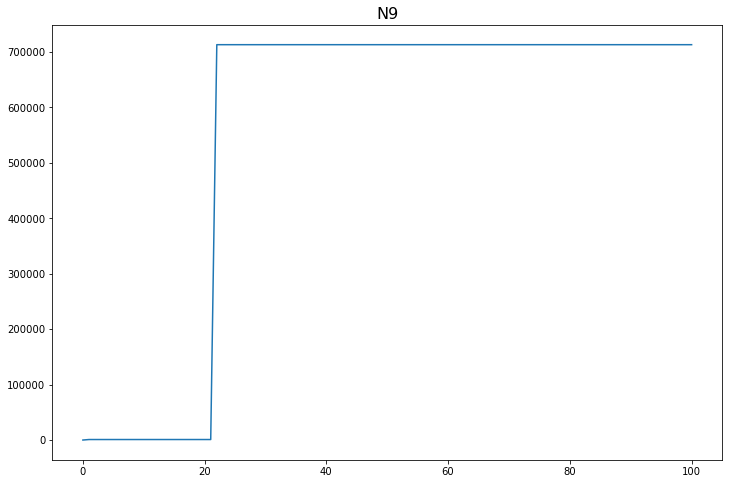

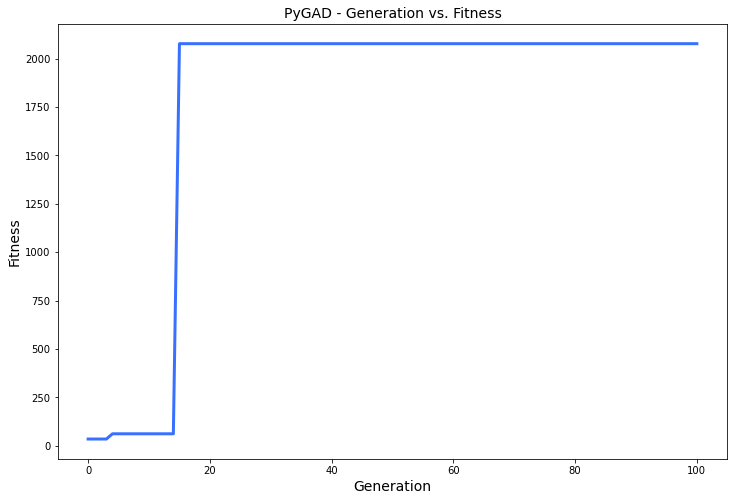

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.244 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 24.231 |==================| 2.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.137 |===========| 24.778 |==================| 1.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 22.773 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 22.572 |==================| 0.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 24.015 |==================| 6.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 24.668 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 28.722 |==================| 3.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 27.807 |==================| 1.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.97 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.169 |==================| 3.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.624 |==================| 5.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.579 |==================| 6.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.775 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 27.807 |==================| 1.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.97 |==================| 1.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.169 |==================| 3.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.624 |==================| 5.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.579 |==================| 6.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.775 |==================| 1.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.728 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.579 |==================| 6.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 27.775 |==================| 1.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.728 |==================| 1.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 28.957 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.835 |==================| 2.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 28.672 |==================| 4.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.821 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================| 1.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.778 |==================| 1.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.58 |==================| 6.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.011 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.012 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.118 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 27.778 |==================| 1.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.58 |==================| 6.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.011 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 27.012 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.118 |==================| 3.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 26.932 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 28.878 |==================| 2.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 28.032 |==================| 2.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.277 |==================| 6.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.855 |==================| 2.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.853 |==================| 0.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.909 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.104 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.277 |==================| 6.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.855 |==================| 2.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.853 |==================| 0.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.909 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.104 |==================| 3.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.81 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.702 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.855 |==================| 2.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 26.853 |==================| 0.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.909 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 28.104 |==================| 3.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 26.81 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 28.702 |==================| 3.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 27.382 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.285 |==================| 7.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.609 |==================| 5.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.97 |==================| 1.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 27.037 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.845 |==================| 2.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.0 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.363 |===========| 28.609 |==================| 5.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.97 |==================| 1.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 27.037 |==================| 0.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.845 |==================| 2.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.899 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 28.0 |==================| 2.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.952 |===========| 27.701 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.822 |==================| 2.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.916 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.522 |==================| 10.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 27.098 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.578 |==================| 1.18 |==========
Generation = 5
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.62 |==================| 0.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.787 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.916 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.522 |==================| 10.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 27.098 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.578 |==================| 1.18 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.62 |==================| 0.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.787 |==================| 2.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 28.828 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 27.578 |==================| 1.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.744 |==================| 3.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 27.054 |==================| 0.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.557 |==================| 7.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.918 |==================| 2.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 27.646 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.034 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 27.054 |==================| 0.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.557 |==================| 7.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.918 |==================| 2.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 27.646 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.034 |==================| 0.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 27.094 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 27.429 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.034 |==================| 0.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 27.094 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 27.429 |==================| 1.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 27.995 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.714 |==================| 0.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.662 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.834 |==================| 0.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.903 |==================| 2.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.389 |==================| 26.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.14 |==================| 3.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.934 |==================| 2.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.868 |==================| 2.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.947 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 27.934 |==================| 2.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.868 |==================| 2.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.947 |==================| 1.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.897 |==================| 2.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.965 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.41 |===========| 26.806 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.819 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 27.671 |==================| 1.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 27.359 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.459 |==================| 30.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.847 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.214 |==================| 4.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.979 |==================| 1.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.956 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 27.359 |==================| 0.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.459 |==================| 30.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.847 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.214 |==================| 4.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.979 |==================| 1.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.956 |==================| 0.68 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 27.667 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.459 |==================| 30.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 27.847 |==================| 1.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.214 |==================| 4.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.979 |==================| 1.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.956 |==================| 0.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.582 |==================| 6.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 27.524 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 27.015 |==================| 0.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.659 |==================| 1.303 |==========
Fitness = 107.87579120261688
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.582 |==================| 6.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 27.524 |==================| 1.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.487 |==================| 16.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 27.469 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 27.524 |==================| 1.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.487 |==================| 16.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 27.469 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 28.989 |==================| 1.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.495 |==================| 14.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.9 |==================| 2.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.963 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.445 |==================| 51.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.743 |==================| 3.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.789 |==================| 2.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.563 |==================| 7.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 27.889 |==================| 1.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.814 |==================| 0.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.759 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 27.889 |==================| 1.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.814 |==================| 0.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.759 |==================| 1.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 26.974 |==================| 0.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.919 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.974 |==================| 1.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 27.945 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.686 |==================| 3.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 27.026 |==================| 0.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 27.1 |==================| 0.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 28.916 |==================| 2.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.741 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.923 |==================| 2.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.741 |==================| 3.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.923 |==================| 2.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================| 16.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.302 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 28.527 |==================| 9.875 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.767 |==================| 2.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 27.252 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================| 16.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.302 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 28.527 |==================| 9.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.505 |===========| 26.603 |==================| 0.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.675 |==================| 4.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.449 |==================| 44.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.691 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.675 |==================| 4.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.449 |==================| 44.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.691 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.392 |==================| 29.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 27.654 |==================| 1.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 27.11 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.945 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.691 |==================| 3.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.392 |==================| 29.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 27.654 |==================| 1.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 27.11 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.945 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 27.374 |==================| 0.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.324 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 28.233 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.847 |==================| 2.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.784 |==================| 2.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.811 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.999 |==================| 1.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.149 |==================| 3.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 27.129 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.847 |==================| 2.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.217 |===========| 28.784 |==================| 2.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.811 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.999 |==================| 1.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.149 |==================| 3.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 27.129 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.933 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.637 |==================| 4.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.997 |==================| 1.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.402 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.838 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.622 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.106 |==================| 3.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.817 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.997 |==================| 1.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.113 |===========| 27.402 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.838 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.622 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.106 |==================| 3.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.817 |==================| 0.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.433 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.622 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 28.106 |==================| 3.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.404 |===========| 26.817 |==================| 0.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.433 |==================| 141.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 27.23 |==================| 0.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 28.528 |==================| 9.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.491 |==================| 15.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.812 |==================| 2.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.425 |==================| 701.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.769 |==================| 2.919 |==========
Fitness = 701.1825245351756
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |==================| 2.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.597 |==================| 5.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.425 |==================| 701.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.769 |==================| 2.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |==================| 2.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 28.597 |==================| 5.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 27.835 |==================| 1.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 28.397 |==================| 34.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 27.151 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.072 |==================| 2.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.91 |==================| 1.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 26.802 |==================| 0.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.547 |==================| 8.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.474 |==================| 20.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.917 |==================| 1.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 27.699 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.474 |==================| 20.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.917 |==================| 1.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 27.699 |==================| 1.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 27.777 |==================| 1.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.803 |==================| 2.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 27.777 |==================| 1.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 26.726 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.856 |==================| 2.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.772 |==================| 2.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.773 |==================| 2.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.841 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 28.895 |==================| 2.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 27.831 |==================| 1.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.772 |==================| 2.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.773 |==================| 2.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.841 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 28.895 |==================| 2.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 27.831 |==================| 1.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 27.13 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 27.831 |==================| 1.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.251 |===========| 27.13 |==================| 0.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 28.728 |==================| 3.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.063 |==================| 2.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.264 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 27.484 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.62 |==================| 5.169 |==========
Fitness = 701.182524538669
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.264 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 27.484 |==================| 1.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 27.818 |==================| 1.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.086 |==================| 2.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 27.212 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 27.484 |==================| 1.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 27.818 |==================| 1.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 28.086 |==================| 2.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 27.212 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.443 |==================| 60.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.845 |==================| 2.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.735 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 27.192 |==================| 0.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.714 |==================| 3.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 27.167 |==================| 0.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.522 |==================| 10.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.732 |==================| 3.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 27.97 |==================| 2.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 27.645 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.714 |==================| 3.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 27.167 |==================| 0.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.522 |==================| 10.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.732 |==================| 3.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 27.97 |==================| 2.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 27.645 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.659 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 27.857 |==================| 1.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 28.368 |==================| 17.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.839 |==================| 2.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.117 |==================| 3.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 27.47 |==================| 1.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.706 |===========| 28.117 |==================| 3.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 27.47 |==================| 1.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 27.142 |==================| 0.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.889 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 26.618 |==================| 0.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.857 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.889 |==================| 2.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.498 |===========| 26.618 |==================| 0.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 28.857 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 28.953 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 28.466 |==================| 24.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.154 |===========| 27.324 |==================| 0.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 27.715 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 28.844 |==================| 2.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 28.148 |==================| 3.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.32 |==================| 0.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.474 |==================| 21.031 |==========
Fitness = 701.182524538669
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.709 |==================| 0.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 27.334 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 27.32 |==================| 0.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.474 |==================| 21.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 26.709 |==================| 0.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 27.334 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.684 |==================| 3.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.867 |==================| 2.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.909 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.862 |==================| 2.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.498 |==================| 13.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 27.523 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.625 |==================| 5.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 27.007 |==================| 0.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.806 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.498 |==================| 13.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 27.523 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 27.608 |==================| 1.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.625 |==================| 5.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.313 |===========| 27.007 |==================| 0.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.806 |==================| 2.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.732 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.18 |==================| 4.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 28.227 |==================| 5.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.133 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.988 |==================| 2.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.698 |==================| 3.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.932 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 28.227 |==================| 5.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.133 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.988 |==================| 2.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.698 |==================| 3.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.932 |==================| 1.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.47 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 28.133 |==================| 3.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 27.988 |==================| 2.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.698 |==================| 3.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.86 |==================| 2.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.932 |==================| 1.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.47 |==================| 22.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.039 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 27.107 |==================| 0.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.591 |==================| 6.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.511 |==================| 11.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 27.614 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.614 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 27.083 |==================| 0.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.818 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 28.591 |==================| 6.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 28.511 |==================| 11.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 27.614 |==================| 1.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.614 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 27.083 |==================| 0.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.818 |==================| 2.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 26.963 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.499 |==================| 13.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 27.032 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 26.755 |==================| 0.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 28.04 |==================| 2.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 27.111 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.473 |==================| 21.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.889 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 27.111 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.473 |==================| 21.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.889 |==================| 2.161 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 27.819 |==================| 1.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.634 |==================| 4.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.533 |==================| 9.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.69 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 28.473 |==================| 21.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.889 |==================| 2.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 27.262 |==================| 0.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.721 |==================| 3.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.153 |==================| 3.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 27.047 |==================| 0.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.535 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.721 |==================| 3.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.153 |==================| 3.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 27.047 |==================| 0.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.535 |==================| 9.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.06 |==================| 0.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.819 |==================| 2.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.575 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.153 |==================| 3.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 27.047 |==================| 0.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.535 |==================| 9.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 27.06 |==================| 0.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.819 |==================| 2.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.575 |==================| 6.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.753 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.598 |==================| 5.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 27.358 |==================| 0.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.921 |==================| 2.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.55 |==================| 8.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.098 |==================| 3.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.182 |==================| 4.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.068 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.921 |==================| 2.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 28.55 |==================| 8.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.098 |==================| 3.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.182 |==================| 4.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.068 |==================| 2.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.022 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 28.146 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 27.616 |==================| 1.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 28.526 |==================| 9.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 27.123 |==================| 0.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 26.988 |==================| 0.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.833 |==================| 2.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.763 |==================| 2.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 28.279 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.833 |==================| 2.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.763 |==================| 2.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 28.279 |==================| 6.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.908 |==================| 1.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.169 |==================| 3.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.922 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.763 |==================| 2.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 28.279 |==================| 6.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 27.908 |==================| 1.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 28.169 |==================| 3.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.922 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.542 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.051 |===========| 28.954 |==================| 1.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.114 |==================| 3.201 |==========
Fitness = 701.182524538669
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.121 |==================| 3.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 27.899 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.232 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 28.968 |==================| 1.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 28.114 |==================| 3.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.121 |==================| 3.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 27.899 |==================| 1.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.232 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.149 |===========| 27.332 |==================| 0.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 26.92 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 28.438 |==================| 82.942 |==========
Generation = 30
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.897 |==================| 2.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.509 |==================| 12.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 27.145 |==================| 0.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.635 |==================| 4.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 27.573 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.897 |==================| 2.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.509 |==================| 12.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 27.145 |==================| 0.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.635 |==================| 4.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 27.573 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |==================| 7.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.616 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 26.722 |==================| 0.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 27.233 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.856 |==================| 2.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.843 |==================| 2.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.935 |==================| 1.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.651 |==================| 4.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.937 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.856 |==================| 2.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.843 |==================| 2.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 28.935 |==================| 1.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.651 |==================| 4.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.937 |==================| 1.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.707 |==================| 3.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.512 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.937 |==================| 1.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.707 |==================| 3.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 28.512 |==================| 11.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.678 |==================| 1.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.638 |==================| 4.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 27.573 |==================| 1.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.637 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 27.63 |==================| 1.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 28.864 |==================| 2.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.778 |==================| 2.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.769 |==================| 2.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.618 |==================| 5.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.471 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.618 |==================| 5.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.471 |==================| 22.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.932 |==================| 1.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 28.403 |==================| 42.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.037 |===========| 27.545 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 28.683 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 27.757 |==================| 1.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 26.944 |==================| 0.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.32 |==================| 9.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.983 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 28.194 |==================| 4.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.47 |==================| 22.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.955 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.657 |===========| 28.194 |==================| 4.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.47 |==================| 22.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.955 |==================| 0.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.943 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.886 |==================| 2.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 28.827 |==================| 2.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.069 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.99 |==================| 1.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.924 |==================| 2.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.936 |==================| 1.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 28.162 |==================| 3.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.543 |==================| 8.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.953 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.857 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 28.162 |==================| 3.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.543 |==================| 8.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.953 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.857 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.895 |==================| 2.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.547 |==================| 8.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.835 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.543 |==================| 8.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.953 |==================| 0.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 28.857 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.895 |==================| 2.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.547 |==================| 8.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.835 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.394 |===========| 26.838 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.946 |==================| 1.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.696 |==================| 3.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 27.812 |==================| 1.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.859 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.452 |==================| 38.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 27.029 |==================| 0.716 |==========
Fitness = 701.182524538669
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.859 |==================| 2.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.452 |==================| 38.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 27.029 |==================| 0.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 28.389 |==================| 27.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 28.331 |==================| 10.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 27.13 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 27.289 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 27.927 |==================| 2.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.985 |==================| 1.788 |==========
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.176 |==================| 3.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.913 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.717 |==================| 3.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.153 |==================| 3.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.122 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.669 |===========| 28.176 |==================| 3.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.913 |==================| 0.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 28.717 |==================| 3.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.153 |==================| 3.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.122 |==================| 3.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 27.709 |==================| 1.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 26.797 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.622 |==================| 0.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.224 |==================| 4.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 28.5 |==================| 13.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.92 |==================| 0.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.935 |==================| 1.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.98 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.875 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.92 |==================| 0.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.935 |==================| 1.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.98 |==================| 1.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.875 |==================| 2.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 27.214 |==================| 0.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.137 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 27.742 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.875 |==================| 2.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 27.214 |==================| 0.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 27.137 |==================| 0.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.929 |===========| 27.742 |==================| 1.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 27.819 |==================| 1.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 28.527 |==================| 9.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.507 |===========| 28.417 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 28.885 |==================| 2.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 28.966 |==================| 1.851 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.007 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.996 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.57 |==================| 6.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.935 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 27.098 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 28.007 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.996 |==================| 1.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 28.57 |==================| 6.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.935 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 27.098 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 27.711 |==================| 1.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 28.68 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.154 |==================| 3.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 27.25 |==================| 0.85 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 27.086 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.485 |==================| 16.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.184 |==================| 4.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.658 |==================| 4.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 27.523 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 27.25 |==================| 0.85 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 27.086 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.485 |==================| 16.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.184 |==================| 4.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.658 |==================| 4.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.049 |===========| 27.523 |==================| 1.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.13 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.724 |==================| 3.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.781 |==================| 2.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.535 |==================| 9.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.265 |==================| 0.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.039 |==================| 2.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.923 |==================| 2.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.563 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 28.535 |==================| 9.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 27.265 |==================| 0.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 28.039 |==================| 2.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 28.923 |==================| 2.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.563 |==================| 7.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 27.294 |==================| 0.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.563 |==================| 7.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 27.294 |==================| 0.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.725 |==================| 3.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 27.483 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.764 |==================| 2.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.957 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 27.013 |==================| 0.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.976 |==================| 1.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.253 |==================| 5.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.904 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 27.159 |==================| 0.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.899 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.976 |==================| 1.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |==================| 2.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.253 |==================| 5.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.904 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 27.159 |==================| 0.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.899 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 28.9 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.69 |==================| 3.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.729 |==================| 3.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.84 |==================| 2.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 27.727 |==================| 1.431 |==========
Generation = 42
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 27.255 |==================| 0.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 27.687 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.71 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 27.255 |==================| 0.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.96 |===========| 27.687 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.71 |==================| 3.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 28.566 |==================| 7.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.872 |==================| 2.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.945 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.644 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.532 |==================| 9.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.943 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.996 |==================| 1.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 28.494 |==================| 14.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.554 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.564 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.943 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.996 |==================| 1.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 28.494 |==================| 14.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.554 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.564 |==================| 7.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.43 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 27.554 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.564 |==================| 7.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 28.43 |==================| 272.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 28.619 |==================| 5.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 27.139 |==================| 0.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.515 |==================| 11.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.541 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 27.981 |==================| 2.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 26.78 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.437 |===========| 26.747 |==================| 0.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.576 |==================| 6.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.445 |==================| 52.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.488 |==================| 16.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 26.857 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.445 |==================| 52.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.488 |==================| 16.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.385 |===========| 26.857 |==================| 0.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.712 |==================| 3.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.918 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 28.361 |==================| 15.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 27.417 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.611 |==================| 5.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.253 |===========| 28.743 |==================| 3.151 |==========
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.851 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.555 |==================| 7.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.498 |==================| 13.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.208 |==================| 0.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.658 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.498 |==================| 13.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.208 |==================| 0.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.658 |==================| 1.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.461 |==================| 28.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 27.313 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.863 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 27.556 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.932 |==================| 1.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.557 |==================| 7.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 27.036 |==================| 0.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.815 |==================| 2.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.764 |==================| 2.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.828 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 27.036 |==================| 0.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.815 |==================| 2.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.764 |==================| 2.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.828 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.434 |==================| 125.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.718 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.764 |==================| 2.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.828 |==================| 1.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.434 |==================| 125.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.718 |==================| 3.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.565 |===========| 28.333 |==================| 10.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.772 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.381 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 27.067 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 28.394 |==================| 30.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 27.335 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 27.913 |==================| 1.949 |==========
Fitness = 701.182524538669
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.46 |==================| 29.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.811 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 28.394 |==================| 30.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 27.335 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 27.913 |==================| 1.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.46 |==================| 29.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.811 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.614 |==================| 5.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 27.362 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 28.141 |==================| 3.51 |==========
Generation = 48
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.13 |==================| 3.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.782 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.996 |==================| 1.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.733 |==================| 3.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.676 |==================| 3.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 27.94 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.782 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.996 |==================| 1.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.733 |==================| 3.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.676 |==================| 3.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 27.94 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 27.316 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.162 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.762 |==================| 2.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.587 |==================| 6.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 27.191 |==================| 0.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.799 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.984 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.807 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.651 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 28.587 |==================| 6.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 27.191 |==================| 0.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.799 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.984 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.807 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.651 |==================| 4.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.95 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 27.191 |==================| 0.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.799 |==================| 2.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.984 |==================| 1.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.807 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.651 |==================| 4.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.95 |==================| 1.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 28.979 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 27.489 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.666 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 27.365 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.873 |==================| 2.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.61 |==================| 5.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.996 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.879 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 27.666 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 27.365 |==================| 0.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.873 |==================| 2.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 28.61 |==================| 5.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.996 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.879 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.992 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.97 |==================| 1.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.739 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 27.204 |==================| 0.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.479 |==================| 19.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.029 |==================| 2.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.678 |==================| 1.337 |==========
Generation = 51
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.732 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.479 |==================| 19.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.029 |==================| 2.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 27.678 |==================| 1.337 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.732 |==================| 3.274 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 27.415 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 28.792 |==================| 2.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 27.895 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.24 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.679 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.791 |==================| 2.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.955 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 27.603 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 27.926 |==================| 2.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.642 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.679 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 28.791 |==================| 2.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.805 |===========| 27.955 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 27.603 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 27.926 |==================| 2.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.642 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 28.296 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 27.603 |==================| 1.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 27.926 |==================| 2.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.642 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.59 |===========| 28.296 |==================| 7.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.49 |==================| 15.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.865 |==================| 2.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.841 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 27.698 |==================| 1.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.972 |==================| 1.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.829 |==================| 2.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 28.883 |==================| 2.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.875 |==================| 2.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 27.393 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.991 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.875 |==================| 2.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.118 |===========| 27.393 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 28.991 |==================| 1.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.499 |==================| 13.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.524 |==================| 10.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.953 |===========| 27.698 |==================| 1.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 27.201 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.035 |==================| 0.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.302 |==================| 0.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.532 |==================| 9.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 28.386 |==================| 24.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.432 |==================| 165.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.537 |==================| 9.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.423 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.302 |==================| 0.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 28.532 |==================| 9.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 28.386 |==================| 24.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.432 |==================| 165.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.537 |==================| 9.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.423 |==================| 358.405 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.606

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.432 |==================| 165.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.537 |==================| 9.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.423 |==================| 358.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 27.265 |==================| 0.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.703 |==================| 3.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.952 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 27.127 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.703 |==================| 3.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 26.952 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 27.127 |==================| 0.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 27.419 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.685 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.547 |==================| 8.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.278 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.685 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.547 |==================| 8.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.278 |==================| 6.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 27.874 |==================| 1.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 26.616 |==================| 0.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.567 |==================| 7.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.929 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.662 |==================| 4.233 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.921 |===========| 27.756 |==================| 1.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 27.303 |==================| 0.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 27.372 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.624 |==================| 5.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 27.027 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.639 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 28.624 |==================| 5.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 27.027 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 26.639 |==================| 0.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.005 |==================| 2.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 28.928 |==================| 1.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.771 |==================| 2.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.598 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 27.385 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.637 |==================| 4.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.962 |==================| 1.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.761 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.973 |==================| 1.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================| 16.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.746 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 28.761 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.973 |==================| 1.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================| 16.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.746 |==================| 3.129 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 28.12 |==================| 3.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.958 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.788 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 28.973 |==================| 1.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================| 16.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.746 |==================| 3.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 28.327 |==================| 10.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.828 |==================| 0.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.936 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.293 |==================| 7.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 28.578 |==================| 6.575 |==========
Fitness = 701.182524538669
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 28.327 |==================| 10.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 26.828 |==================| 0.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.936 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 26.936 |==================| 0.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.577 |==================| 6.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 28.919 |==================| 2.028 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.707 |==================| 0.582 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.485 |==================| 17.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.457 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 28.697 |==================| 3.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 26.626 |==================| 0.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.649 |==================| 0.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 27.002 |==================| 0.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.468 |==================| 23.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.158 |==================| 3.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.375 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.649 |==================| 0.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 27.002 |==================| 0.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 28.468 |==================| 23.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.158 |==================| 3.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.375 |==================| 19.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 26.903 |==================| 0.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.745 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 28.806 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.232 |==================| 5.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.971 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.951 |==================| 1.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.714 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.301 |==================| 0.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 27.959 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.714 |==================| 3.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.301 |==================| 0.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 27.959 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.755 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.88 |==================| 0.647 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 27.732 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.165 |===========| 27.301 |==================| 0.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 27.959 |==================| 2.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.755 |==================| 3.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 26.88 |==================| 0.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.663 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.413 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.803 |===========| 27.959 |==================| 2.142 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 26.868 |==================| 0.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.683 |==================| 0.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 28.546 |==================| 8.359 |==========
Fitness = 701.182524538669
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.663 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.413 |==================| 77.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 27.663 |==================| 1.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 28.413 |==================| 77.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 28.432 |==================| 164.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.769 |==================| 2.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 27.347 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.635 |==================| 4.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 26.742 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 28.789 |==================| 2.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.698 |==================| 3.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.9 |==================| 2.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.485 |==================| 17.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 27.094 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.193 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.015 |==================| 2.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 28.698 |==================| 3.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.9 |==================| 2.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.485 |==================| 17.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 27.094 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 28.193 |==================| 4.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 27.022 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.66 |==================| 0.566 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.016 |==================| 2.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 27.021 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.406 |==================| 49.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.913 |==================| 2.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 27.469 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.666 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.016 |==================| 2.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 27.021 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.406 |==================| 49.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.913 |==================| 2.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 27.469 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.666 |==================| 4.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.797 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 27.021 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 28.406 |==================| 49.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.913 |==================| 2.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 27.469 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.666 |==================| 4.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.797 |==================| 2.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 27.645 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.47 |==================| 23.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.801 |===========| 27.961 |==================| 2.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 28.883 |==================| 2.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.664 |==================| 4.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.576 |==================| 6.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 27.525 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 28.664 |==================| 4.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.576 |==================| 6.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 27.525 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 28.559 |==================| 7.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 28.328 |==================| 10.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 27.939 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.665 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.74 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 28.355 |==================| 14.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 27.168 |==================| 0.795 |==========
Generation = 65
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 27.202 |==================| 0.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.798 |==================| 2.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.33 |==================| 10.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 28.824 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 28.355 |==================| 14.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 27.168 |==================| 0.795 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.215 |===========| 27.202 |==================| 0.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.798 |==================| 2.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 28.33 |==================| 10.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 28.824 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.796 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.649 |==================| 4.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 28.996 |==================| 1.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.595 |==================| 5.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 26.973 |==================| 0.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |==================| 7.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 28.553 |==================| 7.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 27.372 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 26.973 |==================| 0.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |==================| 7.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 28.553 |==================| 7.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 27.372 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.706 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.555 |==================| 7.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.562 |==================| 7.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 28.553 |==================| 7.861 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 27.372 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.706 |==================| 1.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 28.555 |==================| 7.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 1.869 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 27.474 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.649 |==================| 0.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 28.961 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.877 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 27.117 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.772 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.77 |==================| 2.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.849 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.375 |===========| 26.877 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 27.117 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.772 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.77 |==================| 2.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.849 |==================| 2.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.299 |===========| 27.034 |==================| 0.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.802 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.998 |==================| 1.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 27.019 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 27.08 |==================| 0.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.12 |==================| 0.766 |==========
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.976 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.659 |==================| 4.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.632 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.307 |===========| 27.019 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 27.08 |==================| 0.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 27.12 |==================| 0.766 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.328 |===========| 26.976 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 28.659 |==================| 4.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.632 |==================| 4.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.044 |===========| 27.532 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.058 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================| 16.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.471 |==================| 22.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 27.19 |==================| 0.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.504 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.486 |==================| 16.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.471 |==================| 22.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 27.19 |==================| 0.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.504 |==================| 12.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 27.688 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.927 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.504 |==================| 12.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 27.688 |==================| 1.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.499 |==================| 13.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 27.483 |==================| 1.06 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.646 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.903 |==================| 2.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.427 |==================| 749.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 27.153 |==================| 0.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.651 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.744 |==================| 1.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.71 |==================| 3.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.223 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.427 |==================| 749.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 27.153 |==================| 0.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.651 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 27.744 |==================| 1.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.71 |==================| 3.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.223 |==================| 4.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 27.872 |==================| 1.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 28.914 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 27.87 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.593 |==================| 6.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.509 |==================| 12.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.542 |==================| 8.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.443 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.509 |==================| 12.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 28.542 |==================| 8.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 27.443 |==================| 1.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.254 |==================| 5.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.487 |==================| 16.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.962 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.63 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.254 |==================| 5.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 28.487 |==================| 16.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.962 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.63 |==================| 4.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 27.918 |==================| 1.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 27.61 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 27.11 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.52 |==================| 10.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.941 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 27.771 |==================| 1.527 |==========
Fitness = 749.2414468722069
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 27.918 |==================| 1.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 27.61 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 27.11 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.941 |==================| 1.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 27.771 |==================| 1.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 27.918 |==================| 1.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 27.61 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 27.11 |==================| 0.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 27.197 |==================| 0.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.495 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 28.628 |==================| 4.96 |==========
Generation = 73
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.696 |==================| 3.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 27.888 |==================| 1.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.902 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.532 |==================| 9.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.544 |==================| 8.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.589 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.696 |==================| 3.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.845 |===========| 27.888 |==================| 1.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 28.902 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.532 |==================| 9.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.544 |==================| 8.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.589 |==================| 6.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 26.66 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 28.495 |==================| 14.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.446 |==================| 50.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.77 |==================| 2.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.945 |==================| 1.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.163 |==================| 3.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.812 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.997 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.77 |==================| 2.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.945 |==================| 1.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 28.163 |==================| 3.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.812 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.997 |==================| 2.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.869 |==================| 1.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.593 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.997 |==================| 2.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 27.869 |==================| 1.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.593 |==================| 5.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 28.497 |==================| 14.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.882 |==================| 2.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 27.863 |==================| 1.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 27.256 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.959 |==================| 1.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.499 |==================| 13.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.939 |==================| 1.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.286 |==================| 7.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.84 |==================| 2.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.846 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.997 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.84 |==================| 2.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 26.846 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.997 |==================| 2.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 28.843 |==================| 2.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 26.946 |==================| 0.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 27.349 |==================| 0.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.867 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 26.922 |==================| 0.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.746 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 28.705 |==================| 3.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 27.636 |==================| 1.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 28.896 |==================| 2.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.72 |==================| 3.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.005 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 28.896 |==================| 2.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.72 |==================| 3.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 28.005 |==================| 2.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.034 |==================| 2.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 27.987 |==================| 2.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 26.911 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 27.728 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 27.24 |==================| 0.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 27.149 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.488 |==================| 16.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.808 |==================| 1.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.384 |==================| 0.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 27.802 |==================| 1.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 28.656 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.242 |===========| 27.149 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.488 |==================| 16.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 27.808 |==================| 1.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.384 |==================| 0.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 27.802 |==================| 1.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 28.656 |==================| 4.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.762 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.384 |==================| 0.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 27.802 |==================| 1.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.326 |===========| 28.656 |==================| 4.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.762 |==================| 2.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.297 |==================| 7.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.505 |==================| 12.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 26.83 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.855 |==================| 2.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.938 |==================| 1.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 27.172 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 27.446 |==================| 1.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.808 |==================| 2.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.899 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 27.971 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.938 |==================| 1.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 27.172 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 27.446 |==================| 1.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.808 |==================| 2.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.899 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 27.971 |==================| 2.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 28.982 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.429 |===========| 26.763 |==================| 0.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 28.948 |==================| 1.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.525 |==================| 10.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 28.969 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.727 |==================| 3.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.837 |==================| 2.433 |==========
Generation = 79
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.027 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.727 |==================| 3.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.837 |==================| 2.433 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 28.027 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.917 |==================| 1.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.918 |==================| 2.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.797 |==================| 2.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 28.509 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.837 |==================| 2.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.802 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 28.584 |==================| 6.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.931 |==================| 1.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.08 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.66 |==================| 4.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.823 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 28.08 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 28.66 |==================| 4.283 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.823 |==================| 2.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.438 |==================| 86.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.827 |==================| 1.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.291 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 28.823 |==================| 2.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.942 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.438 |==================| 86.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.88 |===========| 27.827 |==================| 1.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.594 |===========| 28.291 |==================| 7.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.56 |==================| 7.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.703 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.897 |==================| 2.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 27.739 |==================| 1.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 27.224 |==================| 0.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.909 |==================| 2.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.788 |==================| 2.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 27.019 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.788 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 27.224 |==================| 0.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.909 |==================| 2.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.788 |==================| 2.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 27.019 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.788 |==================| 2.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 26.83 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.912 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 28.301 |==================| 7.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.241 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.731 |==================| 3.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.998 |==================| 1.747 |==========
Generation = 82
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.854 |==================| 2.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 27.472 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.973 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.241 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.731 |==================| 3.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.998 |==================| 1.747 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.854 |==================| 2.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 27.472 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.973 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.474 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.93 |==================| 1.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 27.538 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.898 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 27.762 |==================| 1.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.951 |==================| 1.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.583 |==================| 6.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 27.538 |==================| 1.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 26.898 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.917 |===========| 27.762 |==================| 1.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.951 |==================| 1.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================| 2.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.855 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.951 |==================| 1.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.834 |==================| 2.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.855 |==================| 2.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 28.687 |==================| 3.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.89 |==================| 2.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 28.418 |==================| 125.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.945 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 28.8 |==================| 2.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 26.84 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.972 |==================| 1.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 27.604 |==================| 1.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.427 |==================| 1600.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 28.441 |==================| 64.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.5 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 27.604 |==================| 1.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 28.427 |==================| 1600.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 28.441 |==================| 64.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.5 |==================| 13.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 27.256 |==================| 0.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 28.568 |==================| 7.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 27.386 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.691 |==================| 3.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 27.759 |==================| 1.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.923 |==================| 0.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.985 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 28.357 |==================| 14.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.937 |==================| 1.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.582 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.985 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 28.357 |==================| 14.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.937 |==================| 1.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.582 |==================| 6.396 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 26.947 |==================| 0.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.977 |==================| 1.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.628 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.937 |==================| 1.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.582 |==================| 6.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.447 |==================| 47.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 28.22 |==================| 4.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.629 |==================| 4.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.062 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.629 |==================| 4.928 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 28.062 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 27.387 |==================| 0.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.863 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.859 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.803 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.678 |==================| 3.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 27.387 |==================| 0.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.863 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.859 |==================| 2.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.803 |==================| 2.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.438 |==================| 85.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.529 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 27.373 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 27.434 |==================| 1.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.099 |==================| 3.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 27.227 |==================| 0.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.916 |==================| 1.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.326 |==================| 9.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.441 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 27.434 |==================| 1.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.099 |==================| 3.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 27.227 |==================| 0.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 27.916 |==================| 1.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.57 |===========| 28.326 |==================| 9.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.441 |==================| 69.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 27.208 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 27.505 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.82 |==================| 2.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.591 |==================| 6.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.556 |==================| 7.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.453 |==================| 37.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.787 |==================| 2.771 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 27.257 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.82 |==================| 2.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.591 |==================| 6.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.556 |==================| 7.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.453 |==================| 37.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.787 |==================| 2.771 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 27.257 |==================| 0.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.698 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 28.591 |==================| 6.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.556 |==================| 7.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 28.453 |==================| 37.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 28.787 |==================| 2.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.613 |==================| 5.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.872 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.739 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 28.436 |==================| 101.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 27.738 |==================| 1.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 28.733 |==================| 3.262 |==========
Fitness = 1600.128098263197
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.613 |==================| 5.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.872 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.739 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 28.613 |==================| 5.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.872 |==================| 2.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 26.739 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.448 |==================| 46.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.97 |==================| 1.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.654 |==================| 4.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.064 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.703 |==================| 3.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.423 |==================| 348.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.99 |==================| 1.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 27.966 |==================| 2.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.754 |==================| 3.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.308 |==================| 8.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.218 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.423 |==================| 348.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 28.99 |==================| 1.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 27.966 |==================| 2.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.754 |==================| 3.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.581 |===========| 28.308 |==================| 8.502 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.208 |===========| 27.218 |==================| 0.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 27.144 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 27.027 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.891 |==================| 2.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 26.773 |==================| 0.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.999 |==================| 2.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.159 |==================| 3.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.891 |==================| 2.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 26.773 |==================| 0.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 27.999 |==================| 2.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 28.159 |==================| 3.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.674 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 28.673 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 28.602 |==================| 5.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 28.674 |==================| 4.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 27.242 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.425 |==================| 826.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 28.981 |==================| 1.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.757 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 27.91 |==================| 1.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 26.689 |==================| 0.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.565 |==================| 7.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 28.604 |==================| 5.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 27.519 |==================| 1.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.233 |==================| 5.166 |==========
Fitness = 1600.128098263197
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 27.519 |==================| 1.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.233 |==================| 5.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.829 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 28.846 |==================| 2.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 28.92 |==================| 2.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 28.683 |==================| 3.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 28.488 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 28.913 |==================| 2.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 27.289 |==================| 0.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 27.347 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 28.972 |==================| 1.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.719 |==================| 3.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.385 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.321 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 28.719 |==================| 3.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 27.385 |==================| 0.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.321 |==================| 9.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 27.135 |==================| 0.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 28.204 |==================| 4.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 28.829 |==================| 2.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 26.976 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.816 |==================| 2.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.736 |==================| 3.227 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.754 |==================| 3.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.71 |==================| 3.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.892 |==================| 0.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.924 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.452 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.71 |==================| 3.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.892 |==================| 0.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.924 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.452 |==================| 39.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 27.497 |==================| 1.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.216 |==================| 4.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.859 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 26.892 |==================| 0.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.924 |==================| 2.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.452 |==================| 39.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 27.497 |==================| 1.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.216 |==================| 4.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.859 |==================| 2.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.788 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 28.351 |==================| 13.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.318 |==================| 9.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 27.474 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.706 |==================| 1.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.89 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.767 |==================| 2.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.793 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 28.318 |==================| 9.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 27.474 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 27.706 |==================| 1.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 26.89 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.767 |==================| 2.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.793 |==================| 0.612 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.586 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.498 |===========| 28.429 |==================| 373.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.744 |==================| 3.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.633 |==================| 4.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.471 |==================| 22.309 |==========
Generation = 96
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 27.414 |==================| 0.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.963 |==================| 1.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.88

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 28.744 |==================| 3.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.633 |==================| 4.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.471 |==================| 22.309 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 27.414 |==================| 0.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 28.963 |==================| 1.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 28.888 |==================| 2.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 27.81 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.633 |==================| 4.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 28.471 |==================| 22.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.992 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 27.657 |==================| 1.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.54 |==================| 8.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.881 |==================| 2.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.839 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.569 |===========| 28.327 |==================| 10.126 |==========
Fitness = 1600.128098263197
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 28.992 |==================| 1.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 27.657 |==================| 1.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.54 |==================| 8.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.881 |==================| 2.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.839 |==================| 2.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 28.54 |==================| 8.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.881 |==================| 2.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 28.839 |==================| 2.423 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 28.603 |==================| 5.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.996 |===========| 27.621 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 27.589 |==================| 1.195 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 27.852 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.696 |==================| 3.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 28.484 |==================| 17.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 27.296 |==================| 0.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.633 |==================| 4.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.81 |==================| 2.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 26.911 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 27.713 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.81 |==================| 2.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 26.911 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 27.713 |==================| 1.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 28.528 |==================| 9.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 27.368 |==================| 0.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.081 |==================| 2.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 27.557 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 27.058 |==================| 0.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.973 |==================| 1.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.449 |==================| 42.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.564 |==================| 7.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 27.428 |==================| 1.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.985 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.871 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 28.449 |==================| 42.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.564 |==================| 7.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 27.428 |==================| 1.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.985 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.871 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.147 |==================| 3.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.063 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.564 |==================| 7.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.099 |===========| 27.428 |==================| 1.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.985 |==================| 0.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 26.871 |==================| 0.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.147 |==================| 3.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 28.063 |==================| 2.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.658 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.849 |==================| 2.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.997 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.801 |==================| 2.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 27.477 |==================| 1.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.887 |==================| 2.169 |==========
Fitness = 1600.128098263197
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.658 |==================| 1.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 28.997 |==================| 1.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 28.801 |==================| 2.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 27.477 |==================| 1.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 28.887 |==================| 2.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.658 |==================| 1.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.935 |==================| 1.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 28.161 |=================

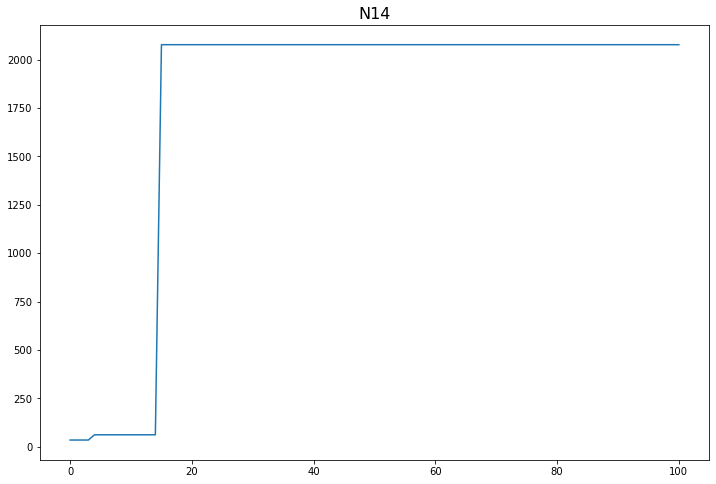

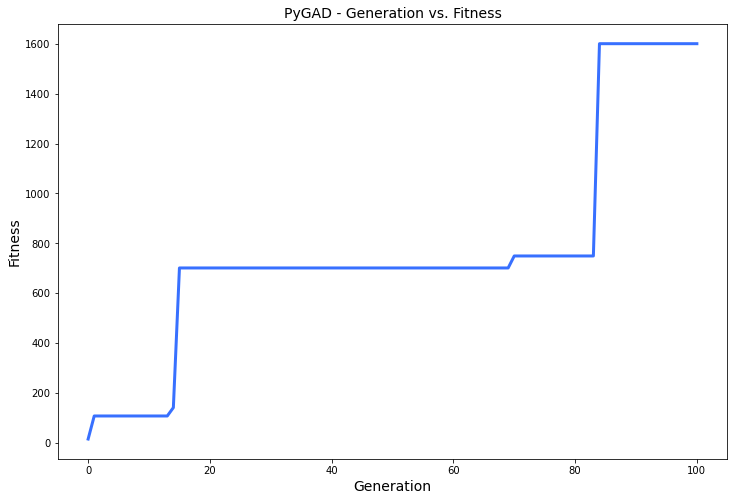

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 27.658 |==================| 1.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.935 |==================| 1.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 28.161 |==================| 3.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.771 |==================| 2.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.78 |===========| 27.996 |==================| 2.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.741 |==================| 3.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.436 |===========| 26.75 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.362 |==================| 27.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.713 |==================| 2.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.794 |==================| 2.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.625 |==================| 3.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.321 |==================| 209.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.519 |==================| 1.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 27.246 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.625 |==================| 3.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.321 |==================| 209.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.519 |==================| 1.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 27.246 |==================| 12.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.623 |==================| 3.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.213 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.805 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 27.321 |==================| 209.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.519 |==================| 1.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 27.246 |==================| 12.641 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.623 |==================| 3.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.213 |==================| 0.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.805 |==================| 2.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 25.826 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.47 |==================| 6.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.649 |==================| 3.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 25.69 |==================| 0.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 27.283 |==================| 23.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.453 |==================| 7.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.359 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 27.453 |==================| 7.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.584 |==================| 3.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.359 |==================| 30.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 26.224 |==================| 0.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.725 |==================| 2.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 25.837 |==================| 0.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.712 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.984 |===========| 26.599 |==================| 1.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 27.077 |==================| 4.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.772 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 27.46 |==================| 7.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.277 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 25.746 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.784 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 26.277 |==================| 0.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.442 |===========| 25.746 |==================| 0.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 27.784 |==================| 2.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 25.695 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 26.125 |==================| 0.833 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 27.017 |==================| 3.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 25.634 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 26.125 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.067 |==================| 3.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.528 |==================| 1.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.613 |==================| 3.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.705 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.68 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.856 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.528 |==================| 1.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.613 |==================| 3.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.705 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.68 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.856 |==================| 2.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.104 |==================| 4.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.675 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.856 |==================| 2.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.104 |==================| 4.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 27.675 |==================| 2.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.58 |==================| 1.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.459 |===========| 25.711 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 25.634 |==================| 0.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.549 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.714 |==================| 2.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 27.38 |==================| 18.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 25.681 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 26.999 |==================| 3.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.766 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.443 |==================| 1.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.071 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 27.38 |==================| 18.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 25.681 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 26.999 |==================| 3.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.766 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.443 |==================| 1.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.071 |==================| 0.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.587 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.424 |==================| 10.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 26.78 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.062 |==================| 0.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 25.713 |==================| 0.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.648 |==================| 3.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.75 |==================| 2.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.612 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 26.78 |==================| 1.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.062 |==================| 0.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 25.713 |==================| 0.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.648 |==================| 3.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.75 |==================| 2.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.612 |==================| 3.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.738 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.062 |==================| 0.792 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.458 |===========| 25.713 |==================| 0.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.648 |==================| 3.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.75 |==================| 2.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 27.612 |==================| 3.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.738 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 26.083 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.894 |===========| 26.749 |==================| 1.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.595 |==================| 3.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.231 |==================| 10.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.073 |==================| 0.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.75 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.1 |==================| 0.816 |==========
Fitness = 209.54259245337425
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 27.75 |==================| 2.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.1 |==================| 0.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.713 |==================| 2.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.698 |==================| 2.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.43 |==================| 9.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.735 |==================| 2.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.485 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.533 |==================| 4.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.102 |==================| 4.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.585 |==================| 3.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.589 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.627 |==================| 3.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.722 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.806 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.102 |==================| 4.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.585 |==================| 3.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.589 |==================| 3.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.627 |==================| 3.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 27.722 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.806 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.933 |===========| 26.684 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 25.759 |==================| 0.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.364 |===========| 25.9 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.559 |==================| 1.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.753 |==================| 2.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.813 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.641 |==================| 3.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.232 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.559 |==================| 1.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.753 |==================| 2.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.813 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.641 |==================| 3.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.232 |==================| 10.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.138 |==================| 0.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.564 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 27.232 |==================| 10.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.138 |==================| 0.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.564 |==================| 4.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 27.062 |==================| 3.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.094 |===========| 26.407 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.668 |==================| 2.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.563 |===========| 27.243 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.508 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.068 |===========| 26.454 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 26.273 |==================| 0.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.826 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.711 |==================| 2.592 |==========
Fitness = 209.54259245337425
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.836 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 26.273 |==================| 0.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.826 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.711 |==================| 2.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.836 |==================| 1.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.519 |==================| 5.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 26.479 |==================| 1.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.007 |===========| 26.559 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.122 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 25.919 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |==================| 2.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 27.304 |==================| 46.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.096 |==================| 0.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 25.793 |==================| 0.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.723 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 25.919 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |==================| 2.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.517 |===========| 27.304 |==================| 46.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.096 |==================| 0.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 25.793 |==================| 0.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.723 |==================| 2.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 26.32 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.797 |==================| 2.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 27.212 |==================| 8.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 27.03 |==================| 3.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.53 |==================| 4.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.86 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 27.212 |==================| 8.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 27.03 |==================| 3.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 27.53 |==================| 4.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.86 |==================| 2.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 27.204 |==================| 8.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.444 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.86 |==================| 2.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 27.204 |==================| 8.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.444 |==================| 8.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.488 |==================| 6.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.312 |==================| 0.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.588 |==================| 1.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.993 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.392 |==================| 15.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.575 |==================| 1.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 27.2 |==================| 7.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.029 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.494 |==================| 5.941 |==========
Fitness = 209.54259245337425
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 25.786 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.494 |==================| 5.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.422 |===========| 25.786 |==================| 0.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 26.604 |==================| 1.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 27.255 |==================| 14.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.404 |==================| 12.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.828 |==================| 1.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 26.313 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 27.324 |==================| 537.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.6 |==================| 3.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 27.058 |==================| 3.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.323 |==================| 430.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.02 |==================| 3.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.806 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 27.304 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.02 |==================| 3.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.806 |==================| 2.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.516 |===========| 27.304 |==================| 47.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 27.185 |==================| 7.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.746 |==================| 2.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.018 |===========| 26.54 |==================| 1.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.733 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.306 |==================| 51.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.043 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.55 |==================| 4.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.753 |==================| 2.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.315 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.592 |==================| 3.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.485 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 26.043 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.55 |==================| 4.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 27.753 |==================| 2.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 26.315 |==================| 0.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.592 |==================| 3.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.485 |==================| 6.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.597 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.592 |==================| 3.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 27.485 |==================| 6.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.597 |==================| 3.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 26.185 |==================| 0.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 27.241 |==================| 11.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.579 |==================| 3.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 27.293 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.766 |==================| 2.268 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 25.68 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.749 |==================| 2.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.306 |==================| 51.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.983 |==================| 2.917 |==========
Fitness = 537.4340095734809
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.349 |==================| 42.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 25.68 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.749 |==================| 2.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.306 |==================| 51.464 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.983 |==================| 2.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.349 |==================| 42.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.356 |==================| 32.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 27.022 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.376 |==================| 19.955 |==========
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.531 |===========| 27.285 |==================| 24.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.377 |==================| 19.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.586 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.734 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.581 |==================| 3.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.377 |==================| 19.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.586 |==================| 1.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.734 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.581 |==================| 3.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |==================| 2.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.471 |==================| 6.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 25.658 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.498 |==================| 5.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 26.089 |==================| 0.809 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.385 |==================| 16.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.693 |==================| 2.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.987 |==================| 2.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.695 |==================| 2.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.717 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.385 |==================| 16.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.693 |==================| 2.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.987 |==================| 2.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 27.695 |==================| 2.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.717 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.544 |==================| 4.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.621 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.717 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 27.544 |==================| 4.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 27.621 |==================| 3.38 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.391 |==================| 15.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 25.921 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 26.137 |==================| 0.841 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.258 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.555 |==================| 4.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.532 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.838 |==================| 2.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.706 |==================| 1.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.782 |==================| 2.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.662 |==================| 1.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.086 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 27.532 |==================| 4.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.838 |==================| 2.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.706 |==================| 1.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.782 |==================| 2.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.662 |==================| 1.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.086 |==================| 4.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.211 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.597 |==================| 3.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.323 |==================| 350.447 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.425 |==================| 10.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 26.968 |==================| 2.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 25.634 |==================| 0.591 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.274 |==================| 19.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.022

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 25.634 |==================| 0.591 |==========
Change = 2249.481879307468
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.274 |==================| 19.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.022 |==================| 0.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 27.71 |==================| 2.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 27.434 |==================| 9.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 25.719 |==================| 0.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.58 |==================| 3.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 25.858 |==================| 0.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 27.525 |==================| 5.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 27.032 |==================| 3.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.975 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.642 |==================| 1.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.657 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.75 |===========| 26.975 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.958 |===========| 26.642 |==================| 1.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.657 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.546 |==================| 4.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.384 |==================| 17.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.805 |==================| 2.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.6 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.657 |==================| 1.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 27.546 |==================| 4.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 27.384 |==================| 17.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 27.805 |==================| 2.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.6 |==================| 1.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 26.543 |==================| 1.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.139 |===========| 26.326 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 26.072 |==================| 0.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.559 |==================| 4.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |==================| 6.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 27.024 |==================| 3.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.789 |==================| 1.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.813 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 26.35 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.559 |==================| 4.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |==================| 6.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 27.024 |==================| 3.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 26.789 |==================| 1.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.813 |==================| 2.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.126 |===========| 26.35 |==================| 1.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.574 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 27.835 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.927 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.463 |==================| 7.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 27.148 |==================| 5.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.579 |==================| 3.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.56 |==================| 4.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.655 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.927 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.463 |==================| 7.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 27.148 |==================| 5.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.579 |==================| 3.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.56 |==================| 4.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.655 |==================| 3.034 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.618 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.463 |==================| 7.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 27.148 |==================| 5.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.579 |==================| 3.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.56 |==================| 4.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.655 |==================| 3.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.398 |==================| 13.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.582 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.488 |==================| 6.165 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.398 |==================| 13.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.582 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 25.959 |==================| 0.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.56 |==================| 4.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.777 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.398 |==================| 13.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.582 |==================| 3.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 25.959 |==================| 0.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.56 |==================| 4.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.777 |==================| 2.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 26.547 |==================| 1.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.484 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.915 |==================| 2.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 27.39 |==================| 15.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.239 |==================| 11.558 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.454 |==================| 7.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.772 |==================| 2.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.691 |==================| 2.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 27.772 |==================| 2.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.691 |==================| 2.737 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.793 |==================| 2.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 27.123 |==================| 4.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.806 |==================| 2.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.443 |==================| 8.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 26.62 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.478 |==================| 6.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 26.045 |==================| 0.781 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 27.176 |==================| 6.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 25.94 |==================| 0.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 26.306 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.063 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.425 |==================| 10

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 26.306 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.063 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.425 |==================| 10.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 27.299 |==================| 37.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.608 |==================| 3.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.691 |===========| 27.063 |==================| 3.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.425 |==================| 10.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 27.299 |==================| 37.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.608 |==================| 3.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.372 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 27.081 |==================| 4.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.415 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 26.97 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.336 |==================| 96.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.592 |==================| 1.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.566 |==================| 4.161 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.415 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.754 |===========| 26.97 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.336 |==================| 96.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.592 |==================| 1.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.566 |==================| 4.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 26.815 |==================| 1.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.707 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.666 |==================| 2.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.598 |==================| 3.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 27.194 |==================| 7.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================| 2.727 |==========
Generation = 28
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.595 |==================| 1.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.45 |==================| 8.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.796 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 27.598 |==================| 3.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 27.194 |==================| 7.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================| 2.727 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.595 |==================| 1.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.45 |==================| 8.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 27.796 |==================| 2.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.495 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.656 |==================| 3.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 26.722 |==================| 1.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.849 |==================| 2.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.056 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.368 |==================| 23.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.638 |==================| 3.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.115 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.832 |===========| 26.849 |==================| 2.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 26.056 |==================| 0.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.368 |==================| 23.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.638 |==================| 3.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.115 |==================| 0.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.516 |==================| 5.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.429 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.638 |==================| 3.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.115 |==================| 0.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.516 |==================| 5.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.417 |===========| 27.429 |==================| 9.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 27.748 |==================| 2.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 27.069 |==================| 3.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 27.696 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.829 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.704 |==================| 2.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 27.007 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.82 |==================| 2.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.781 |==================| 2.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 27.229 |==================| 10.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.539 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.704 |==================| 2.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.729 |===========| 27.007 |==================| 3.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.82 |==================| 2.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.781 |==================| 2.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 27.229 |==================| 10.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.539 |==================| 4.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.27 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 26.1 |==================| 0.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.595 |==================| 3.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.841 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.471 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 25.646 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 25.698 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.471 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 25.646 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 25.698 |==================| 0.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.641 |==================| 3.171 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 25.789 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.589 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 26.471 |==================| 1.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 25.646 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 25.698 |==================| 0.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.641 |==================| 3.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 27.393 |==================| 14.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.168 |==================| 0.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 27.263 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.342 |===========| 25.944 |==================| 0.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.915 |==================| 2.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.828 |==================| 1.99 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 27.393 |==================| 14.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.168 |==================| 0.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 27.263 |==================| 15.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.915 |==================| 2.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.828 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 27.393 |==================| 14.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.168 |==================| 0.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 27.263 |==================| 15.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.888 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 27.734 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 25.876 |==================| 0.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 27.314 |==================| 83.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.68 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 26.216 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.64 |==================| 3.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.732 |==================| 2.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.516 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 27.314 |==================| 83.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 27.68 |==================| 2.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.199 |===========| 26.216 |==================| 0.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 27.64 |==================| 3.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.732 |==================| 2.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.516 |==================| 5.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 26.909 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.584 |===========| 27.214 |==================| 8.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 27.148 |==================| 5.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.72 |==================| 2.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.142 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.476 |==================| 6.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.142 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 25.951 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.72 |==================| 2.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.142 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 27.476 |==================| 6.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.142 |==================| 0.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 25.951 |==================| 0.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.871 |==================| 2.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 27.263 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 25.951 |==================| 0.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 26.871 |==================| 2.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.548 |===========| 27.263 |==================| 15.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 25.988 |==================| 0.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 27.297 |==================| 35.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.686 |===========| 27.07 |==================| 3.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |==================| 2.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.38 |==================| 1.057 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.428 |==================| 9.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.607 |==================| 3.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.172 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.428 |==================| 9.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.607 |==================| 3.552 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.222 |===========| 26.172 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.755 |===========| 26.967 |==================| 2.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.915 |==================| 2.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.331 |===========| 25.965 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.564 |==================| 1.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.388 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.51 |==================| 5.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 25.798 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.575 |==================| 1.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 25.667 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.388 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.51 |==================| 5.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 25.798 |==================| 0.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.575 |==================| 1.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 25.667 |==================| 0.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.156 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.499 |==================| 5.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 25.83 |==================| 0.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.228 |==================| 10.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.674 |==================| 2.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 25.808 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.459 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 25.83 |==================| 0.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.228 |==================| 10.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.674 |==================| 2.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 25.808 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.459 |==================| 7.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.595 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.228 |==================| 10.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 27.674 |==================| 2.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 25.808 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.459 |==================| 7.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.595 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.694 |==================| 2.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 25.651 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 27.496 |==================| 5.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.742 |==================| 2.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.95 |==================| 2.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.477 |==================| 6.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.376 |==================| 19.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 26.667 |==================| 1.518 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.477 |==================| 6.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.376 |==================| 19.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 26.667 |==================| 1.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.809 |==================| 2.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 26.886 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |==================| 4.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.695 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 26.302 |==================| 0.977 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 25.902 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 27.523 |==================| 5.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.456 |==================| 7.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.822 |==================| 2.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.811 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.822 |==================| 2.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 27.811 |==================| 2.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.608 |==================| 3.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 26.006 |==================| 0.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.116 |===========| 26.367 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.684 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.029 |==================| 3.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 27.335 |==================| 102.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 25.889 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.677 |==================| 1.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.431 |==================| 9.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 27.263 |==================| 16.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.102 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.677 |==================| 1.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.431 |==================| 9.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 27.263 |==================| 16.083 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.102 |==================| 4.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.181 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.918 |==================| 2.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.738 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.181 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.918 |==================| 2.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 26.738 |==================| 1.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.711 |==================| 2.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.35 |==================| 40.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.488 |==================| 6.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.637 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 27.161 |==================| 6.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |==================| 4.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.608 |==================| 1.394 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.395 |==================| 1.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.11 |==================| 4.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.437 |==================| 8.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.608 |==================| 1.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 26.395 |==================| 1.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.11 |==================| 4.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.437 |==================| 8.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 26.595 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 27.216 |==================| 9.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 27.74 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 27.632 |==================| 3.264 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 25.928 |==================| 0.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.338 |==================| 83.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.106 |==================| 4.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 25.918 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.864 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 25.928 |==================| 0.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.338 |==================| 83.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.661 |===========| 27.106 |==================| 4.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 25.918 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.864 |==================| 2.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.376 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.647 |==================| 3.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 27.199 |==================| 7.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.402 |==================| 13.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 25.645 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 25.847 |==================| 0.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 25.695 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.595 |===========| 27.199 |==================| 7.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.402 |==================| 13.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 25.645 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 25.847 |==================| 0.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 25.695 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.344 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.701 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 25.695 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.344 |==================| 53.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 25.972 |==================| 0.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.503 |==================| 5.644 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.385 |==================| 16.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 26.56 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.407 |==================| 12.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 25.795 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.529 |==================| 4.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 25.682 |==================| 0.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.428 |==================| 9.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.565 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.62 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 25.682 |==================| 0.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.428 |==================| 9.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 26.565 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 27.62 |==================| 3.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.549 |==================| 4.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 26.806 |==================| 1.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.618 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.582 |==================| 3.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 26.13 |==================| 0.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 26.085 |==================| 0.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 25.891 |==================| 0.697 |==========
Generation = 45
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.583 |==================| 3.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.669 |==================| 2.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 27.397 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.583 |==================| 3.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 27.669 |==================| 2.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 27.397 |==================| 13.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 27.159 |==================| 5.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 26.879 |==================| 2.239 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 26.022 |==================| 0.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 25.686 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.445 |==================| 8.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.407 |==================| 12.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.449 |==================| 8.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.123 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.543 |==================| 4.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.575 |==================| 4.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 27.075 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.407 |==================| 12.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.449 |==================| 8.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.123 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.543 |==================| 4.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.575 |==================| 4.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 27.075 |==================| 3.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.764 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.449 |==================| 8.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 26.123 |==================| 0.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.543 |==================| 4.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.575 |==================| 4.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 27.075 |==================| 3.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 27.764 |==================| 2.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 25.91 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.245 |===========| 26.129 |==================| 0.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.627 |==================| 3.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.012 |==================| 3.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.863 |==================| 2.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 27.098 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.402 |==================| 13.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.679 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.627 |==================| 3.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.012 |==================| 3.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.823 |===========| 26.863 |==================| 2.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 27.098 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.402 |==================| 13.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.679 |==================| 2.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.487 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.409 |===========| 27.439 |==================| 8.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.83 |==================| 1.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.811 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.799 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.608 |==================| 3.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.839 |==================| 2.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.157 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.811 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 27.799 |==================| 2.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.608 |==================| 3.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.839 |==================| 2.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.157 |==================| 5.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.425 |==================| 10.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.521 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 26.839 |==================| 2.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 27.157 |==================| 5.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 27.425 |==================| 10.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 27.521 |==================| 5.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.778 |==================| 1.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 25.675 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 26.105 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.553 |==================| 4.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 25.763 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.636 |==================| 3.219 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 26.778 |==================| 1.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 25.675 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 26.105 |==================| 0.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 25.675 |==================| 0.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.258 |===========| 26.105 |==================| 0.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 26.369 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 26.994 |==================| 3.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 26.77 |==================| 1.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.359 |==================| 29.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 25.989 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.757 |==================| 2.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.922 |==================| 2.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.467 |==================| 7.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.769 |==================| 1.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 25.778 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.774 |==================| 2.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.358 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 25.778 |==================| 0.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.774 |==================| 2.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.358 |==================| 31.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 27.272 |==================| 18.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 27.661 |==================| 2.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.993 |==================| 3.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 26.488 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.544 |==================| 4.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.533 |==================| 4.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.548 |==================| 4.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 26.702 |==================| 1.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.385 |==================| 16.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.28 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.004 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.385 |==================| 16.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.28 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.004 |==================| 3.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.747 |==================| 1.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.822 |==================| 2.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.703 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.81 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.822 |==================| 2.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.703 |==================| 2.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.856 |===========| 26.81 |==================| 1.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.596 |==================| 3.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 27.17 |==================| 6.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 27.351 |==================| 38.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.591 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 27.17 |==================| 6.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 27.351 |==================| 38.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.591 |==================| 3.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 25.705 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.566 |==================| 4.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 25.684 |==================| 0.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.168 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.591 |==================| 3.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 25.705 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.566 |==================| 4.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 25.684 |==================| 0.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.168 |==================| 6.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.657 |==================| 3.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 25.876 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 27.793 |==================| 2.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 27.169 |==================| 6.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.707 |==================| 2.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.239 |==================| 11.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.816 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.389 |==================| 15.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.543 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 27.169 |==================| 6.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.707 |==================| 2.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.239 |==================| 11.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.816 |==================| 2.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.389 |==================| 15.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.543 |==================| 4.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 25.833 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 27.056 |==================| 3.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.401 |==================| 13.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.356 |==================| 32.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.647 |==================| 3.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.854 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 25.96 |==================| 0.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.401 |==================| 13.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.356 |==================| 32.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.647 |==================| 3.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.854 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 25.96 |==================| 0.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.67 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.356 |==================| 32.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.647 |==================| 3.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.828 |===========| 26.854 |==================| 2.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.334 |===========| 25.96 |==================| 0.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.941 |===========| 26.67 |==================| 1.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.652 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 27.264 |==================| 16.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.586 |==================| 3.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.638 |==================| 1.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 25.904 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.404 |==================| 12.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 26.723 |==================| 1.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.471 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 25.904 |==================| 0.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.404 |==================| 12.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 26.723 |==================| 1.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.471 |==================| 6.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 25.739 |==================| 0.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.342 |==================| 59.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 26.956 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.662 |==================| 2.97 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 26.9 |==================| 2.352 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.551 |==================| 4.428 |==========
Generation = 56
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 27.55 |==================| 4.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.17 |==================| 0.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 25.93 |==================| 0.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.611 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.223 |===========| 26.17 |==================| 0.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 25.93 |==================| 0.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.611 |==================| 3.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 27.161 |==================| 6.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 25.804 |==================| 0.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.519 |==================| 1.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 26.772 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.901 |==================| 2.356 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.983 |===========| 26.6 |==================| 1.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.038 |===========| 26.506 |==================| 1.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 27.676 |==================| 2.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.731 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.318 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.731 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.318 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |==================| 2.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.455 |==================| 7.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.387 |==================| 16.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.388 |==================| 15.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.98 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 26.318 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.719 |==================| 2.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.455 |==================| 7.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.387 |==================| 16.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.388 |==================| 15.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.747 |===========| 26.98 |==================| 2.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.471 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.56 |==================| 4.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.02 |==================| 3.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.579 |==================| 3.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.49 |==================| 1.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 25.811 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 25.793 |==================| 0

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.72 |===========| 27.02 |==================| 3.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.579 |==================| 3.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.49 |==================| 1.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 25.811 |==================| 0.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.839 |==================| 1.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 25.793 |==================| 0.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.632 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.951 |==================| 2.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 25.7 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 26.924 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.442 |==================| 8.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.004 |==================| 3.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.987 |==================| 2.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.435 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 25.7 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 26.924 |==================| 2.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 27.442 |==================| 8.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.004 |==================| 3.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.987 |==================| 2.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.435 |==================| 9.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 26.397 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 26.987 |==================| 2.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.435 |==================| 9.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.1 |===========| 26.397 |==================| 1.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.762 |==================| 2.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.528 |==================| 4.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 25.7 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.919 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.249 |===========| 27.618 |==================| 3.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.028 |==================| 0.771 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.762 |==================| 2.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.528 |==================| 4.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 25.7 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.919 |==================| 2.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.028 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.762 |==================| 2.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 27.528 |==================| 4.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 25.7 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.919 |==================| 2.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 27.446 |==================| 8.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.804 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.515 |==================| 5.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 27.623 |==================| 3.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 26.945 |==================| 2.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 25.926 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 26.47 |==================| 1.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.103 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 26.945 |==================| 2.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 25.926 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 26.47 |==================| 1.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 27.103 |==================| 4.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 26.428 |==================| 1.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.61 |==================| 3

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.739 |==================| 2.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 25.975 |==================| 0.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.405 |==================| 12.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.97 |==================| 2.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.315 |==================| 99.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.937 |==================| 2.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.482 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 27.315 |==================| 99.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.937 |==================| 2.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.482 |==================| 1.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.991 |==================| 2.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.567 |==================| 4.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.733 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.618 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.937 |==================| 2.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.052 |===========| 26.482 |==================| 1.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 26.991 |==================| 2.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.567 |==================| 4.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.733 |==================| 2.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.618 |==================| 3.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 27.497 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 26.5 |==================| 1.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.724 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.898 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.382 |==================| 17.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.489 |==================| 6.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 25.881 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 25.867 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.724 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 26.898 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.382 |==================| 17.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 27.489 |==================| 6.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 25.881 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 25.867 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.767 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.58 |==================| 3.926 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.548 |==================| 4.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 26.879 |==================| 2.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 27.771 |==================| 2.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 25.898 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 25.829 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.365 |===========| 25.898 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 25.829 |==================| 0.668 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.437 |==================| 8.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.509 |===========| 27.314 |==================| 90.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.799 |==================| 2.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 26.06 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 25.644 |==================| 0.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 27.457 |==================| 7.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 25.742 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 25.866 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.368 |==================| 23.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.305 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.366 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 25.742 |==================| 0.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 25.866 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.368 |==================| 23.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.305 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.366 |==================| 24.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 25.851 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.644 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 25.866 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.368 |==================| 23.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.151 |===========| 26.305 |==================| 0.98 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.366 |==================| 24.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.389 |===========| 25.851 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 27.644 |==================| 3.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 27.785 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 27.228 |==================| 10.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.364 |==================| 26.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.029 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.503 |==================| 5.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.017 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.97 |==================| 2.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.693 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.364 |==================| 26.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.029 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 27.503 |==================| 5.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.304 |===========| 26.017 |==================| 0.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.753 |===========| 26.97 |==================| 2.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.928 |===========| 26.693 |==================| 1.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 26.979 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 27.323 |==================| 356.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.572 |==================| 4.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.511 |==================| 5.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.516 |==================| 5.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.759 |==================| 2.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.569 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.788 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.292 |===========| 27.572 |==================| 4.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.511 |==================| 5.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.516 |==================| 5.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.759 |==================| 2.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.569 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.788 |==================| 2.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.719 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 27.511 |==================| 5.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.516 |==================| 5.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.759 |==================| 2.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.569 |==================| 1.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.788 |==================| 2.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.719 |==================| 1.648 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 26.878 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 27.27 |==================| 17.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 26.341 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.584 |==================| 1.35 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.786 |==================| 2.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.732 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.068 |==================| 3.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 26.341 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.584 |==================| 1.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.786 |==================| 2.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.732 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 27.068 |==================| 3.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.028 |==================| 3.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 27.08 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 25.88 |==================| 0.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.587 |==================| 3.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.475 |==================| 6.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.739 |==================| 2.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.732 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.367 |==================| 24.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.777 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.475 |==================| 6.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 27.739 |==================| 2.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.732 |==================| 2.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.367 |==================| 24.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.777 |==================| 2.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.84 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.441 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 27.478 |==================| 6.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.064 |==================| 3.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 27.139 |==================| 5.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.647 |==================| 1.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |==================| 4.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 25.989 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.451 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 27.064 |==================| 3.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 27.139 |==================| 5.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.647 |==================| 1.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |==================| 4.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 25.989 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.451 |==================| 7.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.47 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 27.139 |==================| 5.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.647 |==================| 1.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |==================| 4.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 25.989 |==================| 0.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 27.451 |==================| 7.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 27.47 |==================| 6.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.378 |===========| 25.873 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.35 |==================| 40.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 26.847 |==================| 2.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 27.147 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 25.706 |==================| 0.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.591 |==================| 3.768 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 26.847 |==================| 2.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 27.147 |==================| 5.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 25.706 |==================| 0.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 27.591 |==================| 3.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.509 |==================| 5.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 27.23 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 26.751 |==================| 1.742 |==========
Generation = 72
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.234 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.375 |==================| 20.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.527 |==================| 1.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.086 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.202 |==================| 8.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.163 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 26.234 |==================| 0.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.375 |==================| 20.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 26.527 |==================| 1.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.086 |==================| 4.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.202 |==================| 8.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.163 |==================| 0.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.71 |===========| 27.035 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.814 |==================| 2.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 27.121 |==================| 4.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 25.668 |==================| 0.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.646 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.641 |==================| 1.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.1 |==================| 4.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.249 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 25.668 |==================| 0.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.646 |==================| 3.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 26.641 |==================| 1.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.1 |==================| 4.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.249 |==================| 13.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.735 |==================| 2.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.468 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 27.249 |==================| 13.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 27.735 |==================| 2.443 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.468 |==================| 7.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.549 |==================| 4.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.089 |===========| 26.416 |==================| 1.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 26.405 |==================| 1.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.203 |===========| 26.209 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.281 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.624 |==================| 3.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.555 |==================| 1.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 27.564 |==================| 4.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.728 |==================| 2.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 27.299 |==================| 38.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.743 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.728 |==================| 2.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 27.299 |==================| 38.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.743 |==================| 2.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 27.08 |==================| 4.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.246 |===========| 26.127 |==================| 0.835 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.449 |===========| 25.731 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 27.607 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 27.67 |==================| 2.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 25.649 |==================| 0.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.41 |==================| 11.787 |==========
Generation = 75
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.626 |==================| 3.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 25.865 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.611 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.41 |==================| 11.787 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.626 |==================| 3.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 25.865 |==================| 0.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 27.745 |==================| 2.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 26.611 |==================| 1.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.032 |==================| 0.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 25.918 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.362 |==================| 27.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.439 |===========| 25.752 |==================| 0.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 26.008 |==================| 0.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 27.177 |==================| 6.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 25.838 |==================| 0.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 26.775 |==================| 1.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 27.353 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 25.838 |==================| 0.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 26.775 |==================| 1.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 27.353 |==================| 36.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.597 |==================| 3.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.132 |==================| 0.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.454 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 27.353 |==================| 36.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.597 |==================| 3.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.653 |==================| 3.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.132 |==================| 0.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 26.454 |==================| 1.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.583 |==================| 3.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.405 |===========| 27.443 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.726 |==================| 2.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.789 |===========| 26.915 |==================| 2.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.657 |==================| 3.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 27.805 |==================| 2.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.549 |==================| 4.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.665 |==================| 2.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.582 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.549 |==================| 4.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.665 |==================| 2.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.582 |==================| 3.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.807 |===========| 26.887 |==================| 2.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.44 |==================| 8.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.928 |==================| 2.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.275 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 27.109 |==================| 4.616 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 25.754 |==================| 0.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.028 |==================| 3.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 25.916 |==================| 0.71 |==========
Generation = 78
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 26.188 |==================| 0.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.526 |==================| 4.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.464 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 25.754 |==================| 0.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.028 |==================| 3.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 25.916 |==================| 0.71 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 26.188 |==================| 0.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.526 |==================| 4.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.464 |==================| 7.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.074 |===========| 26.443 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.888 |===========| 26.759 |==================| 1.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.492 |==================| 6.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.349 |==================| 42.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.343 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.775 |==================| 2.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.344 |==================| 54.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.436 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.492 |==================| 6.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.349 |==================| 42.837 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 26.343 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.775 |==================| 2.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.344 |==================| 54.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.436 |==================| 9.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.733 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.344 |==================| 54.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.436 |==================| 9.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.733 |==================| 2.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.754 |==================| 2.335 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.698 |==================| 2.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 27.239 |==================| 11.576 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.761 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.683 |==================| 2.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 26.392 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.79 |==================| 2.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.386 |==================| 16.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.179 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.592 |==================| 1.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 25.933 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.179 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.592 |==================| 1.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 25.933 |==================| 0.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.331 |==================| 169.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 25.843 |==================| 0.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.765 |==================| 2.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.416 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 25.926 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.535 |===========| 27.28 |==================| 22.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 26.464 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.065 |==================| 0.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.816 |==================| 2.038 |==========
Generation = 81
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.889 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.816 |==================| 2.038 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.889 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |==================| 10.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 27.518 |==================| 5.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.786 |==================| 2.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 26.947 |==================| 2.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 27.169 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 26.919 |==================| 2.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.202 |==================| 8.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |==================| 10.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.43 |==================| 1.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.068 |==================| 0.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.111 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.834 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 27.202 |==================| 8.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |==================| 10.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.43 |==================| 1.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.068 |==================| 0.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.111 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.834 |==================| 1.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.076 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 27.226 |==================| 10.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.43 |==================| 1.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 26.068 |==================| 0.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.255 |===========| 26.111 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.834 |==================| 1.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.273 |===========| 26.076 |==================| 0.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.347 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.013 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 25.942 |==================| 0.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.8 |==================| 2.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.029 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.779 |==================| 2.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.086 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.725 |===========| 27.013 |==================| 3.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 25.942 |==================| 0.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.8 |==================| 2.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.298 |===========| 26.029 |==================| 0.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.779 |==================| 2.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 27.086 |==================| 4.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.136 |===========| 26.332 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.692 |==================| 2.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 27.257 |==================| 14.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 25.71 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.874 |==================| 2.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.179 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.471 |==================| 6.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.808 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.552 |===========| 27.257 |==================| 14.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 25.71 |==================| 0.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.815 |===========| 26.874 |==================| 2.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.219 |===========| 26.179 |==================| 0.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.471 |==================| 6.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.808 |==================| 2.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 25.67 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.471 |==================| 6.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.808 |==================| 2.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 25.67 |==================| 0.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.801 |==================| 2.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.467 |==================| 7.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 27.275 |==================| 19.636 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 27.231 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.112 |==================| 0.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.248 |==================| 0.928 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 27.231 |==================| 10.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.567 |==================| 4.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.615 |==================| 3.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.447 |==================| 1.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.572 |===========| 27.231 |==================| 10.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.567 |==================| 4.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.615 |==================| 3.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.072 |===========| 26.447 |==================| 1.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.756 |==================| 2.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.392 |==================| 14.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.734 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 26.633 |==================| 1.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.427 |===========| 25.776 |==================| 0.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 25.957 |==================| 0.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 27.027 |==================| 3.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 27.031 |==================| 3.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.243 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.571 |==================| 4.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 27.027 |==================| 3.348 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.712 |===========| 27.031 |==================| 3.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.243 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.625 |==================| 3.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 27.702 |==================| 2.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 27.406 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 26.336 |==================| 1.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.724 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.896 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.117 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.441 |==================| 8.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 25.93 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.791 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.724 |==================| 2.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.896 |==================| 2.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 26.117 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 27.441 |==================| 8.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 25.93 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.791 |==================| 2.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.108 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 25.93 |==================| 0.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.791 |==================| 2.148 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.66 |===========| 27.108 |==================| 4.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 26.763 |==================| 1.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.346 |==================| 47.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.558 |==================| 4.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 27.213 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.058 |==================| 0.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.361 |==================| 28.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 27.349 |==================| 41.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.407 |==================| 12.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 25.921 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.688 |==================| 2.756 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 27.407 |==================| 12.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 25.921 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.178 |===========| 27.688 |==================| 2.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.343 |===========| 25.941 |==================| 0.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.692 |==================| 2.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 27.043 |==================| 3.538 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 27.102 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 26.28 |==================| 0.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.691 |==================| 2.734 |==========
Generation = 89
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.365 |==================| 25.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 26.436 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.821 |==================| 2.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 26.435 |==================| 1.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.094 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 26.436 |==================| 1.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.821 |==================| 2.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.078 |===========| 26.435 |==================| 1.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 27.094 |==================| 4.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 27.624 |==================| 3.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 26.998 |==================| 3.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.939 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.021 |===========| 27.826 |==================| 1.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.597 |==================| 3.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.414 |==================| 11.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 27.8 |==================| 2.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.414 |==================| 1.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 27.165 |==================| 6.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 27.052 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.414 |==================| 1.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 27.165 |==================| 6.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 27.052 |==================| 3.652 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 26.73 |==================| 1.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.794 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.713 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.866 |===========| 26.794 |==================| 1.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.412 |==================| 11.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.713 |==================| 2.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.579 |==================| 3.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.575 |==================| 4.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.091 |===========| 26.413 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.799 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 27.469 |==================| 6.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 27.663 |==================| 2.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.428 |==================| 9.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.762 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.114 |==================| 0.826 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.799 |==================| 1.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 27.428 |==================| 9.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 27.762 |==================| 2.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.253 |===========| 26.114 |==================| 0.826 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.799 |==================| 1.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 27.737 |==================| 2.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.454 |==================| 7.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 26.927 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 27.155 |==================| 5.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.568 |===========| 27.235 |==================| 11.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.568 |==================| 4.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 176.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.398 |==================| 13.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.494 |==================| 5.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.568 |==================| 4.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.331 |==================| 176.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 27.398 |==================| 13.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.362 |===========| 27.494 |==================| 5.948 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 27.489 |==================| 6.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 27.541 |==================| 4.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 27.092 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.832 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 27.691 |==================| 2.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.741 |==================| 2.409 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.566 |==================| 4.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 25.837 |==================| 0.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.565 |==================| 1.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.734 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 25.837 |==================| 0.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.003 |===========| 26.565 |==================| 1.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.734 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |==================| 4.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.49 |==================| 1.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.713 |==================| 2.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.367 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.734 |==================| 1.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.527 |==================| 4.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 26.49 |==================| 1.196 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 27.713 |==================| 2.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.367 |==================| 24.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.327 |===========| 25.974 |==================| 0.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.554 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.731 |===========| 27.003 |==================| 3.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.205 |==================| 8.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.704 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.454 |==================| 7.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.368 |==================| 23.617 |==========
Fitness = 2786.915888880949
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.554 |==================| 4.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.591 |===========| 27.205 |==================| 8.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.704 |==================| 2.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.454 |==================| 7.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.368 |==================| 23.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 27.554 |==================| 4.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 27.306 |==================| 51.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 27.479 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.643 |==================| 3.153 |==========
Generation = 95
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.496 |==================| 5.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.553 |==================| 1.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.147 |==================| 5.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 26.601 |==================| 1.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.811 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.379 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.496 |==================| 5.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.553 |==================| 1.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 27.147 |==================| 5.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 26.601 |==================| 1.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 27.811 |==================| 2.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.379 |==================| 18.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 27.029 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.812 |==================| 1.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.738 |==================| 2.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.667 |==================| 2.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.484 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 25.66 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.689 |==================| 1.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.233 |==================| 0.915

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.738 |==================| 2.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 27.667 |==================| 2.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.484 |==================| 1.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 25.66 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.689 |==================| 1.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.233 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.526 |==================| 4.999

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 25.66 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.689 |==================| 1.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.233 |==================| 0.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.526 |==================| 4.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 25.916 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 27.096 |==================| 4.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 27.259 |==================| 14.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 26.654 |==================| 1.489 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.776 |==================| 2.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.648 |==================| 1.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.712 |==================| 2.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.533 |==================| 4.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.678 |==================| 2.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.081 |===========| 27.776 |==================| 2.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 26.648 |==================| 1.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.712 |==================| 2.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.327 |===========| 27.533 |==================| 4.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.678 |==================| 2.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.573 |==================| 4.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 25.74 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.538 |==================| 4.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.163 |===========| 27.703 |==================| 2.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 25.919 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.519 |==================| 5.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.914 |==================| 2.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.94 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.519 |==================| 5.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.77 |==================| 2.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.914 |==================| 2.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.773 |===========| 26.94 |==================| 2.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 27.518 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.288 |==================| 26.937 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 27.078 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 27.518 |==================| 5.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.529 |===========| 27.288 |==================| 26.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 27.641 |==================| 3.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.759 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.642 |==================| 3.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 26.317 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.377 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.642 |==================| 3.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 26.317 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.377 |==================| 19.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 26.477 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.648 |==================| 3.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.099 |==================| 4.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 27.089 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 27.377 |==================| 19.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 26.477 |==================| 1.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 27.648 |==================| 3.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 27.099 |==================| 4.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 27.089 |==================| 4.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.587 |==================| 3.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 27.331 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 27.579 |==================| 3.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.202 |===========| 27.666 |==================| 2.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 27.081 |==================| 4.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.589 |==================| 1.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.065 |==================| 0.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.284 |==================| 0.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.726 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 27.081 |==================| 4.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.99 |===========| 26.589 |==================| 1.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.065 |==================| 0.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.284 |==================| 0.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.726 |==================| 1.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.825 |==================| 2.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 27.721 |==================

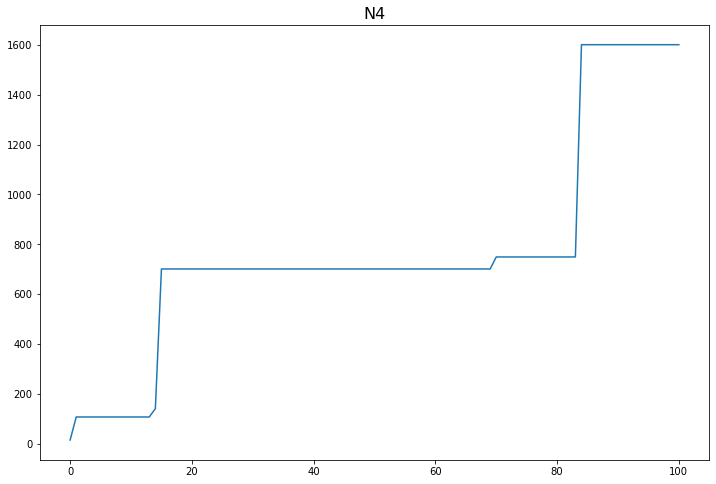

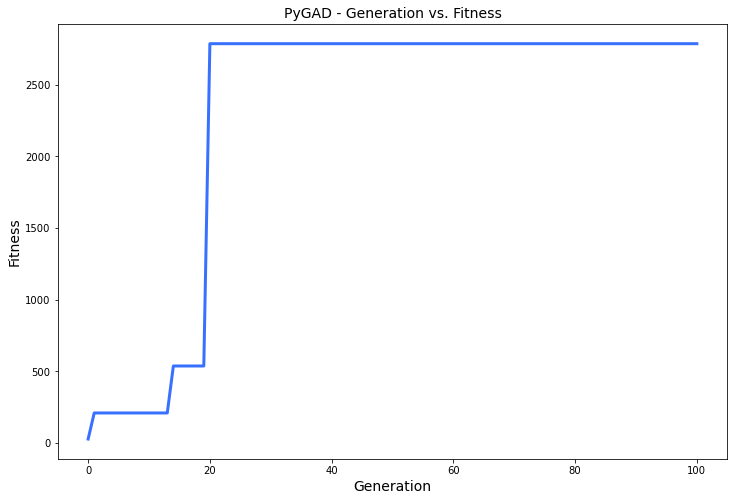

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.371 |==================| 22.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.89 |===========| 26.755 |==================| 1.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 26.165 |==================| 0.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.678 |==================| 1.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 25.912 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.609 |==================| 1.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 27.338 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.753 |==================| 4.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.934 |==================| 2.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 23.819 |==================| 3.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 22.559 |==================| 1.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 21.494 |==================| 0.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 21.469 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 21.494 |==================| 0.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 21.469 |==================| 0.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.44 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.753 |==================| 4.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.587 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.298 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.305 |===========| 21.469 |==================| 0.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.44 |==================| 1.122 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 23.753 |==================| 4.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.587 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.298 |==================| 3.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 24.304 |==================| 1.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 23.799 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 24.118 |==================| 1.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 23.849 |==================| 3.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 21.791 |==================| 0.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.528 |==================| 1.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.112 |==================| 1.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 22.123 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 23.847 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 23.849 |==================| 3.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 21.791 |==================| 0.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 24.528 |==================| 1.021 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.112 |==================| 1.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 22.123 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 23.847 |==================| 3.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 24.161 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.366 |==================| 1.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.75 |==================| 4.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.606 |==================| 17.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.624 |==================| 13.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.237 |==================| 1.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.539 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.75 |==================| 4.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 23.606 |==================| 17.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.624 |==================| 13.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.237 |==================| 1.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.539 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 23.713 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.624 |==================| 13.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.237 |==================| 1.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.539 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 23.713 |==================| 6.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 22.188 |==================| 0.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.303 |==================| 1.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 21.032 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 23.674 |==================| 7.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 23.671 |==================| 8.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.436 |==================| 1.128 |==========
Fitness = 18.23419261611773
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 22.188 |==================| 0.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.303 |==================| 1.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 21.032 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.436 |==================| 1.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 22.188 |==================| 0.735 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.303 |==================| 1.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.46 |===========| 21.032 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.551 |==================| 0.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 21.638 |==================| 0.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 22.147 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 22.683 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.52 |==================| 34.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.505 |==================| 1.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.342 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.041 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.845 |==================| 3.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.556 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.512 |===========| 23.52 |==================| 34.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 24.505 |==================| 1.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.342 |==================| 1.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 24.041 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.845 |==================| 3.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.556 |==================| 149.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 23.929 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 22.363 |==================| 0.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 21.624 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 24.35 |==================| 1.248 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 21.904 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.131 |==================| 1.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.315 |==================| 1.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.641 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 21.904 |==================| 0.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.131 |==================| 1.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.315 |==================| 1.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.641 |==================| 10.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 23.028 |==================| 1.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 21.145 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 23.028 |==================| 1.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 23.895 |==================| 2.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 21.145 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 21.803 |==================| 0.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 21.123 |==================| 0.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 23.32 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 23.778 |==================| 4.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 22.055 |==================| 0.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 21.238 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.037 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.238 |==================| 1.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.179 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.569 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 22.055 |==================| 0.669 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.387 |===========| 21.238 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.037 |==================| 2.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.238 |==================| 1.452 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.179 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 23.569 |==================| 49.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 23.745 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 21.861 |==================| 0.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.309 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 21.018 |==================| 0.395 |==========
Generation = 8
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 21.617 |==================| 0.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.579 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 22.571 |==================| 1.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.181 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 24.309 |==================| 1.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 21.018 |==================| 0.395 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 21.617 |==================| 0.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.579 |==================| 0.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.897 |===========| 22.571 |==================| 1.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.181 |==================| 1.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 23.715 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.354 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 23.836 |==================| 3.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.926 |==================| 2.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.518 |==================| 1.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.26 |==================| 1.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 23.863 |==================| 3.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 20.927 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.518 |==================| 1.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.26 |==================| 1.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 23.863 |==================| 3.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 20.927 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.183 |==================| 1.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.95 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.061 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 24.26 |==================| 1.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 23.863 |==================| 3.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 20.927 |==================| 0.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 24.183 |==================| 1.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.95 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.061 |==================| 1.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 24.436 |==================| 1

======| 0.378 |===========| 23.825 |==================| 3.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.255 |==================| 1.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.538 |==================| 96.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.129 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.929 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.019 |==================| 2.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.066 |==================| 1.935 |==========
=====|SOLUTION|===========|OUTPUT|===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.538 |==================| 96.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 23.129 |==================| 2.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.929 |==================| 0.617 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 24.019 |==================| 2.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.066 |==================| 1.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.268 |==================| 3.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 23.214 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.948 |==================| 0.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.724 |===========| 23.011 |==================| 1.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.223 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.083 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 21.027 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.082 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.53 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.223 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.083 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 21.027 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.082 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.53 |==================| 0.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 23.811 |==================| 3.819 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 21.136 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.083 |==================| 1.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 21.027 |==================| 0.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 23.082 |==================| 2.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 21.53 |==================| 0.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 23.811 |==================| 3.819 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 23.882 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 21.227 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 22.039 |==================| 0.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.244 |==================| 3.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 23.463 |==================| 11.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.138 |==================| 1.699 |==========
Fitness = 149.4357652891868
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 23.882 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 21.227 |==================| 0.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 23.882 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 21.227 |==================| 0.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 23.121 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.312 |===========| 23.969 |==================| 2.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 23.784 |==================| 4.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.239 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.799 |===========| 22.822 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.837 |===========| 22.726 |==================| 1.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 22.768 |==================| 1.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.355 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 23.346 |==================| 4.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 22.862 |==================| 1.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.085 |==================| 1.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 23.79 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 22.862 |==================| 1.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 24.085 |==================| 1.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 23.79 |==================| 4.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 22.816 |==================| 1.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 22.516 |==================| 0.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 24.552 |==================| 0.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 23.985 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 21.903 |==================| 0.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.174 |==================| 1.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.533 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.007 |==================| 2.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 21.438 |==================| 0.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 22.841 |==================| 1.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.451 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.533 |==================| 1.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.007 |==================| 2.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 21.438 |==================| 0.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 22.841 |==================| 1.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.451 |==================| 0.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.409 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 23.789 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.451 |==================| 0.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.409 |==================| 1.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 23.789 |==================| 4.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 23.281 |==================| 3.738 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.598 |===========| 23.318 |==================| 4.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 21.329 |==================| 0.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 24.045 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.318 |==================| 1.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 22.846 |==================| 1.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 22.285 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.016 |==================| 2.141 |==========
Fitness = 149.4357652891868
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 21.648 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.24 |===========| 21.648 |==================| 0.526 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 24.193 |==================| 1.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 24.213 |==================| 1.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 23.039 |==================| 1.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 23.208 |==================| 2.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.106 |===========| 22.015 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 23.379 |==================| 5.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.151 |==================| 1.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 20.961 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 23.919 |==================| 2.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 23.964 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 22.273 |==================| 0.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 21.947 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 23.919 |==================| 2.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 23.964 |==================| 2.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 22.273 |==================| 0.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 21.947 |==================| 0.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.555 |==================| 0.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 23.029 |==================| 1.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 21.682 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.002 |===========| 22.296 |==================| 0.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 22.122 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.953 |==================| 2.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.89 |==================| 2.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.364 |==================| 5.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.077 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.308 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 22.122 |==================| 0.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.953 |==================| 2.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 23.89 |==================| 2.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 23.364 |==================| 5.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.077 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.308 |==================| 1.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.197 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.077 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 24.308 |==================| 1.318 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 24.197 |==================| 1.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 21.907 |==================| 0.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 22.141 |==================| 0.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 23.887 |==================| 2.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.341 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.593 |==================| 22.796 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 23.882 |==================| 2.998 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.828 |==================| 3.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 21.847 |==================| 0.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 21.74 |==================| 0.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 21.924 |==================| 0.615 |==========
Fitness = 149.4357652891868
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.828 |==================| 3.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 21.847 |==================| 0.587 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 21.74 |==================| 0.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.14 |===========| 21.924 |==================| 0.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 23.575 |==================| 38.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 23.9 |==================| 2.845 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 23.762 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 23.746 |==================| 5.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 21.197 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.249 |==================| 1.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.174 |==================| 1.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.251 |==================| 1.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.129 |==================| 1.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 23.024 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 21.197 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 24.249 |==================| 1.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 24.174 |==================| 1.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.251 |==================| 1.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.129 |==================| 1.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 23.024 |==================| 1.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 21.049 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 22.723 |==================| 1.21 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 23.723 |==================| 5.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.281 |==================| 1.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.518 |==================| 1.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 21.8 |==================| 0.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.591 |==================| 23.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.508 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.424 |===========| 23.723 |==================| 5.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 24.281 |==================| 1.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.518 |==================| 1.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 21.8 |==================| 0.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.591 |==================| 23.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.508 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 22.073 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 21.8 |==================| 0.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.591 |==================| 23.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.508 |==================| 1.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 22.073 |==================| 0.678 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.853 |===========| 22.684 |==================| 1.156 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.349 |==================| 4.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 23.589 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.522 |==================| 1.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 21.787 |==================| 0.568 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.062 |==================| 1.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.983 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.413 |==================| 1.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.131 |==================| 1.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.25 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.413 |==================| 1.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 24.131 |==================| 1.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.25 |==================| 1.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.071 |==================| 1.915 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.413 |===========| 21.166 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.412 |==================| 1.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.005 |===========| 24.579 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 22.869 |==================| 1.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 22.218 |==================| 0.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.017 |==================| 1.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.473 |==================| 1.082 |==========
Generation = 22
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.056 |==================| 1.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 21.809 |==================| 0.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 21.059 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.017 |==================| 1.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.473 |==================| 1.082 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 24.056 |==================| 1.973 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.182 |===========| 21.809 |==================| 0.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 21.059 |==================| 0.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 24.393 |==================| 1.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 21.179 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.621 |==================| 13.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.614 |==================| 15.257 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 22.736 |==================| 1.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.253 |==================| 1.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.037 |==================| 2.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 23.102 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 21.834 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.833 |===========| 22.736 |==================| 1.231 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.253 |==================| 1.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 24.037 |==================| 2.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 23.102 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 21.834 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.001 |==================| 2.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 22.902 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 23.102 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.173 |===========| 21.834 |==================| 0.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 24.001 |==================| 2.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 22.902 |==================| 1.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 22.114 |==================| 0.697 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 24.122 |==================| 1.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.059 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 22.497 |==================| 0.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 21.414 |==================| 0.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 22.777 |==================| 1.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 22.928 |==================| 1.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.659 |==================| 9.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 22.951 |==================| 1.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.042 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 22.928 |==================| 1.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.659 |==================| 9.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 22.951 |==================| 1.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 24.042 |==================| 2.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.762 |===========| 22.916 |==================| 1.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 23.545 |==================| 242.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.288 |===========| 21.515 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 22.703 |==================| 1.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 23.808 |==================| 3.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 21.39 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.369 |==================| 1.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.027 |==================| 1.917 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 23.882 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 22.819 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 23.808 |==================| 3.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 21.39 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 24.369 |==================| 1.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 23.027 |==================| 1.917 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 23.882 |==================| 3.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 22.819 |==================| 1.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.663 |===========| 23.16 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.521 |===========| 23.499 |==================| 20.164 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.572 |==================| 43.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.45 |==================| 0.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.463 |==================| 1.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 22.083 |==================| 0.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.471 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.618 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.572 |==================| 43.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 22.45 |==================| 0.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 24.463 |==================| 1.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 22.083 |==================| 0.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.471 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.618 |==================| 1.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 21.069 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 22.083 |==================| 0.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 24.471 |==================| 1.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 22.618 |==================| 1.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 21.069 |==================| 0.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 23.771 |==================| 4.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 22.828 |==================| 1.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.981 |===========| 22.352 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.379 |==================| 1.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.268 |==================| 1.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 23.762 |==================| 4.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.628 |==================| 12.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 22.667 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.608 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.406 |===========| 23.762 |==================| 4.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.628 |==================| 12.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 22.667 |==================| 1.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.608 |==================| 17.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.613 |==================| 15.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 23.84 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.965 |==================| 2.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.532 |==================| 1.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.414 |===========| 21.162 |==================| 0.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.233 |==================| 1.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 22.142 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 22.22 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.314 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 24.233 |==================| 1.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 22.142 |==================| 0.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 22.22 |==================| 0.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.314 |==================| 1.307 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.382 |==================| 1.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.062 |===========| 22.135 |==================| 0.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 22.63 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.314 |==================| 1.307 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 24.246 |==================| 1.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.27 |===========| 21.566 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 21.085 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.128 |==================| 2.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.245 |==================| 3.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 21.166 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 21.085 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.128 |==================| 2.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.245 |==================| 3.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 21.166 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.171 |==================| 1.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 21.54 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.624 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 21.166 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.171 |==================| 1.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 21.54 |==================| 0.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 23.624 |==================| 13.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.279 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.44 |==================| 1.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 21.209 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 23.809 |==================| 3.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.532 |==================| 0.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 21.63 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 22.013 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.024 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.073 |==================| 2.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.906 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.532 |==================| 0.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.247 |===========| 21.63 |==================| 0.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.107 |===========| 22.013 |==================| 0.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.024 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.073 |==================| 2.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.906 |==================| 2.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.113 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.418 |==================| 1.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 21.51 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.233 |==================| 3.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 21.817 |==================| 0.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.571 |==================| 0.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.225 |==================| 1.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 23.787 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 21.51 |==================| 0.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.233 |==================| 3.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 21.817 |==================| 0.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.571 |==================| 0.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.225 |==================| 1.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 23.787 |==================| 4.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 21.987 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.233 |==================| 3.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.179 |===========| 21.817 |==================| 0.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.01 |===========| 24.571 |==================| 0.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 24.225 |==================| 1.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 23.787 |==================| 4.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 21.987 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 20.997 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.548 |==================| 1210.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 23.898 |==================| 2.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 21.431 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 23.806 |==================| 3.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.687 |==================| 7.249 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.261 |==================| 1.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 21.431 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 23.806 |==================| 3.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.687 |==================| 7.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 24.261 |==================| 1.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.001 |==================| 1.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.018 |==================| 1.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.243 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.657 |==================| 9.29 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.892 |===========| 22.585 |==================| 1.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 24.104 |==================| 1.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.229 |==================| 1.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.069 |==================| 1.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.621 |==================| 1.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.426 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.069 |==================| 1.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.621 |==================| 1.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.426 |==================| 1.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 24.49 |==================| 1.063 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.235 |==================| 1.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.408 |===========| 21.178 |==================| 0.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 21.431 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 23.97 |==================| 2.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.949 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 23.672 |==================| 8.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.217 |==================| 3.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 23.837 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.239 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 22.989 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 23.672 |==================| 8.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.217 |==================| 3.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.373 |===========| 23.837 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.239 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 22.989 |==================| 1.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.303 |==================| 1.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.562 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 22.989 |==================| 1.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.303 |==================| 1.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.562 |==================| 0.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 20.967 |==================| 0.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 24.584 |==================| 0.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.336 |==================| 1.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 22.643 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 23.495 |==================| 18.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 22.609 |==================| 1.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 24.421 |==================| 1.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.384 |==================| 1.197 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.336 |==================| 1.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 22.643 |==================| 1.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.109 |===========| 24.384 |==================| 1.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.336 |==================| 1.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 22.643 |==================| 1.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 24.062 |==================| 1.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 22.956 |==================| 1.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 22.32 |==================| 0.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.924 |===========| 22.501 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 24.283 |==================| 1.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.164 |===========| 21.858 |==================| 0.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 21.171 |==================| 0.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.06 |==================| 1.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 21.114 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 23.414 |==================| 7.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 23.534 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.431 |===========| 21.114 |==================| 0.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.558 |===========| 23.414 |==================| 7.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.506 |===========| 23.534 |==================| 69.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.503 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 20.948 |==================| 0.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 21.921 |==================| 0.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.152 |===========| 21.892 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.796 |===========| 22.831 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.091 |===========| 24.418 |==================| 1.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 22.257 |==================| 0.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 23.973 |==================| 2.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.391 |==================| 1.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 22.357 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.616 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 24.391 |==================| 1.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 22.357 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.616 |==================| 14.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.531 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.082 |==================| 1.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.446 |==================| 9.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.07 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 22.357 |==================| 0.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 23.616 |==================| 14.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 24.531 |==================| 1.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 24.082 |==================| 1.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 23.446 |==================| 9.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 24.07 |==================| 1.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 22.854 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 21.346 |==================| 0.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.322 |===========| 21.42 |==================| 0.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 21.195 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 21.169 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.365 |==================| 1.225 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.179 |==================| 1.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.412 |===========| 21.169 |==================| 0.42 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 24.365 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 24.179 |==================| 1.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.504 |==================| 1.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.648 |==================| 10.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.74 |===========| 22.971 |==================| 1.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.299 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.924 |==================| 2.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 21.955 |==================| 0.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.146 |==================| 1.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 21.044 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 21.044 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 22.552 |==================| 1.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 21.623 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 24.146 |==================| 1.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 21.044 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.455 |===========| 21.044 |==================| 0.399 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.904 |===========| 22.552 |==================| 1.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.249 |===========| 21.623 |==================| 0.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 21.215 |==================| 0.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.411 |===========| 21.17 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 22.316 |==================| 0.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.446 |==================| 1.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.411 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 23.027 |==================| 1.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.171 |==================| 1.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 22.867 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 24.446 |==================| 1.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.411 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 23.027 |==================| 1.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.171 |==================| 1.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 22.867 |==================| 1.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 22.403 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.411 |==================| 1.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.717 |===========| 23.027 |==================| 1.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.171 |==================| 1.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 22.867 |==================| 1.467 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 22.403 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.426 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.606 |===========| 23.299 |==================| 4.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 23.962 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.267 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 22.913 |==================| 1.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.752 |==================| 4.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 21.26 |==================| 0.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.04 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.315 |===========| 23.962 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 24.267 |==================| 1.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 22.913 |==================| 1.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 23.752 |==================| 4.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.379 |===========| 21.26 |==================| 0.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 22.04 |==================| 0.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 23.686 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 21.839 |==================| 0.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.905 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.23 |==================| 1.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.728 |==================| 5.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.593 |==================| 22.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 23.711 |==================| 6.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 21.749 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 23.905 |==================| 2.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.23 |==================| 1.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.728 |==================| 5.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.593 |==================| 22.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 23.711 |==================| 6.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 21.749 |==================| 0.556 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 23.115 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 24.23 |==================| 1.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 23.728 |==================| 5.58 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.481 |===========| 23.593 |==================| 22.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 23.711 |==================| 6.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 21.749 |==================| 0.556 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.467 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 21.881 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 21.123 |==================| 0.412 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.467 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 21.881 |==================| 0.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 22.673 |==================| 1.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 21.729 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.364 |==================| 1.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 22.467 |==================| 0.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 21.881 |==================| 0.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 22.673 |==================| 1.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 21.729 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 24.364 |==================| 1.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 24.415 |==================| 1.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.114 |===========| 24.373 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 22.923 |==================| 1.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.444 |==================| 1.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 23.684 |==================| 7.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.142 |===========| 21.919 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 23.955 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.823 |==================| 3.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.303 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 23.955 |==================| 2.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.823 |==================| 3.651 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.15 |===========| 24.303 |==================| 1.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.046 |===========| 22.178 |==================| 0.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 23.784 |==================| 4.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.532 |==================| 1.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 21.958 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 21.197 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 24.518 |==================| 1.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 23.068 |==================| 2.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.736 |==================| 5.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.467 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.925 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.736 |==================| 5.345 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 24.467 |==================| 1.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.925 |==================| 2.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.539 |==================| 102.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 22.549 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 22.644 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.214 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.925 |==================| 2.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.504 |===========| 23.539 |==================| 102.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.905 |===========| 22.549 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 22.644 |==================| 1.105 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.214 |==================| 1.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 23.816 |==================| 3.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.435 |===========| 21.103 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 21.108 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.179 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 22.272 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.692 |==================| 7.012 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 23.422 |==================| 7.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.134 |==================| 1.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 23.179 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 22.272 |==================| 0.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 23.692 |==================| 7.012 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 23.422 |==================| 7.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 24.134 |==================| 1.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 24.138 |==================| 1.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 23.761 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.226 |===========| 21.687 |==================| 0.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.546 |==================| 371.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 22.393 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.332 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.114 |==================| 1.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.333 |==================| 1.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.242 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 23.546 |==================| 371.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 22.393 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.332 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.114 |==================| 1.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 24.333 |==================| 1.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.242 |==================| 1.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 24.112 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.143 |===========| 24.317 |==================| 1.302 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 22.429 |==================| 0.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 22.173 |==================| 0.727 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 22.421 |==================| 0.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 23.77 |==================| 4.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.507 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.152 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 22.421 |==================| 0.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 23.77 |==================| 4.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.507 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.152 |==================| 1.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.113 |==================| 1.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 23.741 |==================| 5.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.3 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 24.152 |==================| 1.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.113 |==================| 1.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 23.741 |==================| 5.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 24.3 |==================| 1.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.135 |===========| 21.938 |==================| 0.621 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 23.187 |==================| 2.763 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.282 |===========| 21.531 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 21.274 |==================| 0.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.32 |===========| 23.952 |==================| 2.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 20.99 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.217 |==================| 1.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.078 |==================| 2.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.05 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.662 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.217 |==================| 1.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.697 |===========| 23.078 |==================| 2.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.05 |==================| 1.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.662 |==================| 8.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 22.582 |==================| 1.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 23.869 |==================| 3.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.209 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 22.405 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.15 |==================| 1.664 |==========
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 21.145 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.486 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 20.989 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.236 |==================| 1.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.354 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.226 |===========| 24.15 |==================| 1.664 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 21.145 |==================| 0.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.486 |==================| 1.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.475 |===========| 20.989 |==================| 0.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 24.236 |==================| 1.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.354 |==================| 1.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.699 |===========| 23.073 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.117 |==================| 1.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |==================| 1.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.142 |==================| 1.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.626 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.253 |==================| 1.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.254 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 21.96 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.142 |==================| 1.686 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.626 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.253 |==================| 1.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.254 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 21.96 |==================| 0.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.934 |==================| 2.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 21.973 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 21.626 |==================| 0.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.253 |==================| 1.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 24.254 |==================| 1.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 21.96 |==================| 0.629 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 23.934 |==================| 2.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.122 |===========| 21.973 |==================| 0.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 22.085 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 21.201 |==================| 0.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |==================| 1.071 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 23.869 |==================| 3.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 22.342 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 22.694 |==================| 1.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.487 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.109 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 23.869 |==================| 3.127 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 22.342 |==================| 0.828 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.85 |===========| 22.694 |==================| 1.169 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.487 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 24.109 |==================| 1.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 24.241 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 23.63 |==================| 12.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 22.621 |==================| 1.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 21.288 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.188 |==================| 1.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 22.349 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.379 |==================| 1.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 21.896 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 21.288 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.188 |==================| 1.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 22.349 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.379 |==================| 1.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 21.896 |==================| 0.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.363 |==================| 1.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 23.783 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 24.188 |==================| 1.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.982 |===========| 22.349 |==================| 0.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 24.379 |==================| 1.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 21.896 |==================| 0.605 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 24.363 |==================| 1.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 23.783 |==================| 4.266 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 21.792 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 21.295 |==================| 0.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 21.564 |==================| 0.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 23.985 |==================| 2.29 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 21.792 |==================| 0.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.987 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.613 |==================| 15.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 21.792 |==================| 0.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 23.987 |==================| 2.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 23.613 |==================| 15.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.749 |==================| 4.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.367 |===========| 23.848 |==================| 3.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.081 |==================| 1.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 23.603 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 23.647 |==================| 10.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.356 |===========| 21.326 |==================| 0.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 21.876 |==================| 0.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.232 |==================| 3.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 22.733 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 22.208 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 22.151 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.158 |===========| 21.876 |==================| 0.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 23.232 |==================| 3.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.834 |===========| 22.733 |==================| 1.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 22.208 |==================| 0.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 22.151 |==================| 0.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 24.008 |==================| 2.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 23.673 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.018 |==================| 2.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 22.198 |==================| 0.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 22.46 |==================| 0.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.566 |==================| 0.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 21.399 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 21.942 |==================| 0.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 21.23 |==================| 0.4

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.566 |==================| 0.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 21.399 |==================| 0.465 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 21.942 |==================| 0.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 21.23 |==================| 0.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 21.286 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.611 |==================| 16.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 21.495 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.39 |===========| 21.23 |==================| 0.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 21.286 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 23.611 |==================| 16.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 21.495 |==================| 0.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 23.704 |==================| 6.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 24.028 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 21.431 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 21.085 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.223 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 22.191 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.279 |==================| 1.369 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.556 |==================| 149.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.464 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 24.223 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 22.191 |==================| 0.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.279 |==================| 1.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.497 |===========| 23.556 |==================| 149.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 24.464 |==================| 1.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 23.65 |==================| 9.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 23.851 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 22.195 |==================| 0.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 21.352 |==================| 0.455 |==========
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 23.733 |==================| 5.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 21.85 |==================| 0.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.953 |==================| 2.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 22.216 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 22.789 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 21.352 |==================| 0.455 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 23.733 |==================| 5.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.167 |===========| 21.85 |==================| 0.588 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 23.953 |==================| 2.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.032 |===========| 22.216 |==================| 0.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 22.789 |==================| 1.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 21.943 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.406 |==================| 1.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.473 |==================| 1.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.525 |==================| 0.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.955 |===========| 22.419 |==================| 0.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.828 |==================| 3.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.597 |==================| 1.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 22.319 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.828 |==================| 3.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.597 |==================| 1.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 22.319 |==================| 0.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 21.383 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.087 |==================| 2.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.243 |==================| 3.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.597 |==================| 1.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 22.319 |==================| 0.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 21.383 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 23.087 |==================| 2.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.243 |==================| 3.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 24.484 |==================| 1.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 22.991 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 23.036 |==================| 1.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 22.892 |==================| 1.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 21.413 |==================| 0.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 21.881 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.674 |==================| 0.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.487 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.218 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 22.892 |==================| 1.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 21.413 |==================| 0.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.156 |===========| 21.881 |==================| 0.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.674 |==================| 0.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 24.487 |==================| 1.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.218 |==================| 3.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 23.172 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 24.214 |==================| 1.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.129 |===========| 24.343 |==================| 1.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.118 |==================| 2.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 20.981 |==================| 0.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.557 |==================| 116.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.563 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.172 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 23.557 |==================| 116.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 24.563 |==================| 0.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.172 |==================| 1.604 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 21.907 |==================| 0.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.46 |==================| 1.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 24.291 |==================| 1.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 22.484 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 24.172 |==================| 1.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.023 |==================| 2.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.256 |==================| 3.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.461 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.497 |==================| 1.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.312 |==================| 4.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 22.435 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.023 |==================| 2.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 23.256 |==================| 3.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 24.461 |==================| 1.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 24.497 |==================| 1.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.312 |==================| 4.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 22.435 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.923 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 23.312 |==================| 4.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 22.435 |==================| 0.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.923 |==================| 2.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.597 |==================| 20.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.658 |===========| 23.173 |==================| 2.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 23.76 |==================| 4.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 21.194 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 22.167 |==================| 0.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 23.894 |==================| 2.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 24.445 |==================| 1.116 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 23.582 |==================| 30.591 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 22.449 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 22.449 |==================| 0.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.317 |===========| 23.958 |==================| 2.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 22.854 |==================| 1.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.373 |===========| 21.277 |==================| 0.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 23.801 |==================| 3.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.529 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 21.931 |==================| 0.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 23.932 |==================| 2.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.198 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.496 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.598 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.293 |==================| 3.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 22.11 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 23.932 |==================| 2.609 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.198 |==================| 0.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.496 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.598 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.293 |==================| 3.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 22.11 |==================| 0.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.204 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 24.496 |==================| 1.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 22.598 |==================| 1.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 23.293 |==================| 3.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 22.11 |==================| 0.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 23.204 |==================| 2.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.516 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 23.562 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 21.315 |==================| 0.448 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 24.516 |==================| 1.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 23.562 |==================| 77.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.967 |==================| 2.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 22.908 |==================| 1.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.985 |==================| 1.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 23.562 |==================| 77.306 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 23.967 |==================| 2.394 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 22.908 |==================| 1.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 22.985 |==================| 1.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.936 |===========| 22.471 |==================| 0.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 22.908 |==================| 1.56 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 22.397 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 22.029 |==================| 0.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.128 |==================| 1.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.583 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.539 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.924 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.409 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 24.128 |==================| 1.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 24.352 |==================| 1.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.583 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 22.539 |==================| 0.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 23.924 |==================| 2.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 24.409 |==================| 1.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 24.312 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 23.823 |==================| 3.647 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.504 |==================| 22.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 21.575 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 22.1 |==================| 0.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 22.492 |==================| 0.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.123 |==================| 1.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 21.323 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 23.504 |==================| 22.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 21.575 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 22.1 |==================| 0.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 22.492 |==================| 0.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.123 |==================| 1.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 21.323 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 21.52 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 21.575 |==================| 0.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 22.1 |==================| 0.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 22.492 |==================| 0.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.238 |===========| 24.123 |==================| 1.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.357 |===========| 21.323 |==================| 0.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 21.52 |==================| 0.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 24.05 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 23.896 |==================| 2.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.275 |==================| 1.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 21.77 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.244 |==================| 1.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.134 |==================| 1.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.327 |==================| 1.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 22.372 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.275 |==================| 1.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 21.77 |==================| 0.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 24.244 |==================| 1.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.134 |==================| 1.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 24.327 |==================| 1.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 22.372 |==================| 0.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 24.439 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 22.975 |==================| 1.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 23.843 |==================| 3.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.45 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.568 |==================| 0.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 22.113 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.35 |==================| 5.016 |==========
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.0 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 24.568 |==================| 0.981 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 22.113 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.35 |==================| 5.016 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.0 |==================| 1.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 23.917 |==================| 2.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.923 |===========| 22.503 |==================| 0.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 24.097 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 22.113 |==================| 0.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.35 |==================| 5.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.749 |==================| 5.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 23.99 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.096 |==================| 1.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.3 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.118 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 22.377 |==================| 0.854 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 23.749 |==================| 5.009 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 23.99 |==================| 2.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.252 |===========| 24.096 |==================| 1.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.3 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.118 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 24.3 |==================| 1.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.681 |===========| 23.118 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 21.837 |==================| 0.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 24.021 |==================| 2.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.344 |===========| 21.358 |==================| 0.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 24.539 |==================| 1.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 23.734 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 23.644 |==================| 10.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 23.183 |==================| 2.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 22.978 |==================| 1.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 21.015 |==================| 0.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 22.393 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.184 |==================| 1.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 23.48 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 21.015 |==================| 0.395 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 22.393 |==================| 0.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.184 |==================| 1.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 23.48 |==================| 14.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 21.671 |==================| 0.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 22.857 |==================| 1.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.736 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.324 |===========| 23.942 |==================| 2.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 21.726 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.41 |==================| 1.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 20.95 |==================| 0.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 21.289 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.116 |==================| 1.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.515 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 21.726 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.095 |===========| 24.41 |==================| 1.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 20.95 |==================| 0.385 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 21.289 |==================| 0.442 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.116 |==================| 1.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.515 |==================| 29.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.332 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.116 |==================| 1.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 23.515 |==================| 29.381 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.332 |==================| 0.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.675 |==================| 0.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 24.412 |==================| 1.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 24.381 |==================| 1.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.199 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.301 |===========| 21.48 |==================| 0.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 23.706 |==================| 6.379 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.199 |==================| 0.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.221 |==================| 1.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |==================| 1.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.401 |===========| 21.199 |==================| 0.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 24.221 |==================| 1.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 24.483 |==================| 1.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 24.313 |==================| 1.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 23.314 |==================| 4.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 23.666 |==================| 8.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 22.885 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 21.992 |==================| 0.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.616 |===========| 23.276 |==================| 3.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.016 |==================| 2.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 23.819 |==================| 3.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 23.032 |==================| 1.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.608 |==================| 16.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.728 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.715 |===========| 23.032 |==================| 1.936 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.608 |==================| 16.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.422 |===========| 23.728 |==================| 5.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 22.175 |==================| 0.728 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 23.016 |==================| 1.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.668 |===========| 23.148 |==================| 2.495 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 23.64 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.334 |==================| 0.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 22.433 |==================| 0.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.091 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.566 |==================| 57.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 21.991 |==================| 0.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.254 |==================| 1.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.994 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 22.433 |==================| 0.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.091 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.566 |==================| 57.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 21.991 |==================| 0.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.254 |==================| 1.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.994 |==================| 2.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 21.57 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.091 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 23.566 |==================| 57.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 21.991 |==================| 0.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 24.254 |==================| 1.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.994 |==================| 2.247 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 21.57 |==================| 0.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 24.276 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 22.181 |==================| 0.731 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.642 |==================| 10.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 22.031 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 23.077 |==================| 2.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.583 |==================| 29.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 22.395 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 23.679 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 23.642 |==================| 10.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.101 |===========| 22.031 |==================| 0.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 23.077 |==================| 2.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.583 |==================| 29.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 22.395 |==================| 0.867 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 23.679 |==================| 7.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.216 |===========| 21.715 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 23.742 |==================| 5.185 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 22.211 |==================| 0.747 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 22.157 |==================| 0.718 |==========
Generation = 77
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 21.519 |==================| 0.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.247 |==================| 3.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.557 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.322 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 21.519 |==================| 0.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 23.247 |==================| 3.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 24.557 |==================| 0.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.322 |==================| 1.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 24.239 |==================| 1.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.721 |===========| 23.019 |==================| 1.886 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 22.927 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 22.403 |==================| 0.873 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.578 |==================| 0.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 22.875 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 21.862 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.584 |==================| 28.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.586 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.524 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 24.578 |==================| 0.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.778 |===========| 22.875 |==================| 1.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 21.862 |==================| 0.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 23.584 |==================| 28.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.586 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.524 |==================| 1.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.08 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.586 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.035 |===========| 24.524 |==================| 1.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 24.08 |==================| 1.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.677 |===========| 23.126 |==================| 2.367 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 22.156 |==================| 0.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 22.647 |==================| 1.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 21.605 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.486 |===========| 20.957 |==================| 0.386 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 22.247 |==================| 0.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 21.872 |==================| 0.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 20.995 |==================| 0.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.41 |==================| 7.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.458 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.622 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.159 |===========| 21.872 |==================| 0.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.473 |===========| 20.995 |==================| 0.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.559 |===========| 23.41 |==================| 7.202 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 24.458 |==================| 1.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 23.622 |==================| 13.754 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.067 |==================| 1.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 22.37 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.546 |==================| 1.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.117 |==================| 1.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 22.676 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.507 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.923 |==================| 2.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.448 |==================| 1.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.191 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 24.117 |==================| 1.761 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 22.676 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.507 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.923 |==================| 2.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.448 |==================| 1.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.191 |==================| 2.79 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.257 |===========| 21.603 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.857 |===========| 22.676 |==================| 1.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.044 |===========| 24.507 |==================| 1.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 23.923 |==================| 2.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 24.448 |==================| 1.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 23.191 |==================| 2.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.315 |==================| 1.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 22.912 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 22.106 |==================| 0.693 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 24.315 |==================| 1.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 22.912 |==================| 1.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 23.603 |==================| 18.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.66 |==================| 9.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.335 |==================| 0.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 22.912 |==================| 1.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 23.603 |==================| 18.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 23.66 |==================| 9.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 22.335 |==================| 0.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 21.108 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.673 |===========| 23.136 |==================| 2.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.032 |===========| 24.53 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 23.803 |==================| 3.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.829 |==================| 3.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 21.431 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.583 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.795 |==================| 1.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 21.127 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.432 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 23.829 |==================| 3.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 21.431 |==================| 0.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 24.583 |==================| 0.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 22.795 |==================| 1.326 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.426 |===========| 21.127 |==================| 0.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 24.432 |==================| 1.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.359 |===========| 23.866 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 24.143 |==================| 1.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.949 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.427 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.257 |==================| 1.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 22.975 |==================| 1.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.503 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 22.098 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 21.949 |==================| 0.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 24.427 |==================| 1.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 24.257 |==================| 1.413 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.739 |===========| 22.975 |==================| 1.742 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.503 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 22.098 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.572 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 24.503 |==================| 1.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 22.098 |==================| 0.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 23.572 |==================| 43.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 23.35 |==================| 5.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.012 |===========| 24.566 |==================| 0.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 23.133 |==================| 2.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 23.796 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.355 |===========| 21.329 |==================| 0.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.157 |==================| 1.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.274 |==================| 1.38 |==========
Fitness = 1210.9186645855523
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 23.133 |==================| 2.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 23.796 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.452 |==================| 1.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.391 |===========| 23.796 |==================| 4.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 24.452 |==================| 1.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 24.336 |==================| 1.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 21.481 |==================| 0.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 22.524 |==================| 0.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 24.43 |==================| 1.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 23.052 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 23.235 |==================| 3.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.5 |===========| 23.549 |==================| 9330.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 20.979 |==================| 0.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 24.157 |==================| 1.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.996 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 23.84 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 21.391 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.299 |===========| 23.996 |==================| 2.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 23.84 |==================| 3.437 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 21.391 |==================| 0.463 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 21.459 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.618 |==================| 14.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 23.878 |==================| 3.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 24.523 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.335 |===========| 21.384 |==================| 0.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.079 |===========| 24.441 |==================| 1.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 22.458 |==================| 0.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 23.995 |==================| 2.242 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.402 |==================| 1.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.17 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.024 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.402 |==================| 1.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.17 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.024 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.216 |==================| 1.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.235 |==================| 1.458 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 23.342 |==================| 4.839 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.407 |===========| 23.76 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 24.17 |==================| 1.611 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.286 |===========| 24.024 |==================| 2.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.216 |==================| 1.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 24.235 |==================| 1.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.599 |==================| 19.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.434 |==================| 1.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 22.1 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 23.391 |==================| 6.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.548 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.674 |==================| 0.533 |==========
Fitness = 9330.185632414683
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.599 |==================| 19.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.434 |==================| 1.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 22.1 |==================| 0.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 24.548 |==================| 1.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 21.674 |==================| 0.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 23.599 |==================| 19.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 24.434 |==================| 1.13 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 22.1 |==================| 0.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.64 |===========| 23.218 |==================| 3.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 23.508 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 24.343 |==================| 1.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 24.092 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 23.185 |==================| 2.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.514 |==================| 1.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 22.226 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 22.145 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 21.314 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 24.514 |==================| 1.036 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 22.226 |==================| 0.756 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.058 |===========| 22.145 |==================| 0.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 21.314 |==================| 0.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 24.061 |==================| 1.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 24.384 |==================| 1.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.289 |===========| 21.512 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 21.988 |==================| 0.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.315 |==================| 0.81 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.592 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 22.981 |==================| 1.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 22.284 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.297 |==================| 3.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.269 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 21.592 |==================| 0.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 22.981 |==================| 1.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 22.284 |==================| 0.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.297 |==================| 3.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.269 |==================| 3.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.853 |==================| 3.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 22.512 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.607 |===========| 23.297 |==================| 3.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 23.269 |==================| 3.574 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 23.853 |==================| 3.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 22.512 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 23.242 |==================| 3.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.714 |===========| 23.036 |==================| 1.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 22.923 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.085 |===========| 22.072 |==================| 0.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.272 |==================| 1.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.586 |==================| 26.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.556 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.662 |==================| 8.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.217 |==================| 1.497 |==========
Fitness = 9330.185632414683
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 24.272 |==================| 1.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 23.586 |==================| 26.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 24.556 |==================| 0.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.451 |===========| 23.662 |==================| 8.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 24.217 |==================| 1.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.875 |===========| 22.628 |==================| 1.085 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 24.456 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 22.1 |==================| 0.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 22.105 |==================| 0.693 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 24.402 |==================| 1.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 24.015 |==================| 2.146 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 22.198 |==================| 0.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.474 |==================| 1.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.597 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 22.198 |==================| 0.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 24.474 |==================| 1.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 23.597 |==================| 20.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 23.541 |==================| 131.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 23.776 |==================| 4.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.189 |===========| 21.791 |==================| 0.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 23.657 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 23.948 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 21.843 |==================| 0.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 21.434 |==================| 0.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 22.791 |==================| 1.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.32 |==================| 1.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 23.814 |==================| 3.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.115 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 22.791 |==================| 1.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 24.32 |==================| 1.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.383 |===========| 23.814 |==================| 3.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.115 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.135 |==================| 1.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.052 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 22.117 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.243 |===========| 24.115 |==================| 1.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.135 |==================| 1.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 24.052 |==================| 1.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 22.117 |==================| 0.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 21.745 |==================| 0.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.7 |===========| 23.071 |==================| 2.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 23.243 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 23.803 |==================| 3.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 23.159 |==================| 2.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 23.096 |==================| 2.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 23.091 |==================| 2.184 |==========
Fitness = 9330.185632414683
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.824 |==================| 3.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.45 |==================| 1.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.378 |===========| 23.824 |==================| 3.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 24.45 |==================| 1.11 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 22.853 |==================| 1.436 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 23.61 |==================| 16.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 23.06 |==================| 2.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 24.322 |==================| 1.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 23.88 |==================| 3.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 21.079 |==================| 0.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.013 |===========| 22.266 |==================| 0.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.134 |==================| 1.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 21.778 |==================| 0.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.32 |==================| 1.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 23.88 |==================| 3.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 21.727 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 24.134 |==================| 1.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 21.778 |==================| 0.565 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 24.32 |==================| 1.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 23.88 |==================| 3.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 21.727 |==================| 0.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 23.976 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 21.777 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 24.424 |==================| 1.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.558 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 22.408 |==================| 0.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 22.592 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.146 |==================| 1.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.119 |==================| 2.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 22.743 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 24.558 |==================| 0.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 22.408 |==================| 0.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 22.592 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.146 |==================| 1.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.119 |==================| 2.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 22.743 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 23.82 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.959 |===========| 22.408 |==================| 0.877 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.889 |===========| 22.592 |==================| 1.045 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 24.146 |==================| 1.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.68 |===========| 23.119 |==================| 2.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 22.743 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 23.82 |==================| 3.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 21.711 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 20.997 |==================| 0.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 21.176 |==================| 0.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.441 |===========| 21.086 |==================| 0.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 23.883 |==================| 2.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.279 |==================| 1.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.341 |==================| 1.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.184 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 24.279 |==================| 1.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 24.341 |==================| 1.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.209 |===========| 24.184 |==================| 1.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 22.495 |==================| 0.949 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 23.273 |==================| 3.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 23.818 |==================| 3.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.787 |===========| 22.854 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 24.407 |==================| 1.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.618 |==================| 14.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.355 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.027 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 22.643 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 23.863 |==================| 3.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 23.007 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 23.618 |==================| 14.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.124 |===========| 24.355 |==================| 1.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 24.027 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.869 |===========| 22.643 |==================| 1.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.36 |===========| 23.863 |==================| 3.179 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.726 |===========| 23.007 |==================| 1.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.197 |===========| 24.209 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 22.051 |==================| 0.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 21.228 |==================| 0.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.655 |==================| 9.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 22.02 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 22.962 |==================| 1.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.466 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.737 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 21.228 |==================| 0.431 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.655 |==================| 9.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 22.02 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 22.962 |==================| 1.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.466 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.737 |==================| 5.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 23.81 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 23.655 |==================| 9.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.105 |===========| 22.02 |==================| 0.654 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 22.962 |==================| 1.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 24.466 |==================| 1.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 23.737 |==================| 5.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 23.81 |==================| 3.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 23.289 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 24.398 |==================| 1.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 23.774 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.176 |===========| 24.25 |==================| 1.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 24.066 |==================| 1.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.0 |==================| 1.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 21.242 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 22.404 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 23.0 |==================| 1.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 21.242 |==================| 0.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 22.404 |==================| 0.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 22.249 |==================| 0.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 24.545 |==================| 1.004 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 24.018 |==================| 2.131 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 22.315 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.163 |===========| 21.86 |==================| 0.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 24.586 |==================| 0.964 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 22.333 |==================| 0.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 21.112 |==================| 0.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.5 |==================| 1.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 1.388 |==========
Generation = 100
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.974 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 24.5 |==================| 1.052 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 1.388 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.974 |==================| 2.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.286 |==================| 1.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.14 |==================| 1.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 21.916 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 21.475 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 24.269 |==================| 1.388 |==========


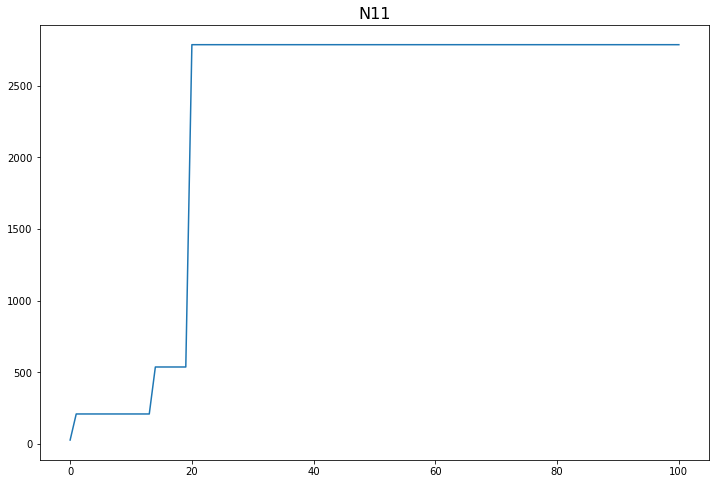

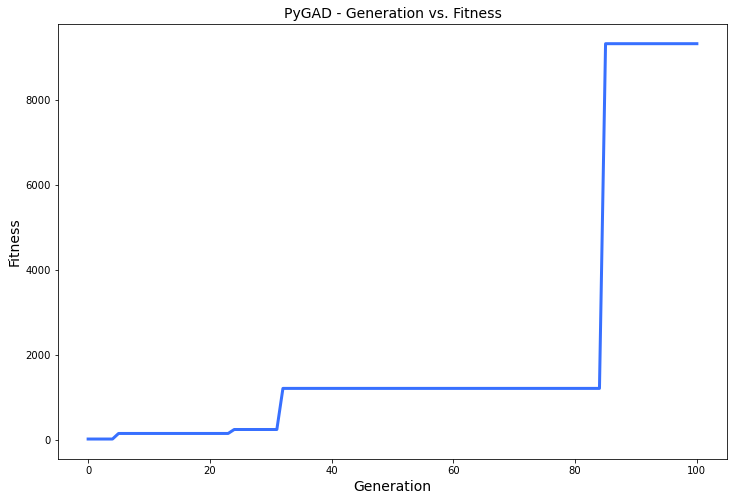

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 23.974 |==================| 2.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 24.286 |==================| 1.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 24.14 |==================| 1.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 21.916 |==================| 0.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 21.475 |==================| 0.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 21.46 |==================| 0.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.03 |===========| 24.533 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 28.765 |==================| 17.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 28.91 |==================| 11.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.883 |==================| 16.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.836 |==================| 81.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 28.694 |==================| 7.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 28.614 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.309 |===========| 28.883 |==================| 16.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.836 |==================| 81.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 28.694 |==================| 7.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 28.614 |==================| 4.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.815 |==================| 127.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.945 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 28.836 |==================| 81.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.861 |===========| 28.694 |==================| 7.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 28.614 |==================| 4.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 28.815 |==================| 127.514 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.945 |==================| 8.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.932 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.93 |==================| 9.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.87 |==================| 21.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.38 |===========| 28.473 |==================| 2.857 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.759 |==================| 15.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.728 |==================| 10.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 28.465 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 28.728 |==================| 10.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.397 |===========| 28.465 |==================| 2.791 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.055 |===========| 28.953 |==================| 7.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.881 |==================| 17.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.397 |===========| 28.856 |==================| 30.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.799 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.917 |==================| 10.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 28.831 |==================| 132.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 28.507 |==================| 3.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.496 |==================| 3.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.667 |==================| 6.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 28.53 |==================| 3.415 |==========
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 28.79 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.496 |==================| 3.058 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 28.667 |==================| 6.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 28.53 |==================| 3.415 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 28.79 |==================| 29.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.799 |==================| 40.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.747 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 28.53 |==================| 3.415 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.729 |==================| 10.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.989 |===========| 28.643 |==================| 5.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.453 |==================| 2.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.819 |==================| 237.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.87 |==================| 21.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.589 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 28.819 |==================| 237.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 28.87 |==================| 21.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.589 |==================| 4.263 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 28.678 |==================| 6.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 28.776 |==================| 21.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 28.43 |==================| 2.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.817 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 28.776 |==================| 21.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 28.43 |==================| 2.545 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.518 |===========| 28.817 |==================| 168.47 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 28.895 |==================| 13.995 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.838 |===========| 28.703 |==================| 8.291 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 28.634 |==================| 5.289 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.889 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 28.421 |==================| 2.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.945 |==================| 8.215 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.977 |===========| 28.648 |==================| 5.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.492 |===========| 28.826 |==================| 392.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 28.55 |==================| 3.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.966 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 28.55 |==================| 3.664 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.966 |==================| 7.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.719 |==================| 9.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.793 |==================| 33.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.651 |===========| 28.772 |==================| 19.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.393 |===========| 28.467 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.434 |===========| 28.845 |==================| 46.548 |==========
Generation = 6
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.919 |==================| 10.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 28.95 |==================| 7.874 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 28.444 |==================| 2.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.828 |==================| 226.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 28.503 |==================| 3.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 28.481

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 28.444 |==================| 2.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.828 |==================| 226.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.315 |===========| 28.503 |==================| 3.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 28.481 |==================| 2.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.348 |===========| 28.488 |==================| 2.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 28.962 |==================| 7.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.275 |===========| 28.521 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.075 |===========| 28.608 |==================| 4.639 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 28.955 |==================| 7.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.111 |===========| 28.938 |==================| 8.696 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.96 |==================| 7.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 28.608 |==================| 4.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 28.722 |==================| 9.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.876 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 28.96 |==================| 7.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.073 |===========| 28.608 |==================| 4.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.788 |===========| 28.722 |==================| 9.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.876 |==================| 18.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.665 |==================| 6.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 28.935 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.876 |==================| 18.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.934 |===========| 28.665 |==================| 6.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.123 |===========| 28.935 |==================| 8.94 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 28.949 |==================| 7.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.192 |===========| 28.916 |==================| 10.743 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 28.663 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==================| 20.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 28.927 |==================| 9.665 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.872 |==================| 20.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.83 |==================| 145.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 28.419 |==================| 2.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.496 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.479 |===========| 28.83 |==================| 145.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.494 |===========| 28.419 |==================| 2.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.496 |==================| 3.059 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.267 |===========| 28.524 |==================| 3.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.207 |===========| 28.912 |==================| 11.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.818 |===========| 28.71 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.824 |===========| 28.708 |==================| 8.697 |==========
Generation = 9
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.927 |==================| 9.61 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.723 |==================| 9.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 28.517 |==================| 3.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.841 |==================| 55.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 28.558 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 28.434 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 28.723 |==================| 9.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.284 |===========| 28.517 |==================| 3.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.841 |==================| 55.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 28.558 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.464 |===========| 28.434 |==================| 2.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.187 |===========| 28.918 |==================| 10.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.247 |===========| 28.901 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.921 |==================| 10.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 28.578 |==================| 4.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.876 |==================| 18.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.868 |==================| 22.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.932 |==================| 9.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.81 |==================| 78.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 28.816 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.144 |===========| 28.578 |==================| 4.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.876 |==================| 18.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.868 |==================| 22.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.932 |==================| 9.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.81 |==================| 78.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 28.816 |==================| 129.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.783 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.332 |===========| 28.876 |==================| 18.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 28.868 |==================| 22.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 28.932 |==================| 9.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 28.81 |==================| 78.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.523 |===========| 28.816 |==================| 129.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.618 |===========| 28.783 |==================| 25.015 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 28.718 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 28.886 |==================| 15.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.301 |===========| 28.885 |==================| 16.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.628 |==================| 5.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.895 |==================| 13.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 28.664 |==================| 6.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.712 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.026 |===========| 28.628 |==================| 5.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.267 |===========| 28.895 |==================| 13.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 28.664 |==================| 6.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.814 |===========| 28.712 |==================| 8.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.829 |==================| 166.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 28.746 |==================| 13.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.845 |==================| 45.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.833 |==================| 107.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.917 |==================| 10.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.861 |==================| 26.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 28.591 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.433 |===========| 28.845 |==================| 45.921 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.833 |==================| 107.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.917 |==================| 10.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.861 |==================| 26.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 28.591 |==================| 4.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.707 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 28.833 |==================| 107.8 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.19 |===========| 28.917 |==================| 10.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 28.861 |==================| 26.537 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.115 |===========| 28.591 |==================| 4.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.826 |===========| 28.707 |==================| 8.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 28.858 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.841 |==================| 55.353 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.261 |===========| 28.527 |==================| 3.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 28.44 |==================| 2.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.872 |==================| 20.377 |==========
Fitness = 1013.0742353607162
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.859 |==================| 27.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.433 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 28.44 |==================| 2.608 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.345 |===========| 28.872 |==================| 20.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 28.859 |==================| 27.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.433 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.837 |==================| 74.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 28.526 |==================| 3.365 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.043 |===========| 28.621 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |==================| 3.258 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.233 |===========| 28.905 |==================| 12.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 28.42 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.714 |==================| 9.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.755 |==================| 14.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 28.42 |==================| 2.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.808 |===========| 28.714 |==================| 9.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.755 |==================| 14.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.719 |==================| 9.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 28.889 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 28.502 |==================| 3.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.834 |==================| 94.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.74 |==================| 12.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.832 |==================| 117.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 28.611 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 28.74 |==================| 12.066 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.832 |==================| 117.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 28.883 |==================| 16.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 28.611 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 28.743 |==================| 12.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |==================| 25.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.939 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.067 |===========| 28.611 |==================| 4.716 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 28.743 |==================| 12.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |==================| 25.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.939 |==================| 8.675 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 28.828 |==================| 233.308 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.962 |==================| 7.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.403 |===========| 28.854 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 28.832 |==================| 113.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.857 |==================| 29.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 28.85 |==================| 36.831 |==========
Fitness = 1013.0742353607162
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.741 |==================| 12.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.887 |==================| 15.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 28.579 |==================| 4.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 28.887 |==================| 15.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.143 |===========| 28.579 |==================| 4.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.13 |===========| 28.584 |==================| 4.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 28.477 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.297 |===========| 28.511 |==================| 3.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.676 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |==================| 9.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.259 |===========| 28.898 |==================| 13.448 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.847 |==================| 41.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 28.771 |==================| 19.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.918 |==================| 10.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.917 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 28.506 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.847 |==================| 41.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 28.771 |==================| 19.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.918 |==================| 10.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.191 |===========| 28.917 |==================| 10.699 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.308 |===========| 28.506 |==================| 3.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.899 |==================| 13.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 28.559 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.871 |==================| 21.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.922 |===========| 28.67 |==================| 6.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.665 |==================| 6.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 28.439 |==================| 2.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 28.549 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.945 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 28.665 |==================| 6.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 28.439 |==================| 2.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 28.549 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.945 |==================| 8.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.911 |==================| 11.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 28.466 |==================| 2.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.699 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 28.439 |==================| 2.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.211 |===========| 28.549 |==================| 3.653 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.086 |===========| 28.945 |==================| 8.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.911 |==================| 11.441 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.395 |===========| 28.466 |==================| 2.798 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.699 |==================| 8.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 28.73 |==================| 10.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==================| 48.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 28.577 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.8 |==================| 42.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.934 |==================| 9.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.866 |==================| 23.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 28.78 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.844 |==================| 48.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.148 |===========| 28.577 |==================| 4.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.571 |===========| 28.8 |==================| 42.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.934 |==================| 9.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.866 |==================| 23.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.626 |===========| 28.78 |==================| 23.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.632 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 28.758 |==================| 15.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.733 |==================| 11.125 |==========
Generation = 20
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 28.464 |==================| 2.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.651 |==================| 5.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.789 |==================| 29.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.588 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 28.733 |==================| 11.125 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 28.464 |==================| 2.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 28.651 |==================| 5.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.602 |===========| 28.789 |==================| 29.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.588 |==================| 4.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 28.953 |==================| 7.714 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.774 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.918 |==================| 10.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.455 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 28.545 |==================| 3.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 28.865 |==================| 23.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 28.628 |==================| 5.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.687 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.891 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.419 |===========| 28.455 |==================| 2.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 28.545 |==================| 3.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 28.865 |==================| 23.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 28.628 |==================| 5.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.687 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.891 |==================| 14.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.959 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 28.545 |==================| 3.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 28.865 |==================| 23.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.027 |===========| 28.628 |==================| 5.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.879 |===========| 28.687 |==================| 7.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 28.891 |==================| 14.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.031 |===========| 28.959 |==================| 7.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 28.871 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.606 |==================| 4.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.84 |==================| 59.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.957 |===========| 28.656 |==================| 5.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.198 |===========| 28.915 |==================| 10.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.89 |==================| 14.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.956 |==================| 7.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 28.512 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 28.89 |==================| 14.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.956 |==================| 7.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.294 |===========| 28.512 |==================| 3.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 28.641 |==================| 5.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 28.637 |==================| 5.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.822 |==================| 1050.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 28.949 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 28.515 |==================| 3.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 28.549 |==================| 3.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.948 |==================| 8.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.929 |==================| 9.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 28.536 |==================| 3.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.825 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.948 |==================| 8.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.929 |==================| 9.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 28.536 |==================| 3.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.825 |==================| 536.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 28.599 |==================| 4.45 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.502 |===========| 28.416 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.073 |===========| 28.948 |==================| 8.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.929 |==================| 9.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.241 |===========| 28.536 |==================| 3.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.494 |===========| 28.825 |==================| 536.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.097 |===========| 28.599 |==================| 4.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.838 |==================| 66.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.472 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 28.831 |==================| 123.065 |==========
Fitness = 1050.896117576434
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.838 |==================| 66.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.472 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.934 |==================| 9.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 28.456 |==================| 2.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 28.838 |==================| 66.005 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.381 |===========| 28.472 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 28.934 |==================| 9.039 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 28.456 |==================| 2.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 28.714 |==================| 9.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 28.682 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 28.649 |==================| 5.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.931 |==================| 9.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 28.57 |==================| 3.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 28.431 |==================| 2.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.952 |==================| 7.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.558 |==================| 3.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.921 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.931 |==================| 9.317 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 28.57 |==================| 3.956 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.47 |===========| 28.431 |==================| 2.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.952 |==================| 7.787 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.558 |==================| 3.772 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 28.921 |==================| 10.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.558 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.945 |==================| 8.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.009 |===========| 28.964 |==================| 7.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 28.881 |==================| 17.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 28.828 |==================| 209.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.812 |==================| 91.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.964 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.812 |==================| 91.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 28.964 |==================| 7.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 28.556 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.741 |==================| 12.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.845 |==================| 45.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.645 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.196 |===========| 28.556 |==================| 3.74 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.737 |===========| 28.741 |==================| 12.138 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 28.845 |==================| 45.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.986 |===========| 28.645 |==================| 5.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.898 |==================| 13.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.91 |==================| 11.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.764 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 28.539 |==================| 3.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.848 |===========| 28.699 |==================| 8.058 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.764 |==================| 16.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.883 |==================| 16.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 28.521 |==================| 3.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.871 |==================| 21.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 28.883 |==================| 16.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 28.521 |==================| 3.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.871 |==================| 21.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.493 |===========| 28.825 |==================| 452.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |==================| 12.197 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.765 |===========| 28.73 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 28.61 |==================| 4.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.65 |==================| 5.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.963 |==================| 7.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.954 |==================| 7.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.95 |==================| 7.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 28.61 |==================| 4.694 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 28.65 |==================| 5.77 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.963 |==================| 7.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.048 |===========| 28.954 |==================| 7.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 28.95 |==================| 7.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.213 |===========| 28.911 |==================| 1

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.171 |===========| 28.567 |==================| 3.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.272 |===========| 28.894 |==================| 14.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.908 |==================| 11.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.812 |==================| 93.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 28.583 |==================| 4.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 28.678 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.223 |===========| 28.908 |==================| 11.805 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.812 |==================| 93.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.134 |===========| 28.583 |==================| 4.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 28.678 |==================| 6.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 28.454 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.726 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.901 |===========| 28.678 |==================| 6.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.42 |===========| 28.454 |==================| 2.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.726 |==================| 10.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.918 |===========| 28.672 |==================| 6.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.841 |===========| 28.702 |==================| 8.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.933 |==================| 9.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.856 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.489 |===========| 28.422 |==================| 2.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.07 |===========| 28.61 |==================| 4.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.839 |===========| 28.702 |==================| 8.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 28.573 |==================| 3.996 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.856 |==================| 30.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 28.526 |==================| 3.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 28.856 |==================| 30.613 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.264 |===========| 28.526 |==================| 3.363 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.014 |===========| 28.963 |==================| 7.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.059 |===========| 28.614 |==================| 4.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.925 |==================| 9.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 28.952 |==================| 7.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.402 |===========| 28.463 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.619 |===========| 28.783 |==================| 24.812 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.936 |==================| 8.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 28.701 |==================| 8.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.738 |==================| 11.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.774 |==================| 20.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.459 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 28.63 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 28.936 |==================| 8.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 28.701 |==================| 8.198 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 28.738 |==================| 11.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.644 |===========| 28.774 |==================| 20.377 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 28.459 |==================| 2.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.022 |===========| 28.63 |==================| 5.168 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 28.786 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 28.731 |==================| 10.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.844 |==================| 47.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 28.629 |==================| 5.158 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.447 |===========| 28.441 |==================| 2.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.833 |==================| 98.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.445 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 28.833 |==================| 98.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.249 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.589 |==================| 4.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 28.561 |==================| 3.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 28.432 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.871 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.589 |==================| 4.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 28.561 |==================| 3.813 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 28.432 |==================| 2.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.35 |===========| 28.871 |==================| 21.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.039 |===========| 28.956 |==================| 7.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 28.924 |==================| 9.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.997 |===========| 28.64 |==================| 5.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 28.81 |==================| 74.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.666 |==================| 6.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.929 |==================| 9.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.837 |==================| 75.312 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 28.81 |==================| 74.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.666 |==================| 6.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 28.929 |==================| 9.496 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 28.837 |==================| 75.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.423 |===========| 28.453 |==================| 2.701 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 28.464 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 28.851 |==================| 36.315 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 28.614 |==================| 4.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.794 |==================| 33.659 |==========
Generation = 34
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.926 |==================| 9.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 28.578 |==================| 4.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.54 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 28.614 |==================| 4.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.794 |==================| 33.659 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 28.926 |==================| 9.773 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.145 |===========| 28.578 |==================| 4.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.54 |==================| 3.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.962 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 28.941 |==================| 8.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.456 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.692 |==================| 7.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.943 |==================| 8.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.927 |==================| 9.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.641 |==================| 5.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.956 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.417 |===========| 28.456 |==================| 2.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.692 |==================| 7.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.943 |==================| 8.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.927 |==================| 9.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.641 |==================| 5.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.956 |==================| 7.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.644 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.867 |===========| 28.692 |==================| 7.593 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.943 |==================| 8.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.927 |==================| 9.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.994 |===========| 28.641 |==================| 5.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 28.956 |==================| 7.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.644 |==================| 5.577 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 28.959 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.285 |===========| 28.516 |==================| 3.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.639 |==================| 5.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.695 |==================| 7.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.847 |==================| 41.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.865 |==================| 24.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 28.827 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.639 |==================| 5.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.858 |===========| 28.695 |==================| 7.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.425 |===========| 28.847 |==================| 41.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.37 |===========| 28.865 |==================| 24.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.114 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 28.827 |==================| 280.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 28.421 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.433 |===========| 28.448 |==================| 2.666 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.04 |===========| 28.622 |==================| 4.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.877 |==================| 18.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 28.808 |==================| 67.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.738 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.33 |===========| 28.877 |==================| 18.724 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 28.808 |==================| 67.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.738 |==================| 11.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.668 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.544 |===========| 28.808 |==================| 67.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 28.738 |==================| 11.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.2 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 28.668 |==================| 6.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.445 |===========| 28.443 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.495 |===========| 28.825 |==================| 651.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.921 |==================| 10.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.669 |==================| 6.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.907 |==================| 12.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.839 |==================| 63.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.798 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 28.921 |==================| 10.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 28.669 |==================| 6.481 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.228 |===========| 28.907 |==================| 12.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 28.839 |==================| 63.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 28.798 |==================| 40.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.244 |===========| 28.902 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.359 |===========| 28.483 |==================| 2.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.653 |==================| 5.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 28.586 |==================| 4.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 28.478 |==================| 2.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.88 |==================| 17.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.653 |==================| 5.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 28.586 |==================| 4.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.369 |===========| 28.478 |==================| 2.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 28.88 |==================| 17.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |==================| 71.808 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |==================| 71.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.123 |===========| 28.587 |==================| 4.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.735 |===========| 28.741 |==================| 12.204 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.835 |==================| 87.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.842 |==================| 53.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.962 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.835 |==================| 87.379 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.442 |===========| 28.842 |==================| 53.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.962 |==================| 7.216 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.745 |==================| 12.703 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.875 |==================| 19.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.885 |==================| 16.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.864 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.336 |===========| 28.875 |==================| 19.329 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.302 |===========| 28.885 |==================| 16.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 28.864 |==================| 24.626 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 28.913 |==================| 11.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.923 |==================| 10.074 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 28.767 |==================| 17.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 28.589 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 28.959 |==================| 7.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.034 |===========| 28.958 |==================| 7.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.941 |==================| 8.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.922 |==================| 10.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 28.488 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.739 |==================| 11.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.914 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.941 |==================| 8.458 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 28.922 |==================| 10.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.347 |===========| 28.488 |==================| 2.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.742 |===========| 28.739 |==================| 11.86 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.914 |==================| 11.011 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.562 |==================| 3.822 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 28.737 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.344 |===========| 28.873 |==================| 20.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.844 |==================| 47.449 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.95 |==================| 7.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.766 |==================| 17.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.662 |==================| 6.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.641 |==================| 5.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.907 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.95 |==================| 7.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 28.766 |==================| 17.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.662 |==================| 6.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.641 |==================| 5.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.907 |==================| 11.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.889 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.943 |===========| 28.662 |==================| 6.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 28.641 |==================| 5.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 28.907 |==================| 11.893 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 28.889 |==================| 15.132 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |==================| 45.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.916 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.058 |===========| 28.952 |==================| 7.772 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |==================| 45.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.916 |==================| 10.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.693 |==================| 7.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.497 |==================| 3.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.896 |==================| 13.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 28.693 |==================| 7.692 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.497 |==================| 3.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.896 |==================| 13.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.31 |===========| 28.505 |==================| 3.143 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.964 |===========| 28.653 |==================| 5.888 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 28.888 |==================| 15.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 28.713 |==================| 9.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.488 |===========| 28.827 |==================| 259.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.797 |===========| 28.719 |==================| 9.548 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 28.896 |==================| 13.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 28.637 |==================| 5.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.762 |==================| 16.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.86 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.004 |===========| 28.637 |==================| 5.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.679 |===========| 28.762 |==================| 16.265 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 28.86 |==================| 27.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 28.941 |==================| 8.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.449 |===========| 28.84 |==================| 59.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 28.531 |==================| 3.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.443 |===========| 28.842 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 28.448 |==================| 2.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 28.93 |==================| 9.372 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.911 |==================| 11.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.891 |===========| 28.682 |==================| 7.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 28.554 |==================| 3.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.94 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 28.554 |==================| 3.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 28.94 |==================| 8.555 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.94 |==================| 8.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 28.587 |==================| 4.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.932 |==================| 9.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.835 |==================| 85.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.846 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.94 |==================| 8.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.125 |===========| 28.587 |==================| 4.228 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 28.932 |==================| 9.17 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.835 |==================| 85.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.846 |==================| 43.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 28.424 |==================| 2.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.742 |==================| 12.285 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.484 |===========| 28.424 |==================| 2.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.788 |==================| 28.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.433 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.54 |==================| 3.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 28.788 |==================| 28.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.465 |===========| 28.433 |==================| 2.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.233 |===========| 28.54 |==================| 3.525 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 28.877 |==================| 18.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.747 |==================| 13.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.683 |===========| 28.76 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 28.841 |==================| 56.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.958 |==================| 7.416 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 28.782 |==================| 23.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 28.962 |==================| 7.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.947 |==================| 8.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.938 |==================| 8.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.849 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.947 |==================| 8.099 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.938 |==================| 8.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.849 |==================| 38.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 28.673 |==================| 6.645 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 28.761 |==================| 15.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.974 |===========| 28.649 |==================| 5.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 28.947 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.948 |==================| 8.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.835 |==================| 88.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.86 |==================| 27.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 28.713 |==================| 9.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 28.624 |==================| 5.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.69 |==================| 7.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.855 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 28.835 |==================| 88.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.384 |===========| 28.86 |==================| 27.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 28.713 |==================| 9.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 28.624 |==================| 5.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.69 |==================| 7.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.855 |==================| 31.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.849 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 28.624 |==================| 5.016 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.69 |==================| 7.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 28.855 |==================| 31.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.419 |===========| 28.849 |==================| 38.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.962 |==================| 7.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.894 |==================| 14.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 28.556 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.705 |===========| 28.752 |==================| 14.1 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 28.962 |==================| 7.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.27 |===========| 28.894 |==================| 14.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.195 |===========| 28.556 |==================| 3.745 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 28.701 |==================| 8.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 28.426 |==================| 2.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 28.701 |==================| 8.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.48 |===========| 28.426 |==================| 2.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 28.915 |==================| 10.872 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 10.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.564 |==================| 3.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.41 |===========| 28.852 |==================| 34.421 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 28.76 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 28.603 |==================| 4.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 28.479 |==================| 2.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 28.941 |==================| 8.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.881 |==================| 17.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.788 |==================| 28.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 28.501 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.881 |==================| 17.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 28.788 |==================| 28.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 28.937 |==================| 8.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 28.501 |==================| 3.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 28.489 |==================| 2.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 28.645 |==================| 5.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.675 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.454 |===========| 28.438 |==================| 2.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.916 |==================| 10.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 28.541 |==================| 3.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.941 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.193 |===========| 28.916 |==================| 10.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 28.541 |==================| 3.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.941 |==================| 8.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 28.541 |==================| 3.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 28.941 |==================| 8.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==================| 8.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 28.857 |==================| 29.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.846 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.795 |===========| 28.719 |==================| 9.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.349 |===========| 28.487 |==================| 2.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.108 |===========| 28.939 |==================| 8.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |==================| 71.334 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.846 |==================| 43.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.235 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |==================| 71.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 28.846 |==================| 43.719 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.374 |===========| 28.476 |==================| 2.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================| 15.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.831 |==================| 127.106 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 28.926 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 28.949 |==================| 7.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.932 |===========| 28.666 |==================| 6.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 28.932 |==================| 9.229 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 28.948 |==================| 8.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 10.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.966 |==================| 7.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 28.596 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 10.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.966 |==================| 7.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 28.596 |==================| 4.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.82 |==================| 268.07 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 28.541 |==================| 3.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.236 |===========| 28.538 |==================| 3.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 28.528 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 28.465 |==================| 2.788 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 28.798 |==================| 39.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 28.501 |==================| 3.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.811 |==================| 84.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.924 |==================| 9.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.783 |==================| 24.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.808 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 28.501 |==================| 3.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.811 |==================| 84.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.924 |==================| 9.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.783 |==================| 24.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.808 |==================| 63.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.816 |==================| 138.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.82 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 28.924 |==================| 9.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 28.783 |==================| 24.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.547 |===========| 28.808 |==================| 63.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.522 |===========| 28.816 |==================| 138.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 28.82 |==================| 277.764 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.268 |===========| 28.895 |==================| 13.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.232 |===========| 28.54 |==================| 3.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 28.744 |==================| 12.615 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.812 |==================| 87.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.671 |==================| 6.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.893 |==================| 14.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.881 |===========| 28.686 |==================| 7.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 28.812 |==================| 87.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.671 |==================| 6.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.893 |==================| 14.269 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.652 |===========| 28.771 |==================| 19.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 28.747 |==================| 13.172 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.302 |===========| 28.509 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 28.64 |==================| 5.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.7 |==================| 8.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.497 |==================| 3.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.891 |==================| 14.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.964 |==================| 7.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 28.569 |==================| 3.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.726 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 28.7 |==================| 8.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.329 |===========| 28.497 |==================| 3.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 28.891 |==================| 14.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 28.964 |==================| 7.095 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.166 |===========| 28.569 |==================| 3.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.726 |==================| 10.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 28.81 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.926 |==================| 9.715 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.688 |==================| 7.389 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 28.629 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 28.539 |==================| 3.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 28.472 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 28.584 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.846 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 28.629 |==================| 5.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 28.539 |==================| 3.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 28.472 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 28.584 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.846 |==================| 43.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.815 |==================| 121.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.874 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.235 |===========| 28.539 |==================| 3.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 28.472 |==================| 2.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 28.584 |==================| 4.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 28.846 |==================| 43.057 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.525 |===========| 28.815 |==================| 121.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 28.874 |==================| 19.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.386 |===========| 28.86 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.375 |===========| 28.863 |==================| 25.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 28.492 |==================| 3.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.777 |==================| 21.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 28.625 |==================| 5.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 28.617 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.339 |===========| 28.492 |==================| 3.018 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.637 |===========| 28.777 |==================| 21.535 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.722 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.034 |===========| 28.625 |==================| 5.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.054 |===========| 28.617 |==================| 4.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.536 |===========| 28.811 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 28.555 |==================| 3.73 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.269 |===========| 28.524 |==================| 3.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 28.956 |==================| 7.559 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.831 |==================| 126.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.484 |==========
Generation = 59
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.878 |==================| 18.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.63

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.831 |==================| 126.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.484 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.878 |==================| 18.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 28.639 |==================| 5.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.59 |==================| 4.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 28.899 |==================| 13.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 28.729 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.366 |===========| 28.866 |==================| 23.484 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.709 |==================| 8.778 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 28.932 |==================| 9.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.958 |==================| 7.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 28.565 |==================| 3.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 28.493 |==================| 3.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 28.794 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 28.932 |==================| 9.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 28.958 |==================| 7.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.174 |===========| 28.565 |==================| 3.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 28.493 |==================| 3.029 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 28.794 |==================| 34.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 28.469 |==================| 2.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 28.479 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.587 |===========| 28.794 |==================| 34.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.388 |===========| 28.469 |==================| 2.824 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.368 |===========| 28.479 |==================| 2.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 28.831 |==================| 129.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.376 |===========| 28.863 |==================| 25.255 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.92 |==================| 10.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.274 |===========| 28.893 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.783 |===========| 28.724 |==================| 10.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.52 |===========| 28.817 |==================| 151.401 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.234 |===========| 28.905 |==================| 12.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.852 |==================| 35.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.723 |==================| 10.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.938 |==================| 8.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.852 |==================| 35.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.784 |===========| 28.723 |==================| 10.003 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 28.938 |==================| 8.682 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.38 |===========| 28.862 |==================| 26.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 28.711 |==================| 8.889 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 28.644 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 28.54 |==================| 3.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.134 |===========| 28.932 |==================| 9.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.755 |==================| 14.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.558 |==================| 3.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 28.598 |==================| 4.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.944 |==================| 8.306 |==========
Generation = 62
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.671 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 28.558 |==================| 3.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.098 |===========| 28.598 |==================| 4.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.944 |==================| 8.306 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 28.671 |==================| 6.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 28.66 |==================| 6.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 28.912 |==================| 11.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 28.832 |======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 28.663 |==================| 6.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.927 |==================| 9.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |==================| 12.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.153 |===========| 28.927 |==================| 9.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.927 |==================| 9.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |==================| 12.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |==================| 45.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.935 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 28.927 |==================| 9.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 28.902 |==================| 12.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.729 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 28.845 |==================| 45.355 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 28.935 |==================| 8.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 28.695 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.685 |==================| 7.219 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.892 |==================| 14.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==================| 20.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.944 |==================| 8.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.952 |==================| 7.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 28.756 |==================| 14.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.642 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 28.892 |==================| 14.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==================| 20.157 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 28.944 |==================| 8.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.952 |==================| 7.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 28.756 |==================| 14.914 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.642 |==================| 5.529 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.6 |===========| 28.789 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.266 |===========| 28.525 |==================| 3.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.933 |==================| 9.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.826 |==================| 315.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.715 |==================| 9.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.878 |==================| 18.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 28.572 |==================| 3.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 28.568 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.933 |==================| 9.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.49 |===========| 28.826 |==================| 315.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.715 |==================| 9.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.878 |==================| 18.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 28.572 |==================| 3.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 28.568 |==================| 3.918 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.79 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 28.715 |==================| 9.245 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 28.878 |==================| 18.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 28.572 |==================| 3.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.168 |===========| 28.568 |==================| 3.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 28.422 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |==================| 7.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.685 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 28.422 |==================| 2.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 28.951 |==================| 7.803 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.885 |===========| 28.685 |==================| 7.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 28.604 |==================| 4.561 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.942 |==================| 8.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 28.619 |==================| 4.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.907 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.942 |==================| 8.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 28.619 |==================| 4.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.227 |===========| 28.907 |==================| 11.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.423 |===========| 28.848 |==================| 40.296 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 28.923 |==================| 10.05 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.931 |==================| 9.319 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 28.791 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.454 |===========| 28.838 |==================| 66.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.374 |===========| 28.863 |==================| 24.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 28.627 |==================| 5.103 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 28.528 |==================| 3.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.933 |==================| 9.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.834 |==================| 91.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 28.537 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 28.933 |==================| 9.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 28.834 |==================| 91.801 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 28.537 |==================| 3.499 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.128 |===========| 28.585 |==================| 4.203 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 28.828 |==================| 217.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.918 |==================| 10.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.877 |===========| 28.688 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.947 |==================| 8.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.903 |==================| 12.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.951 |==================| 7.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.948 |==================| 7.984 |==========
Generation = 68
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.918 |==================| 10.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 28.42 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 28.947 |==================| 8.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.903 |==================| 12.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.951 |==================| 7.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.948 |==================| 7.984 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.186 |===========| 28.918 |==================| 10.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 28.42 |==================| 2.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.047 |===========| 28.955 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 28.903 |==================| 12.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.061 |===========| 28.951 |==================| 7.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.948 |==================| 7.984 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.925 |==================| 9.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.736 |==================| 11.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 28.419 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.664 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.404 |===========| 28.854 |==================| 32.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 28.631 |==================| 5.199 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.925 |==================| 9.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.736 |==================| 11.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 28.419 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.664 |==================| 6.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.019 |===========| 28.631 |==================| 5.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.925 |==================| 9.838 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.749 |===========| 28.736 |==================| 11.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.495 |===========| 28.419 |==================| 2.473 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 28.664 |==================| 6.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 28.846 |==================| 44.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.601 |===========| 28.789 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 28.9 |==================| 13.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.688 |==================| 7.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.482 |==================| 2.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.916 |==================| 10.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.898 |==================| 13.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.906 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.876 |===========| 28.688 |==================| 7.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 28.482 |==================| 2.929 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.916 |==================| 10.811 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 28.947 |==================| 8.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 28.898 |==================| 13.384 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 28.906 |==================| 12.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.793 |===========| 28.72 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 28.954 |==================| 7.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.767 |==================| 17.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.965 |==================| 7.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.913 |==================| 11.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.829 |==================| 166.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.828 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.664 |===========| 28.767 |==================| 17.831 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 28.965 |==================| 7.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.206 |===========| 28.913 |==================| 11.189 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 28.829 |==================| 166.702 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.828 |==================| 193.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.918 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 28.886 |==================| 15.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 28.828 |==================| 193.488 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 28.918 |==================| 10.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.821 |==================| 388.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.347 |===========| 28.872 |==================| 20.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.61 |===========| 28.786 |==================| 26.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 28.952 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.84 |==================| 59.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 28.632 |==================| 5.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 28.938 |==================| 8.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.979 |===========| 28.647 |==================| 5.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.776 |==================| 21.374 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.955 |==================| 7.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.638 |===========| 28.776 |==================| 21.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.955 |==================| 7.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.195 |===========| 28.916 |==================| 10.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 28.859 |==================| 28.163 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.354 |===========| 28.869 |==================| 21.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.457 |===========| 28.437 |==================| 2.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 28.929 |==================| 9.476 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==================| 8.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.926 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 28.624 |==================| 5.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.897 |==================| 13.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.615 |==================| 4.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.881 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==================| 8.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.156 |===========| 28.926 |==================| 9.708 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.035 |===========| 28.624 |==================| 5.027 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 28.897 |==================| 13.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.057 |===========| 28.615 |==================| 4.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 28.881 |==================| 17.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 28.592 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.695 |===========| 28.756 |==================| 14.894 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 28.675 |==================| 6.76 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.095 |===========| 28.599 |==================| 4.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 28.527 |==================| 3.371 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |==================| 12.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 28.652 |==================| 5.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.842 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.232 |===========| 28.905 |==================| 12.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.968 |===========| 28.652 |==================| 5.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 28.842 |==================| 51.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.55 |===========| 28.807 |==================| 59.904 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.913 |==================| 11.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.942 |==================| 8.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 28.479 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.204 |===========| 28.913 |==================| 11.112 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.098 |===========| 28.942 |==================| 8.451 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 28.479 |==================| 2.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 28.918 |==================| 10.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.836 |==================| 78.765 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.862 |===========| 28.694 |==================| 7.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.309 |===========| 28.506 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.244 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.917 |==================| 10.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 28.766 |==================| 17.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 28.542 |==================| 3.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.844 |==================| 47.909 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==================| 8.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 28.917 |==================| 10.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 28.766 |==================| 17.44 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 28.542 |==================| 3.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.435 |===========| 28.844 |==================| 47.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.846 |===========| 28.7 |==================| 8.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 28.642 |==================| 5.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 28.892 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.897 |==================| 13.557 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 28.614 |==================| 4.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.931 |==================| 9.313 |==========
Generation = 76
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.726 |==================| 10.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.813 |==================| 95.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.606 |==================| 4.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.909 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.06 |===========| 28.614 |==================| 4.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.931 |==================| 9.313 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.776 |===========| 28.726 |==================| 10.31 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.532 |===========| 28.813 |==================| 95.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.606 |==================| 4.601 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 28.909 |==================| 11.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 28.603 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 28.931 |==================| 9.313 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.874 |==================| 19.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 28.95 |==================| 7.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.906 |==================| 12.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 28.817 |==================| 158.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.919 |==================| 10.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.945 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.338 |===========| 28.874 |==================| 19.542 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.067 |===========| 28.95 |==================| 7.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.906 |==================| 12.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.519 |===========| 28.817 |==================| 158.777 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.919 |==================| 10.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.945 |==================| 8.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 28.538 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 28.919 |==================| 10.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.085 |===========| 28.945 |==================| 8.224 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 28.538 |==================| 3.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.687 |===========| 28.759 |==================| 15.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 28.944 |==================| 8.298 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.887 |==================| 15.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 28.784 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.782 |==================| 24.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 28.946 |==================| 8.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 28.91 |==================| 11.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.764 |==================| 16.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.923 |==================| 10.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 28.635 |==================| 5.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.84 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.672 |===========| 28.764 |==================| 16.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 28.923 |==================| 10.024 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 28.635 |==================| 5.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 28.84 |==================| 59.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.352 |===========| 28.486 |==================| 2.963 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 28.422 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.194 |===========| 28.916 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 28.552 |==================| 3.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.741 |==================| 12.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 28.491 |==================| 3.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.943 |==================| 8.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.79 |==================| 30.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 28.741 |==================| 12.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.65 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 28.491 |==================| 3.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.943 |==================| 8.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.79 |==================| 30.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.904 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.599 |===========| 28.79 |==================| 30.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 28.904 |==================| 12.34 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 28.564 |==================| 3.855 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.053 |===========| 28.953 |==================| 7.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.6 |==================| 4.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.904 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 28.822 |==================| 1083.743 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 28.6 |==================| 4.478 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.904 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 28.944 |==================| 8.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.903 |==================| 12.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.902 |==================| 12.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.904 |==================| 12.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 28.944 |==================| 8.275 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 28.903 |==================| 12.549 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.245 |===========| 28.902 |==================| 12.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.499 |===========| 28.417 |==================| 2.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.047 |===========| 28.619 |==================| 4.905 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.394 |===========| 28.857 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.862 |==================| 25.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 28.442 |==================| 2.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.753 |==================| 14.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.792 |==================| 32.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.562 |==================| 3.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 28.585 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.446 |===========| 28.442 |==================| 2.623 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.703 |===========| 28.753 |==================| 14.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.436 |===========| 28.844 |==================| 48.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 28.792 |==================| 32.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.183 |===========| 28.562 |==================| 3.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.129 |===========| 28.585 |==================| 4.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.69 |==================| 7.48 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.781 |==================| 23.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 28.455 |==================| 2.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.933 |==================| 9.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 28.478 |==================| 2.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 28.499 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.624 |===========| 28.781 |==================| 23.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 28.455 |==================| 2.717 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 28.933 |==================| 9.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.37 |===========| 28.478 |==================| 2.895 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 28.499 |==================| 3.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 28.529 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 28.891 |==================| 14.704 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 28.499 |==================| 3.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 28.529 |==================| 3.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.875 |==================| 19.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.254 |===========| 28.899 |==================| 13.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 28.795 |==================| 35.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.836 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 28.876 |==================| 18.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.952 |==================| 7.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.797 |==================| 37.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.965 |==================| 7.034 |==========
Fitness = 2351.72999087694
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.589 |==================| 4.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.794 |==================| 33.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.952 |==================| 7.795 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.579 |===========| 28.797 |==================| 37.649 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.003 |===========| 28.965 |==================| 7.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 28.589 |==================| 4.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 28.794 |==================| 33.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.582 |===========| 28.796 |==================| 36.374 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 28.544 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 28.709 |==================| 8.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 28.866 |==================| 23.375 |==========
Generation = 84
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.2 |===========| 28.914 |==================| 10.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.096 |===========| 28.942 |==================| 8.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 28.805 |==================| 53.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |==================| 9.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.734 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.556 |===========| 28.805 |==================| 53.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |==================| 9.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 28.734 |==================| 11.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.399 |===========| 28.856 |==================| 30.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.088 |===========| 28.944 |==================| 8.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 28.862 |==================| 26.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 28.897 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 28.679 |==================| 6.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.745 |==================| 12.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 28.594 |==================| 4.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 28.818 |==================| 199.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================| 15.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.928 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.727 |===========| 28.745 |==================| 12.7 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 28.594 |==================| 4.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 28.818 |==================| 199.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================| 15.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.928 |==================| 9.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 28.583 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.108 |===========| 28.594 |==================| 4.354 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 28.818 |==================| 199.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 28.889 |==================| 15.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.171 |===========| 28.922 |==================| 10.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 28.928 |==================| 9.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 28.583 |==================| 4.171 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 28.966 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 28.864 |==================| 24.304 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 28.931 |==================| 9.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 28.432 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 28.512 |==================| 3.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.906 |==================| 12.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.823 |==================| 4883.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.724 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 28.432 |==================| 2.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 28.512 |==================| 3.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 28.906 |==================| 12.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.501 |===========| 28.823 |==================| 4883.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.781 |===========| 28.724 |==================| 10.124 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.016 |===========| 28.632 |==================| 5.234 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 28.887 |==================| 15.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 28.89 |==================| 14.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.48 |===========| 28.83 |==================| 149.361 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 28.495 |==================| 3.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 28.422 |==================| 2.494 |==========
Generation = 87
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.923 |==================| 10.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.488 |===========| 28.422 |==================| 2.494 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.923 |==================| 10.067 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.04 |===========| 28.956 |==================| 7.512 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 28.521 |==================| 3.303 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.117 |===========| 28.59 |==================| 4.285 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.335 |===========| 28.875 |==================| 19.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 28.962 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.337 |===========| 28.875 |==================| 19.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 28.876 |==================| 19.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.742 |==================| 12.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.824 |==================| 3495.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 28.554 |==================| 3.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 28.435 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 28.742 |==================| 12.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.499 |===========| 28.824 |==================| 3495.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 28.554 |==================| 3.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.462 |===========| 28.435 |==================| 2.573 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |==================| 8.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.522 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.855 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 28.936 |==================| 8.849 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 28.522 |==================| 3.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.855 |==================| 31.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.873 |==================| 19.953 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 28.852 |==================| 34.779 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.316 |===========| 28.502 |==================| 3.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.729 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.533 |===========| 28.812 |==================| 90.879 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.676 |==================| 6.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 28.717 |==================| 9.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.782 |==================| 24.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.892 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 28.676 |==================| 6.802 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.8 |===========| 28.717 |==================| 9.426 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 28.937 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.622 |===========| 28.782 |==================| 24.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.277 |===========| 28.892 |==================| 14.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.772 |===========| 28.728 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.748 |===========| 28.737 |==================| 11.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.791 |==================| 30.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 28.623 |==================| 4.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 28.603 |==================| 4.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 28.427 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.606 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.597 |===========| 28.791 |==================| 30.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 28.623 |==================| 4.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 28.603 |==================| 4.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 28.427 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.606 |==================| 4.604 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.277 |===========| 28.52 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.356 |===========| 28.869 |==================| 21.988 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.039 |===========| 28.623 |==================| 4.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 28.603 |==================| 4.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.478 |===========| 28.427 |==================| 2.523 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 28.606 |==================| 4.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.755 |==================| 14.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.775 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.048 |===========| 28.619 |==================| 4.891 |==========
Fitness = 4883.783928107473
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.755 |==================| 14.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.775 |==================| 20.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.914 |==================| 11.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.926 |==================| 9.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.922 |==================| 10.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 28.755 |==================| 14.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.643 |===========| 28.775 |==================| 20.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 28.914 |==================| 11.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 28.926 |==================| 9.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.17 |===========| 28.922 |==================| 10.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 28.88 |==================| 17.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 28.876 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 28.943 |==================| 8.362 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 28.533 |==================| 3.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 28.642 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.775 |==================| 20.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.896 |==================| 13.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 28.552 |==================| 3.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.802 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.248 |===========| 28.533 |==================| 3.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 28.642 |==================| 5.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 28.775 |==================| 20.642 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.896 |==================| 13.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.205 |===========| 28.552 |==================| 3.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.564 |===========| 28.802 |==================| 46.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 28.743 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.873 |==================| 19.922 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.589 |===========| 28.793 |==================| 33.432 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.224 |===========| 28.908 |==================| 11.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 28.464 |==================| 2.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.947 |==================| 8.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.821 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.399 |===========| 28.464 |==================| 2.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 28.947 |==================| 8.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 28.821 |==================| 378.627 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 28.855 |==================| 31.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==================| 20.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.835 |==================| 85.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.651 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 28.873 |==================| 20.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.835 |==================| 85.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.971 |===========| 28.651 |==================| 5.789 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.35 |===========| 28.487 |==================| 2.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.482 |===========| 28.425 |==================| 2.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.252 |===========| 28.531 |==================| 3.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 28.601 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 28.697 |==================| 7.906 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 28.925 |==================| 9.823 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 28.952 |==================| 7.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 28.87 |==================| 21.203 |==========
Fitness = 4883.783928107473
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 28.601 |==================| 4.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.933 |==================| 9.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.092 |===========| 28.601 |==================| 4.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 28.933 |==================| 9.098 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.46 |===========| 28.836 |==================| 76.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.146 |===========| 28.577 |==================| 4.068 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.718 |===========| 28.748 |==================| 13.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.95 |==================| 7.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.759 |===========| 28.733 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.904 |==================| 12.321 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |==================| 70.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.95 |==================| 7.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.842 |==================| 54.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.965 |==================| 7.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 28.787 |==================| 27.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.85 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 28.837 |==================| 70.993 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 28.95 |==================| 7.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 28.842 |==================| 54.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 28.965 |==================| 7.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.608 |===========| 28.787 |==================| 27.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.418 |===========| 28.85 |==================| 37.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 28.896 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.627 |===========| 28.78 |==================| 23.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 28.622 |==================| 4.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 28.818 |==================| 203.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.808 |==================| 66.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |==================| 7.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.906 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.041 |===========| 28.622 |==================| 4.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 28.818 |==================| 203.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.808 |==================| 66.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |==================| 7.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.906 |==================| 12.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.835 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.515 |===========| 28.818 |==================| 203.01 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.545 |===========| 28.808 |==================| 66.962 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 28.961 |==================| 7.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.42 |===========| 28.849 |==================| 38.758 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 28.906 |==================| 12.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 28.835 |==================| 85.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.102 |===========| 28.596 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.144 |===========| 28.929 |==================| 9.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 28.706 |==================| 8.507 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.667 |===========| 28.766 |==================| 17.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 28.836 |==================| 78.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.92 |==================| 10.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.934 |==================| 9.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 28.42 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.179 |===========| 28.92 |==================| 10.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.128 |===========| 28.934 |==================| 9.044 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.493 |===========| 28.42 |==================| 2.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.207 |===========| 28.551 |==================| 3.672 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.209 |===========| 28.55 |==================| 3.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.18 |===========| 28.563 |==================| 3.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 28.896 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.343 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.071 |===========| 28.949 |==================| 7.98 |==========
Generation = 98
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.235 |===========| 28.904 |==================| 12.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.729 |==================| 10.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.732 |==================| 10.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.72 |==================| 9.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.955 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.768 |===========| 28.729 |==================| 10.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.76 |===========| 28.732 |==================| 10.989 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 28.72 |==================| 9.706 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.045 |===========| 28.955 |==================| 7.583 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.332 |===========| 28.495 |==================| 3.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.219 |===========| 28.909 |==================| 11.667 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.341 |===========| 28.874 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.69 |===========| 28.758 |==================| 15.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.164 |===========| 28.924 |==================| 9.917 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.573 |===========| 28.799 |==================| 40.848 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.872 |===========| 28.69 |==================| 7.487 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.651 |==================| 5.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.691 |==================| 7.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.97 |===========| 28.651 |==================| 5.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 28.691 |==================| 7.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 28.84 |==================| 58.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.29 |===========| 28.514 |==================| 3.237 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.823 |==================| 1387.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 28.485 |==================| 2.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.934 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.502 |===========| 28.823 |==================| 1387.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.354 |===========| 28.485 |==================| 2.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.126 |===========| 28.934 |==================| 9.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.632 |===========| 28.778 |==================| 22.253 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 28.94 |==================| 8.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.117 |===========| 28.937 |==================| 8.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.499 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.268 |===========| 28.524 |==================| 3.342 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.945 |==================| 8.19 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.877 |==================| 18.563 |==========
Fitness = 4883.783928107473
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.499 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.329 |===========| 28.877 |==================| 18.563 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.499 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 28.853 |==================| 33.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.945 |==================| 8.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.843 |============

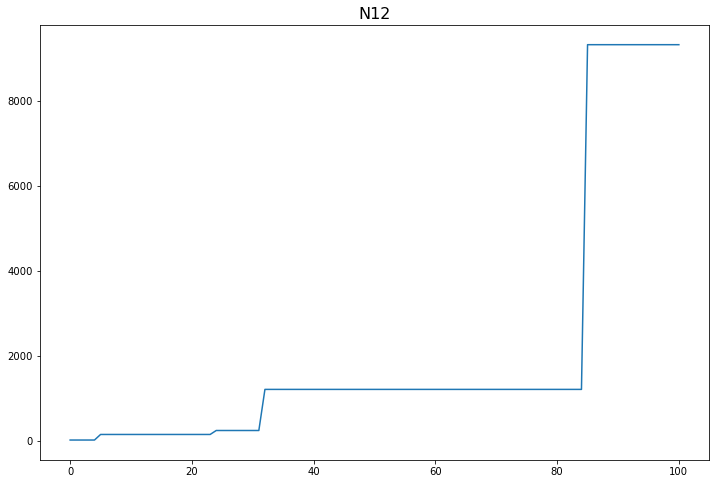

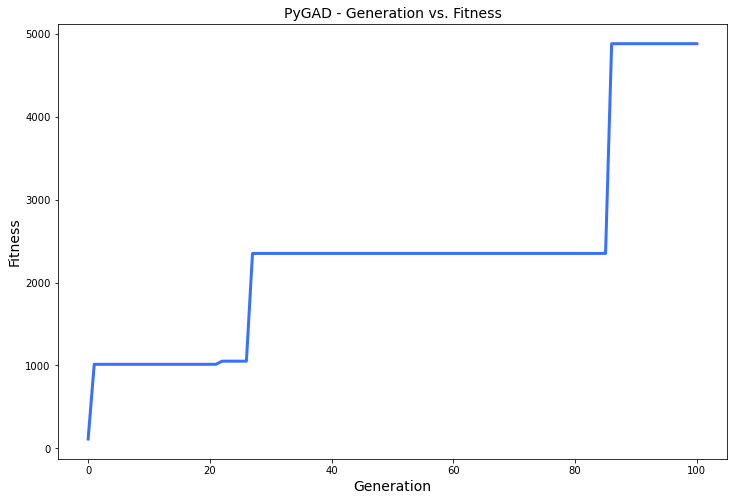

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 28.499 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 28.879 |==================| 17.882 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.413 |===========| 28.851 |==================| 35.739 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 28.853 |==================| 33.757 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 28.945 |==================| 8.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 28.843 |==================| 49.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.259 |===========| 28.528 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.239 |==================| 4.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.218 |==================| 4.534 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.16 |===========| 27.173 |==================| 5.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.506 |==================| 2.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |==================| 2.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 26.876 |==================| 8.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.095 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.506 |==================| 2.032 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |==================| 2.166 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 26.876 |==================| 8.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.095 |==================| 10.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.18 |==================| 5.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.526 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.712 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 26.876 |==================| 8.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.095 |==================| 10.286 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.147 |===========| 27.18 |==================| 5.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.351 |===========| 26.526 |==================| 2.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.712 |==================| 3.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.555 |==================| 2.259 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.479 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.345 |===========| 26.53 |==================| 2.135 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.495 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.903 |==================| 10.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.187 |==================| 5.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 26.825 |==================| 5.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 26.887 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.495 |==================| 1.99 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.903 |==================| 10.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.133 |===========| 27.187 |==================| 5.28 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.821 |===========| 26.825 |==================| 5.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.707 |===========| 26.887 |==================| 9.023 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.775 |==================| 4.494 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.849 |===========| 26.81 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.916 |==================| 12.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.328 |===========| 27.088 |==================| 11.123 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |==================| 29.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 26.811 |==================| 5.339 |==========
Generation = 3
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.1 |==================| 9.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.17 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |==================| 29.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.847 |===========| 26.811 |==================| 5.339 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.304 |===========| 27.1 |==================| 9.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.17 |==================| 5.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.219 |==================| 4.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.045 |===========| 26.701 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.255 |===========| 27.125 |==================| 7.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.057 |==================| 16.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.188 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.011 |==================| 75.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.006 |==================| 117.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.239 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.057 |==================| 16.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.131 |===========| 27.188 |==================| 5.256 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.475 |===========| 27.011 |==================| 75.062 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.006 |==================| 117.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.239 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.224 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.64 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.028 |===========| 27.239 |==================| 4.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.224 |==================| 4.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.597 |==================| 2.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.969 |==================| 34.175 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.791 |===========| 26.841 |==================| 6.388 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.511 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.223 |==================| 4.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 26.949 |==================| 20.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.221 |==================| 4.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.09 |==================| 10.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.857 |==================| 7.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.146 |==================| 6.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.565 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.593 |===========| 26.949 |==================| 20.292 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.221 |==================| 4.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.09 |==================| 10.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.763 |===========| 26.857 |==================| 7.079 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.214 |===========| 27.146 |==================| 6.744 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.283 |===========| 26.565 |==================| 2.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.049 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.706 |==================| 3.424 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.993 |===========| 26.73 |==================| 3.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.503 |==================| 2.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.008 |===========| 26.721 |==================| 3.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.98 |==================| 55.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.22 |==================| 4.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.017 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.98 |==================| 55.689 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.22 |==================| 4.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.017 |==================| 52.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.541 |==================| 2.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.02 |==================| 45.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.053 |==================| 18.183 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.093 |===========| 27.207 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.22 |==================| 4.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.017 |==================| 52.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.325 |===========| 26.541 |==================| 2.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.458 |===========| 27.02 |==================| 45.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.395 |===========| 27.053 |==================| 18.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.677 |==================| 3.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 26.984 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.073 |==================| 13.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.645 |===========| 26.92 |==================| 12.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 27.026 |==================| 35.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.117 |==================| 8.391 |==========
Fitness = 244.55172290571386
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.677 |==================| 3.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 26.984 |==================| 73.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |=====

======| 0.446 |===========| 27.026 |==================| 35.411 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.117 |==================| 8.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.087 |===========| 26.677 |==================| 3.117 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 26.984 |==================| 73.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.262 |===========| 27.122 |==================| 8.073 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.694 |===========| 26.894 |==================| 9.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.132 |===========| 27.187 |==================| 5.276 |==========
=====|SOLUTION|===========|OUTPUT|==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.056 |===========| 27.226 |==================| 4.392 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.492 |==================| 1.978 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.018 |===========| 27.244 |==================| 4.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.202 |==================| 4.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.745 |==================| 3.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 26.668 |==================| 3.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.0 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.965 |===========| 26.745 |==================| 3.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.103 |===========| 26.668 |==================| 3.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.0 |==================| 428.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.057 |===========| 27.225 |==================| 4.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.205 |===========| 27.151 |==================| 6.54 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.678 |===========| 26.903 |==================| 10.539 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.616 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.554 |===========| 26.969 |==================| 35.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.617 |===========| 26.936 |==================| 16.121 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.813 |==================| 5.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.603 |==================| 2.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 27.235 |==================| 4.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.204 |==================| 4.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.235 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.813 |==================| 5.402 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.218 |===========| 26.603 |==================| 2.53 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 27.235 |==================| 4.223 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.1 |===========| 27.204 |==================| 4.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.235 |==================| 4.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.634 |==================| 2.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.215 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.235 |==================| 4.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.634 |==================| 2.749 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.078 |===========| 27.215 |==================| 4.615 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.77 |==================| 4.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.058 |==================| 16.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.185 |==================| 5.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.791 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.481 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.594 |==========
Fitness = 428.54096710603733
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.77 |==================| 4.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.058 |==================| 16.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.185 |==================| 5.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.791 |==================| 4.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.77 |==================| 4.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.058 |==================| 16.656 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.138 |===========| 27.185 |==================| 5.357 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.791 |==================| 4.84 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.12 |==================| 8.214 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.025 |===========| 26.712 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.792 |===========| 26.841 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.146 |===========| 27.181 |==================| 5.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.569 |==================| 2.332 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 26.995 |==================| 365.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.721 |==================| 3.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.63 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.054 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.505 |===========| 26.995 |==================| 365.863 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.009 |===========| 26.721 |==================| 3.607 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.169 |===========| 26.63 |==================| 2.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.392 |===========| 27.054 |==================| 17.663 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.25 |==================| 3.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.313 |===========| 27.095 |==================| 10.24 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.238 |===========| 26.591 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 26.97 |==================| 35.513 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.072 |===========| 27.218 |==================| 4.551 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.39 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.209 |==================| 4.732 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.175 |==================| 5.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 26.866 |==================| 7.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.157 |===========| 27.175 |==================| 5.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 26.866 |==================| 7.569 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.916 |===========| 26.773 |==================| 4.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.064 |===========| 27.221 |==================| 4.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 26.884 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.838 |==================| 6.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.76 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.713 |===========| 26.884 |==================| 8.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.798 |===========| 26.838 |==================| 6.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.76 |==================| 4.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.966 |===========| 26.745 |==================| 3.95 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.113 |==================| 8.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.595 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.159 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.456 |===========| 27.021 |==================| 43.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.0 |==================| 474.242 |==========
Fitness = 474.2423227271277
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.595 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.159 |==================| 6.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.216 |==================| 4.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.977 |==================| 48.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.231 |===========| 26.595 |==================| 2.483 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.189 |===========| 27.159 |==================| 6.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.075 |===========| 27.216 |==================| 4.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.977 |==================| 48.599 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.491 |===========| 27.002 |==================| 221.45 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.875 |==================| 8.119 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.693 |===========| 26.895 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.766 |===========| 26.855 |==================| 7.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.767 |==================| 4.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.496 |==================| 1.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.761 |==================| 4.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 26.672 |==================| 3.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.712 |==================| 3.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.553 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.925 |===========| 26.767 |==================| 4.341 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.403 |===========| 26.496 |==================| 1.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.761 |==================| 4.226 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.096 |===========| 26.672 |==================| 3.069 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.024 |===========| 26.712 |==================| 3.503 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.303 |===========| 26.553 |==================| 2.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 26.651 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |==================| 10.589 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.67 |===========| 26.907 |==================| 11.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.563 |==================| 2.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.738 |==================| 3.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.799 |==================| 5.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.203 |==================| 4.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.163 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.799 |==================| 5.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.101 |===========| 27.203 |==================| 4.868 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.163 |==================| 6.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 26.915 |==================| 12.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.035 |==================| 27.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.716 |==================| 3.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.567 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.181 |===========| 27.163 |==================| 6.061 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 26.915 |==================| 12.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.43 |===========| 27.035 |==================| 27.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.017 |===========| 26.716 |==================| 3.554 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.567 |==================| 2.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.305 |===========| 27.1 |==================| 9.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.76 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.915 |===========| 26.773 |==================| 4.446 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.873 |==================| 8.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.823 |==================| 5.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 26.853 |==================| 6.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.138 |==================| 7.136 |==========
Fitness = 3417.2354433197743
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.062 |==================| 15.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.733 |===========| 26.873 |==================| 8.007 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.823 |==================| 5.721 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.77 |===========| 26.853 |==================| 6.911 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.23 |===========| 27.138 |==================| 7.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.062 |==================| 15.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.736 |===========| 26.872 |==================| 7.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.082 |===========| 26.68 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.526 |===========| 26.984 |==================| 71.952 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.13 |==================| 7.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.069 |==================| 14.134 |==========
Generation = 17
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.163 |==================| 6.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.441 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.934 |==================| 15.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.191 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.246 |===========| 27.13 |==================| 7.567 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.365 |===========| 27.069 |==================| 14.134 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.163 |==================| 6.051 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.441 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.934 |==================| 15.543 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.125 |===========| 27.191 |==================| 5.173 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.63 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 26.976 |==================| 46.614 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.065 |==================| 14.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.029 |===========| 27.239 |==================| 4.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.658 |==================| 2.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 26.603 |==================| 2.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.057 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.12 |===========| 26.658 |==================| 2.947 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.217 |===========| 26.603 |==================| 2.532 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.057 |==================| 16.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.035 |==================| 26.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.237 |==================| 4.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.015 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.387 |===========| 27.057 |==================| 16.862 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.429 |===========| 27.035 |==================| 26.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.033 |===========| 27.237 |==================| 4.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.467 |===========| 27.015 |==================| 57.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.709 |==================| 3.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.31 |===========| 27.097 |==================| 10.078 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.709 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.135 |===========| 27.186 |==================| 5.309 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.671 |===========| 26.907 |==================| 10.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.87 |==================| 7.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.195 |==================| 5.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.511 |==================| 2.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.87 |==================| 7.834 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.902 |===========| 26.78 |==================| 4.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.195 |==================| 5.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.376 |===========| 26.511 |==================| 2.055 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |==================| 54.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.757 |==================| 4.151 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.471 |===========| 26.456 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.446 |===========| 27.026 |==================| 35.368 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.082 |===========| 27.212 |==================| 4.659 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.402 |===========| 27.049 |==================| 19.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.599 |==================| 2.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 26.577 |==================| 2.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.465 |==================| 1.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.065 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.599 |==================| 2.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.262 |===========| 26.577 |==================| 2.378 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.456 |===========| 26.465 |==================| 1.875 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.065 |==================| 14.854 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.558 |==================| 2.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.923 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.176 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.558 |==================| 2.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.923 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.176 |==================| 5.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.617 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.973 |==================| 40.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |==================| 54.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.488 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.926 |===========| 26.767 |==================| 4.338 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.176 |==================| 5.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.617 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.973 |==================| 40.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |==================| 54.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.488 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.155 |===========| 27.176 |==================| 5.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.193 |===========| 26.617 |==================| 2.625 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.546 |===========| 26.973 |==================| 40.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.465 |===========| 27.016 |==================| 54.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.416 |===========| 26.488 |==================| 1.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.441 |===========| 27.029 |==================| 32.337 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.233 |==================| 4.252 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 26.753 |==================| 4.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.11 |==================| 8.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.755 |==================| 4.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.451 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.558 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.951 |===========| 26.753 |==================| 4.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.284 |===========| 27.11 |==================| 8.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.947 |===========| 26.755 |==================| 4.126 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.479 |===========| 26.451 |==================| 1.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.296 |===========| 26.558 |==================| 2.272 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.483 |===========| 27.007 |==================| 110.62 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.639 |===========| 26.924 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.07 |===========| 27.218 |==================| 4.533 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.272 |===========| 26.572 |==================| 2.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.227 |==================| 4.37 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.236 |===========| 27.135 |==================| 7.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.796 |==================| 4.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.992 |==================| 165.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.236 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.873 |===========| 26.796 |==================| 4.965 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.992 |==================| 165.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.236 |==================| 4.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.074 |==================| 13.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.221 |==================| 4.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.791 |==================| 4.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.167 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.992 |==================| 165.596 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.036 |===========| 27.236 |==================| 4.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.355 |===========| 27.074 |==================| 13.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.066 |===========| 27.221 |==================| 4.491 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.791 |==================| 4.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.167 |==================| 5.91 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.804 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.65 |===========| 26.918 |==================| 12.505 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.202 |==================| 4.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.665 |==================| 3.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.806 |==================| 5.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.943 |==================| 18.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.662 |==================| 2.976 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.202 |==================| 4.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.109 |===========| 26.665 |==================| 3.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.855 |===========| 26.806 |==================| 5.221 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.943 |==================| 18.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.662 |==================| 2.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.007 |==================| 105.047 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.241 |===========| 27.133 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.093 |==================| 10.531 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.203 |==================| 4.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.899 |==================| 10.111 |==========
Generation = 25
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.215 |==================| 4.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.508 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.913 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.102 |===========| 27.203 |==================| 4.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.899 |==================| 10.111 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.077 |===========| 27.215 |==================| 4.6 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.382 |===========| 26.508 |==================| 2.042 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.659 |===========| 26.913 |==================| 11.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.358 |===========| 26.522 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.635 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.685 |===========| 26.899 |==================| 10.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.453 |===========| 26.467 |==================| 1.883 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.222 |==================| 4.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.148 |==================| 6.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.01 |==================| 79.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.023 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.21 |===========| 27.148 |==================| 6.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.01 |==================| 79.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.023 |==================| 40.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.798 |==================| 5.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.115 |==================| 8.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 26.709 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.01 |==================| 79.193 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.453 |===========| 27.023 |==================| 40.212 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.87 |===========| 26.798 |==================| 5.0 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.275 |===========| 27.115 |==================| 8.553 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.295 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 26.709 |==================| 3.468 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.151 |===========| 27.178 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.578 |===========| 26.957 |==================| 24.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.743 |==================| 3.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.224 |==================| 4.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.546 |==================| 2.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 26.932 |==================| 15.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.799 |==================| 5.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.1 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.743 |==================| 3.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.059 |===========| 27.224 |==================| 4.422 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.317 |===========| 26.546 |==================| 2.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 26.932 |==================| 15.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.868 |===========| 26.799 |==================| 5.034 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.1 |==================| 9.75 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.708 |===========| 26.887 |==================| 8.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.527 |===========| 26.983 |==================| 68.827 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.561 |==================| 2.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.069 |==================| 14.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.532 |==================| 2.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.952 |==================| 21.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.561 |==================| 2.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.069 |==================| 14.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.532 |==================| 2.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.952 |==================| 21.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================| 4.679 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.199 |===========| 27.154 |==================| 6.417 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.069 |==================| 14.054 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.532 |==================| 2.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.586 |===========| 26.952 |==================| 21.881 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================| 4.679 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.492 |==================| 1.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.623 |==================| 2.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.677 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.285 |===========| 27.11 |==================| 8.94 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.409 |===========| 26.492 |==================| 1.977 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.623 |==================| 2.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.677 |==================| 3.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.71 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.202 |==================| 4.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.181 |===========| 26.623 |==================| 2.67 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.677 |==================| 3.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.71 |==================| 3.475 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.202 |==================| 4.899 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.507 |==================| 2.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.455 |==================| 1.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.698 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.79 |===========| 26.842 |==================| 6.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.232 |==================| 4.271 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.629 |===========| 26.929 |==================| 14.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.194 |==================| 5.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 26.576 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.015 |==================| 58.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.009 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.12 |===========| 27.194 |==================| 5.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.265 |===========| 26.576 |==================| 2.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.015 |==================| 58.486 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.009 |==================| 86.897 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.496 |===========| 27.0 |==================| 496.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.167 |===========| 27.17 |==================| 5.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.618 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.051 |==================| 18.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.06 |===========| 27.223 |==================| 4.433 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.051 |===========| 26.697 |==================| 3.327 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.166 |==================| 5.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.874 |==================| 8.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.599 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.174 |===========| 27.166 |==================| 5.938 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.874 |==================| 8.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.599 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================| 8.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.25 |==================| 3.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.132 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.732 |===========| 26.874 |==================| 8.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.224 |===========| 26.599 |==================| 2.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================| 8.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.25 |==================| 3.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.425 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.242 |===========| 27.132 |==================| 7.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 26.996 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.91 |===========| 26.776 |==================| 4.509 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.282 |===========| 27.112 |==================| 8.791 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.503 |===========| 26.996 |==================| 652.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.014 |==================| 63.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.45 |==================| 1.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.323 |===========| 26.542 |==================| 2.194 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.014 |==================| 63.752 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.45 |==================| 1.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.704 |===========| 26.889 |==================| 9.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.187 |===========| 26.62 |==================| 2.646 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.235 |==================| 4.222 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.505 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.077 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.489 |===========| 27.003 |==================| 178.205 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.112 |===========| 26.663 |==================| 2.983 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.251 |===========| 27.127 |==================| 7.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.077 |==================| 12.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 26.807 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.778 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.077 |==================| 12.684 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.854 |===========| 26.807 |==================| 5.236 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.778 |==================| 4.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.246 |==================| 4.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.972 |===========| 26.742 |==================| 3.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.017 |==================| 51.477 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.121 |===========| 27.193 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.44 |===========| 26.474 |==================| 1.909 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.572 |==================| 2.349 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.072 |==================| 13.434 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.278 |===========| 27.113 |==================| 8.655 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.194 |==================| 5.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.107 |==================| 9.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.205 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.119 |===========| 27.194 |==================| 5.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.291 |===========| 27.107 |==================| 9.182 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.205 |==================| 4.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 26.581 |==================| 2.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.778 |==================| 4.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.497 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.147 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.256 |===========| 26.581 |==================| 2.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.907 |===========| 26.778 |==================| 4.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.497 |==================| 1.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.211 |===========| 27.147 |==================| 6.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.992 |==================| 172.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.709 |==================| 3.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.14 |==================| 7.017 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.458 |==================| 1.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.98 |==================| 55.786 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.992 |==================| 172.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.709 |==================| 3.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.468 |===========| 26.458 |==================| 1.852 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.534 |===========| 26.98 |==================| 55.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.511 |===========| 26.992 |==================| 172.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.031 |===========| 26.709 |==================| 3.457 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.346 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.438 |===========| 26.475 |==================| 1.913 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.942 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.367 |===========| 26.516 |==================| 2.077 |==========
Generation = 36
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.054 |===========| 27.226 |==================| 4.376 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.353 |===========| 27.075 |==================| 12.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.461 |==================| 1.864 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.013 |==================| 64.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.034 |==================| 27.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.008 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.47 |===========| 27.013 |==================| 64.22 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.431 |===========| 27.034 |==================| 27.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.008 |==================| 102.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.551 |===========| 26.971 |==================| 36.748 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.089 |===========| 27.209 |==================| 4.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.881 |==================| 8.547 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.098 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.172 |==================| 5.726 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.903 |===========| 26.78 |==================| 4.584 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.615 |===========| 26.936 |==================| 16.288 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.088 |===========| 26.676 |==================| 3.108 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.036 |==================| 25.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |==================| 60.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.043 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.427 |===========| 27.036 |==================| 25.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |==================| 60.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.043 |==================| 22.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.977 |==================| 48.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.731 |==================| 3.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.153 |==================| 6.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.221 |============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.469 |===========| 27.014 |==================| 60.314 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.414 |===========| 27.043 |==================| 22.137 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.539 |===========| 26.977 |==================| 48.056 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.992 |===========| 26.731 |==================| 3.741 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.153 |==================| 6.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.065 |===========| 27.221 |==================| 4.482 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.667 |=============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.114 |==================| 8.585 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.791 |==================| 4.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.481 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.03 |==================| 31.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.962 |==================| 28.232 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.871 |==================| 7.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |==========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.883 |===========| 26.791 |==================| 4.83 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.428 |===========| 26.481 |==================| 1.934 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.439 |===========| 27.03 |==================| 31.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.962 |==================| 28.232 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.738 |===========| 26.871 |==================| 7.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.16 |===========| 26.635 |==================| 2.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.058 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.611 |===========| 26.939 |==================| 16.961 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.054 |==================| 17.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.198 |==================| 5.005 |==========
Generation = 39
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.969 |==================| 34.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.102 |==================| 9.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.725 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.054 |==================| 17.767 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.198 |==================| 5.005 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.555 |===========| 26.969 |==================| 34.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.008 |===========| 27.249 |==================| 3.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.3 |===========| 27.102 |==================| 9.571 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.001 |===========| 26.725 |==================| 3.668 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.869 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.168 |==================| 5.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.083 |===========| 27.212 |==================| 4.673 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.054 |==================| 17.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.067 |==================| 14.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.122 |==================| 8.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 26.558 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.393 |===========| 27.054 |==================| 17.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.368 |===========| 27.067 |==================| 14.506 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.261 |===========| 27.122 |==================| 8.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.295 |===========| 26.558 |==================| 2.273 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.734 |==================| 3.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.069 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.734 |==================| 3.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.069 |==================| 14.033 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.472 |==================| 1.903 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.147 |===========| 26.643 |==================| 2.816 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.231 |===========| 27.137 |==================| 7.174 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.999 |===========| 26.726 |==================| 3.68 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.77 |==================| 4.396 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.84 |===========| 26.815 |==================| 5.456 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.09 |==================| 10.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.895 |==================| 9.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.859 |==================| 7.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.174 |==================| 5

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.323 |===========| 27.09 |==================| 10.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.692 |===========| 26.895 |==================| 9.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.758 |===========| 26.859 |==================| 7.225 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.174 |==================| 5.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.567 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.569 |==================| 2.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.398 |===========| 27.052 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.001 |===========| 27.253 |==================| 3.924 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.15 |===========| 26.641 |==================| 2.804 |==========
Generation = 42
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.813 |===========| 26.829 |==================| 5.932 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.106 |===========| 27.201 |==================| 4.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.141 |==================| 7.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.503 |==================| 2.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 26.652 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.225 |===========| 27.141 |==================| 7.001 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.391 |===========| 26.503 |==================| 2.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 26.652 |==================| 2.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.118 |==================| 8.322 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.991 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.016 |===========| 27.245 |==================| 4.04 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.112 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.592 |===========| 26.949 |==================| 20.5 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.869 |==================| 7.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.23 |==================| 4.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.179 |==================| 5.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.626 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.179 |==================| 5.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.714 |==================| 3.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.741 |===========| 26.869 |==================| 7.733 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.23 |==================| 4.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.179 |==================| 5.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.626 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.179 |==================| 5.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.714 |==================| 3.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 26.619 |==================| 2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.046 |===========| 27.23 |==================| 4.3 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.179 |==================| 5.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.626 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.148 |===========| 27.179 |==================| 5.508 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.02 |===========| 26.714 |==================| 3.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.188 |===========| 26.619 |==================| 2.643 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.86 |==================| 7.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.785 |===========| 26.845 |==================| 6.541 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.86 |==================| 7.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.612 |==================| 2.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.52 |==================| 2.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.118 |==================| 8.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.196 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.756 |===========| 26.86 |==================| 7.27 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.202 |===========| 26.612 |==================| 2.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.52 |==================| 2.092 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.269 |===========| 27.118 |==================| 8.305 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.005 |===========| 26.723 |==================| 3.637 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.116 |===========| 27.196 |==================| 5.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.2 |==================| 4.

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.237 |===========| 27.134 |==================| 7.325 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.181 |==================| 5.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.875 |==================| 8.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.5 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.206 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.44 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.181 |==================| 5.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.875 |==================| 8.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.5 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.206 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.44 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.178 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.181 |==================| 5.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.875 |==================| 8.118 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.396 |===========| 26.5 |==================| 2.008 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.094 |===========| 27.206 |==================| 4.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.497 |===========| 26.44 |==================| 1.794 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.152 |===========| 27.178 |==================| 5.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.449 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.39 |===========| 27.056 |==================| 17.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.357 |===========| 27.073 |==================| 13.364 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.263 |===========| 26.576 |==================| 2.373 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.114 |===========| 26.661 |==================| 2.972 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.467 |==================| 1.885 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.835 |==================| 6.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |=========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.467 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.802 |===========| 26.835 |==================| 6.15 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.364 |===========| 27.069 |==================| 14.053 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.596 |==================| 2.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.139 |===========| 27.184 |==================| 5.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.938 |===========| 26.76 |==================| 4.213 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.432 |===========| 27.034 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.263 |===========| 27.121 |==================| 8.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.266 |===========| 27.12 |==================| 8.211 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.342 |===========| 27.08 |==================| 12.101 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.227 |===========| 26.597 |==================| 2.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 26.71 |==================| 3.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.856 |==================| 7.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 26.498 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.029 |===========| 26.71 |==================| 3.469 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.764 |===========| 26.856 |==================| 7.046 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.398 |===========| 26.498 |==================| 2.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================| 4.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================| 16.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.377 |===========| 27.062 |==================| 15.564 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.553 |===========| 26.97 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.3 |===========| 26.555 |==================| 2.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.477 |===========| 26.452 |==================| 1.832 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.775 |==================| 4.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.012 |==================| 69.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.072 |==================| 13.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.045 |==================| 21.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.929 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.911 |===========| 26.775 |==================| 4.497 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.012 |==================| 69.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.072 |==================| 13.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.045 |==================| 21.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.929 |==================| 14.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.827 |==================| 5.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.741 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.473 |===========| 27.012 |==================| 69.037 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.358 |===========| 27.072 |==================| 13.485 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.411 |===========| 27.045 |==================| 21.32 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.929 |==================| 14.435 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.817 |===========| 26.827 |==================| 5.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.973 |===========| 26.741 |==================| 3.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 26.866 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.133 |==================| 7.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.479 |==================| 1.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.927 |==================| 14.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.085 |==================| 11.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 26.75 |==================| 4.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.043 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.08 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.634 |===========| 26.927 |==================| 14.022 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.085 |==================| 11.428 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.956 |===========| 26.75 |==================| 4.041 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.415 |===========| 27.043 |==================| 22.344 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.348 |===========| 27.078 |==================| 12.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.074 |===========| 27.216 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |==================| 4.019 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.132 |===========| 26.651 |==================| 2.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.298 |===========| 27.103 |==================| 9.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.291 |===========| 26.561 |==================| 2.287 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.507 |==================| 2.037 |==========
Generation = 50
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |==================| 4.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.905 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.384 |===========| 26.507 |==================| 2.037 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |==================| 4.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.674 |===========| 26.905 |==================| 10.736 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.86 |===========| 26.804 |==================| 5.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.418 |===========| 26.487 |==================| 1.957 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.541 |===========| 26.976 |==================| 45.671 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.119 |===========| 26.659 |===

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.689 |===========| 26.897 |==================| 9.919 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.77 |==================| 4.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.099 |===========| 27.204 |==================| 4.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |==================| 5.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |==================| 10.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.104 |==================| 9.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.74 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.149 |===========| 27.179 |==================| 5.52 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |==================| 10.578 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.104 |==================| 9.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.74 |==================| 3.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.183 |==================| 5.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.943 |==================| 18.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.776 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.104 |==================| 9.382 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.975 |===========| 26.74 |==================| 3.871 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.183 |==================| 5.397 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.603 |===========| 26.943 |==================| 18.278 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.776 |==================| 4.518 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 27.21 |==================| 4.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.213 |===========| 26.606 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.476 |===========| 27.011 |==================| 78.201 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.52 |==================| 2.091 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.133 |==================| 7.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.105 |==================| 9.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.098 |==================| 9.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |==================| 6.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.027 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.24 |===========| 27.133 |==================| 7.418 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.295 |===========| 27.105 |==================| 9.366 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.307 |===========| 27.098 |==================| 9.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.786 |===========| 26.844 |==================| 6.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.445 |===========| 27.027 |==================| 34.403 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.361 |===========| 27.071 |==================| 13.698 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.906 |===========| 26.778 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.326 |===========| 26.541 |==================| 2.187 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.689 |==================| 3.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.192 |==================| 5.14 |==========
Generation = 53
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.732 |==================| 3.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.201 |==================| 4.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.57 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.919 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.689 |==================| 3.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.192 |==================| 5.14 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.988 |===========| 26.732 |==================| 3.766 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.105 |===========| 27.201 |==================| 4.925 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.57 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.648 |===========| 26.919 |==================| 12.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.985 |===========| 26.734 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.122 |===========| 27.192 |==================| 5.14 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.109 |==================| 9.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.143 |==================| 6.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.925 |==================| 13.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.441 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.938 |==================| 16.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.942 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.287 |===========| 27.109 |==================| 9.014 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.143 |==================| 6.878 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.925 |==================| 13.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.441 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.938 |==================| 16.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.942 |==================| 17.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.636 |===========| 26.925 |==================| 13.818 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.496 |===========| 26.441 |==================| 1.797 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.613 |===========| 26.938 |==================| 16.624 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.605 |===========| 26.942 |==================| 17.958 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |==================| 5.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.19 |===========| 26.618 |==================| 2.634 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.162 |===========| 27.173 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.086 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.651 |==================| 2.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.61 |==================| 2.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.096 |==================| 10.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.855 |==================| 6.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.88 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.281 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.651 |==================| 2.884 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.206 |===========| 26.61 |==================| 2.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.311 |===========| 27.096 |==================| 10.152 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.855 |==================| 6.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.719 |===========| 26.88 |==================| 8.521 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.023 |===========| 26.713 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.549 |===========| 26.972 |==================| 38.544 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.025 |===========| 27.241 |==================| 4.115 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.929 |==================| 14.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.606 |==================| 2.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 26.905 |==================| 10.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.813 |==================| 5.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.63 |===========| 26.929 |==================| 14.444 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.212 |===========| 26.606 |==================| 2.55 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.675 |===========| 26.905 |==================| 10.723 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.813 |==================| 5.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.056 |==================| 17.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.629 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.843 |===========| 26.813 |==================| 5.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.946 |===========| 26.756 |==================| 4.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.389 |===========| 27.056 |==================| 17.199 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.172 |===========| 26.629 |==================| 2.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.633 |===========| 26.927 |==================| 14.165 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.038 |===========| 27.234 |==================| 4.23 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.125 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.822 |===========| 26.825 |==================| 5.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.209 |==================| 4.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.57 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.892 |==================| 9.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.121 |==================| 8.134 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.125 |==================| 7.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.09 |===========| 27.209 |==================| 4.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.274 |===========| 26.57 |==================| 2.339 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.698 |===========| 26.892 |==================| 9.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.264 |===========| 27.121 |==================| 8.134 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.256 |===========| 27.125 |==================| 7.87 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.011 |===========| 27.248 |==================| 4.002 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.198 |===========| 26.614 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.912 |===========| 26.775 |==================| 4.479 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.113 |==================| 8.681 |==========
Generation = 58
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.45 |==================| 1.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.975 |==================| 44.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.173 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.638 |=

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.113 |==================| 8.681 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.481 |===========| 26.45 |==================| 1.825 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.543 |===========| 26.975 |==================| 44.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.161 |===========| 27.173 |==================| 5.713 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.155 |===========| 26.638 |==================| 2.78 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.196 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.113 |==================| 8.681 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.62 |===========| 26.934 |==================| 15.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.061 |==================| 15.755 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.16 |==================| 6.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 26.626 |==================| 2.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.566 |==================| 2.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.957 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.188 |===========| 27.16 |==================| 6.186 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 26.626 |==================| 2.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.566 |==================| 2.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.957 |==================| 24.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.802 |==================| 5.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.71 |==================| 3.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.875 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.177 |===========| 26.626 |==================| 2.688 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.281 |===========| 26.566 |==================| 2.316 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.576 |===========| 26.957 |==================| 24.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.863 |===========| 26.802 |==================| 5.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.028 |===========| 26.71 |==================| 3.474 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.73 |===========| 26.875 |==================| 8.136 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.656 |===========| 26.915 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.513 |===========| 26.991 |==================| 150.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.142 |==================| 6.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.687 |==================| 3.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 26.94 |==================| 17.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.067 |==================| 14.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.943 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.222 |===========| 27.142 |==================| 6.945 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.069 |===========| 26.687 |==================| 3.218 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.609 |===========| 26.94 |==================| 17.33 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.369 |===========| 27.067 |==================| 14.562 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.604 |===========| 26.943 |==================| 18.162 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.159 |===========| 27.174 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.468 |===========| 27.015 |==================| 58.955 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.036 |==================| 26.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.216 |==================| 4.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 26.932 |==================| 15.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.667 |==================| 3.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.022 |==================| 41.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.428 |===========| 27.036 |==================| 26.246 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.076 |===========| 27.216 |==================| 4.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.623 |===========| 26.932 |==================| 15.25 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.104 |===========| 26.667 |==================| 3.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.022 |==================| 41.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |==================| 5.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.086 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.455 |===========| 27.022 |==================| 41.769 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.127 |===========| 27.19 |==================| 5.207 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.331 |===========| 27.086 |==================| 11.324 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.012 |==================| 71.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.498 |==================| 1.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.462 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.271 |===========| 27.117 |==================| 8.398 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.851 |==================| 6.804 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.012 |==================| 71.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.498 |==================| 1.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.462 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.774 |===========| 26.851 |==================| 6.804 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.474 |===========| 27.012 |==================| 71.937 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.36 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.4 |===========| 26.498 |==================| 1.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.461 |===========| 26.462 |==================| 1.865 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.628 |===========| 26.93 |==================| 14.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.596 |===========| 26.947 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.244 |===========| 26.588 |==================| 2.438 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.222 |==================| 4.459 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.235 |==================| 4.217 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.806 |===========| 26.833 |==================| 6.065 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.618 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.534 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.191 |===========| 26.618 |==================| 2.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.18 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.534 |==================| 2.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.349 |===========| 27.077 |==================| 12.662 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.444 |==================| 1.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.185 |===========| 27.161 |==================| 6.141 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.05 |===========| 26.698 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.381 |===========| 27.06 |==================| 16.035 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.01 |===========| 26.72 |==================| 3.602 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.425 |===========| 26.483 |==================| 1.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.887 |===========| 26.789 |==================| 4.782 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.823 |==================| 5.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.517 |==================| 2.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.567 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.825 |===========| 26.823 |==================| 5.71 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.517 |==================| 2.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.567 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 26.866 |==================| 7.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.976 |==================| 45.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.63 |==================| 2.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.065 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.366 |===========| 26.517 |==================| 2.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.279 |===========| 26.567 |==================| 2.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.746 |===========| 26.866 |==================| 7.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.542 |===========| 26.976 |==================| 45.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.17 |===========| 26.63 |==================| 2.718 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.065 |==================| 14.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.653 |===========| 26.916 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.666 |===========| 26.909 |==================| 11.267 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.153 |==================| 6.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.02 |==================| 46.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.176 |==================| 5.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.018 |==================| 48.516 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 26.652 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.201 |===========| 27.153 |==================| 6.466 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.02 |==================| 46.176 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.154 |===========| 27.176 |==================| 5.603 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.461 |===========| 27.018 |==================| 48.516 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.131 |===========| 26.652 |==================| 2.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.214 |===========| 26.605 |==================| 2.546 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.308 |===========| 27.098 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.142 |===========| 27.183 |==================| 5.414 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.909 |===========| 26.776 |==================| 4.517 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.243 |==================| 4.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.52 |==================| 2.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.953 |==================| 22.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.017 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.02 |===========| 27.243 |==================| 4.072 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.36 |===========| 26.52 |==================| 2.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.752 |===========| 26.863 |==================| 7.412 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.585 |===========| 26.953 |==================| 22.251 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.464 |===========| 27.017 |==================| 52.038 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.145 |===========| 27.181 |==================| 5.462 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.463 |===========| 27.018 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.04 |==================| 23.96 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.757 |==================| 4.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.219 |==================| 4.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.026 |==================| 35.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.04 |==================| 23.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 26.529 |==================| 2.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.962 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.945 |===========| 26.757 |==================| 4.145 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.219 |==================| 4.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.026 |==================| 35.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.04 |==================| 23.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 26.529 |==================| 2.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.962 |==================| 28.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.771 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.069 |===========| 27.219 |==================| 4.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.447 |===========| 27.026 |==================| 35.974 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.421 |===========| 27.04 |==================| 23.996 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.346 |===========| 26.529 |==================| 2.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.567 |===========| 26.962 |==================| 28.279 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.92 |===========| 26.771 |==================| 4.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.471 |===========| 27.013 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.676 |===========| 26.904 |==================| 10.661 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.341 |===========| 26.531 |==================| 2.144 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.682 |===========| 26.9 |==================| 10.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.242 |==================| 4.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.091 |==================| 10.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 26.625 |==================| 2.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.572 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.022 |===========| 27.242 |==================| 4.088 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.091 |==================| 10.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.178 |===========| 26.625 |==================| 2.685 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.271 |===========| 26.572 |==================| 2.347 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.093 |===========| 26.674 |==================| 3.084 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.537 |===========| 26.978 |==================| 50.815 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.296 |===========| 27.104 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.145 |==================| 6.799 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.169 |==================| 5.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 27.253 |==================| 3.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 26.61 |==================| 2.581 |==========
Generation = 69
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 26.718 |==================| 3.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.124 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.168 |===========| 27.169 |==================| 5.833 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 27.253 |==================| 3.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 26.61 |==================| 2.581 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.014 |===========| 26.718 |==================| 3.57 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.257 |===========| 27.124 |==================| 7.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.245 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.0 |===========| 27.253 |==================| 3.92 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.204 |===========| 26.61 |==================| 2.581 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.675 |==================| 3.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.82 |==================| 5.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.205 |==================| 4.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.2

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.688 |===========| 26.897 |==================| 9.946 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.031 |==================| 30.427 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.675 |==================| 3.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.82 |==================| 5.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.205 |==================| 4.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.438 |===========| 27.031 |==================| 30.427 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.09 |===========| 26.675 |==================| 3.102 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.83 |===========| 26.82 |==================| 5.618 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.097 |===========| 27.205 |==================| 4.829 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.588 |===========| 26.951 |==================| 21.328 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.004 |===========| 27.251 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.222 |==================| 4.455 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.796 |==================| 4.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.793 |==================| 4.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.25 |==================| 3.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.56 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.854 |==================| 6.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 27.021 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.874 |===========| 26.796 |==================| 4.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.878 |===========| 26.793 |==================| 4.891 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.006 |===========| 27.25 |==================| 3.966 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.292 |===========| 26.56 |==================| 2.284 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.854 |==================| 6.935 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.457 |===========| 27.021 |==================| 44.082 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.993 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.107 |===========| 27.2 |==================| 4.942 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 26.597 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.212 |==================| 4.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.612 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 27.016 |==================| 55.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.202 |==================| 4.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.114 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.228 |===========| 26.597 |==================| 2.492 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.212 |==================| 4.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.612 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 27.016 |==================| 55.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.202 |==================| 4.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.114 |==================| 8.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.162 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.212 |==================| 4.676 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.612 |==================| 2.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.466 |===========| 27.016 |==================| 55.527 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.104 |===========| 27.202 |==================| 4.908 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.114 |==================| 8.579 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.162 |==================| 6.096 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.077 |===========| 26.683 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.655 |===========| 26.915 |==================| 12.128 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.444 |==================| 1.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.846 |==================| 6.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.134 |==================| 7.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.194 |==================| 5.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.458 |==================| 1.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.444 |==================| 1.806 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.782 |===========| 26.846 |==================| 6.595 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.239 |===========| 27.134 |==================| 7.369 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.118 |===========| 27.194 |==================| 5.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.458 |==================| 1.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |==================| 30.139 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.935 |===========| 26.762 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.201 |===========| 26.612 |==================| 2.592 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.065 |==================| 14.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================| 4.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.1 |==================| 9.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.754 |==================| 4.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |==================| 2.167 |==========
Generation = 74
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.371 |===========| 27.065 |==================| 14.793 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================| 4.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.1 |==================| 9.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.754 |==================| 4.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |==================| 2.167 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.258 |===========| 27.124 |==================| 7.944 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.385 |===========| 27.058 |=====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.895 |===========| 26.784 |==================| 4.683 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.303 |===========| 27.1 |==================| 9.759 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.95 |===========| 26.754 |==================| 4.094 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.333 |===========| 26.536 |==================| 2.167 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.792 |==================| 4.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.994 |==================| 247.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.882 |===========| 26.792 |==================| 4.847 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.508 |===========| 26.994 |==================| 247.63 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================| 46.493 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.443 |===========| 26.472 |==================| 1.902 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.147 |==================| 6.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.634 |==================| 2.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.091 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.212 |===========| 27.147 |==================| 6.693 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.162 |===========| 26.634 |==================| 2.751 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.322 |===========| 27.091 |==================| 10.746 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.281 |===========| 27.112 |==================| 8.785 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.56 |===========| 26.966 |==================| 31.501 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.103 |==================| 9.472 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.482 |===========| 27.007 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.775 |===========| 26.85 |==================| 6.771 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.157 |===========| 26.637 |==================| 2.775 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.086 |===========| 26.677 |==================| 3.12 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.484 |===========| 27.007 |==================| 115.338 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.166 |==================| 5.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.738 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.166 |==================| 5.951 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.978 |===========| 26.738 |==================| 3.846 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |==================| 10.604 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.318 |===========| 26.545 |==================| 2.208 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.728 |===========| 26.876 |==================| 8.183 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.49 |===========| 26.445 |==================| 1.808 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.711 |===========| 26.885 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.103 |===========| 27.202 |==================| 4.892 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.382 |===========| 27.06 |==================| 16.104 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.751 |===========| 26.863 |==================| 7.439 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.184 |===========| 27.162 |==================| 6.109 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.196 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.22 |==================| 4.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.801 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.115 |===========| 27.196 |==================| 5.043 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.22 |==================| 4.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.801 |==================| 5.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.111 |==================| 8.859 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.316 |===========| 27.094 |==================| 10.391 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.333 |===========| 27.085 |==================| 11.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.995 |===========| 26.729 |==

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.22 |==================| 4.511 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.801 |==================| 5.081 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.283 |===========| 27.111 |==================| 8.859 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.314 |===========| 27.095 |==================| 10.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.056 |==================| 17.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.76 |==================| 4.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.985 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.388 |===========| 27.056 |==================| 17.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.939 |===========| 26.76 |==================| 4.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.524 |===========| 26.985 |==================| 79.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.2 |===========| 26.613 |==================| 2.597 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.044 |==================| 21.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.005 |==================| 136.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.241 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.412 |===========| 27.044 |==================| 21.631 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.486 |===========| 27.005 |==================| 136.836 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.024 |===========| 27.241 |==================| 4.111 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.444 |===========| 27.027 |==================| 34.006 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.574 |===========| 26.958 |==================| 25.408 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.336 |===========| 26.535 |==================| 2.159 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.937 |===========| 26.761 |===========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.318 |===========| 27.093 |==================| 10.536 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.056 |===========| 26.694 |==================| 3.294 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.771 |==================| 4.41 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.478 |===========| 27.01 |==================| 85.786 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.867 |==================| 7.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 26.918 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.744 |===========| 26.867 |==================| 7.633 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.196 |===========| 27.155 |==================| 6.359 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.649 |===========| 26.918 |==================| 12.594 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.007 |===========| 27.25 |==================| 3.968 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.05 |===========| 27.228 |==================| 4.336 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.424 |===========| 26.483 |==================| 1.943 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.071 |===========| 26.686 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.05 |==================| 19.334 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.133 |===========| 26.651 |==================| 2.88 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.075 |==================| 12.898 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.121 |===========| 26.658 |==================| 2.939 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.621 |==================| 2.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.91 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.185 |===========| 26.621 |==================| 2.657 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.844 |===========| 26.812 |==================| 5.393 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.665 |===========| 26.91 |==================| 11.362 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.22 |===========| 27.143 |==================| 6.896 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.166 |===========| 27.171 |==================| 5.79 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.28 |===========| 27.112 |==================| 8.734 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.18 |===========| 27.163 |=======

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.063 |===========| 27.222 |==================| 4.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.103 |==================| 9.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.616 |==================| 2.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.005 |==================| 147.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.186 |==================| 5.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.05 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.297 |===========| 27.103 |==================| 9.471 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.616 |==================| 2.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.005 |==================| 147.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.186 |==================| 5.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.05 |==================| 19.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.99 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.194 |===========| 26.616 |==================| 2.619 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.997 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.487 |===========| 27.005 |==================| 147.814 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.136 |===========| 27.186 |==================| 5.323 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.4 |===========| 27.05 |==================| 19.026 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.514 |===========| 26.99 |==================| 131.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.33 |===========| 26.538 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.976 |===========| 26.739 |==================| 3.866 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.172 |===========| 27.167 |==================| 5.907 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.184 |===========| 26.622 |==================| 2.658 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.626 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.162 |==================| 6.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.782 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.061 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.176 |===========| 26.626 |==================| 2.691 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.183 |===========| 27.162 |==================| 6.1 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.899 |===========| 26.782 |==================| 4.628 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.379 |===========| 27.061 |==================| 15.762 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.279 |===========| 27.113 |==================| 8.707 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.265 |===========| 27.12 |==================| 8.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.087 |===========| 27.21 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.452 |===========| 27.023 |==================| 39.725 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.771 |==================| 4.407 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.432 |===========| 26.479 |==================| 1.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.246 |==================| 4.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.232 |==================| 4.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 26.532 |==================| 2.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.078 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.015 |===========| 27.246 |==================| 4.03 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.232 |==================| 4.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 26.532 |==================| 2.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.078 |==================| 12.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 26.83 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.52 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.043 |===========| 27.232 |==================| 4.276 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.34 |===========| 26.532 |==================| 2.147 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.346 |===========| 27.078 |==================| 12.406 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.812 |===========| 26.83 |==================| 5.954 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.182 |===========| 27.162 |==================| 6.076 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.361 |===========| 26.52 |==================| 2.093 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.474 |===========| 26.454 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |==================| 10.586 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.019 |===========| 27.244 |==================| 4.064 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.462 |===========| 27.018 |==================| 49.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.024 |==================| 37.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.444 |==================| 1.807 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |========

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.45 |===========| 27.024 |==================| 37.994 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.986 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.491 |===========| 26.444 |==================| 1.807 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.26 |===========| 27.123 |==================| 8.013 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.771 |===========| 26.852 |==================| 6.876 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.842 |===========| 26.814 |==================| 5.429 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.734 |===========| 26.872 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.566 |===========| 26.963 |==================| 28.606 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.169 |==================| 5.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.025 |==================| 36.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================| 8.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.534 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.705 |==================| 3.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.222 |==============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.169 |===========| 27.169 |==================| 5.843 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.448 |===========| 27.025 |==================| 36.375 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.273 |===========| 27.116 |==================| 8.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.337 |===========| 26.534 |==================| 2.155 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.036 |===========| 26.705 |==================| 3.419 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.062 |===========| 27.222 |==================| 4.454 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.631 |===========| 26.928 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.068 |===========| 27.219 |==================| 4.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.215 |===========| 27.146 |==================| 6.768 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.129 |==================| 7.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |==================| 4.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.012 |==================| 68.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.183 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 26.679 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.248 |===========| 27.129 |==================| 7.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |==================| 4.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.012 |==================| 68.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.183 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 26.679 |==================| 3.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.08 |==================| 12.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 26.627 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.052 |===========| 27.228 |==================| 4.351 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.472 |===========| 27.012 |==================| 68.674 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.14 |===========| 27.183 |==================| 5.387 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.084 |===========| 26.679 |==================| 3.133 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.08 |==================| 12.191 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.175 |===========| 26.627 |==================| 2.695 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.127 |===========| 26.654 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.485 |===========| 27.006 |==================| 123.774 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.598 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.233 |==================| 4.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.681 |==================| 3.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.933 |==================| 15.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.107 |==================| 9.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 26.696 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.225 |===========| 26.598 |==================| 2.504 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.042 |===========| 27.233 |==================| 4.26 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.079 |===========| 26.681 |==================| 3.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.621 |===========| 26.933 |==================| 15.515 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.29 |===========| 27.107 |==================| 9.16 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.053 |===========| 26.696 |==================| 3.311 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.353 |===========| 26.525 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.654 |===========| 26.916 |==================| 12.177 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.689 |==================| 3.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.569 |==================| 2.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.242 |==================| 4.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.804 |==================| 5.166 |==========
Generation = 88
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.804 |==================| 5.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.765 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.065 |===========| 26.689 |==================| 3.241 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.276 |===========| 26.569 |==================| 2.333 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.023 |===========| 27.242 |==================| 4.097 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.804 |==================| 5.166 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.859 |===========| 26.804 |==================| 5.161 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.93 |===========| 26.765 |==================| 4.293 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.289 |===========| 27.108 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.767 |===========| 26.855 |==================| 6.976 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.406 |===========| 26.494 |==================| 1.985 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.719 |==================| 3.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.091 |==================| 10.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.596 |==================| 2.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.822 |==================| 5.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.457 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.012 |===========| 26.719 |==================| 3.59 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.091 |==================| 10.72 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.229 |===========| 26.596 |==================| 2.49 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.822 |==================| 5.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.457 |==================| 1.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.197 |==================| 5.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.827 |===========| 26.822 |==================| 5.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.469 |===========| 26.457 |==================| 1.85 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.113 |===========| 27.197 |==================| 5.025 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.013 |===========| 27.247 |==================| 4.02 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.407 |===========| 26.493 |==================| 1.982 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.53 |===========| 26.982 |==================| 63.941 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.052 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.138 |===========| 26.648 |==================| 2.858 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.203 |===========| 27.152 |==================| 6.498 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.13 |===========| 27.189 |==================| 5.238 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.338 |===========| 26.534 |==================| 2.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.879 |==================| 8.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.592 |==================| 2.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.56 |==================| 

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.722 |===========| 26.879 |==================| 8.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.592 |==================| 2.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.293 |===========| 26.56 |==================| 2.282 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.961 |===========| 26.748 |==================| 3.999 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.426 |===========| 27.037 |==================| 25.705 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.893 |===========| 26.785 |==================| 4.709 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.112 |===========| 27.198 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.641 |===========| 26.923 |==================| 13.35 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.998 |===========| 26.727 |==================| 3.687 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.177 |===========| 27.165 |==================| 5.987 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.229 |===========| 27.138 |==================| 7.113 |==========
Generation = 91
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.993 |==================| 187.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.563 |==================| 2.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.076 |

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.51 |===========| 26.993 |==================| 187.66 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.287 |===========| 26.563 |==================| 2.299 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.351 |===========| 27.076 |==================| 12.82 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.944 |===========| 26.757 |==================| 4.154 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.343 |===========| 27.08 |==================| 12.153 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.472 |==================| 1.901 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.745 |===========| 26.866 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.485 |===========| 26.448 |==================| 1.817 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.893 |==================| 9.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.467 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 26.519 |==================| 2.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.075 |==================| 12.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.05 |==================| 19.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.743 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.696 |===========| 26.893 |==================| 9.522 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.467 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 26.519 |==================| 2.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.075 |==================| 12.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.05 |==================| 19.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.743 |==================| 3.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.709 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.451 |===========| 26.467 |==================| 1.885 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.363 |===========| 26.519 |==================| 2.087 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.352 |===========| 27.075 |==================| 12.89 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.401 |===========| 27.05 |==================| 19.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.969 |===========| 26.743 |==================| 3.927 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.03 |===========| 26.709 |==================| 3.46 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.037 |===========| 27.235 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.165 |===========| 27.171 |==================| 5.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.324 |===========| 26.542 |==================| 2.192 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.94 |===========| 26.759 |==================| 4.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.472 |==================| 1.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |==================| 10.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.108 |==================| 9.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.592 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.444 |===========| 26.472 |==================| 1.9 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.319 |===========| 27.092 |==================| 10.575 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.288 |===========| 27.108 |==================| 9.048 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.237 |===========| 26.592 |==================| 2.461 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.042 |===========| 26.702 |==================| 3.383 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.221 |===========| 27.142 |==================| 6.916 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.492 |===========| 26.444 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.173 |===========| 27.167 |==================| 5.918 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.306 |===========| 26.552 |==================| 2.243 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.252 |==================| 3.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.89 |==================| 9.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.777 |==================| 4.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.106 |==================| 9.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.002 |===========| 27.252 |==================| 3.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.701 |===========| 26.89 |==================| 9.312 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.908 |===========| 26.777 |==================| 4.528 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.293 |===========| 27.106 |==================| 9.262 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.506 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.459 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.11 |===========| 27.199 |==================| 4.979 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.386 |===========| 26.506 |==================| 2.031 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.466 |===========| 26.459 |==================| 1.856 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.931 |===========| 26.764 |==================| 4.277 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.467 |===========| 26.458 |==================| 1.853 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.046 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.026 |===========| 27.24 |==================| 4.125 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.362 |===========| 26.519 |==================| 2.089 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.44 |===========| 27.03 |==================| 31.524 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.757 |===========| 26.86 |==================| 7.252 |==========
Fitness = 3417.235443361261
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.046 |==================| 20.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.049 |===========| 27.229 |==================| 4.331 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.408 |===========| 27.046 |==================| 20.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.45 |===========| 26.468 |==================| 1.887 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.81 |===========| 26.831 |==================| 5.992 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.642 |===========| 26.922 |==================| 13.181 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.027 |===========| 27.24 |==================| 4.129 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.372 |===========| 27.065 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.949 |===========| 26.754 |==================| 4.107 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.646 |==================| 2.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.976 |==================| 46.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.212 |==================| 4.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.042 |==================| 22.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.449 |==================| 1.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.801 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.141 |===========| 26.646 |==================| 2.844 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.54 |===========| 26.976 |==================| 46.712 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.084 |===========| 27.212 |==================| 4.677 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.416 |===========| 27.042 |==================| 22.753 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.483 |===========| 26.449 |==================| 1.821 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.865 |===========| 26.801 |==================| 5.075 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.396 |===========| 27.052 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.334 |===========| 27.085 |==================| 11.51 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.145 |==================| 6.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |==================| 30.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.733 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.854 |==================| 6.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.72 |==================| 3.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.114 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.216 |===========| 27.145 |==================| 6.783 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |==================| 30.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.733 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.854 |==================| 6.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.72 |==================| 3.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.114 |==================| 8.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.59 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.437 |===========| 27.031 |==================| 30.188 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.987 |===========| 26.733 |==================| 3.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.769 |===========| 26.854 |==================| 6.931 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.011 |===========| 26.72 |==================| 3.598 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.276 |===========| 27.114 |==================| 8.572 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.239 |===========| 26.59 |==================| 2.453 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.23 |===========| 26.595 |==================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.081 |===========| 26.68 |==================| 3.149 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.082 |==================| 11.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.954 |==================| 22.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.233 |==================| 4.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.089 |==================| 10.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.563 |==================| 2.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.781 |=================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.34 |===========| 27.082 |==================| 11.933 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.583 |===========| 26.954 |==================| 22.711 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.041 |===========| 27.233 |==================| 4.254 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.325 |===========| 27.089 |==================| 10.971 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.286 |===========| 26.563 |==================| 2.301 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.9 |===========| 26.781 |==================| 4.622 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.927 |===========| 26.766 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.459 |===========| 27.019 |==================| 46.184 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.321 |===========| 27.091 |==================| 10.69 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.141 |===========| 27.183 |==================| 5.4 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.811 |===========| 26.83 |==================| 5.967 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.601 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.213 |==================| 4.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.771 |==================|

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.221 |===========| 26.601 |==================| 2.519 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.213 |==================| 4.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.771 |==================| 4.404 |==========
Change = 0.0
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.683 |==================| 3.178 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.006 |===========| 26.722 |==================| 3.632 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.625 |===========| 26.932 |==================| 15.09 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.991 |===========| 26.731 |====

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.08 |===========| 27.213 |==================| 4.638 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.919 |===========| 26.771 |==================| 4.404 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.938 |==================| 16.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.545 |==================| 2.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.455 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.105 |==================| 9.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.582 |================

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.545 |==================| 2.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.455 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.105 |==================| 9.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.582 |==================| 2.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.01 |==================| 83.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.958 |==================| 25.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.166 |===============

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.105 |==================| 9.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.582 |==================| 2.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.01 |==================| 83.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.958 |==================| 25.113 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.175 |===========| 27.166 |==================| 5.959 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.017 |===========| 27.245 |==================| 4.049 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.076 |===========| 26.683 |===============

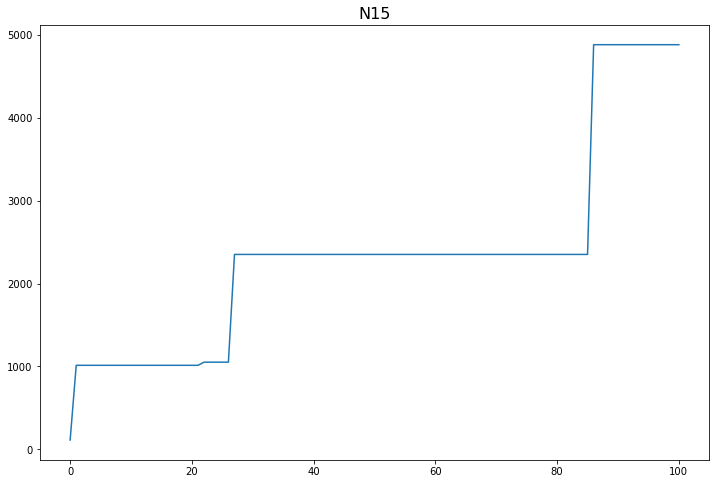

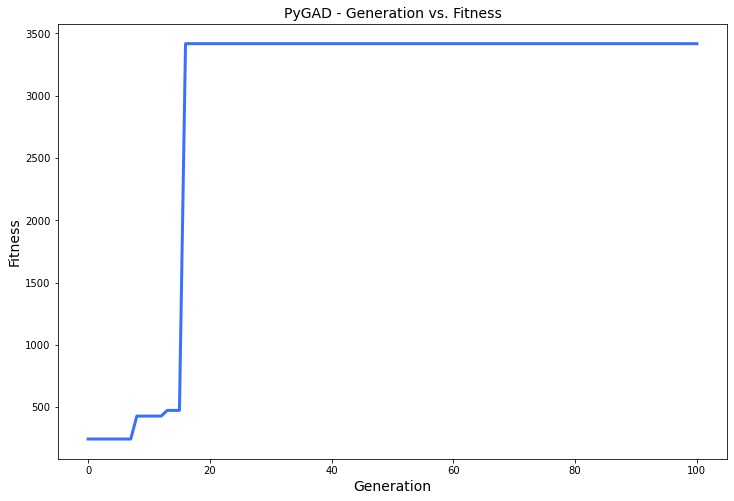

=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.612 |===========| 26.938 |==================| 16.784 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.319 |===========| 26.545 |==================| 2.206 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.472 |===========| 26.455 |==================| 1.842 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.294 |===========| 27.105 |==================| 9.297 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 1.254 |===========| 26.582 |==================| 2.405 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.477 |===========| 27.01 |==================| 83.776 |==========
=====|SOLUTION|===========|OUTPUT|==================|FITNESS|==========
======| 0.575 |===========| 26.958 |===============

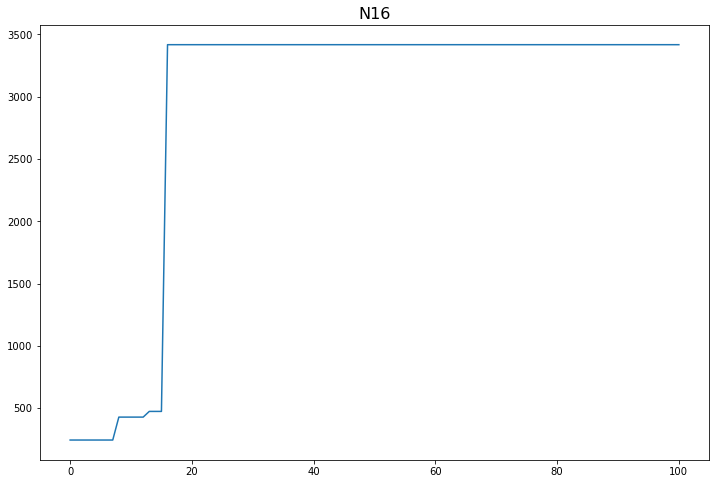

In [12]:
for index, val in enumerate(model_nodes):
    ga_instance = pygad.GA(num_generations=water_model.num_generations,
                       num_parents_mating=water_model.num_parents_mating, 
                       fitness_func=fitness_function, 
                       sol_per_pop=water_model.sol_per_pop,
                       num_genes=water_model.num_genes,
                       init_range_low=water_model.init_range_low,
                       init_range_high=water_model.init_range_high,
                       parent_selection_type=water_model.parent_selection_type,
                       keep_parents=water_model.keep_parents,
                       crossover_type=water_model.crossover_type,
                       mutation_type=water_model.mutation_type,
                       mutation_num_genes=water_model.mutation_num_genes,
                       callback_generation=callback_generation)
    
    water_model = WaterLeakModel(node=wn.junction_name_list[index])
    water_model.run(plot_graph=False)
    current_node = model_nodes[index]
    
    # Running the GA to optimize the parameters of the function.
    ga_instance.run()
    
    # After the generations complete, some plots are shown that summarize how the outputs/fitenss values evolve over generations.
    ga_instance.plot_result()
    
    # Returning the details of the best solution.
    solution, solution_fitness, solution_idx = ga_instance.best_solution()
    print("Parameters of the best solution :{solution}".format(solution=solution))
    print("Fitness value of the best solution ={solution_fitness}".format(solution_fitness=solution_fitness))
    print("Index of the best solution :{solution_idx}".format(solution_idx=solution_idx))
    
    prediction = numpy.sum(numpy.array(water_model.FUNCTION_INPUTS)*solution)
    print("Predicted output based on the best solution :{prediction}".format(prediction=prediction))
          
    if ga_instance.best_solution_generation != -1:
        print("Best fitness value reached after {best_solution_generation} generations.".format(best_solution_generation=ga_instance.best_solution_generation))
    
    # Saving the GA instance.
    filename = 'genetic' # The filename to which the instance is saved. The  name is without extension.
    ga_instance.save(filename=filename)
    
    # Loading the saved GA instance.
    loaded_ga_instance = pygad.load(filename=filename)
    plt.plot(loaded_ga_instance.best_solutions_fitness)
    plt.title(model_nodes[index],fontsize=16)

    fitness_name = "Fitness_" + val
    plt.savefig(water_model.PLOTS_DIR+fitness_name)

In [13]:
# Check solution for confirmation
wn = wntr.network.WaterNetworkModel(water_model.INP_FILE_PATH)
results = water_model.change_discharge_coefficient(wn, emitter_value=abs(solution[0]))

pressure = results.node['pressure']
presssure_at_N6 = pressure.loc[:,water_model.node]
print(presssure_at_N6)

0    26.998137
Name: N16, dtype: float64


In [97]:
# Fitness across all nodes
fitness_plots = [os.path.join(water_model.PLOTS_DIR,file) \
                 for file in os.listdir(water_model.PLOTS_DIR) \
                 if file.endswith('.png') or file.endswith('.jpg')]
fitness_plots

['temp_plots/Fitness_N1.png',
 'temp_plots/Fitness_N12.png',
 'temp_plots/Fitness_N13.png',
 'temp_plots/Fitness_N2.png',
 'temp_plots/Fitness_N11.png',
 'temp_plots/Fitness_N10.png',
 'temp_plots/Fitness_N3.png',
 'temp_plots/Fitness_N7.png',
 'temp_plots/Fitness_N14.png',
 'temp_plots/Fitness_N15.png',
 'temp_plots/Fitness_N6.png',
 'temp_plots/Fitness_N4.png',
 'temp_plots/Fitness_N16.png',
 'temp_plots/Fitness_N5.png',
 'temp_plots/Fitness_N8.png',
 'temp_plots/Fitness_N9.png',
 'temp_plots/Fitness_All_Nodes.png']

In [98]:
plt.rcParams['figure.figsize'] = (10,7)

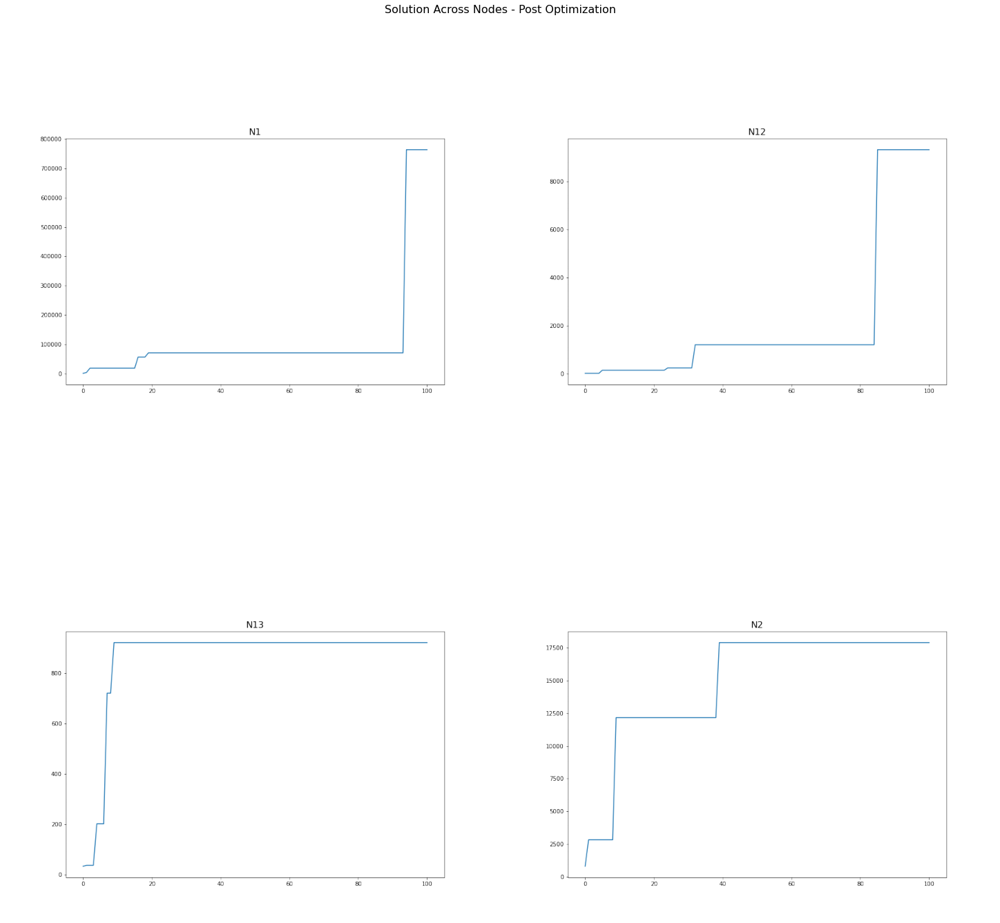

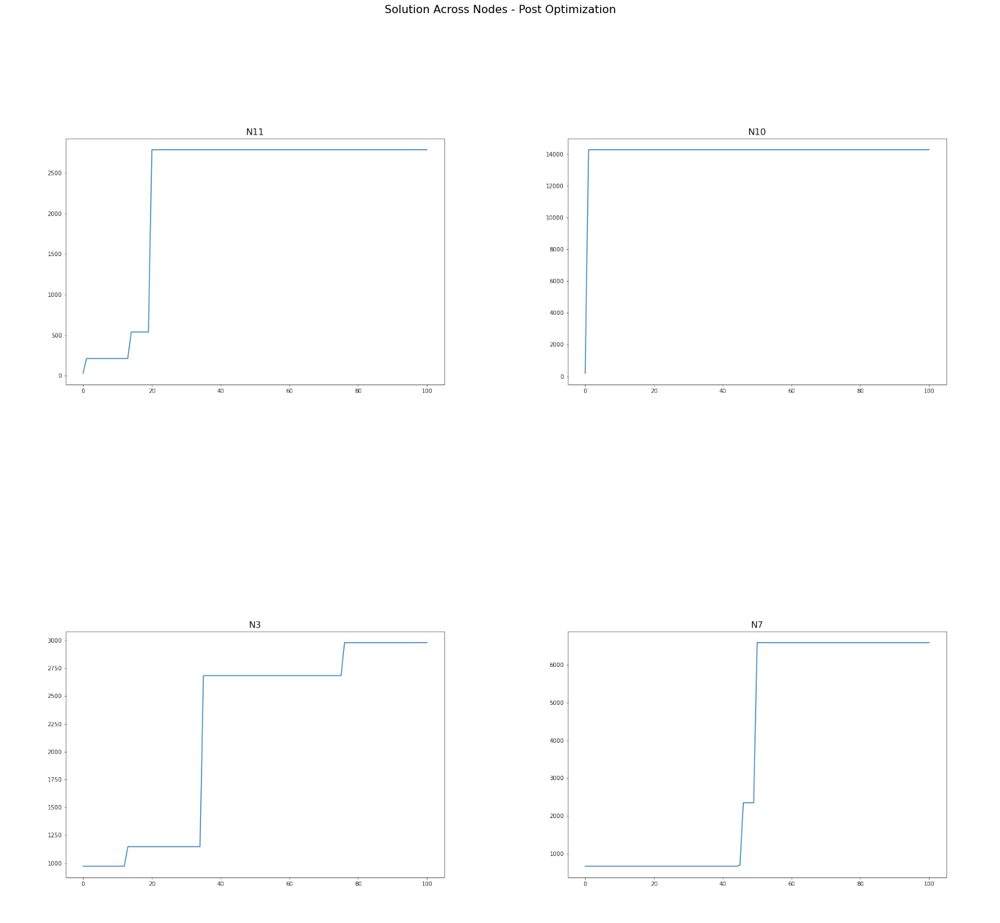

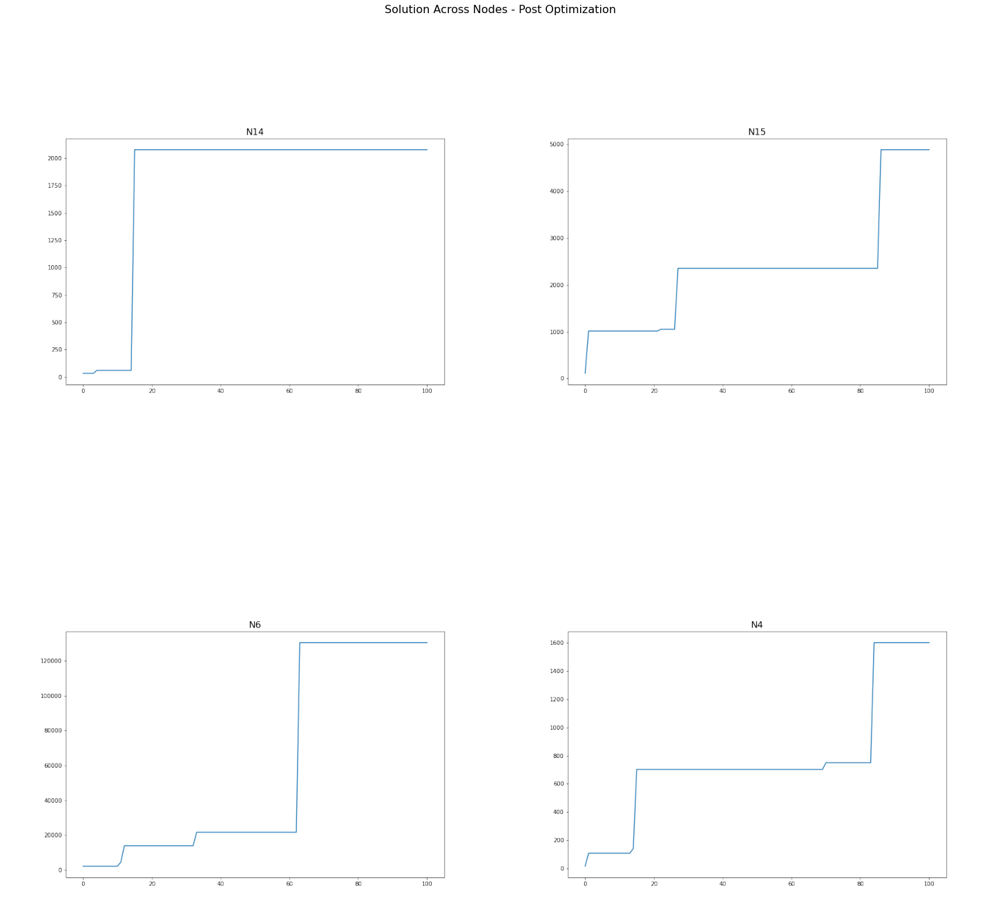

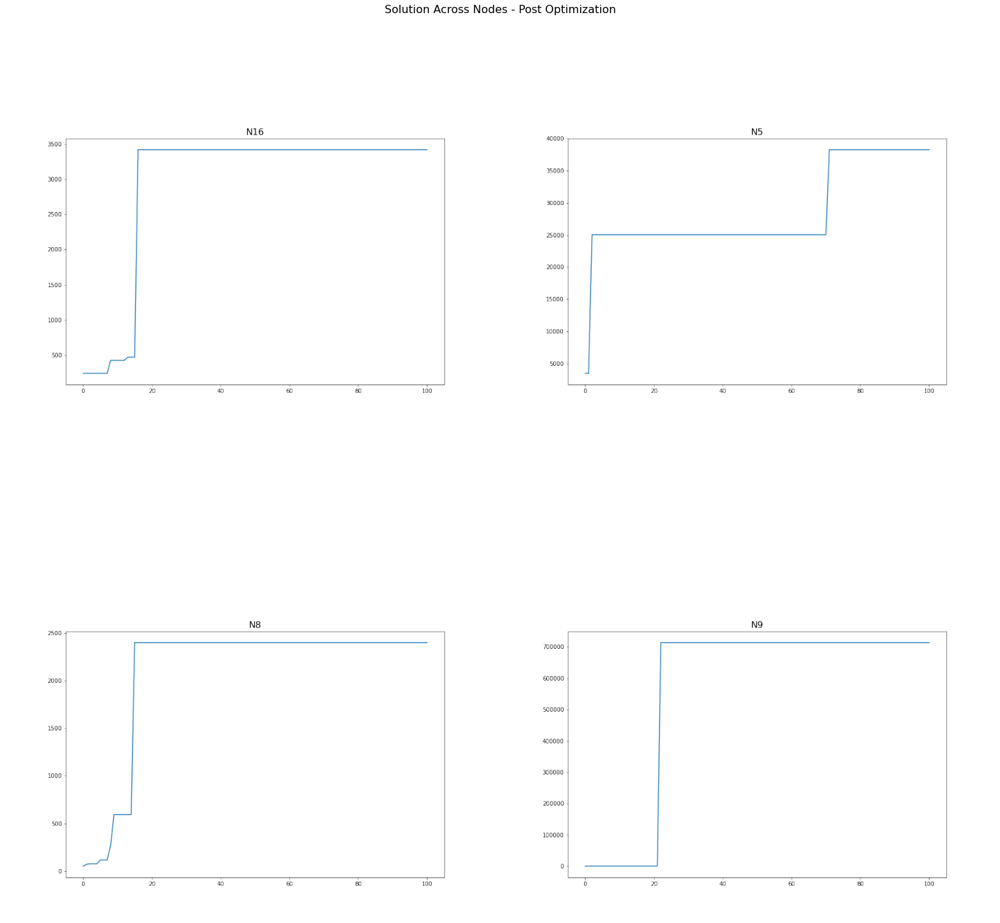

In [146]:
# subplot 16 images
i = 4
j = 0

for _ in range(len(fitness_plots)//4):
    fig, axs = plt.subplots(2, 2, figsize=(20,20), constrained_layout = True)
    axs = axs.ravel()

    for index, val in enumerate(fitness_plots[j:i]):
        img = plt.imread(val)
        axs[index].imshow(img)
        axs[index].axis('off')
    fig.suptitle('Solution Across Nodes - Post Optimization', fontsize=16)
    plt.savefig(water_model.PLOTS_DIR+str(f'/fitness/Fitness_group_{j}.png'))
    j=i
    i+=4
        
# plt.subplots_adjust(left=0, bottom=0, right=None, top=None, wspace=None, hspace=None)


In [152]:
fitness_solution_per_population = glob.glob(f"{water_model.TEMP_DIR}FITNESS_SOLUTION_N1_*")

water_model.export_results(solutions = fitness_solution_per_population, path='results', name='optimization-result-per-fitness')
fitness_solution_per_population = pd.read_csv('results/optimization-result-per-fitness.csv')
fitness_solution_per_population

File Exported Successfully to path: results/optimization-result-per-fitness.csv


,EMITTER_COEFFICIENT_SOLUTION,PRESSURE_OUTPUT,OUTPUT_DEMAND,FITNESS
0,0.363306,9.359269,1.0,233.138450
1,0.203068,9.364281,1.0,107.504302
2,0.650536,9.350245,1.0,211.127257
3,0.937041,9.341195,1.0,72.535192
4,0.016872,9.370086,1.0,66.193488
...,...,...,...,...
1915,1.436461,9.325303,1.0,33.695248
1916,0.491675,9.355242,1.0,3809.833741
1917,0.286306,9.361679,1.0,149.253812
1918,0.168819,9.365351,1.0,96.419453
